In [1]:
import numpy as np
import pandas as pd
import sys
import tensorflow as tf
from sklearn.model_selection import RandomizedSearchCV
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from scipy.signal import find_peaks, savgol_filter
import matplotlib.pyplot as plt
from helpers import create_df
from helpers import get_peaks_and_valleys
from helpers import plot_df
from helpers import get_num_reps
from helpers import smooth_and_resample

In [2]:
# 0 = bicep curl, 1 = shoulder press, 2 = row, 3 = rdl, 4 = squat 
training_files = ["../data2/bicep_curl/bicep_adam_set1_reps10_1.csv", 
                  "../data2/bicep_curl/bicep_andrew_set2_reps10_1.csv", 
                  "../data2/bicep_curl/bicep_anuj_set1_rep10_1.csv", 
                  "../data2/bicep_curl/bicep_jake_set1_reps10_1.csv", 
                  "../data2/bicep_curl/bicep_kamyar_set1_reps10_1.csv", 
                  "../data2/bicep_curl/bicep_mike_set1_reps10_1.csv", 
                  "../data2/bicep_curl/bicep_suzan_set1_reps10_1.csv", 
                  "../data2/bicep_curl/bicep_udai_set1_reps10_1.csv", 
                  "../data2/shoulder_press/shoulder_adam_set1_reps10_1.csv", 
                  "../data2/shoulder_press/shoulder_andrew_set1_reps10_1.csv", 
                  "../data2/shoulder_press/shoulder_anuj_set1_rep10_1.csv", 
                  "../data2/shoulder_press/shoulder_kamyar_set1_reps10_1.csv", 
                  "../data2/shoulder_press/shoulder_mike_set1_reps10_1.csv", 
                  "../data2/shoulder_press/shoulder_suzan_set1_reps10_1.csv", 
                  "../data2/shoulder_press/shoulder_udai_set1_reps10_1.csv", 
                  "../data2/shoulder_press/shoulder_suzan_set3_reps10_1.csv",
                  "../data2/row/row_adam_set1_reps10_1.csv", 
                  "../data2/row/row_andrew_set1_reps10_1.csv", 
                  "../data2/row/row_anuj_set1_rep10_1.csv", 
                  "../data2/row/row_jake_set1_reps12_1.csv", 
                  "../data2/row/row_kamyar_set1_reps10_1.csv", 
                  "../data2/row/row_mike_set1_reps10_1.csv", 
                  "../data2/row/row_suzan_set1_reps10_1.csv", 
                  "../data2/row/row_udai_set1_reps12_1.csv", 
                  "../data2/dead/dead_adam_set1_reps10_1.csv", 
                  "../data2/dead/dead_andrew_set1_reps10_1.csv", 
                  "../data2/dead/dead_anuj_set1_rep10_1.csv", 
                  "../data2/dead/dead_kamyar_set1_reps10_1.csv", 
                  "../data2/dead/dead_mike_set1_reps10_1.csv", 
                  "../data2/squat/squat_adam_set1_reps10_1.csv", 
                  "../data2/squat/squat_andrew_set1_reps10_1.csv", 
                  "../data2/squat/squat_anuj_set1_rep10_1.csv", 
                  "../data2/squat/squat_jake_set1_reps10_1.csv", 
                  "../data2/squat/squat_kamyar_set1_reps10_1.csv", 
                  "../data2/squat/squat_mike_set1_reps10_1.csv", 
                  "../data2/squat/squat_suzan_set1_reps10_1.csv", 
                  "../data2/squat/squat_udai_set1_reps10_1.csv",
                  "../data2/bicep_curl/bicep_udai_set3_reps10_1.csv", 
                  "../data2/shoulder_press/shoulder_udai_set3_reps10_1.csv", 
                  "../data2/row/row_udai_set3_reps10_1.csv", 
                  "../data2/dead/dead_udai_set1_reps10_1.csv", 
                  "../data2/squat/squat_udai_set3_reps10_1.csv",
                  "../data2/newDead/newdead_udai_set1_reps10_1.csv"] 
train_labels = [0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 0, 1, 2, 3, 4, 3] 

training_files_trim = [
    (8, -14),
    (93, -10),
    (21, -3),
    (21, 300)
]

test_files = ["../data2/bicep_curl/bicep_adam_set2_reps10_1.csv", 
              "../data2/bicep_curl/bicep_andrew_set3_reps10_1.csv", 
              "../data2/bicep_curl/bicep_anuj_set2_rep10_1.csv", 
              "../data2/bicep_curl/bicep_jake_set2_reps10_1.csv", 
              "../data2/bicep_curl/bicep_kamyar_set2_reps10_1.csv", 
              "../data2/bicep_curl/bicep_mike_set2_reps10_1.csv", 
              "../data2/bicep_curl/bicep_suzan_set2_reps10_1.csv", 
              "../data2/bicep_curl/bicep_udai_set2_reps10_1.csv", 
              "../data2/shoulder_press/shoulder_adam_set2_reps10_1.csv", 
              "../data2/shoulder_press/shoulder_andrew_set2_reps10_1.csv", 
              "../data2/shoulder_press/shoulder_anuj_set2_rep10_1.csv", 
              "../data2/shoulder_press/shoulder_kamyar_set2_reps10_1.csv", 
              "../data2/shoulder_press/shoulder_mike_set2_reps10_1.csv", 
              "../data2/shoulder_press/shoulder_suzan_set2_reps8_1.csv", 
              "../data2/shoulder_press/shoulder_suzan_set4_reps10_1.csv",
              "../data2/shoulder_press/shoulder_udai_set2_reps9_1.csv", 
              "../data2/row/row_adam_set2_reps10_1.csv", 
              "../data2/row/row_andrew_set2_reps10_1.csv", 
              "../data2/row/row_anuj_set2_rep10_1.csv", 
              "../data2/row/row_jake_set2_reps12_1.csv", 
              "../data2/row/row_kamyar_set2_reps10_1.csv", 
              "../data2/row/row_mike_set2_reps10_1.csv", 
              "../data2/row/row_suzan_set2_reps12_1.csv", 
              "../data2/row/row_udai_set2_reps12_1.csv", 
              "../data2/dead/dead_adam_set2_reps10_1.csv", 
              "../data2/dead/dead_andrew_set2_reps10_1.csv",
              "../data2/dead/dead_anuj_set2_rep10_1.csv", 
              "../data2/dead/dead_kamyar_set2_reps10_1.csv", 
              "../data2/dead/dead_mike_set2_reps10_1.csv", 
              "../data2/squat/squat_adam_set2_reps10_1.csv", 
              "../data2/squat/squat_andrew_set2_reps10_1.csv", 
              "../data2/squat/squat_anuj_set2_rep10_1.csv", 
              "../data2/squat/squat_jake_set2_reps10_1.csv", 
              "../data2/squat/squat_kamyar_set2_reps10_1.csv", 
              "../data2/squat/squat_mike_set2_reps10_1.csv", 
              "../data2/squat/squat_suzan_set2_reps10_1.csv", 
              "../data2/squat/squat_udai_set2_reps10_1.csv",
              "../data2/newDead/newdead_udai_set2_reps10_1.csv"] 

test_labels = [0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 3]

../data2/bicep_curl/bicep_adam_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     304079   -0.834    3.319    9.444   0.098  -0.054   0.012
1     304082   -0.824    3.326    9.452   0.098  -0.054   0.012
2     304085   -0.824    3.326    9.452   0.097  -0.053   0.012
3     304089   -0.824    3.326    9.452   0.097  -0.053   0.012
4     304110   -0.846    3.269    9.446   0.122  -0.056   0.007


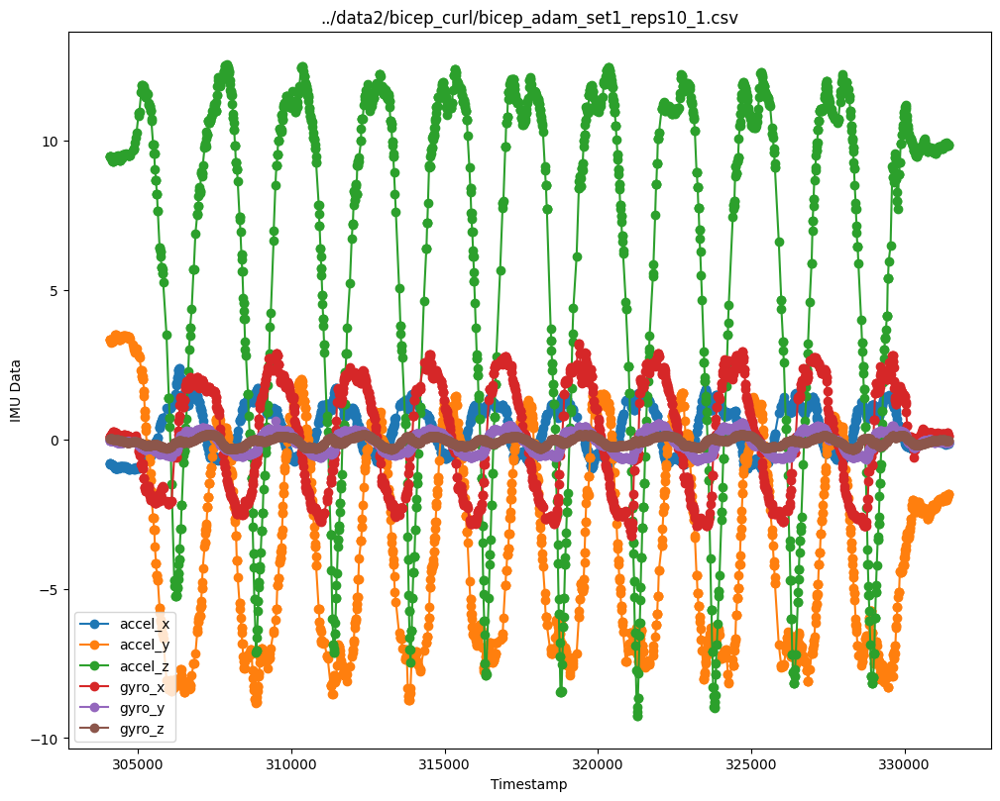

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  304073.741259 -0.828657  3.344182  9.459580  0.086566 -0.054077  0.013196
1  304140.021922 -0.854015  3.248828  9.350702  0.186178 -0.051101  0.002175
2  304246.241777 -0.967872  3.441672  9.399223  0.217111 -0.069439 -0.011327
3  304326.434861 -0.952710  3.406821  9.441312  0.083315 -0.105540 -0.024731
4  304394.333871 -0.938547  3.343874  9.341706  0.098375 -0.106829 -0.037857


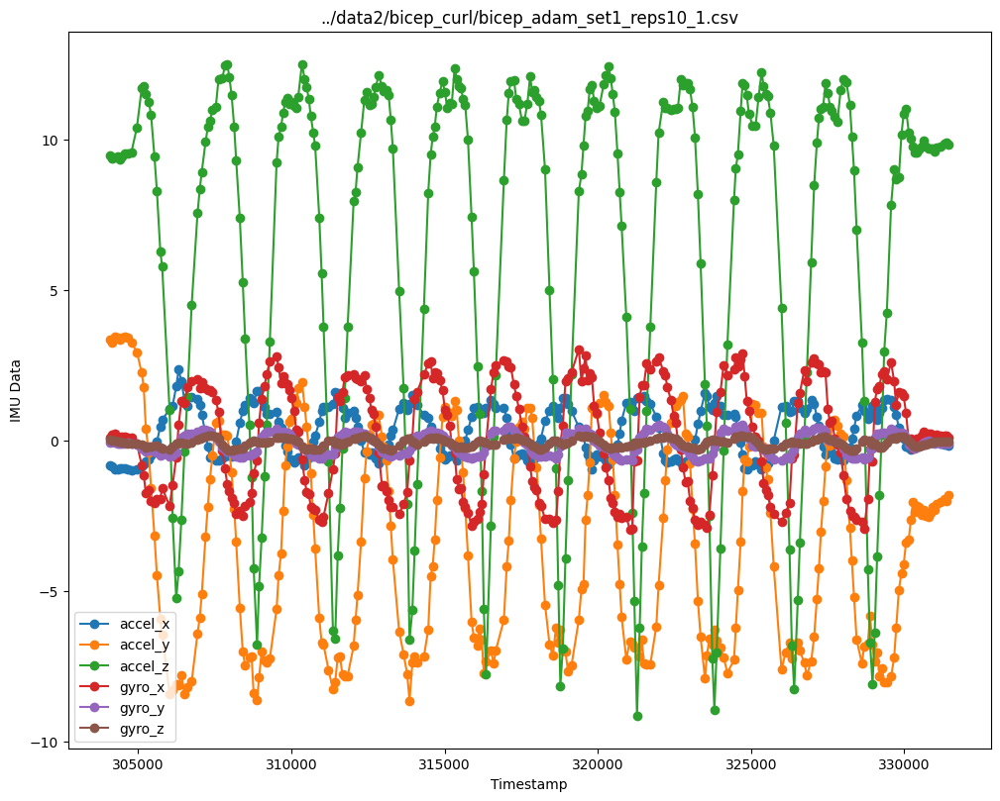

../data2/bicep_curl/bicep_andrew_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    1783092    0.522    4.887   -8.289  -0.454  -0.057  -0.042
1    1783096    0.536    4.859   -8.264  -0.519  -0.046  -0.043
2    1783099    0.536    4.859   -8.264  -0.519  -0.046  -0.043
3    1783103    0.536    4.859   -8.264  -0.519  -0.046  -0.043
4    1783126    0.474    4.851   -8.181  -0.552  -0.057  -0.049


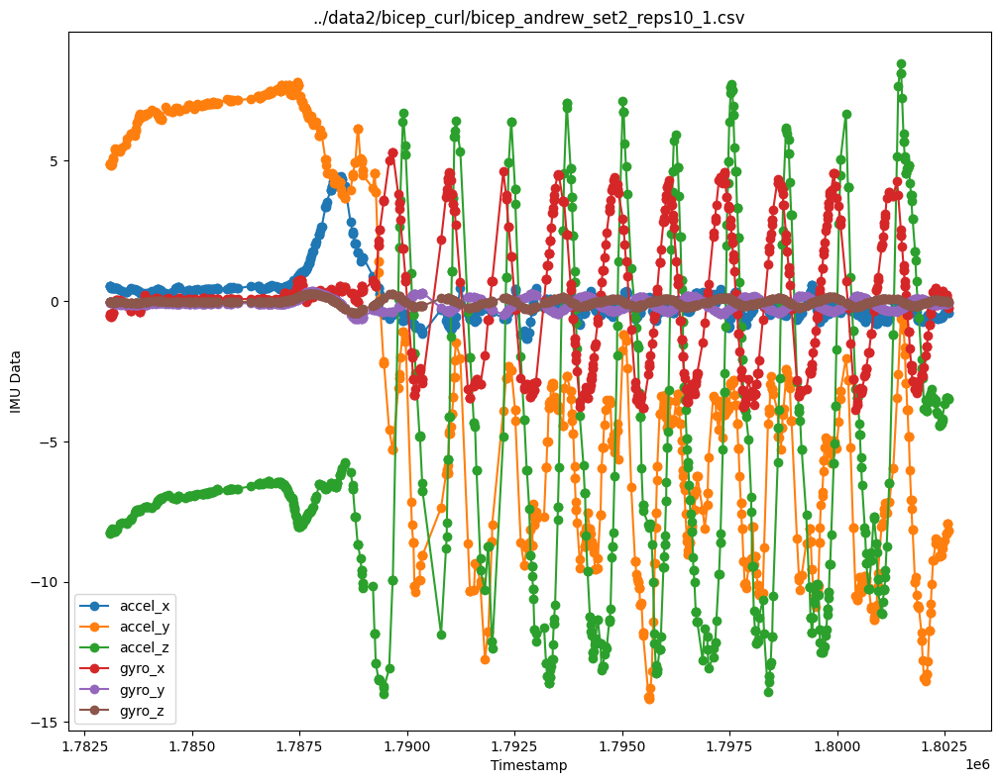

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  1.783093e+06  0.539399  4.919699 -8.308154 -0.435224 -0.051930 -0.039580
1  1.783107e+06  0.510205  4.820059 -8.216892 -0.559727 -0.050258 -0.046722
2  1.783135e+06  0.482392  4.901067 -8.180688 -0.516553 -0.062189 -0.050724
3  1.783176e+06  0.469539  5.166244 -8.203617 -0.295778 -0.083890 -0.049422
4  1.783216e+06  0.466899  5.384494 -8.199052 -0.045167 -0.102976 -0.043323


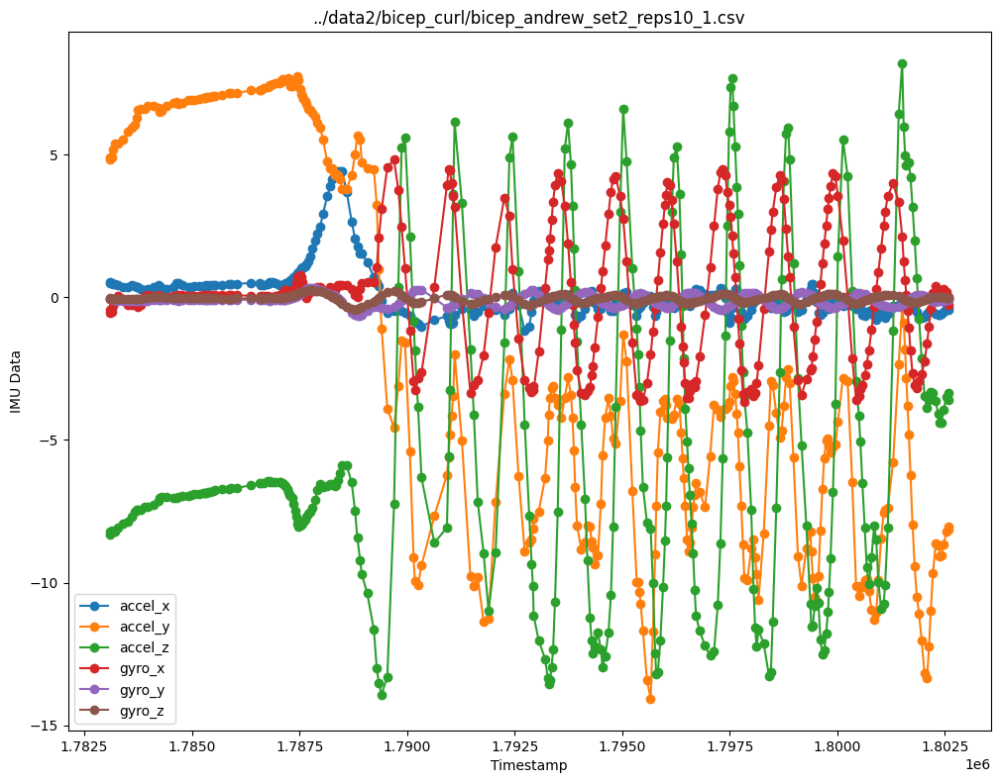

../data2/bicep_curl/bicep_anuj_set1_rep10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     343675   -0.317   -6.084   -7.511  -0.007  -0.098  -0.040
1     343679   -0.317   -6.084   -7.511  -0.007  -0.098  -0.040
2     343682   -0.317   -6.084   -7.511  -0.007  -0.098  -0.040
3     343686   -0.318   -6.106   -7.482  -0.020  -0.095  -0.040
4     343708   -0.329   -6.055   -7.492  -0.033  -0.100  -0.043


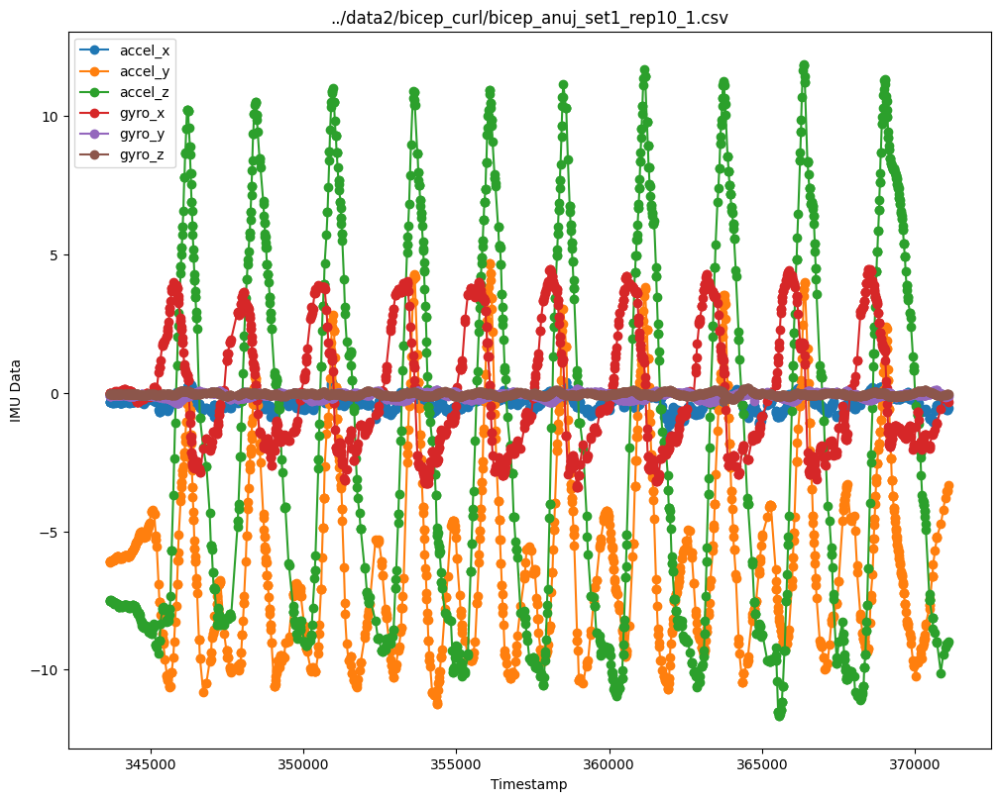

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  343666.146853 -0.314713 -6.090336 -7.505217  0.000951 -0.098378 -0.039392
1  343722.636083 -0.327400 -6.067508 -7.518672 -0.030874 -0.096094 -0.042240
2  343777.287984 -0.341902 -6.051563 -7.569597 -0.013403 -0.094823 -0.043658
3  343825.304590 -0.330235 -5.997000 -7.586387  0.030380 -0.091837 -0.047200
4  343907.283595 -0.316164 -5.926623 -7.614465  0.044917 -0.088376 -0.050443


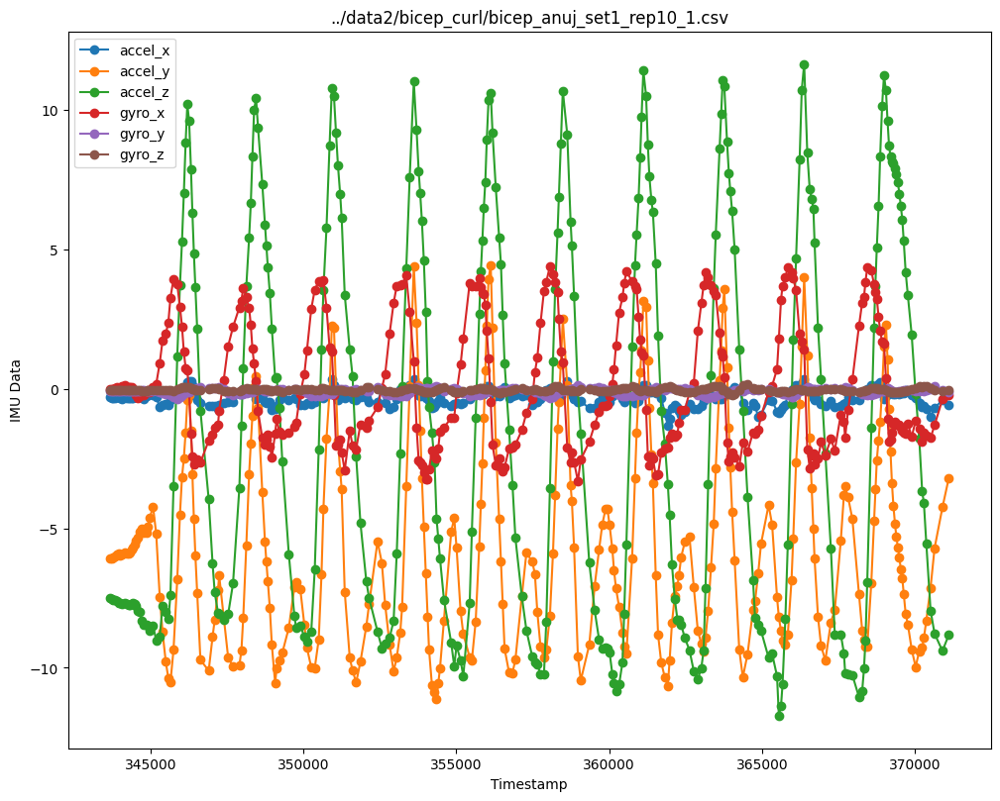

../data2/bicep_curl/bicep_jake_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     290375   -1.572   -7.716    5.983  -0.204   0.038   0.077
1     290379   -1.625   -7.711    6.048  -0.161   0.027   0.073
2     290382   -1.625   -7.711    6.048  -0.161   0.027   0.073
3     290386   -1.687   -7.732    6.049  -0.161   0.027   0.068
4     290409   -1.742   -7.766    6.050  -0.053  -0.007   0.054


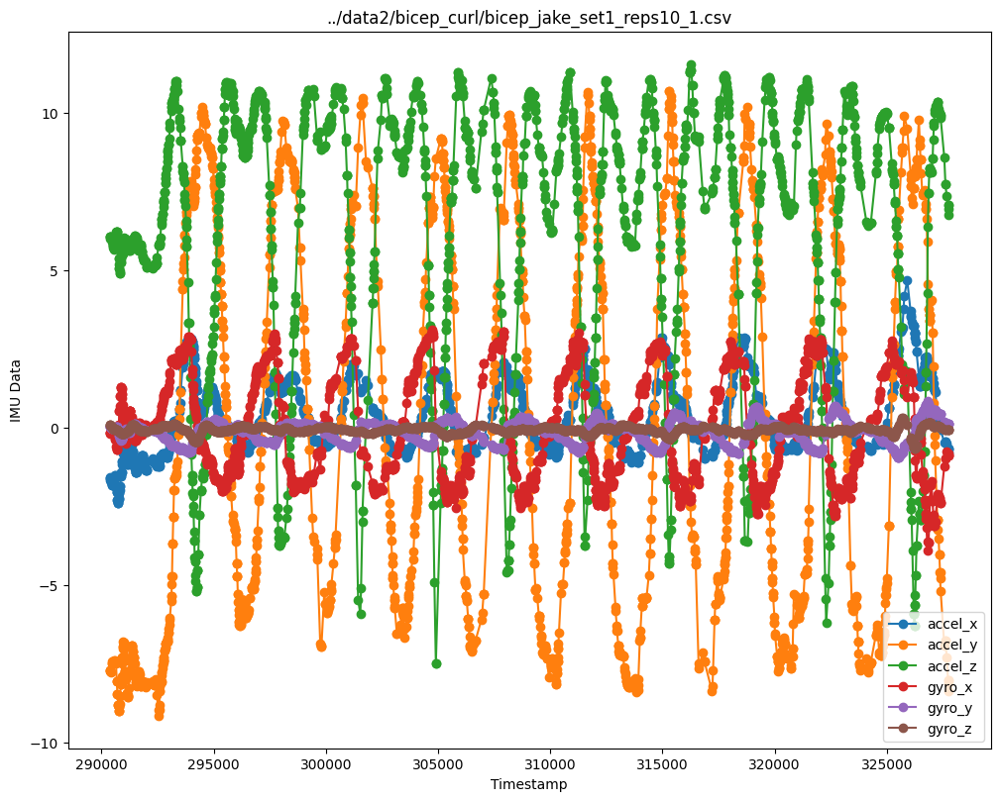

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  290359.223776 -1.554601 -7.771510  6.021210 -0.236385  0.049524  0.087469
1  290466.316400 -1.809064 -7.507056  5.948585  0.014180 -0.036161  0.009788
2  290534.168892 -1.770216 -7.464125  5.717505 -0.109667 -0.035303 -0.052620
3  290651.213704 -1.805769 -7.757367  6.105193 -0.615999  0.024235 -0.072168
4  290739.799284 -2.388920 -8.794339  5.790582 -0.328056 -0.084893 -0.108233


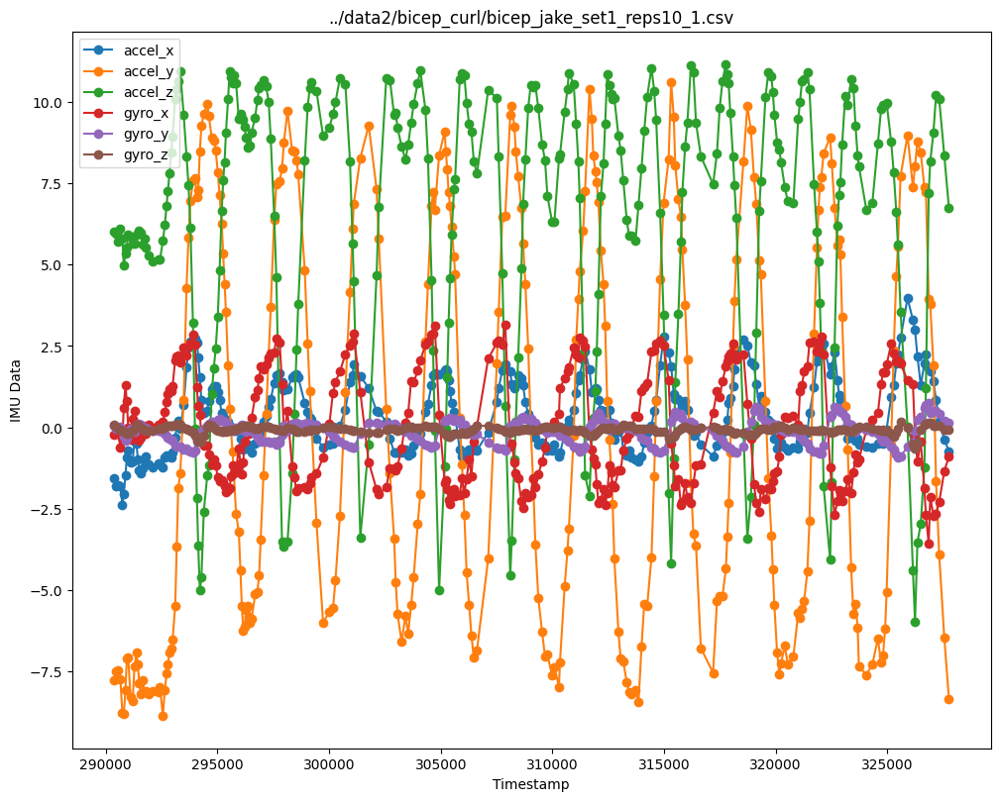

../data2/bicep_curl/bicep_kamyar_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    3697763   -0.837    0.625    9.919   0.059  -0.114  -0.049
1    3697794   -0.866    0.607   10.068   0.106  -0.100  -0.042
2    3697798   -0.866    0.607   10.068   0.106  -0.100  -0.042
3    3697801   -0.866    0.607   10.068   0.106  -0.100  -0.042
4    3697824   -0.889    0.674   10.155   0.142  -0.087  -0.037


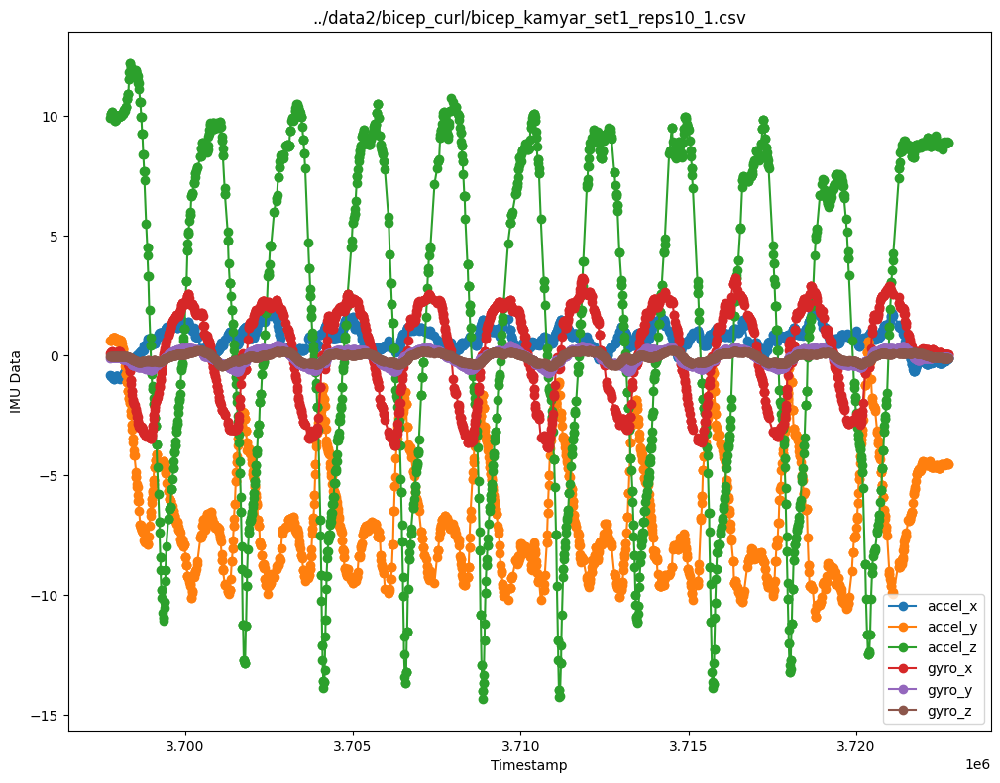

      timestamp   accel_x   accel_y    accel_z    gyro_x    gyro_y    gyro_z
0  3.697770e+06 -0.841021  0.592098   9.948196  0.061937 -0.112986 -0.048126
1  3.697848e+06 -0.932629  0.718956  10.083101  0.133931 -0.083235 -0.035969
2  3.697914e+06 -0.924371  0.730322   9.813002  0.002440 -0.097526 -0.041923
3  3.697977e+06 -0.879557  0.582152   9.980439  0.041229 -0.089254 -0.039178
4  3.698045e+06 -0.947096  0.654722   9.982765  0.164076 -0.076211 -0.036524


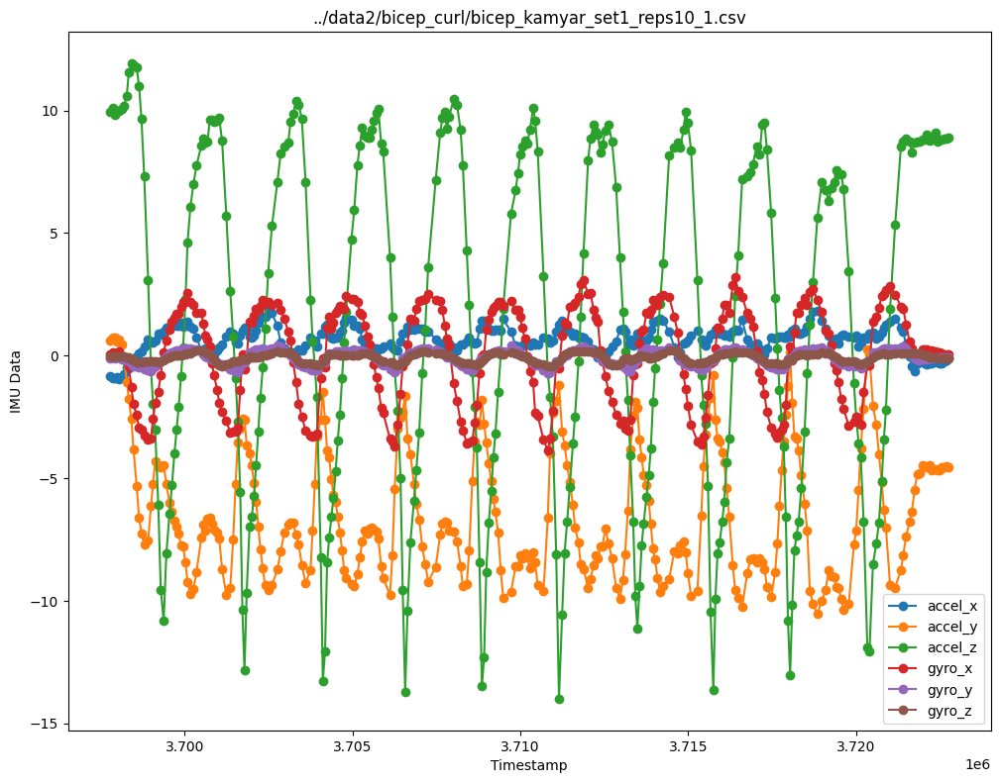

../data2/bicep_curl/bicep_mike_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    2012600   -0.811    1.366    9.763   0.133  -0.111  -0.021
1    2012604   -0.811    1.366    9.763   0.133  -0.111  -0.021
2    2012626   -0.778    1.358    9.848   0.127  -0.114  -0.018
3    2012630   -0.822    1.344    9.863   0.133  -0.111  -0.020
4    2012634   -0.822    1.344    9.863   0.133  -0.111  -0.020


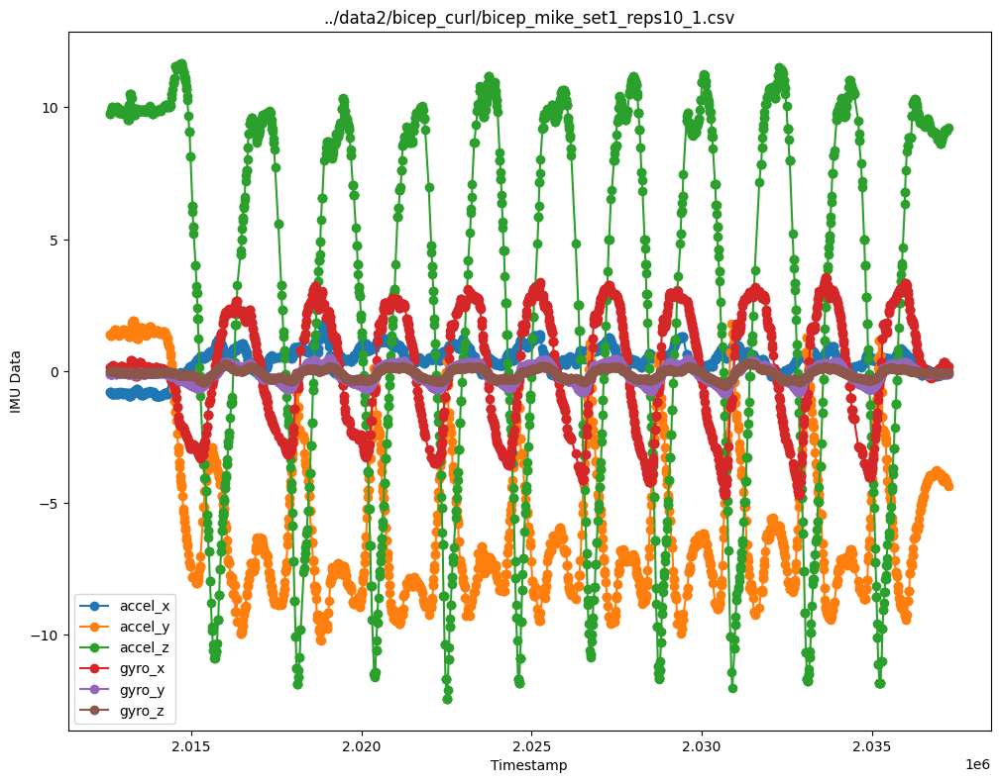

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  2.012598e+06 -0.798441  1.358000  9.732755  0.125979 -0.112434 -0.021049
1  2.012664e+06 -0.851180  1.408662  9.975100  0.180276 -0.101641 -0.016874
2  2.012748e+06 -0.853437  1.557550  9.967555  0.139745 -0.095831 -0.023524
3  2.012823e+06 -0.857204  1.481864  9.963594  0.060787 -0.092053 -0.039299
4  2.012893e+06 -0.825473  1.381002  9.851397  0.114378 -0.086553 -0.041422


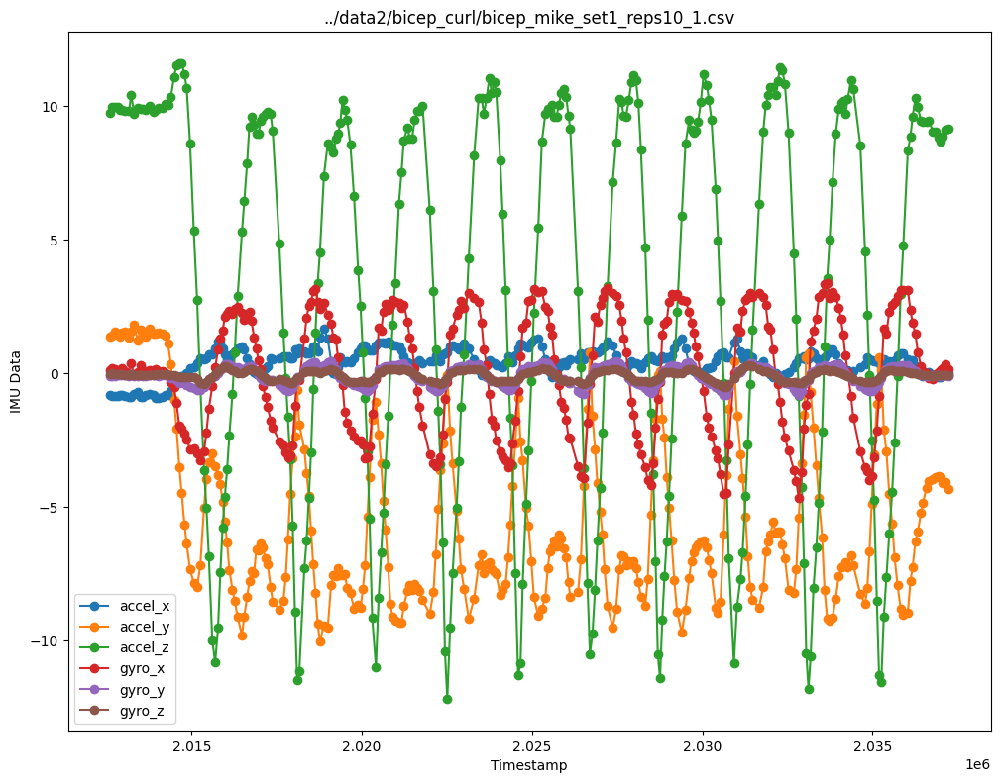

../data2/bicep_curl/bicep_suzan_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0      81488   -1.497   -8.644    3.996  -0.105  -0.048  -0.060
1      81492   -1.497   -8.644    3.996  -0.105  -0.048  -0.060
2      81496   -1.522   -8.663    4.074  -0.105  -0.048  -0.060
3      81705   -1.516   -8.778    3.862   0.114  -0.100  -0.059
4      81730   -1.517   -8.743    3.927  -0.043  -0.071  -0.067


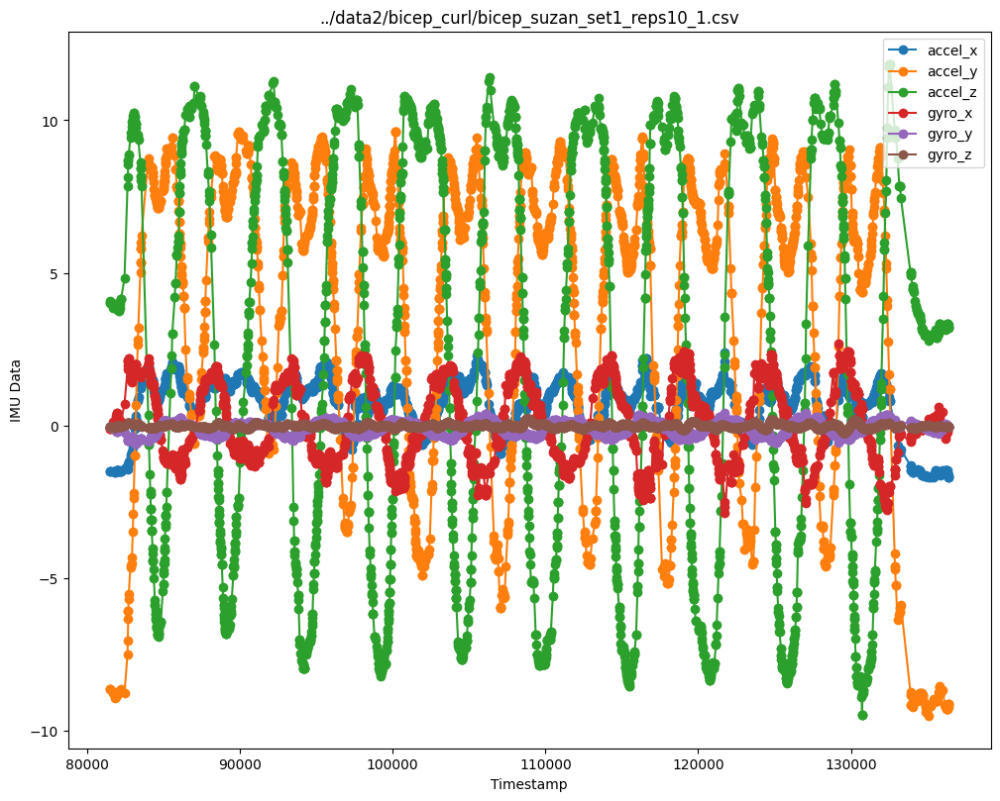

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  81438.699301 -1.487930 -8.583392  3.999497 -0.046203 -0.059056 -0.048972
1  81893.768295 -1.514359 -8.886154  3.915555  0.159538 -0.135155 -0.061525
2  82002.259895 -1.497909 -8.745081  3.765540  0.265393 -0.172831 -0.014829
3  82316.859883 -1.489823 -8.591160  4.762309  0.472875 -0.182540 -0.011087
4  82750.845234 -1.163443 -5.423824  9.030762  1.997917 -0.455834  0.086355


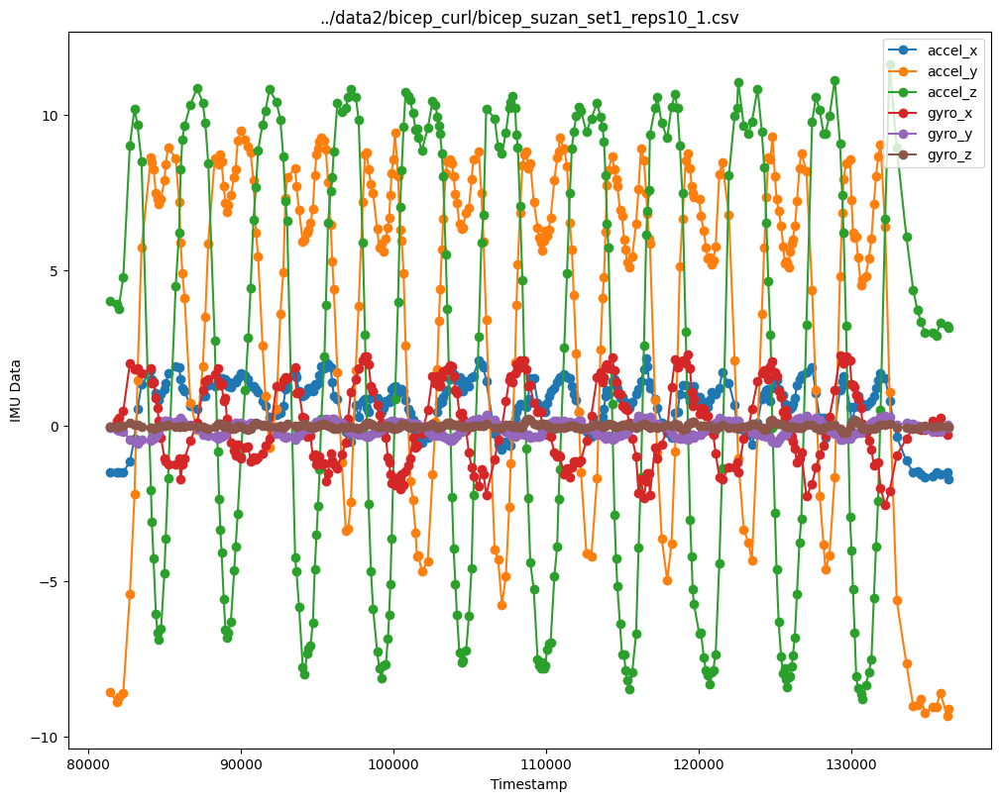

../data2/bicep_curl/bicep_udai_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     208565   -1.065   -5.015    7.876   0.125  -0.076  -0.017
1     208569   -1.065   -5.015    7.876   0.125  -0.076  -0.017
2     208573   -1.065   -5.091    7.829   0.125  -0.076  -0.017
3     208576   -1.064   -5.091    7.829   0.050  -0.064  -0.020
4     208599   -1.137   -5.216    7.834  -0.078  -0.034  -0.020


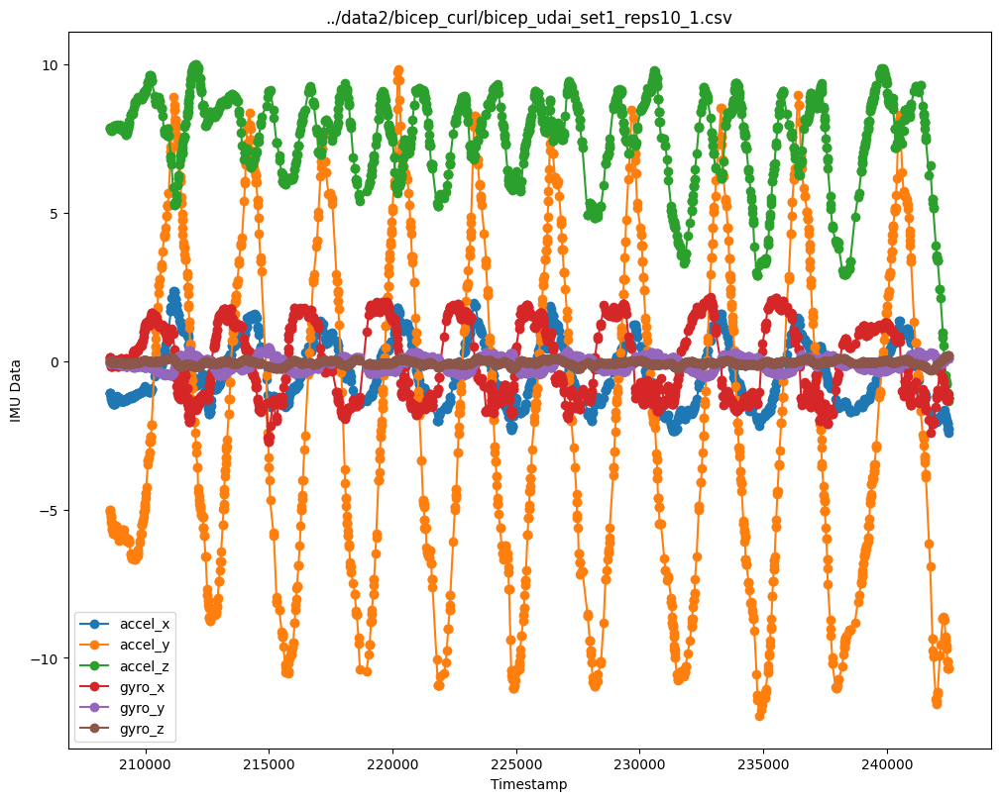

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  208562.657343 -1.050497 -5.003573  7.883517  0.179755 -0.087042 -0.016161
1  208607.188990 -1.172501 -5.270736  7.805470 -0.113642 -0.029131 -0.022353
2  208667.861715 -1.368724 -5.682528  7.827803 -0.133283 -0.025847 -0.027128
3  208741.748712 -1.437048 -5.804479  7.931079  0.047428 -0.064053 -0.033731
4  208814.837602 -1.286956 -5.564660  7.921042  0.024816 -0.068344 -0.041508


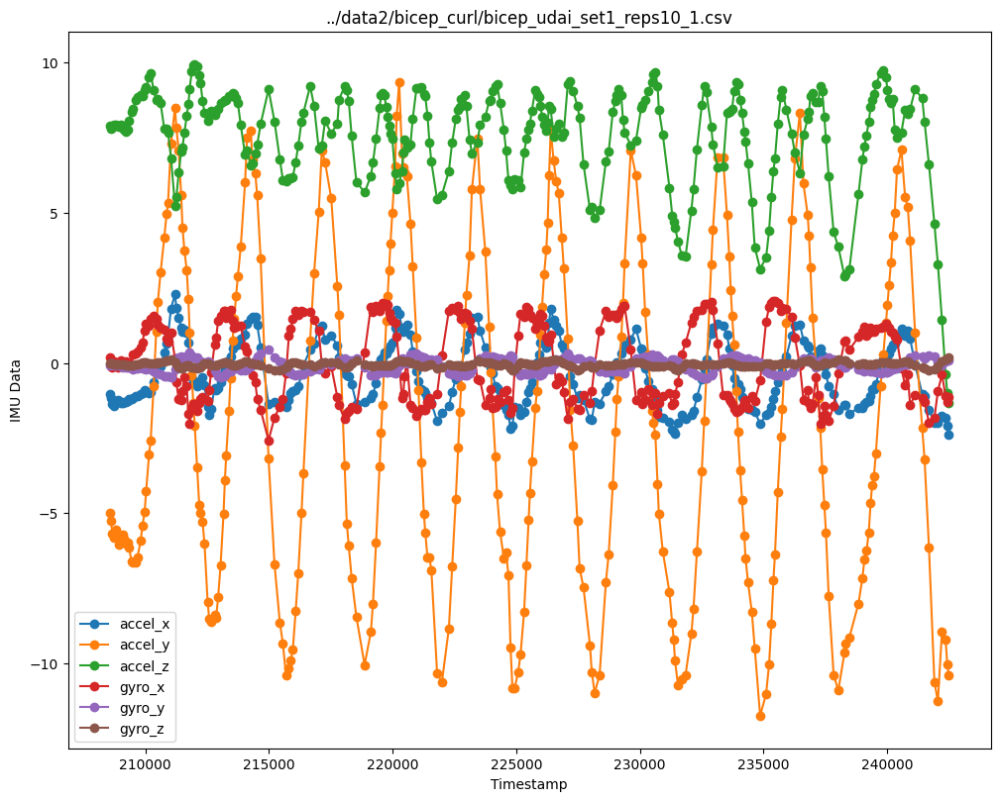

../data2/shoulder_press/shoulder_adam_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    1741257    1.019   -5.466   -8.712  -0.015  -0.104  -0.078
1    1741261    1.019   -5.466   -8.712  -0.015  -0.104  -0.078
2    1741284    1.056   -5.460   -8.813  -0.062  -0.095  -0.086
3    1741314    1.055   -5.283   -9.138  -0.115  -0.086  -0.100
4    1741318    1.083   -5.246   -9.211  -0.126  -0.079  -0.105


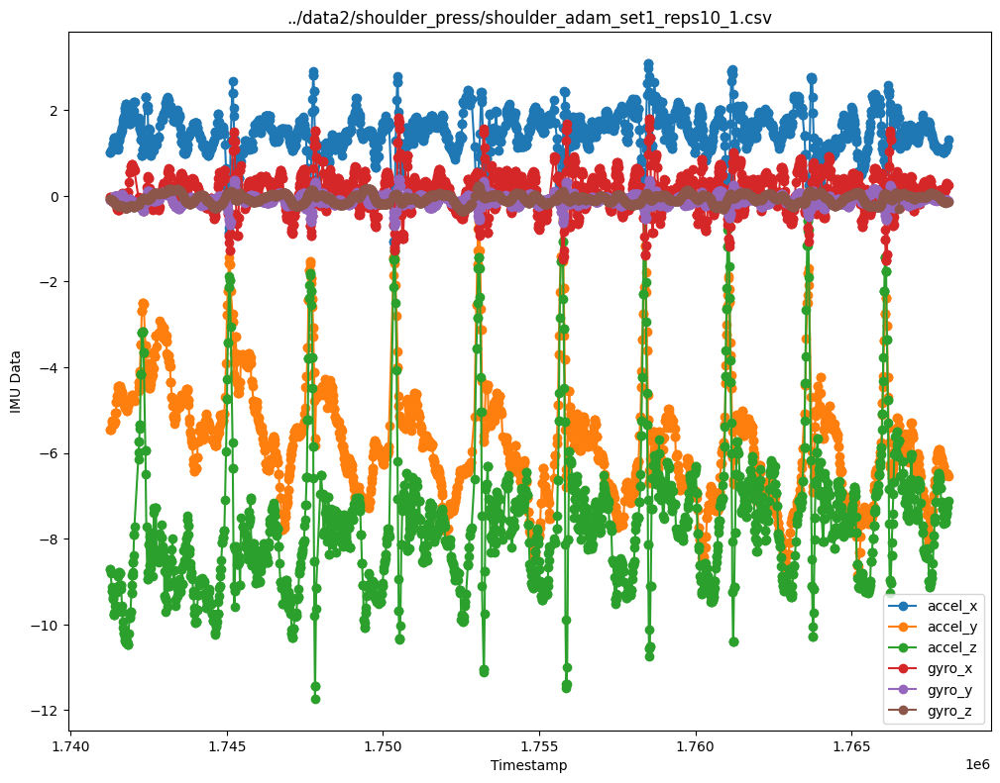

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  1.741254e+06  1.014678 -5.493713 -8.670399  0.003413 -0.105336 -0.074846
1  1.741352e+06  1.233708 -5.305067 -9.511039 -0.119205 -0.057183 -0.120622
2  1.741428e+06  1.267768 -5.130943 -9.633304 -0.058010 -0.000570 -0.169402
3  1.741501e+06  1.091069 -4.615907 -9.165485 -0.293635 -0.009493 -0.217062
4  1.741579e+06  1.384764 -4.442039 -8.809841 -0.255380  0.007247 -0.231876


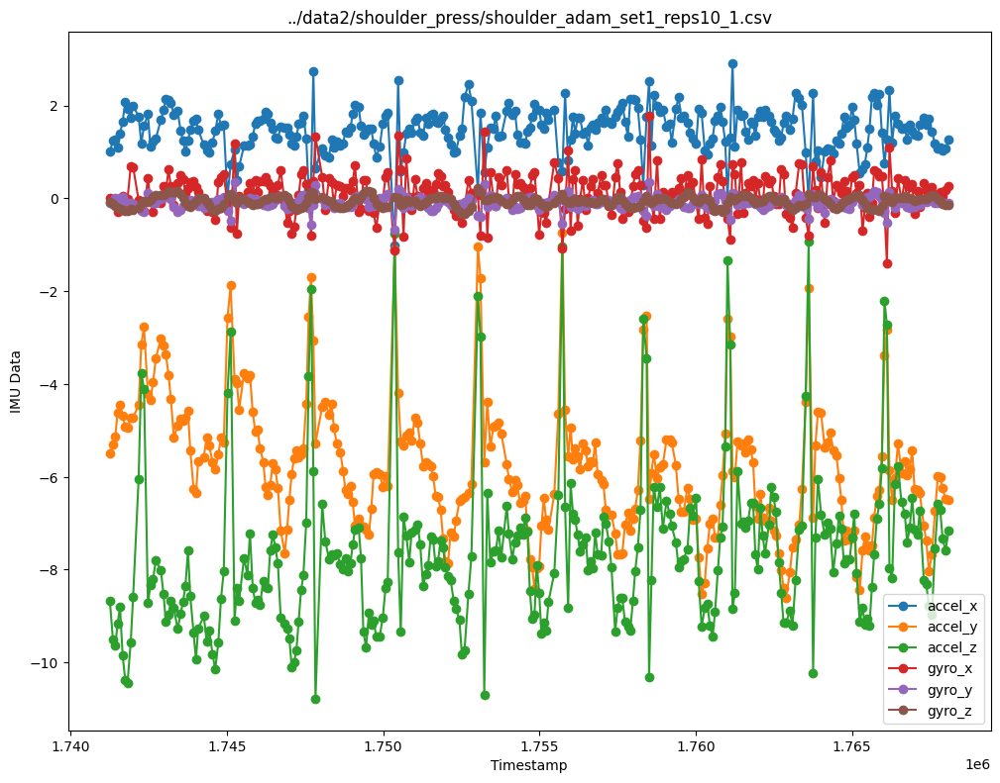

../data2/shoulder_press/shoulder_andrew_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     160131   -0.194   -2.654    9.673   0.086  -0.104  -0.037
1     160135   -0.140   -2.651    9.622   0.086  -0.104  -0.037
2     160139   -0.140   -2.651    9.622   0.081  -0.099  -0.035
3     160142   -0.140   -2.651    9.622   0.081  -0.099  -0.035
4     160165   -0.160   -2.624    9.648   0.076  -0.098  -0.034


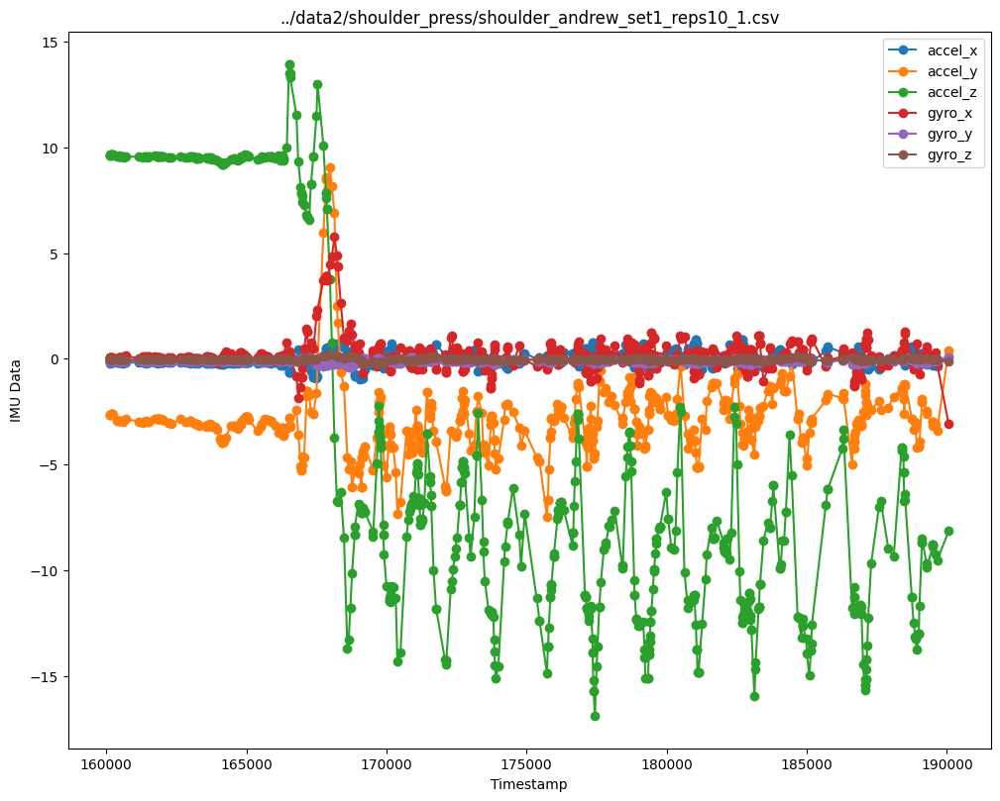

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  160142.349650 -0.168783 -2.710462  9.634699  0.083259 -0.103573 -0.036587
1  160135.812480 -0.154956 -2.614701  9.645295  0.084688 -0.101192 -0.035977
2  160154.147463 -0.150246 -2.578627  9.647807  0.074048 -0.098931 -0.035677
3  160189.699301 -0.161503 -2.585068  9.651179  0.043962 -0.096587 -0.035985
4  160271.982069 -0.171459 -2.683834  9.633336  0.020690 -0.095251 -0.036165


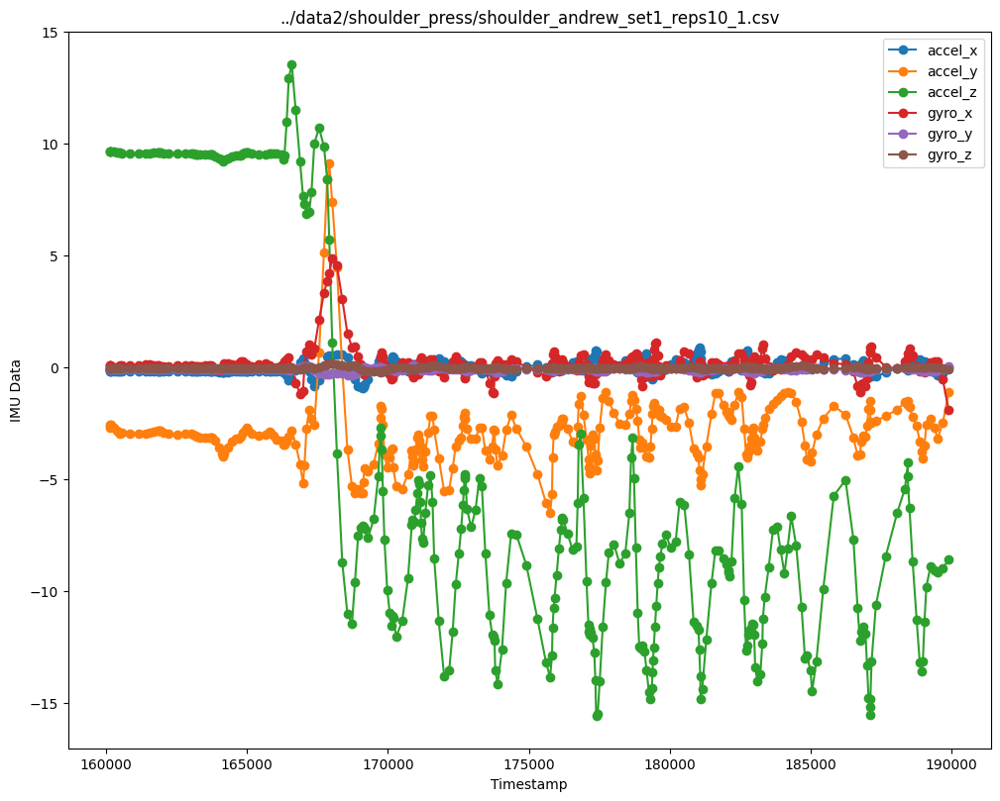

../data2/shoulder_press/shoulder_anuj_set1_rep10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0      80691     0.41   -2.590   -9.308   0.020  -0.112  -0.009
1      80695     0.41   -2.590   -9.308   0.020  -0.112  -0.009
2      80699     0.38   -2.645   -9.294   0.006  -0.094  -0.002
3      80702     0.38   -2.645   -9.294   0.006  -0.094  -0.002
4      80725     0.40   -2.703   -9.344   0.050  -0.101  -0.006


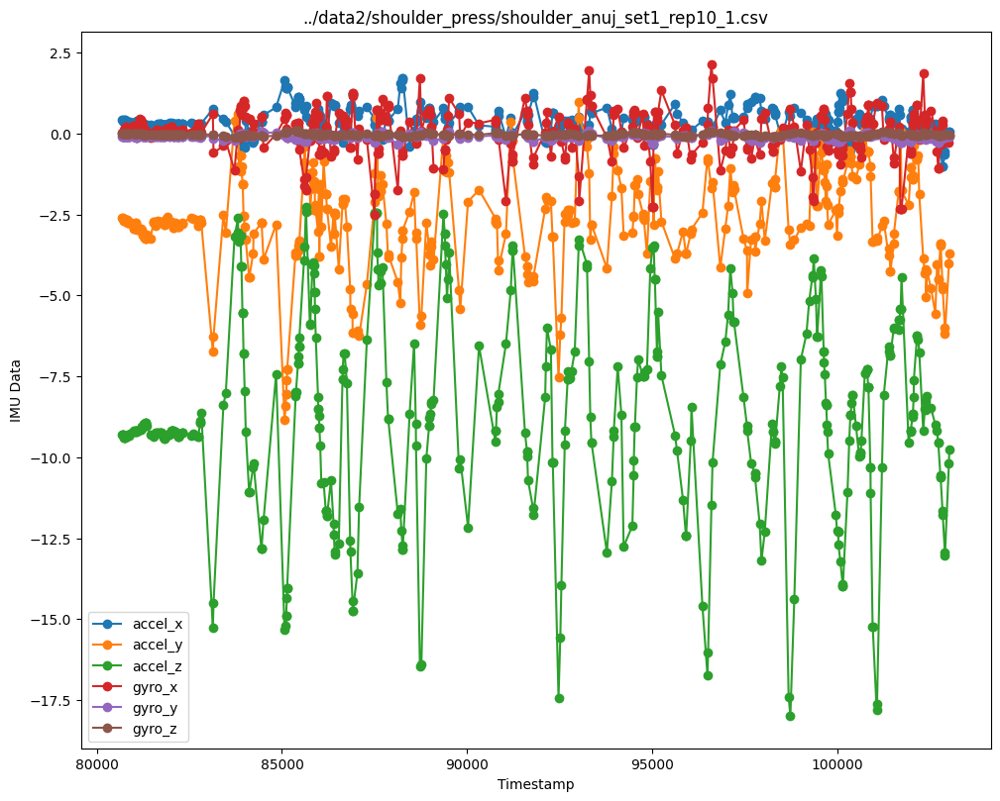

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  80688.482517  0.407280 -2.576678 -9.280902  0.003636 -0.110287 -0.007783
1  80698.983285  0.395373 -2.626978 -9.313284  0.017857 -0.104626 -0.006203
2  80710.951447  0.387762 -2.664751 -9.338777  0.040284 -0.099909 -0.005173
3  80724.554521  0.384934 -2.688568 -9.356594  0.071852 -0.096244 -0.004756
4  80739.006860  0.393622 -2.698975 -9.376394  0.125391 -0.094386 -0.005429


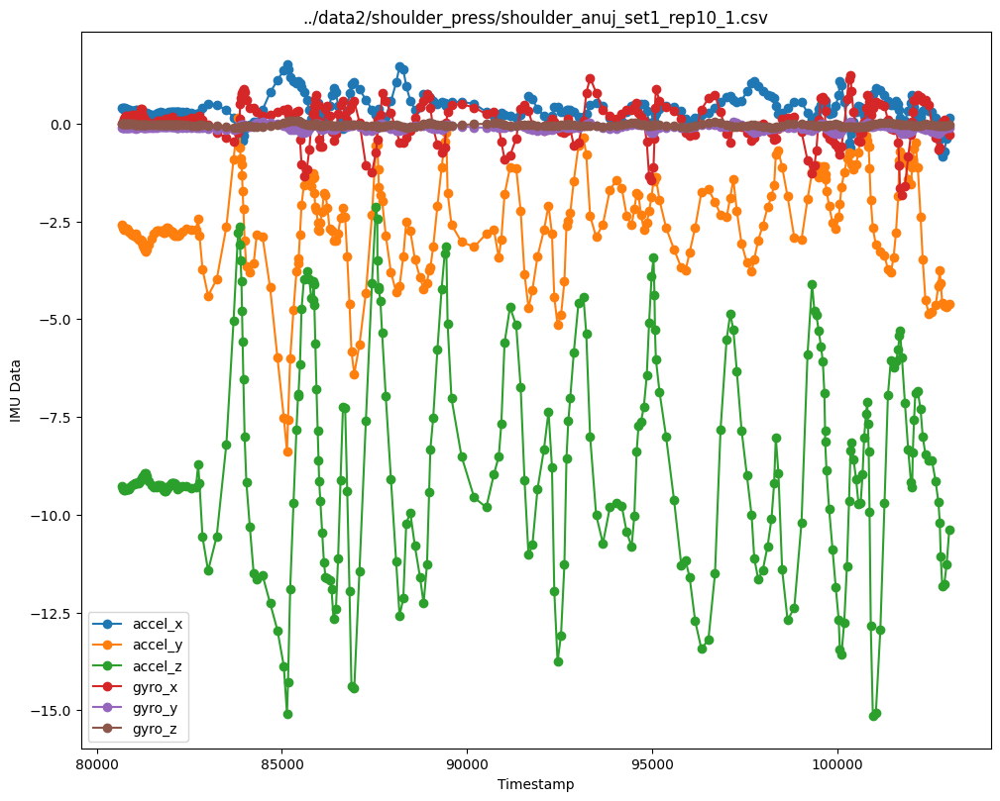

../data2/shoulder_press/shoulder_kamyar_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    4503192    0.786   -3.842   -7.329  -0.189  -0.130  -0.020
1    4503214    1.010   -3.777   -7.752  -0.050  -0.073  -0.043
2    4503218    1.010   -3.777   -7.752   0.056  -0.073  -0.043
3    4503221    1.010   -3.777   -7.752   0.056  -0.073  -0.043
4    4503244    1.182   -4.003   -8.048   0.577   0.017  -0.049


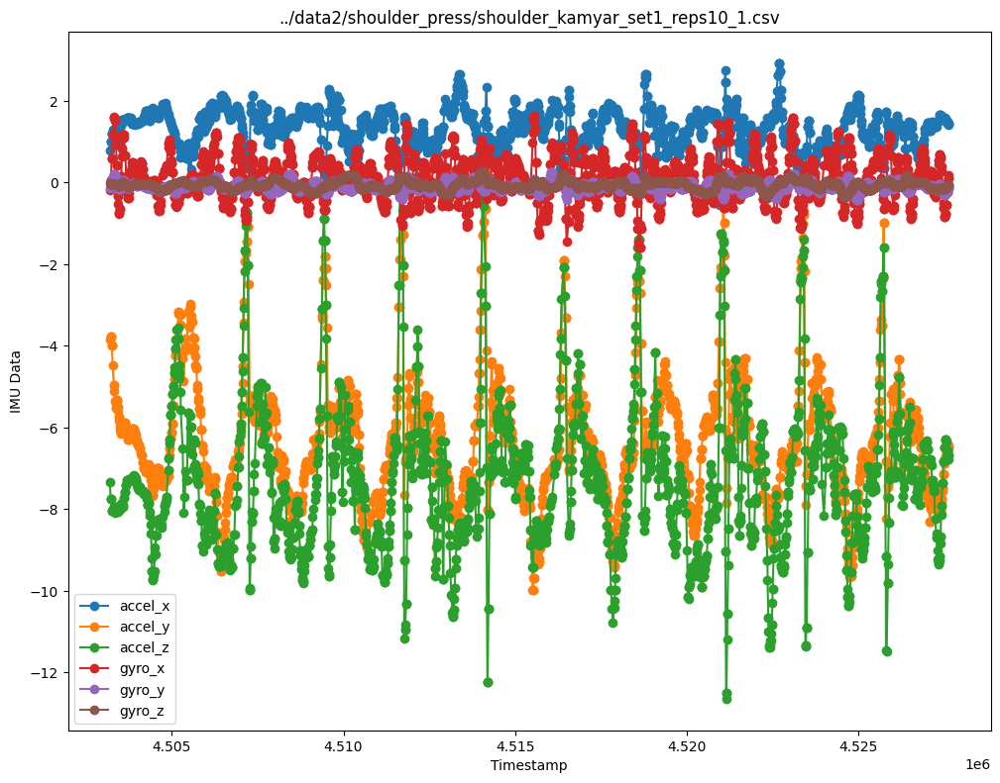

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  4.503197e+06  0.829371 -3.801091 -7.430483 -0.235580 -0.123643 -0.028049
1  4.503279e+06  1.254464 -4.532512 -8.019542  1.213289  0.129617 -0.040833
2  4.503384e+06  0.979296 -5.435397 -7.996975  0.714181  0.072200 -0.051848
3  4.503455e+06  1.195859 -5.762117 -8.031254 -0.757813 -0.167674 -0.093936
4  4.503538e+06  1.476125 -6.131071 -7.869376  0.530616 -0.035571 -0.029415


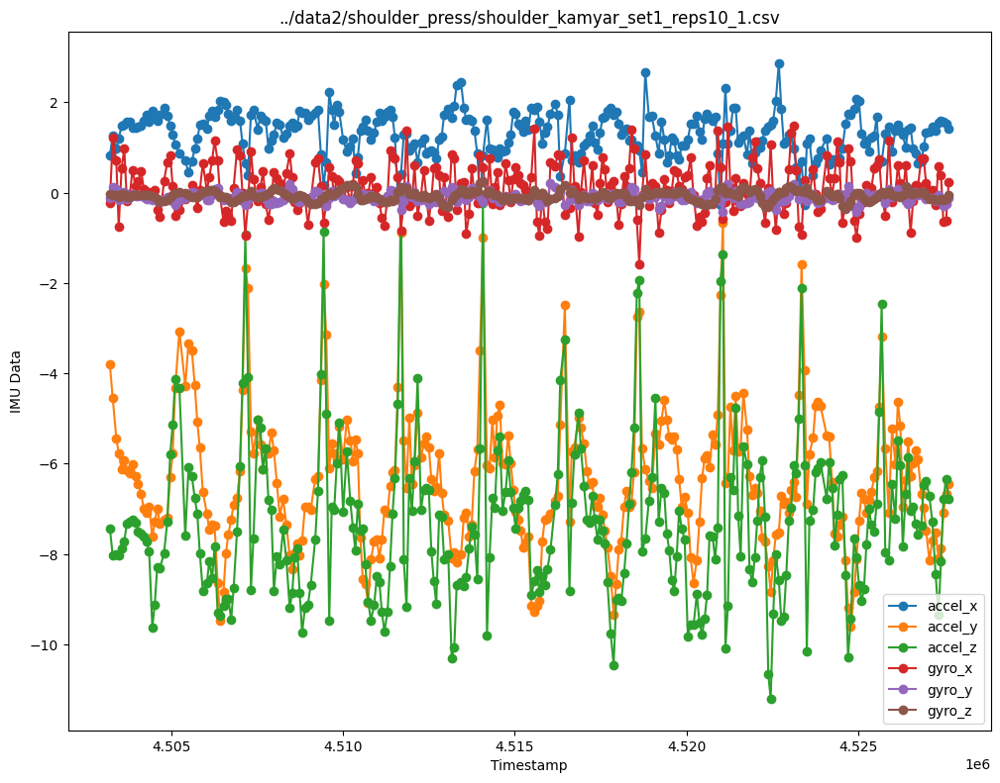

../data2/shoulder_press/shoulder_mike_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    3255276    1.411   -7.743   -5.636   0.034  -0.095  -0.111
1    3255280    1.411   -7.743   -5.636   0.034  -0.095  -0.111
2    3255284    1.411   -7.743   -5.618   0.034  -0.095  -0.111
3    3255287    1.436   -7.700   -5.618   0.028  -0.090  -0.109
4    3255309    1.467   -7.665   -5.731   0.017  -0.088  -0.104


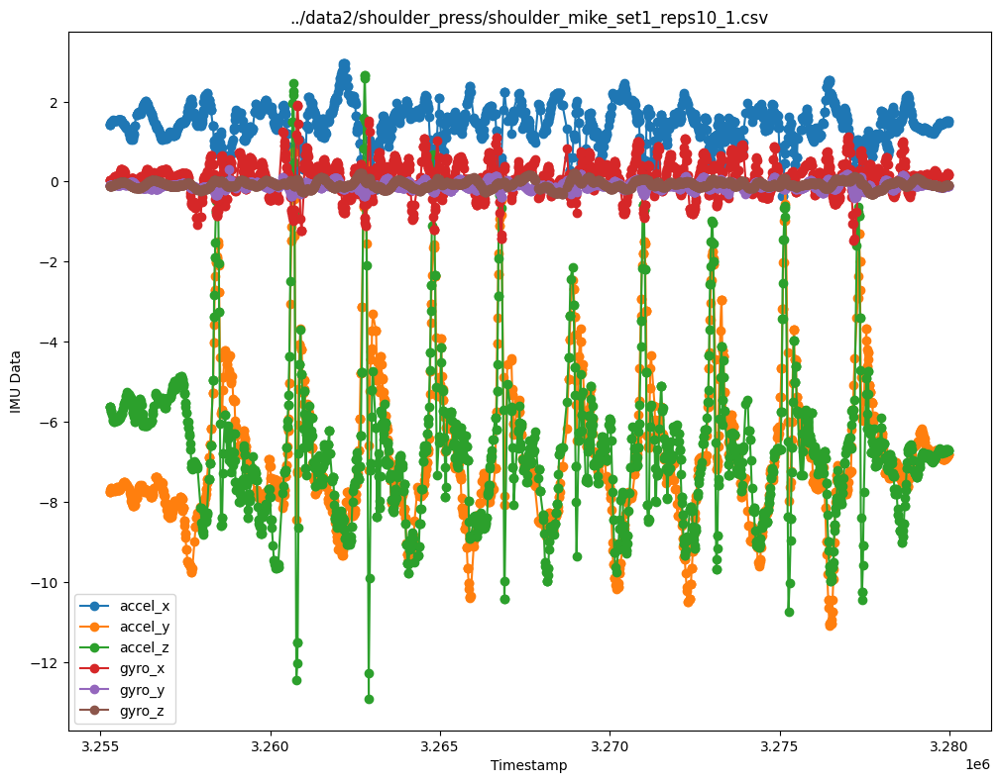

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  3.255273e+06  1.400685 -7.758427 -5.617329  0.041692 -0.096545 -0.111538
1  3.255328e+06  1.491363 -7.673663 -5.790679  0.021600 -0.082883 -0.101011
2  3.255409e+06  1.528926 -7.714121 -5.973481  0.119386 -0.073055 -0.073908
3  3.255501e+06  1.531212 -7.665093 -5.951992  0.087216 -0.086224 -0.046661
4  3.255567e+06  1.545254 -7.697260 -5.904326  0.176429 -0.083641 -0.022393


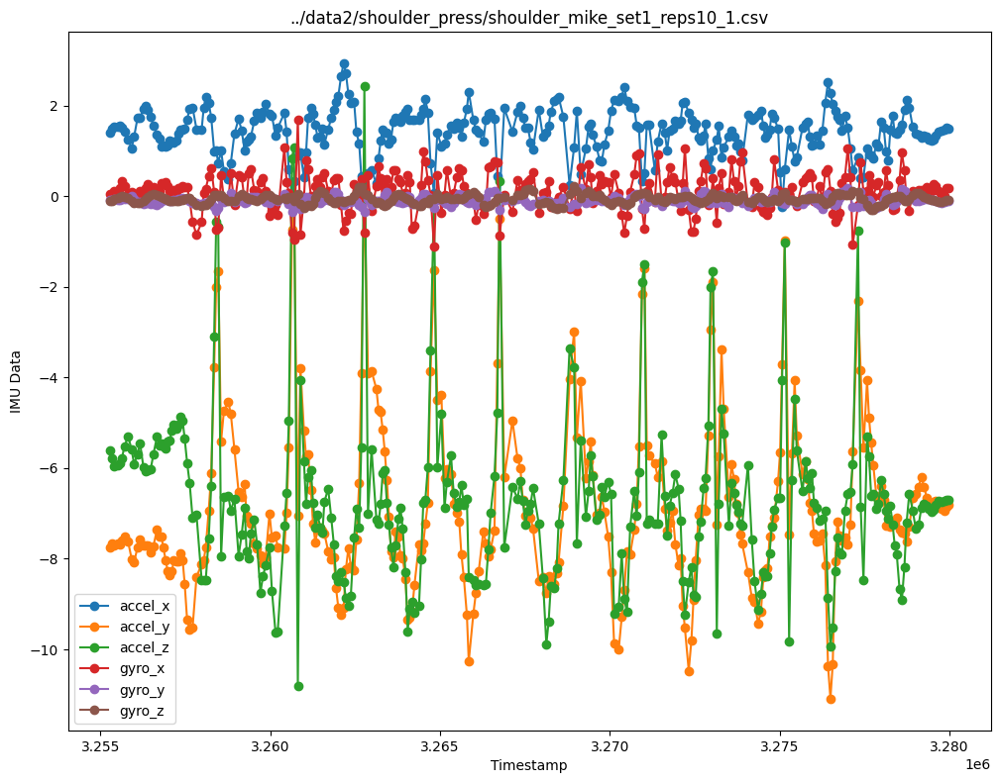

../data2/shoulder_press/shoulder_suzan_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     143074    1.015    5.903   -8.028  -0.013  -0.020  -0.160
1     143078    1.068    5.945   -7.883  -0.013  -0.020  -0.169
2     143081    1.068    5.945   -7.883   0.001  -0.044  -0.169
3     143188    0.833    6.165   -7.199   0.062  -0.039  -0.132
4     143257    0.559    6.101   -7.700   0.512  -0.072  -0.112


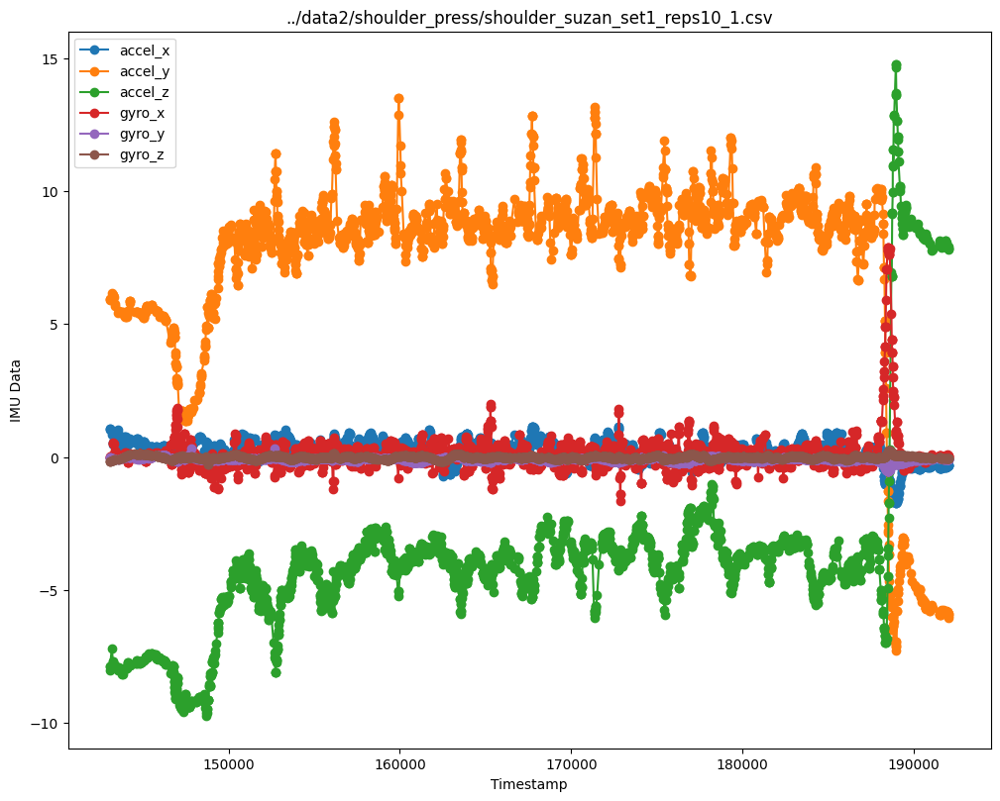

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  143068.265734  1.224503  5.840406 -7.972070 -0.172350 -0.014853 -0.173168
1  143326.735279  0.595781  5.861011 -7.828400  0.389795 -0.088436 -0.097853
2  143904.631904  0.601791  5.378745 -8.039977  0.062367 -0.031295 -0.009262
3  144142.396068  0.504702  5.609446 -7.779792 -0.126920  0.002785  0.072057
4  144617.999595  0.676797  5.456168 -7.715971  0.029191 -0.070815  0.111588


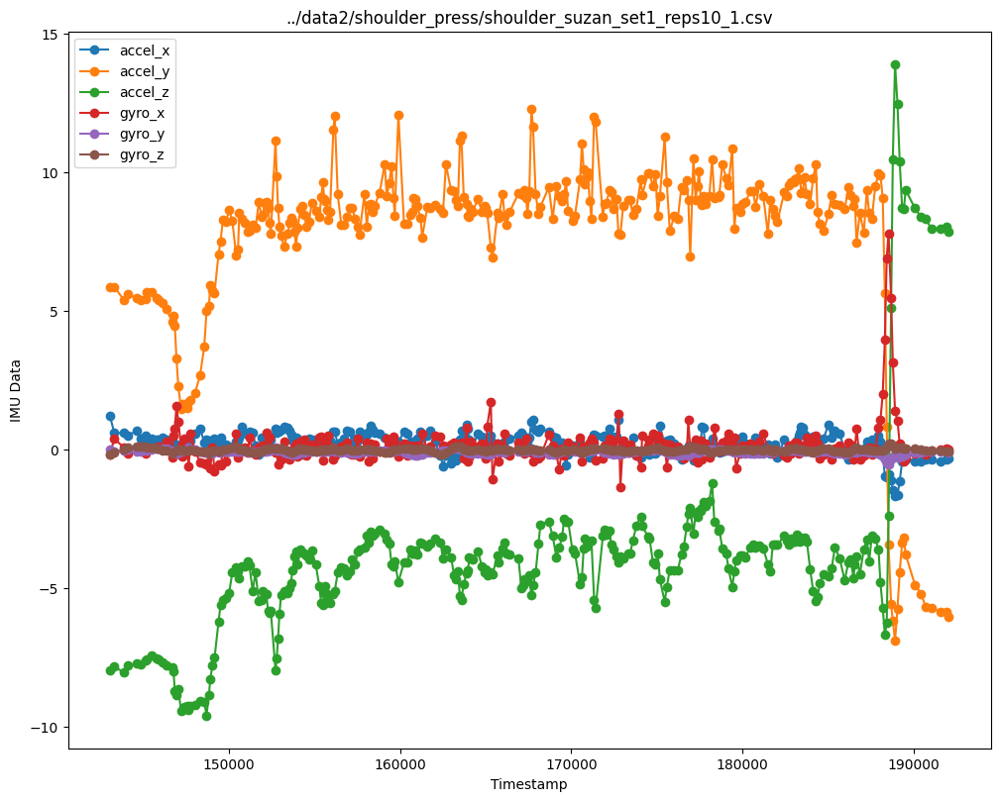

../data2/shoulder_press/shoulder_udai_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     229441   -0.553   -9.671    0.471  -0.192  -0.097  -0.055
1     229445   -0.498   -9.856    0.438  -0.192  -0.109  -0.061
2     229449   -0.498   -9.856    0.438  -0.159  -0.109  -0.061
3     229452   -0.498   -9.856    0.438  -0.159  -0.109  -0.061
4     229474   -0.491   -9.925    0.367   0.000  -0.108  -0.057


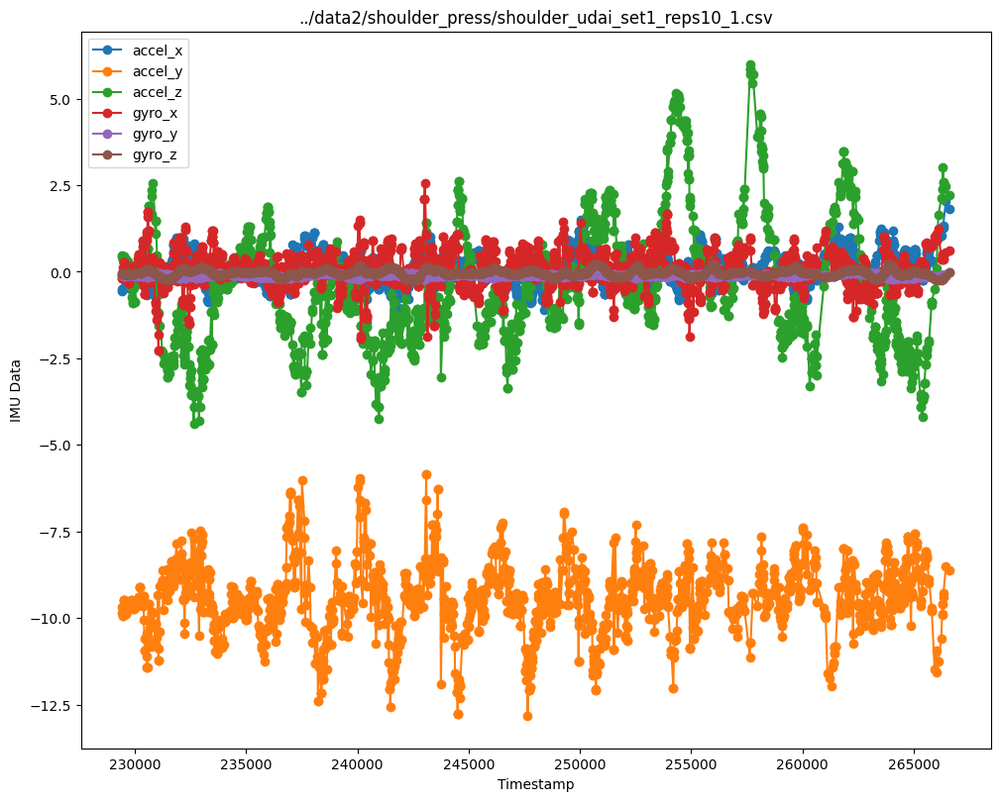

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  229444.797203 -0.519748 -9.844881  0.452573 -0.335350 -0.098308 -0.060175
1  229500.289988 -0.477319 -9.678637  0.430367  0.174642 -0.115558 -0.060581
2  229635.666838 -0.344327 -9.805342  0.209504 -0.121888 -0.104000 -0.080918
3  229699.677035 -0.442773 -9.663076  0.151914 -0.230246 -0.098922 -0.083307
4  229853.342993 -0.300249 -9.552107 -0.409201 -0.098464 -0.101665 -0.072313


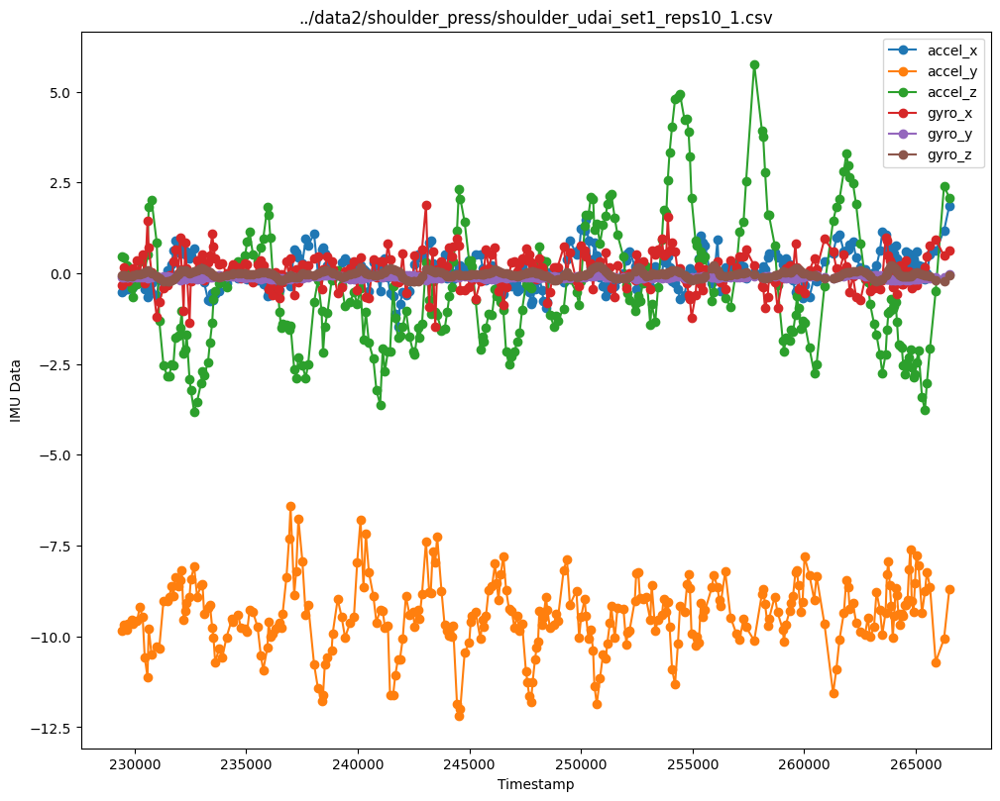

../data2/shoulder_press/shoulder_suzan_set3_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     241311    0.024   -1.347    9.913   0.017  -0.071  -0.033
1     241315    0.024   -1.347    9.913   0.017  -0.071  -0.033
2     241318    0.059   -1.366    9.940   0.031  -0.071  -0.034
3     241322    0.059   -1.366    9.940   0.031  -0.071  -0.034
4     241344    0.069   -1.474    9.969   0.095  -0.092  -0.034


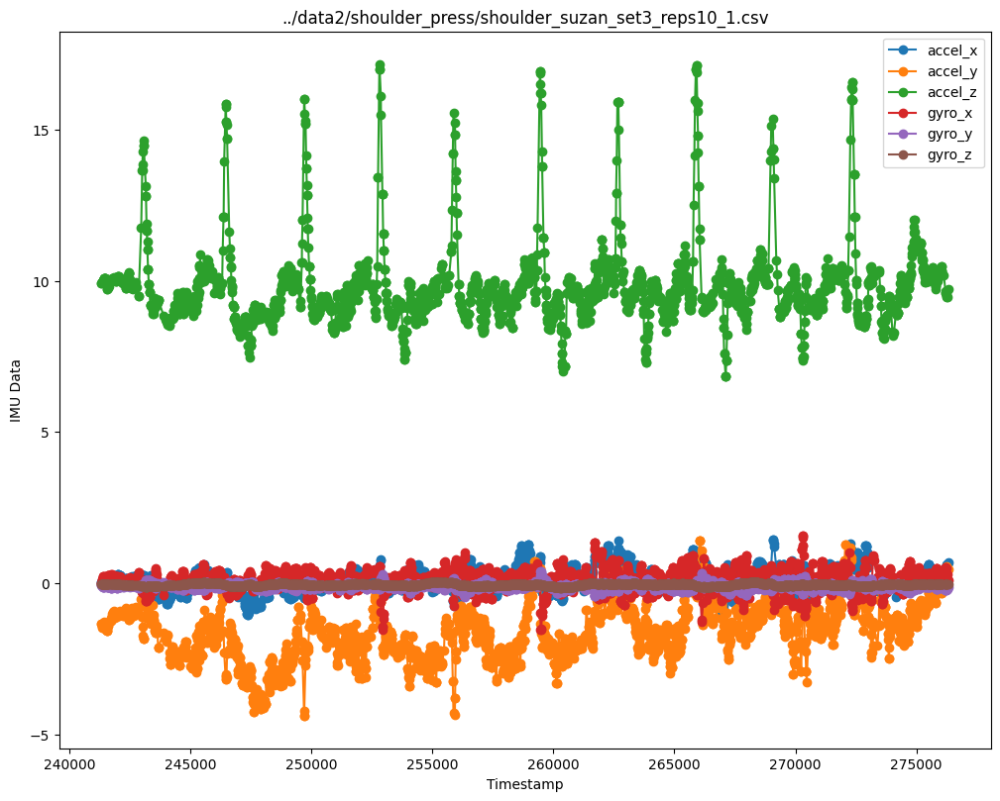

       timestamp   accel_x   accel_y    accel_z    gyro_x    gyro_y    gyro_z
0  241309.433566  0.013986 -1.324161   9.907818 -0.024245 -0.059692 -0.033923
1  241392.473092  0.165811 -1.363022  10.049351  0.223179 -0.125581 -0.032876
2  241486.415378  0.044670 -1.443278  10.005626 -0.004134 -0.068403 -0.041329
3  241566.905131 -0.060995 -1.427260   9.758643  0.230769 -0.130043 -0.034434
4  241767.715766  0.032677 -1.016142  10.064879  0.197556 -0.123344 -0.027931


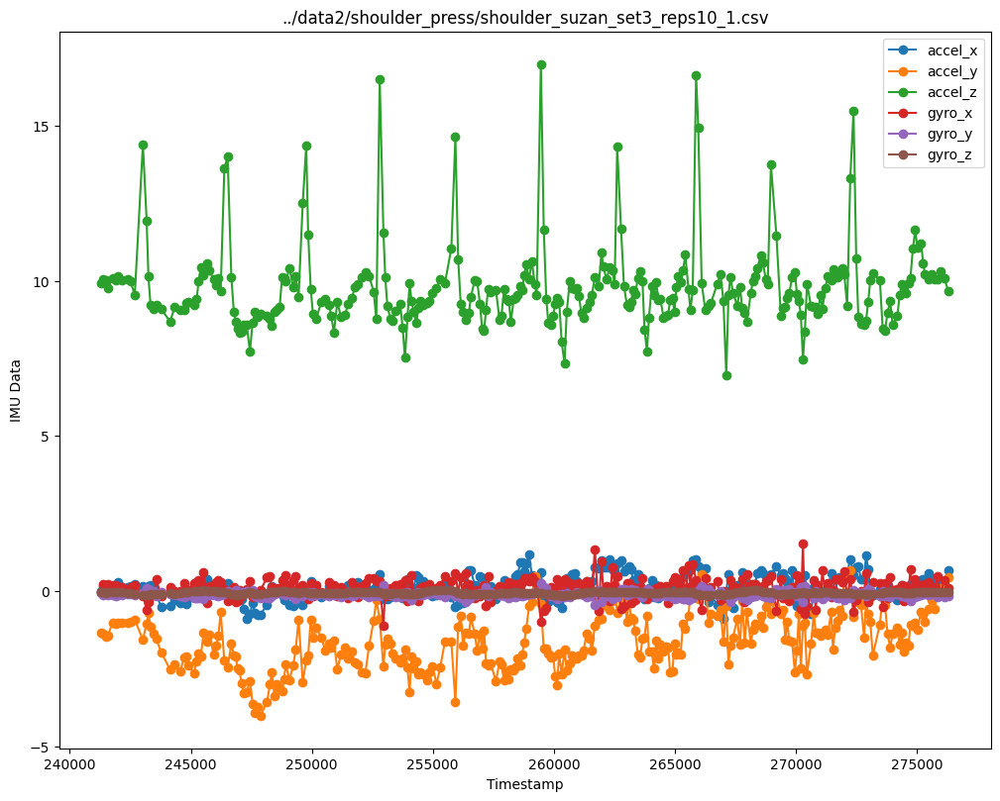

../data2/row/row_adam_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    1577087   -1.437    1.893    9.455   0.172  -0.142   0.070
1    1577091   -1.321    1.892    9.498   0.172  -0.142   0.070
2    1577094   -1.321    1.892    9.498   0.183  -0.154   0.076
3    1577098   -1.321    1.892    9.498   0.183  -0.154   0.076
4    1577121   -1.126    2.171   10.057   0.255  -0.181   0.087


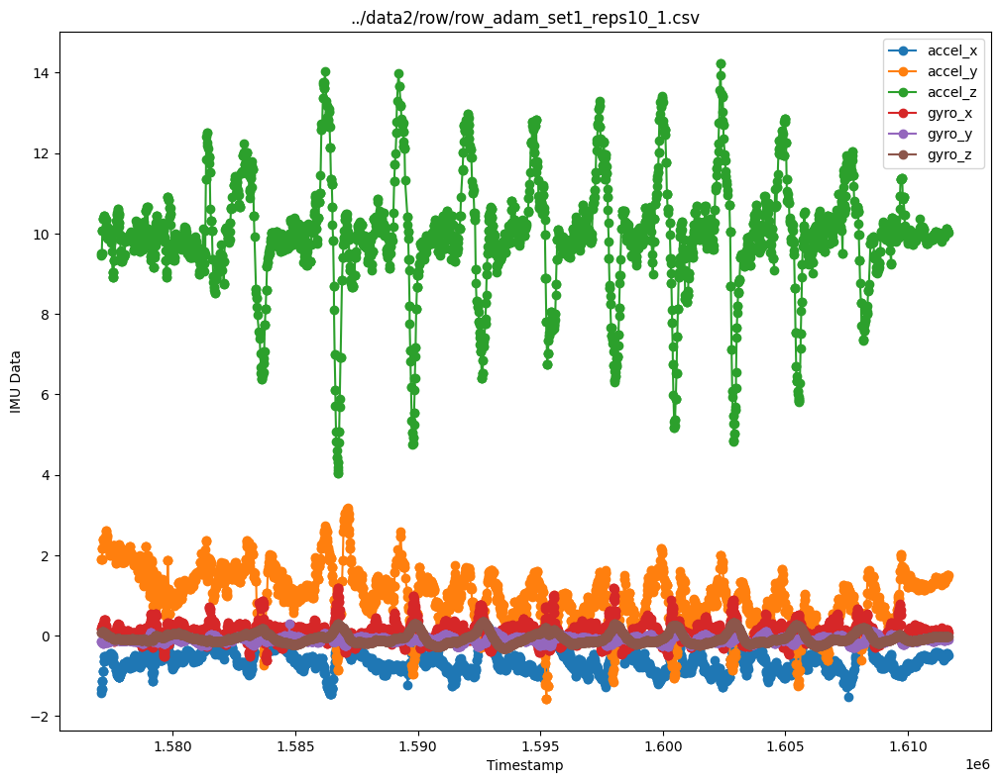

      timestamp   accel_x   accel_y    accel_z    gyro_x    gyro_y    gyro_z
0  1.577084e+06 -1.411273  1.817790   9.335203  0.158888 -0.134734  0.066776
1  1.577174e+06 -0.725325  2.388751  10.421869  0.315301 -0.186462  0.084007
2  1.577297e+06 -0.551927  2.538576  10.213660  0.107008 -0.158261  0.023235
3  1.577394e+06 -0.569605  2.162851   9.977178 -0.060973 -0.155966 -0.023456
4  1.577500e+06 -0.455560  2.117489   9.553686  0.075146 -0.105369 -0.051482


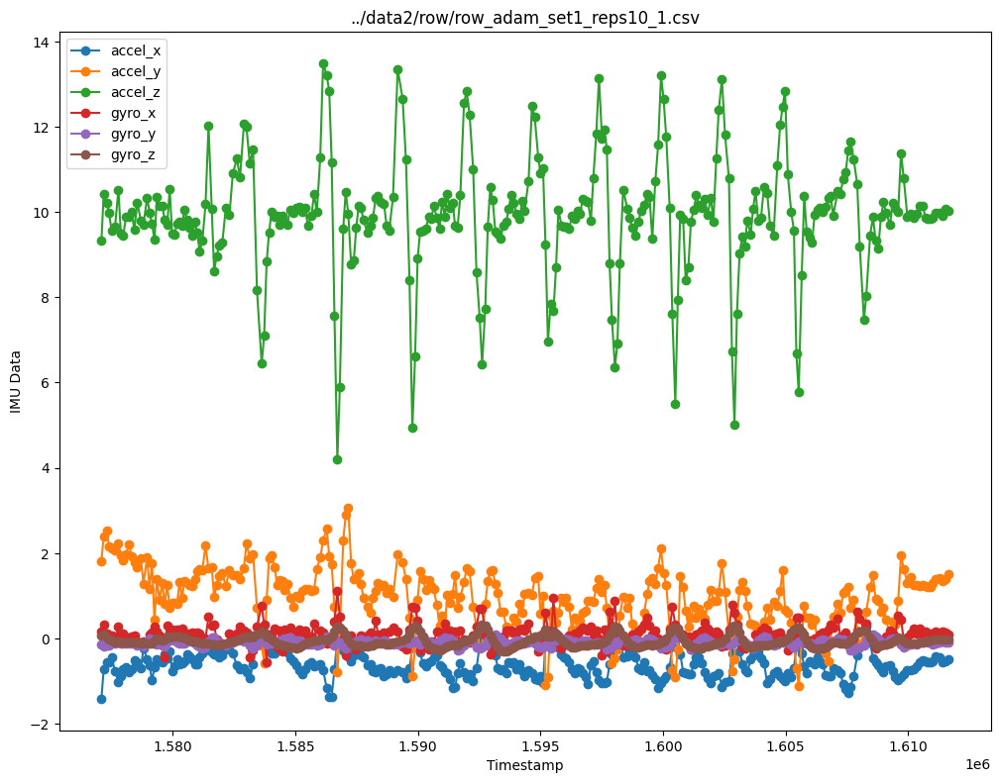

../data2/row/row_andrew_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     580903   -0.026   -0.784   10.019   0.574  -0.115  -0.022
1     580907   -0.063   -0.672   10.053   0.574  -0.119  -0.024
2     580910   -0.063   -0.672   10.053   0.574  -0.119  -0.024
3     581017   -0.044   -0.238   10.034   0.468  -0.114  -0.032
4     581024   -0.002   -0.140   10.030   0.457  -0.116  -0.035


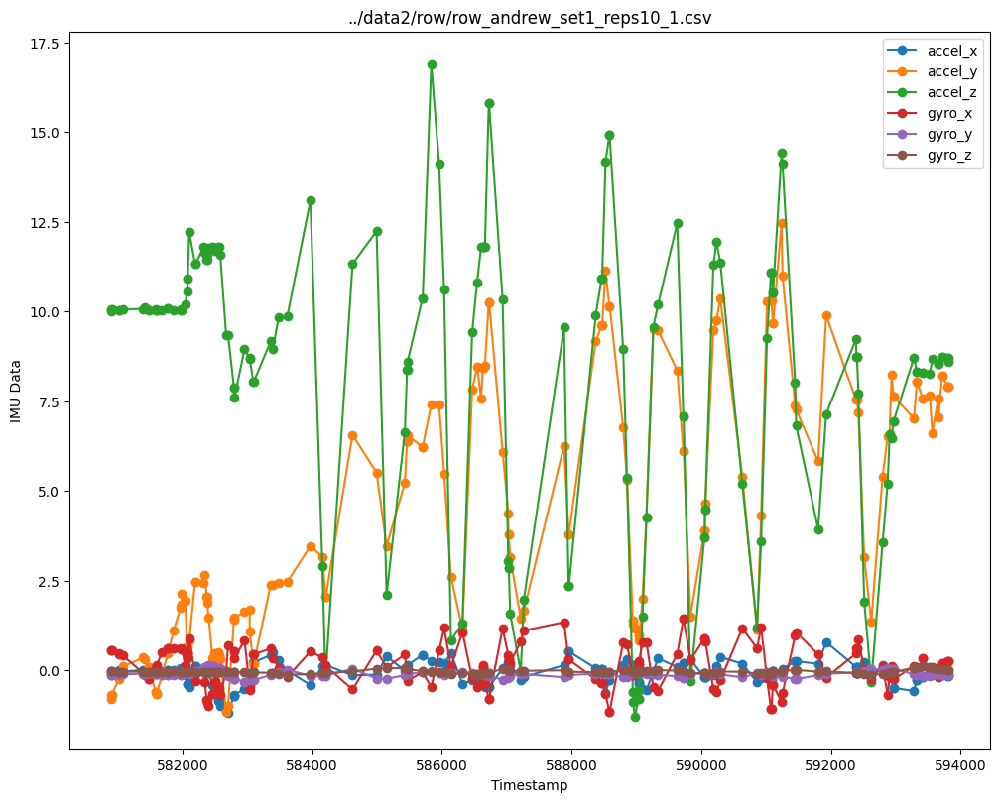

       timestamp   accel_x   accel_y    accel_z    gyro_x    gyro_y    gyro_z
0  580845.979021 -0.058713 -1.026224  10.023168  0.697336 -0.122685 -0.020119
1  580877.179947 -0.050902 -0.829956  10.029734  0.640907 -0.120492 -0.022217
2  580908.868817 -0.043406 -0.640221  10.036105  0.584701 -0.118291 -0.024289
3  580942.666862 -0.037276 -0.478725  10.041627  0.529461 -0.116058 -0.026252
4  580977.440793 -0.031778 -0.330295  10.046756  0.474667 -0.113809 -0.028164


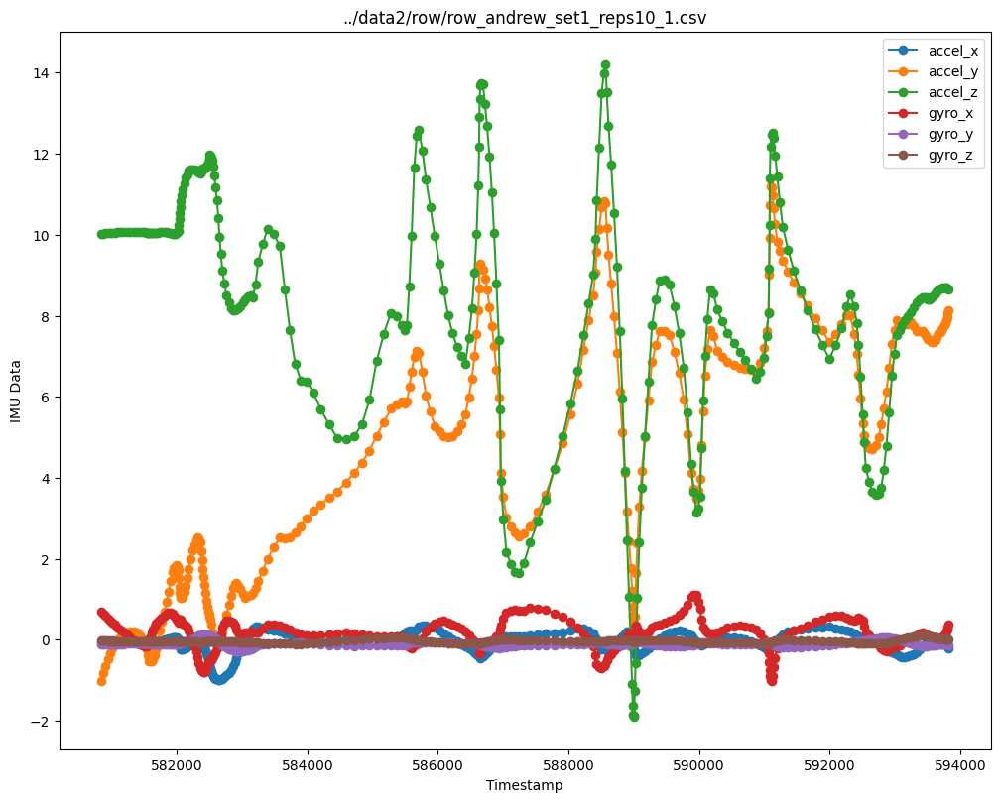

../data2/row/row_anuj_set1_rep10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     454515   -0.218    2.271    9.934   0.187  -0.073  -0.054
1     454519   -0.276    2.322    9.988   0.159  -0.078  -0.055
2     454523   -0.276    2.322    9.988   0.159  -0.078  -0.055
3     454526   -0.276    2.323    9.945   0.159  -0.078  -0.055
4     454546   -0.233    2.246    9.998   0.039  -0.088  -0.055


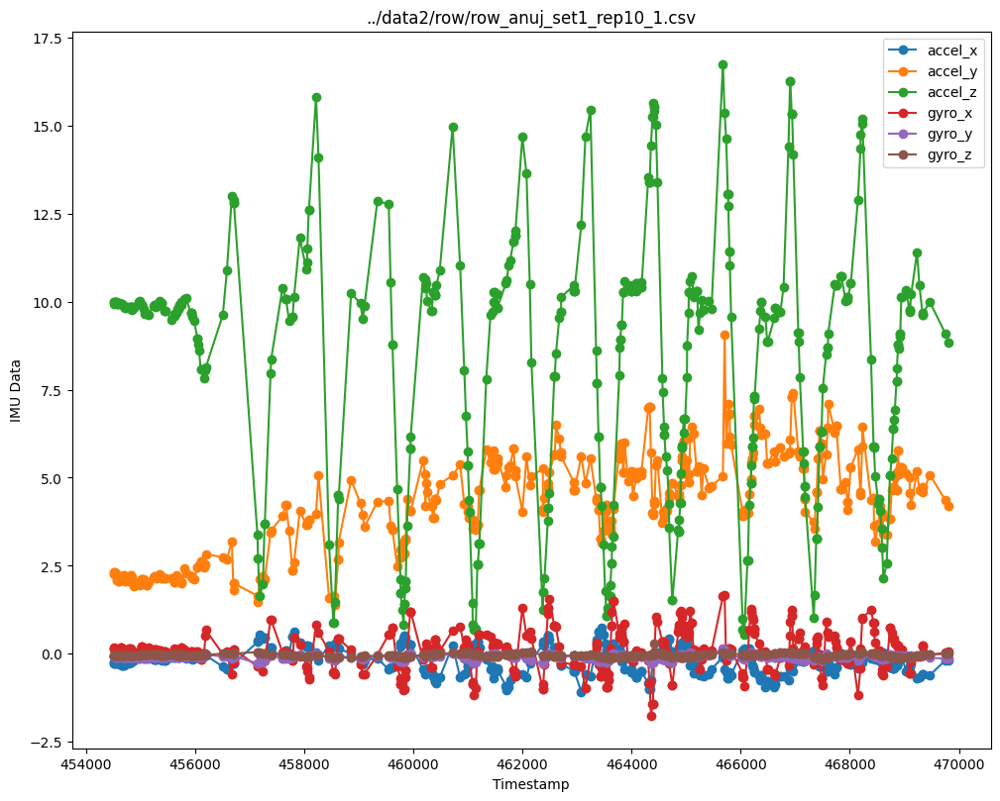

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  454513.111888 -0.252161  2.311161  9.953308  0.216895 -0.071699 -0.054070
1  454522.230690 -0.250629  2.302116  9.970454  0.145221 -0.078259 -0.054839
2  454532.991141 -0.251112  2.281590  9.980297  0.090870 -0.083361 -0.055231
3  454545.658507 -0.253935  2.247727  9.981657  0.056638 -0.086770 -0.055182
4  454560.798513 -0.252039  2.182680  9.968288  0.031898 -0.089187 -0.054725


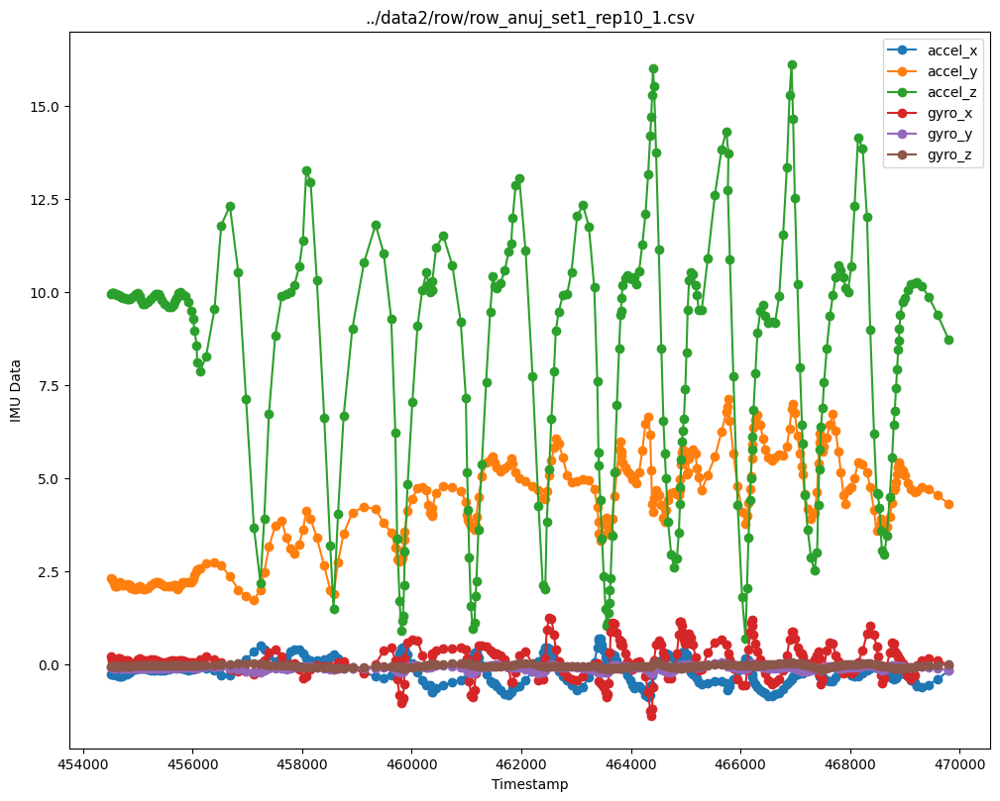

../data2/row/row_jake_set1_reps12_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     898566    0.476    1.366   10.038   0.084  -0.115  -0.031
1     898569    0.499    1.366   10.038   0.042  -0.098  -0.023
2     898573    0.499    1.366   10.038   0.042  -0.098  -0.023
3     898577    0.474    1.365    9.988   0.020  -0.103  -0.032
4     898628    0.530    1.326    9.945   0.077  -0.100  -0.029


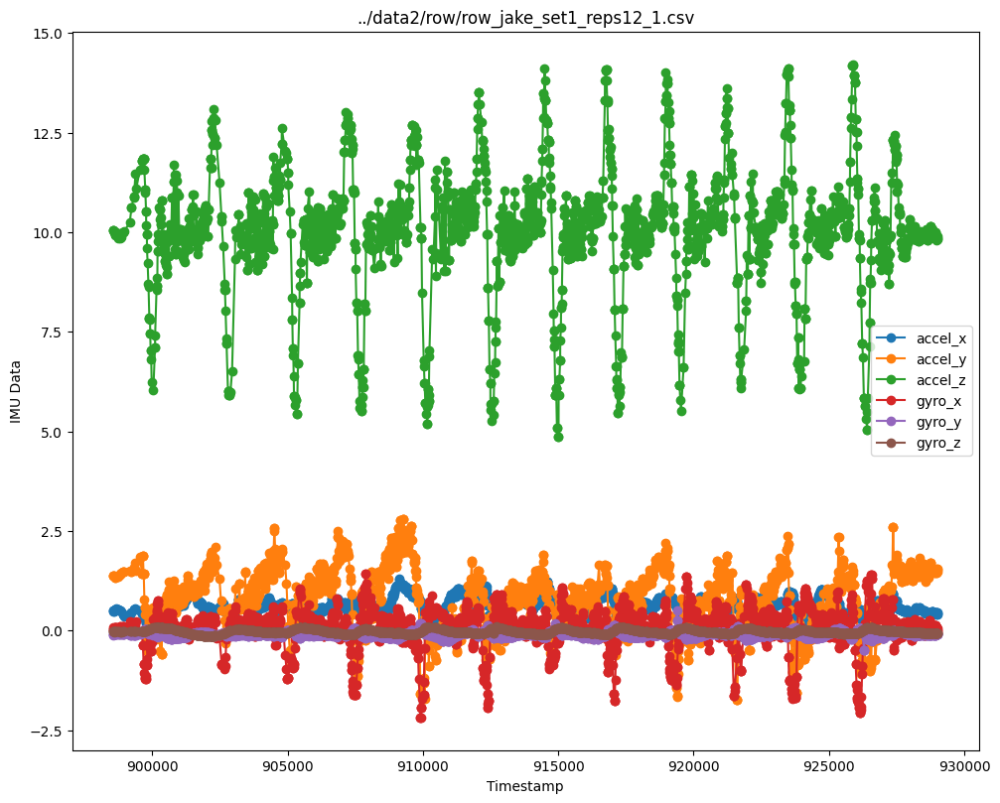

       timestamp   accel_x   accel_y    accel_z    gyro_x    gyro_y    gyro_z
0  898566.881119  0.472587  1.376462  10.048322  0.059615 -0.107007 -0.027133
1  898705.176431  0.532753  1.359781   9.895055  0.073727 -0.093342 -0.029967
2  898996.098697  0.392148  1.475628  10.071424  0.107714 -0.092781 -0.030231
3  899399.058010  0.532273  1.631062  11.202302  0.073823 -0.110718 -0.024205
4  899656.234683  0.435764  1.720382  11.896538 -0.460943 -0.027580 -0.021121


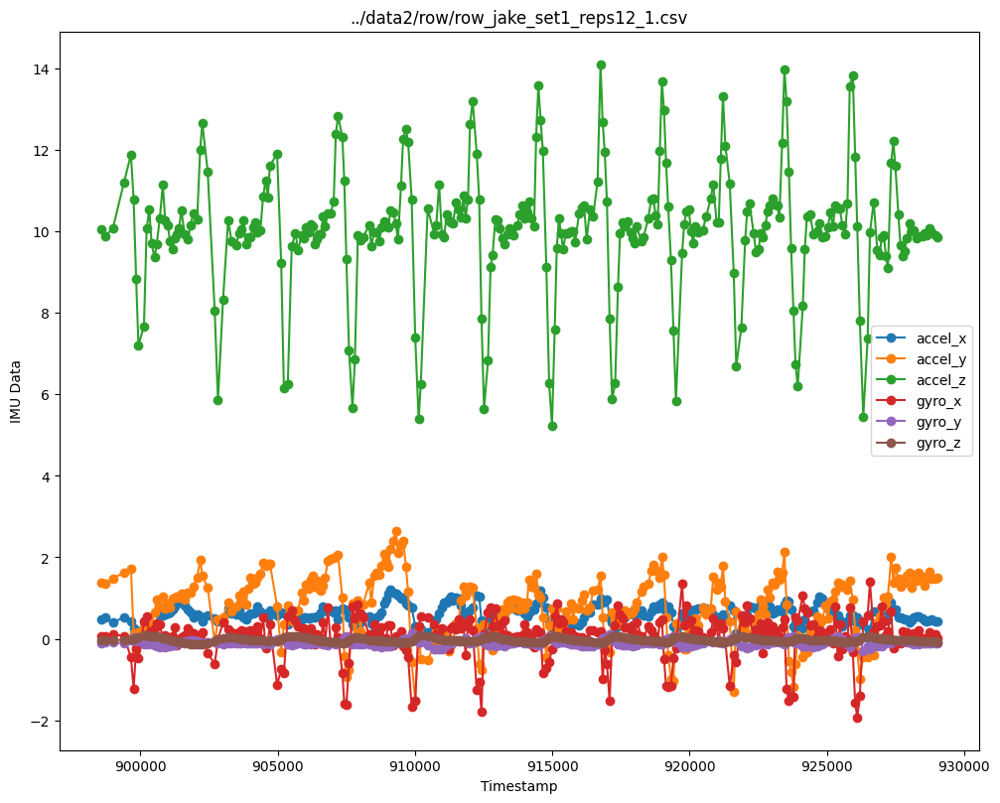

../data2/row/row_kamyar_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    4302248   -0.863    2.584    9.903   0.101  -0.181   0.004
1    4302251   -0.863    2.584    9.903   0.101  -0.181   0.004
2    4302255   -0.899    2.651    9.933   0.137  -0.170   0.001
3    4302258   -0.899    2.651    9.933   0.137  -0.170   0.001
4    4302280   -0.787    2.711    9.811   0.182  -0.161   0.001


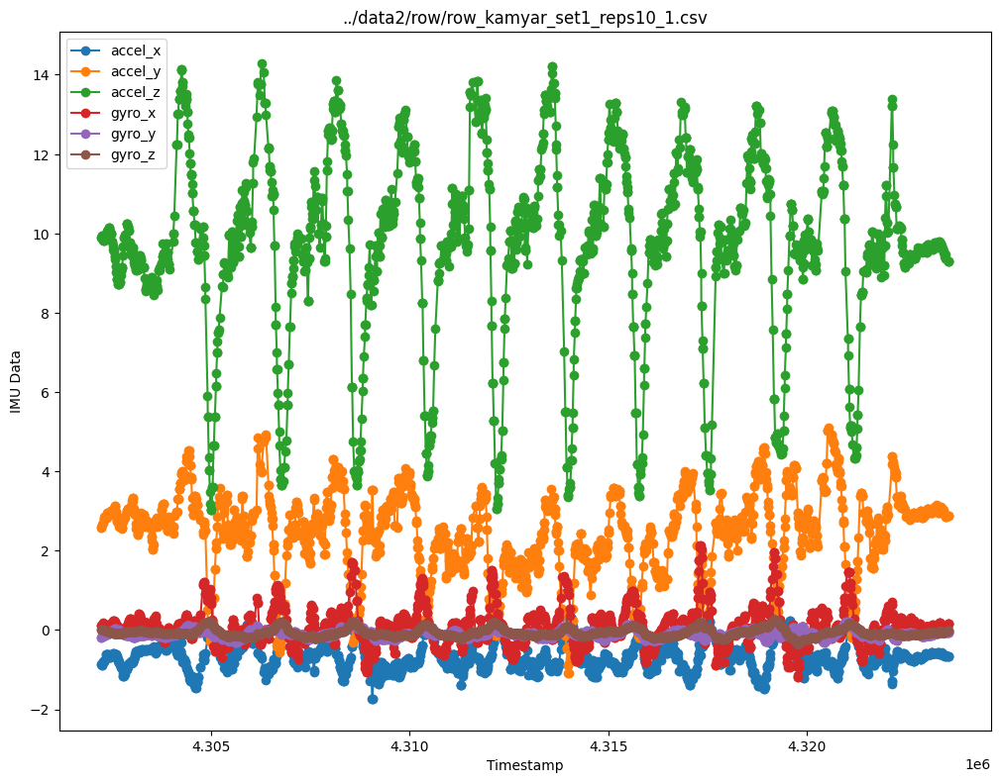

      timestamp   accel_x   accel_y    accel_z    gyro_x    gyro_y    gyro_z
0  4.302243e+06 -0.872517  2.548049   9.930182  0.099007 -0.180923  0.004084
1  4.302309e+06 -0.785948  2.799002   9.848906  0.147010 -0.149612 -0.008284
2  4.302391e+06 -0.615426  2.901379   9.972175  0.097652 -0.104922 -0.034575
3  4.302447e+06 -0.665173  2.942494  10.090542  0.082202 -0.069341 -0.053775
4  4.302505e+06 -0.632582  2.988366   9.902443  0.158153 -0.018781 -0.069606


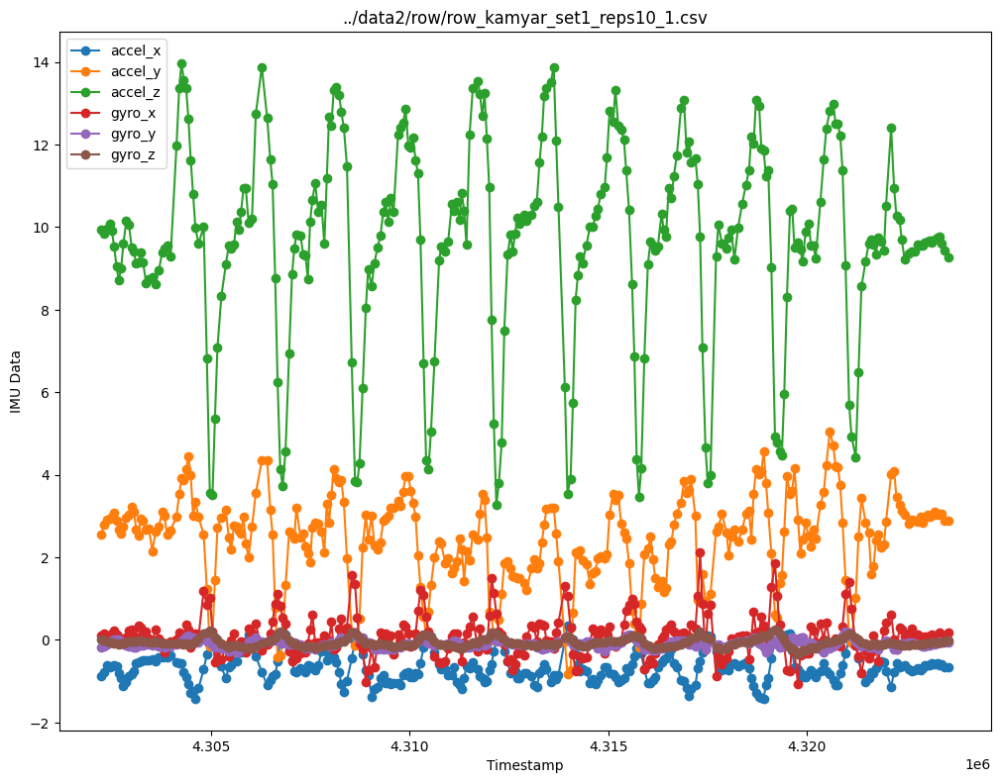

../data2/row/row_mike_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    3118118   -0.980    4.824    8.522   0.078  -0.066  -0.006
1    3118122   -0.980    4.824    8.522   0.078  -0.066  -0.006
2    3118125   -0.988    4.899    8.652   0.076  -0.062  -0.011
3    3118128   -0.988    4.899    8.652   0.076  -0.062  -0.011
4    3118179   -0.927    4.796    8.692   0.037  -0.066  -0.033


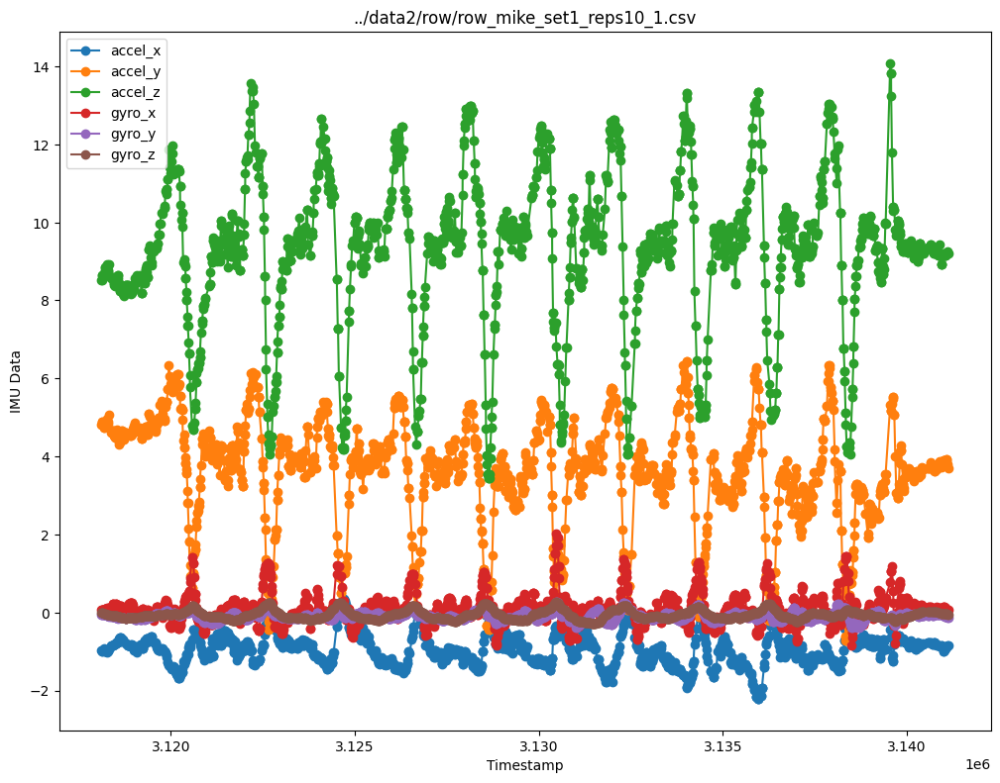

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  3.118112e+06 -0.990455  4.881741  8.546091  0.086713 -0.065531 -0.002231
1  3.118182e+06 -0.966393  4.796902  8.698795  0.062014 -0.064498 -0.032798
2  3.118265e+06 -1.013618  4.931875  8.870180  0.106521 -0.077047 -0.053883
3  3.118386e+06 -0.871362  4.736529  8.657820  0.156490 -0.104104 -0.078101
4  3.118460e+06 -0.828658  4.537888  8.420843  0.210928 -0.112160 -0.084495


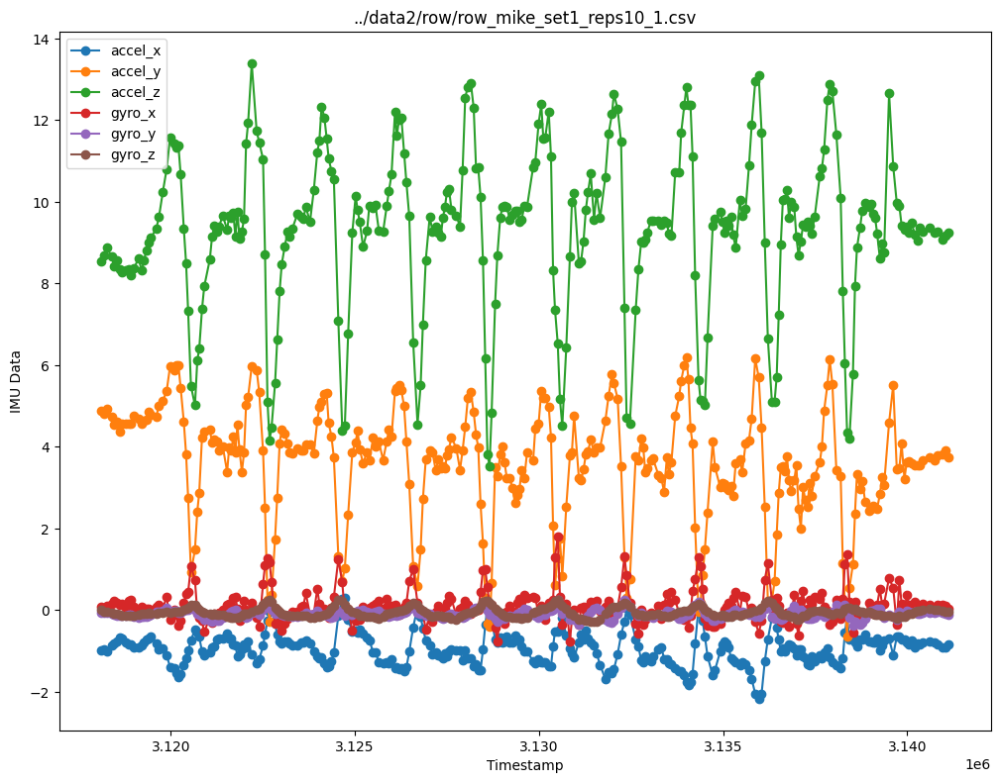

../data2/row/row_suzan_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     695771   -0.530   -6.700    8.566  -0.130  -0.075  -0.020
1     695775   -0.554   -6.541    8.211   0.050  -0.086  -0.012
2     695778   -0.554   -6.541    8.211   0.050  -0.086  -0.012
3     695782   -0.554   -6.541    8.211   0.050  -0.086  -0.012
4     695804   -0.457   -5.760    8.100   0.496  -0.136  -0.007


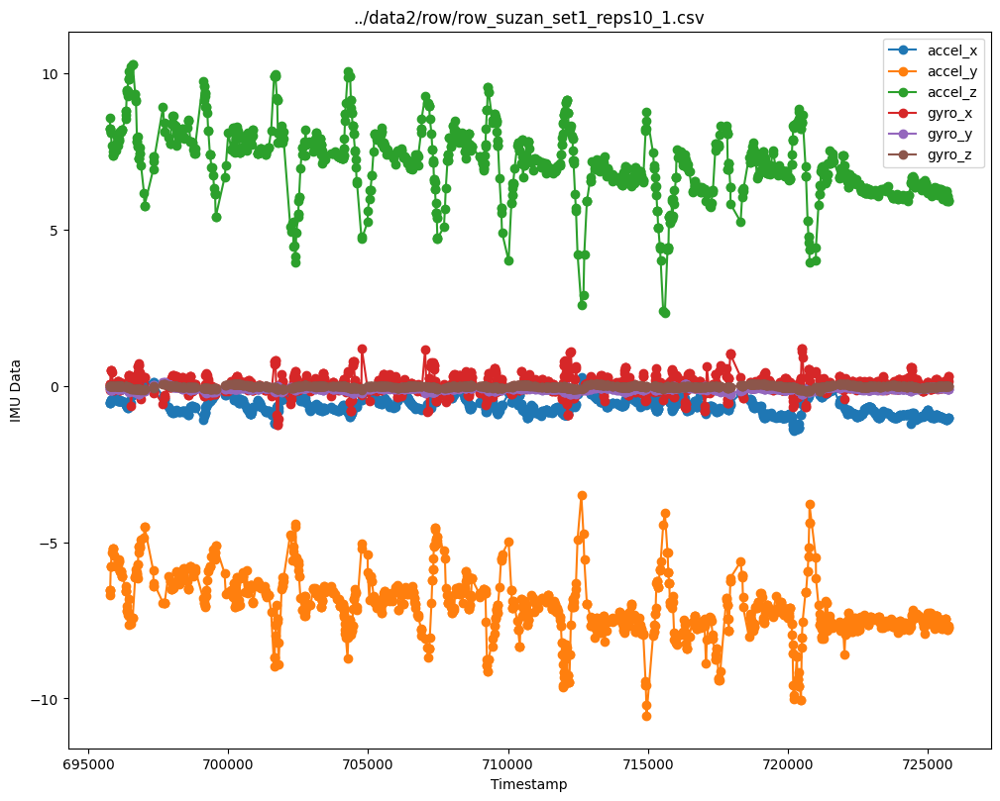

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  695770.265734 -0.561406 -6.825797  8.449140 -0.189406 -0.064622 -0.018280
1  695800.068280 -0.486603 -5.949500  8.066437  0.364902 -0.121208 -0.008012
2  695875.038107 -0.410559 -5.265275  7.535199  0.163022 -0.102820 -0.009772
3  695958.846466 -0.416912 -5.588247  7.574178 -0.059637 -0.078002 -0.007993
4  696019.659510 -0.443860 -5.778807  7.809918  0.079380 -0.090828 -0.003018


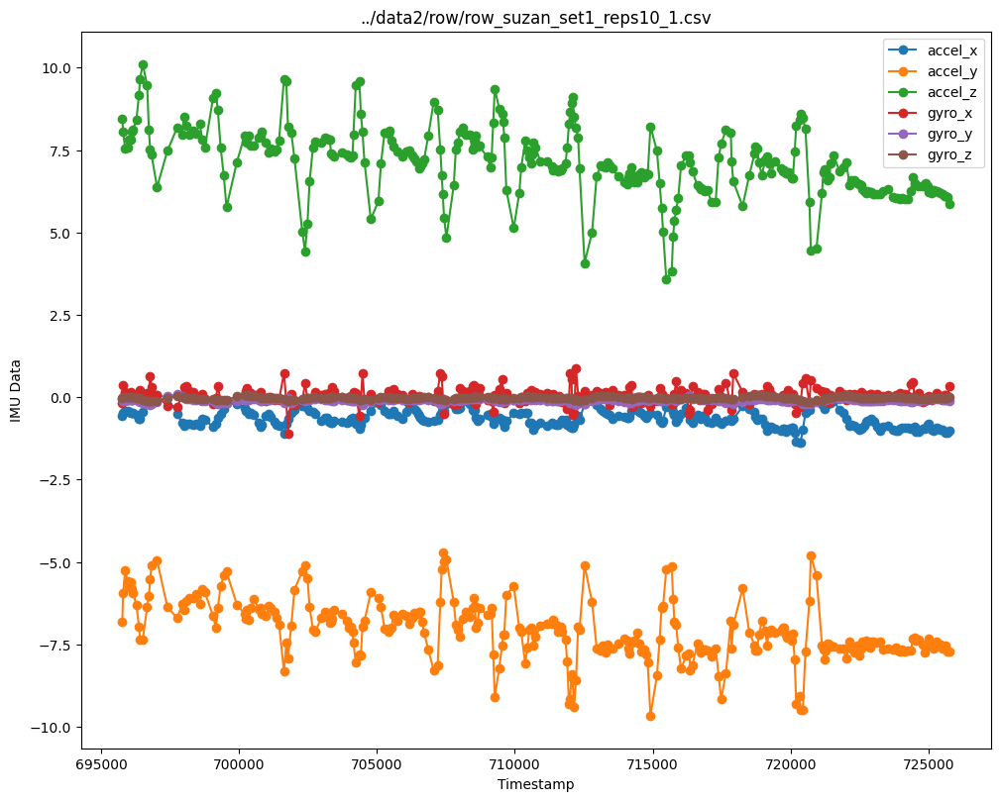

../data2/row/row_udai_set1_reps12_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     783218    0.329    2.722    9.705   0.158  -0.103  -0.011
1     783222    0.329    2.722    9.705   0.158  -0.103  -0.011
2     783225    0.329    2.722    9.705   0.158  -0.103  -0.011
3     783229    0.307    2.773    9.521   0.170  -0.110  -0.013
4     783251    0.275    2.545    9.411   0.130  -0.104  -0.012


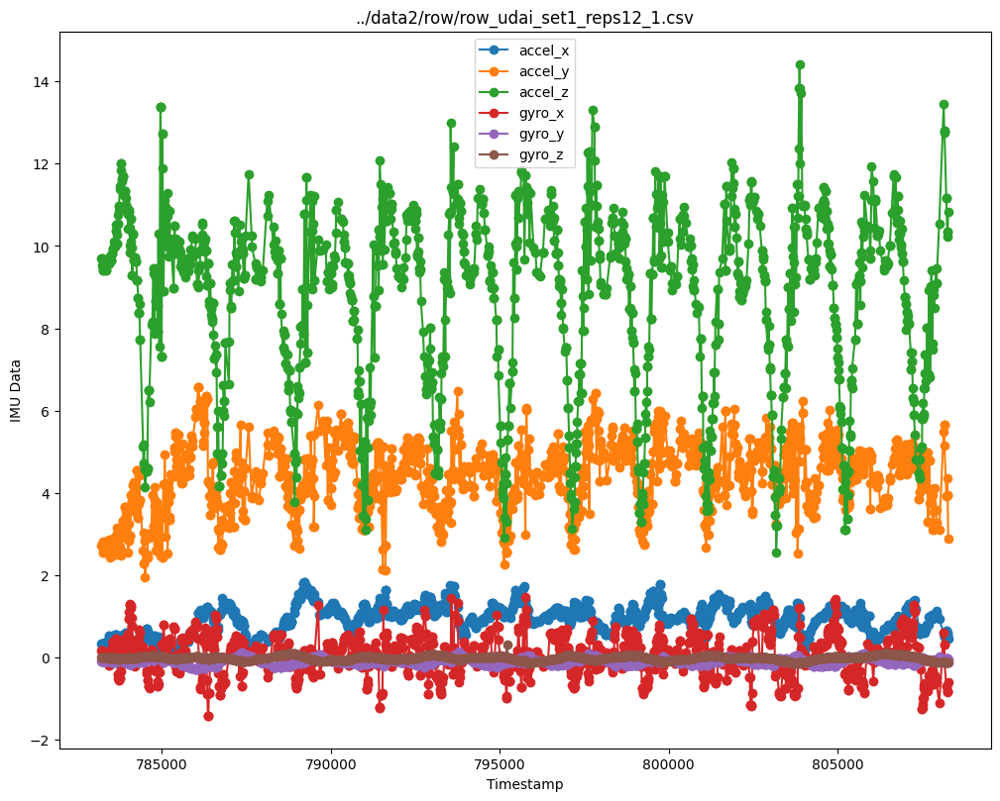

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  783216.279720  0.338091  2.725245  9.761797  0.166895 -0.103406 -0.010881
1  783259.756001  0.300072  2.669406  9.445409  0.110398 -0.103538 -0.012360
2  783321.579071  0.345423  2.691934  9.438969  0.027680 -0.100775 -0.013448
3  783432.297690  0.476210  2.653292  9.616903 -0.171055 -0.084336 -0.016971
4  783494.454234  0.456940  2.599157  9.706170  0.096480 -0.103604 -0.015454


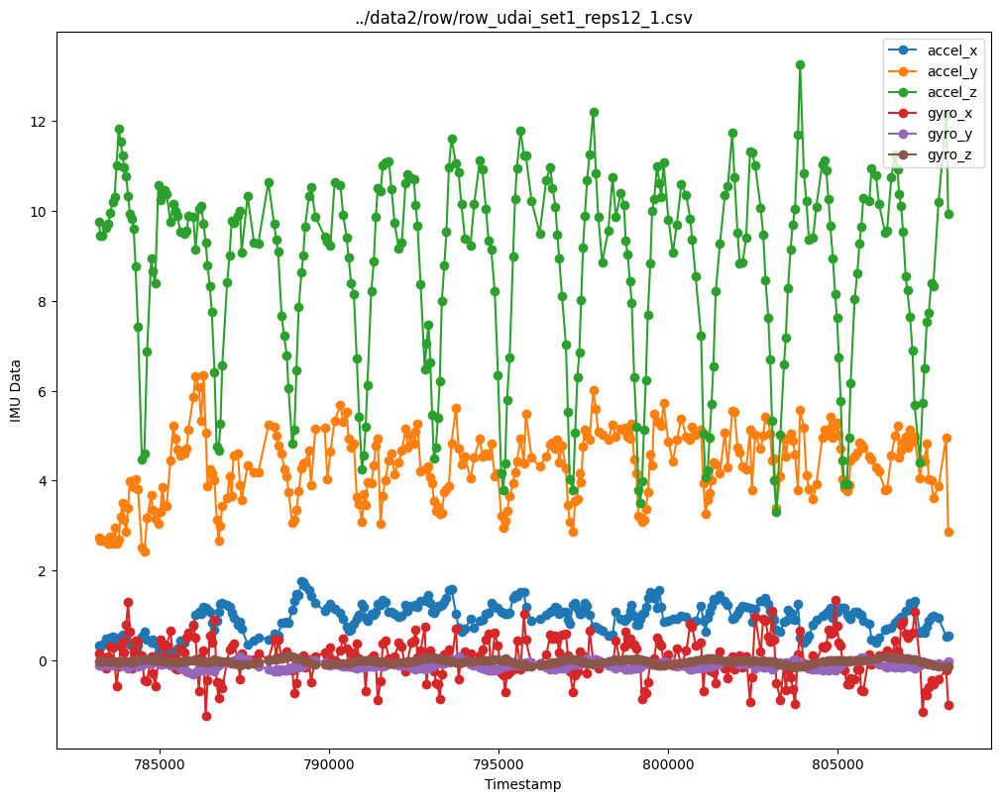

../data2/dead/dead_adam_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    1024535   -1.163    6.950    7.083   0.056  -0.079  -0.078
1    1024539   -1.163    6.950    7.083   0.056  -0.079  -0.078
2    1024542   -1.174    6.958    7.114   0.056  -0.079  -0.078
3    1024546   -1.174    6.958    7.114   0.083  -0.081  -0.078
4    1024598   -1.214    6.914    7.004   0.172  -0.065  -0.067


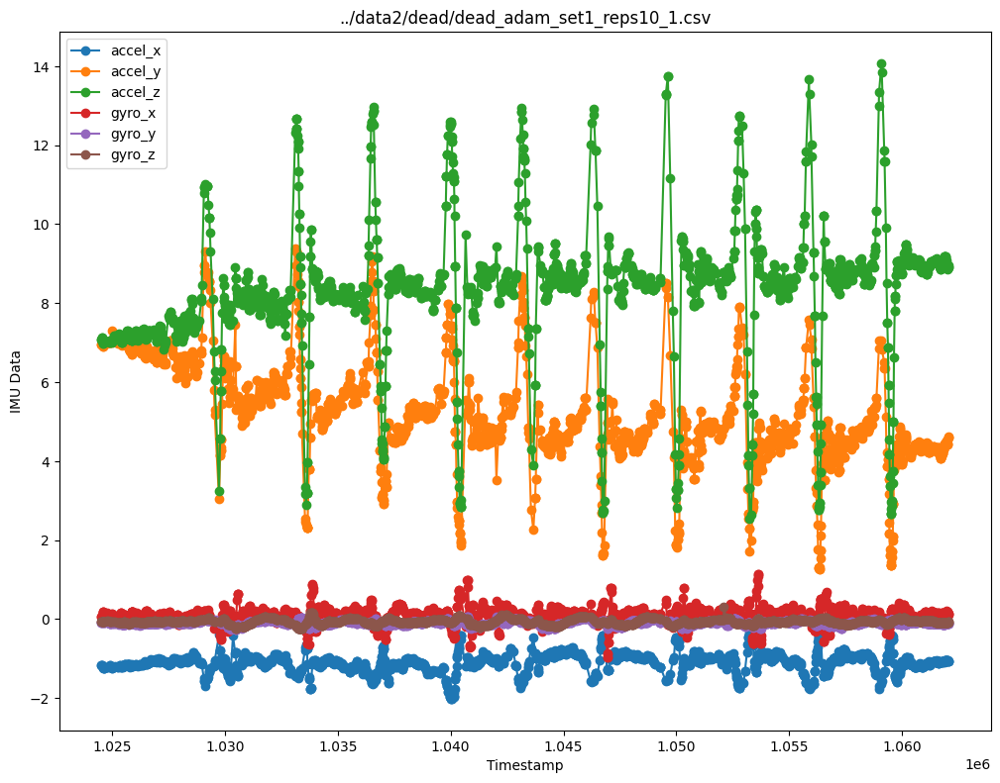

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  1.024525e+06 -1.152455  6.967538  7.119706  0.022993 -0.083566 -0.080692
1  1.024608e+06 -1.232564  6.957371  7.005638  0.142158 -0.071785 -0.062978
2  1.024826e+06 -1.205041  7.026939  7.034155  0.093354 -0.103992 -0.055575
3  1.025042e+06 -1.230513  7.106634  7.071191  0.099919 -0.115155 -0.063923
4  1.025348e+06 -1.185682  7.019495  7.154522  0.096324 -0.123110 -0.085378


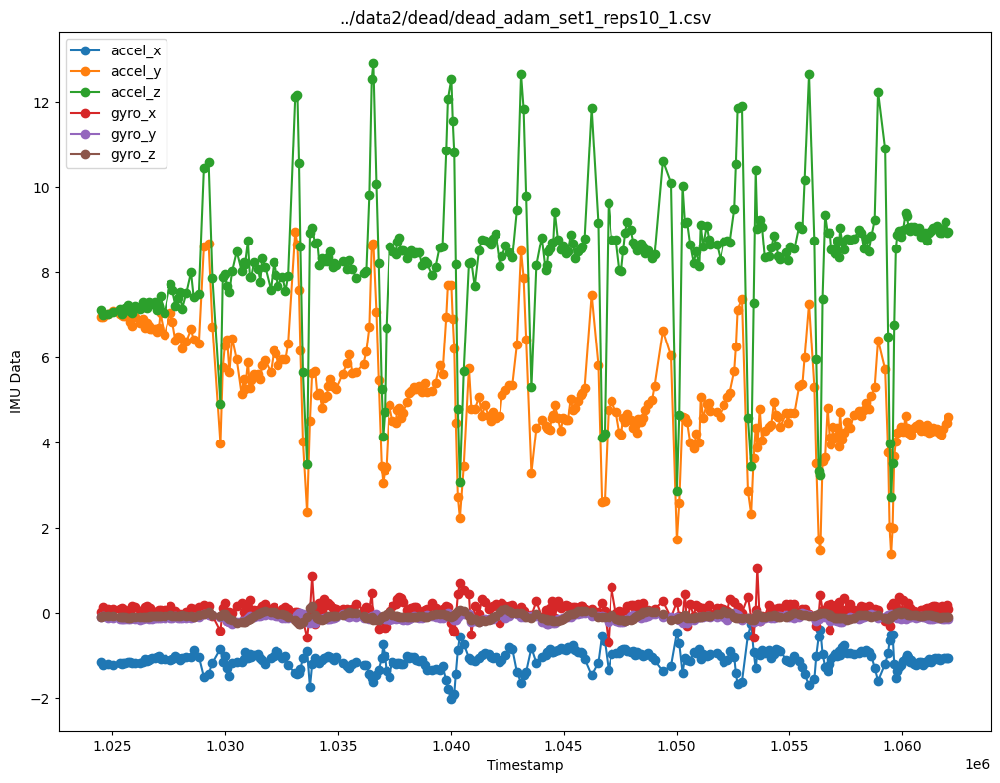

../data2/dead/dead_andrew_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    2385205   -0.043    3.501    9.525   0.002  -0.043  -0.039
1    2385208   -0.043    3.501    9.525   0.002  -0.043  -0.039
2    2385211   -0.063    3.361    9.545  -0.053  -0.032  -0.040
3    2385318   -0.140    3.455    9.872   0.094  -0.050  -0.031
4    2385327   -0.133    3.482    9.856   0.094  -0.053  -0.032


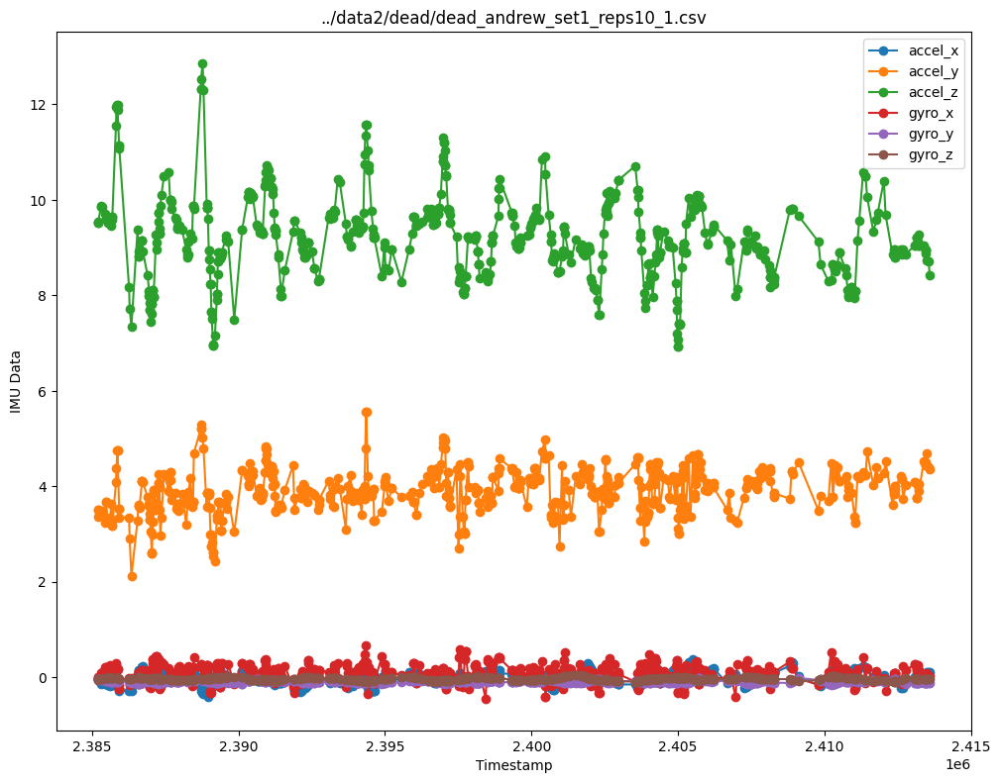

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  2.385178e+06 -0.036322  3.437832  9.487378 -0.073762 -0.035930 -0.041986
1  2.385263e+06 -0.087447  3.477456  9.687460  0.065842 -0.046439 -0.035167
2  2.385347e+06 -0.123297  3.483340  9.768192  0.135616 -0.056610 -0.028574
3  2.385438e+06 -0.143441  3.459282  9.709842  0.136196 -0.067944 -0.021193
4  2.385529e+06 -0.143959  3.451591  9.550239  0.131420 -0.081403 -0.014318


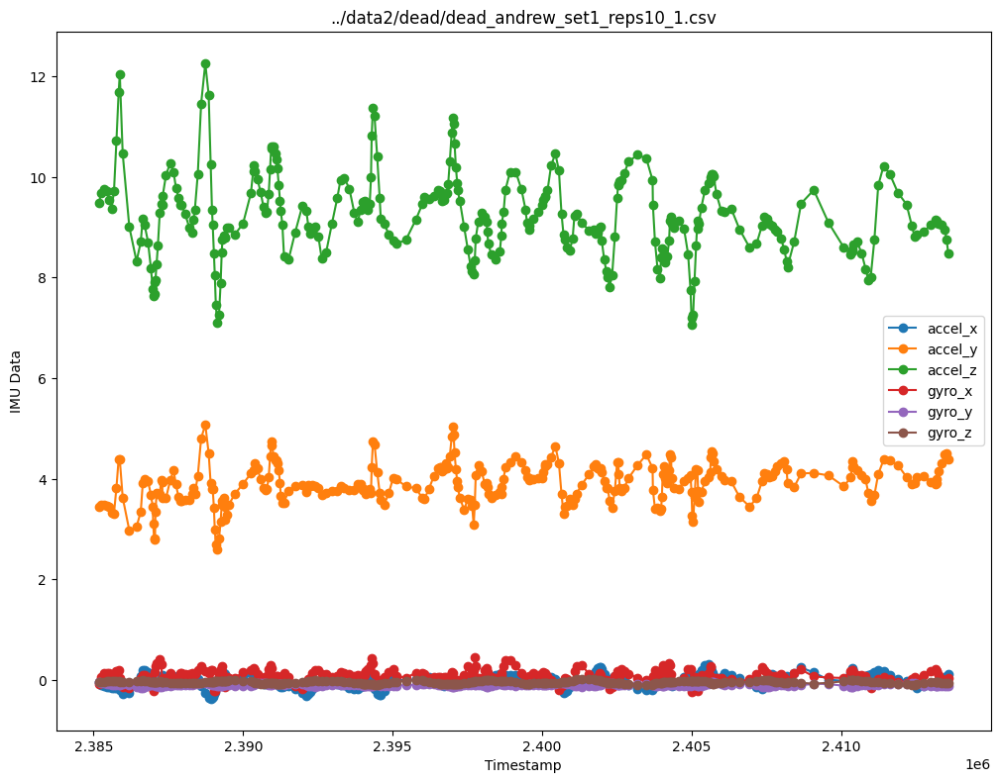

../data2/dead/dead_anuj_set1_rep10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     902639   -0.152    3.771    9.362   0.087  -0.084  -0.034
1     902643   -0.152    3.771    9.362   0.087  -0.084  -0.034
2     902647   -0.134    3.742    9.337   0.088  -0.089  -0.034
3     902856   -0.108    3.734    9.330   0.087  -0.090  -0.035
4     902913   -0.126    3.744    9.366   0.086  -0.092  -0.034


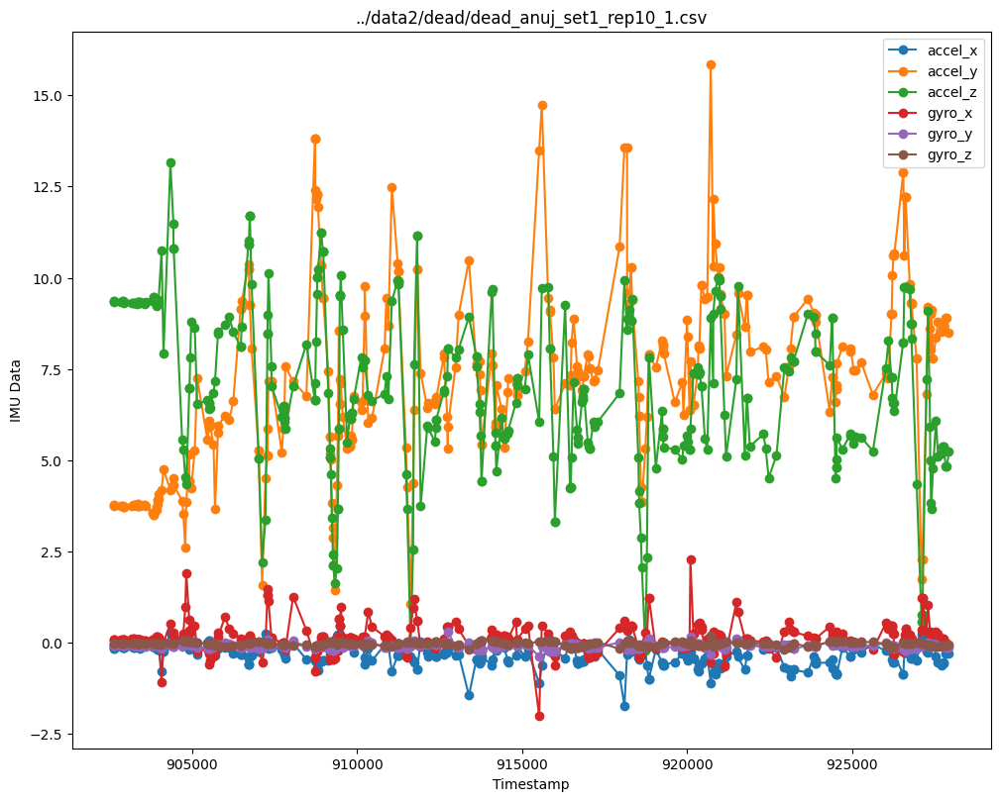

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  902627.636364 -0.148266  3.781448  9.354923  0.088252 -0.083448 -0.034497
1  902686.168602 -0.140664  3.758726  9.355390  0.086752 -0.086466 -0.034075
2  902747.600304 -0.134740  3.741664  9.353886  0.086045 -0.088826 -0.033843
3  902811.931469 -0.130494  3.730261  9.350412  0.086130 -0.090526 -0.033801
4  902879.162096 -0.127926  3.724517  9.344967  0.087008 -0.091568 -0.033949


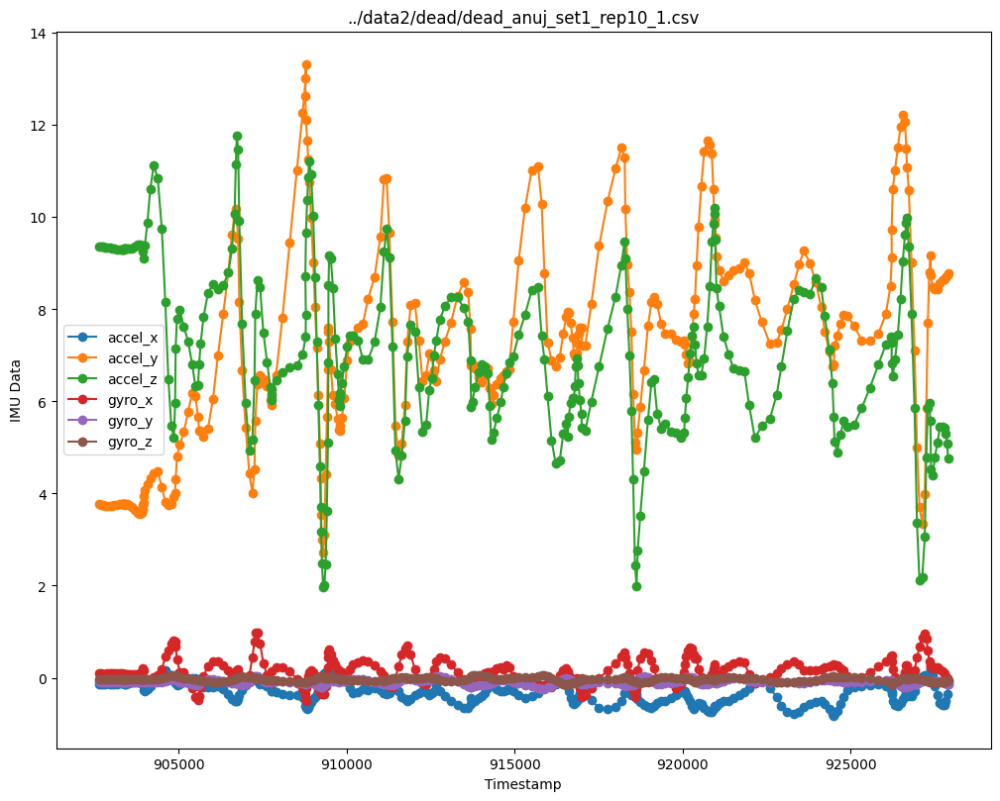

../data2/dead/dead_kamyar_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    4143129   -1.192    4.672    9.221  -0.011  -0.173  -0.192
1    4143133   -1.078    4.628    9.350  -0.175  -0.203  -0.199
2    4143137   -1.078    4.628    9.350  -0.175  -0.203  -0.199
3    4143140   -1.078    4.628    9.350  -0.175  -0.203  -0.199
4    4143164   -0.931    3.935    9.234  -0.487  -0.244  -0.211


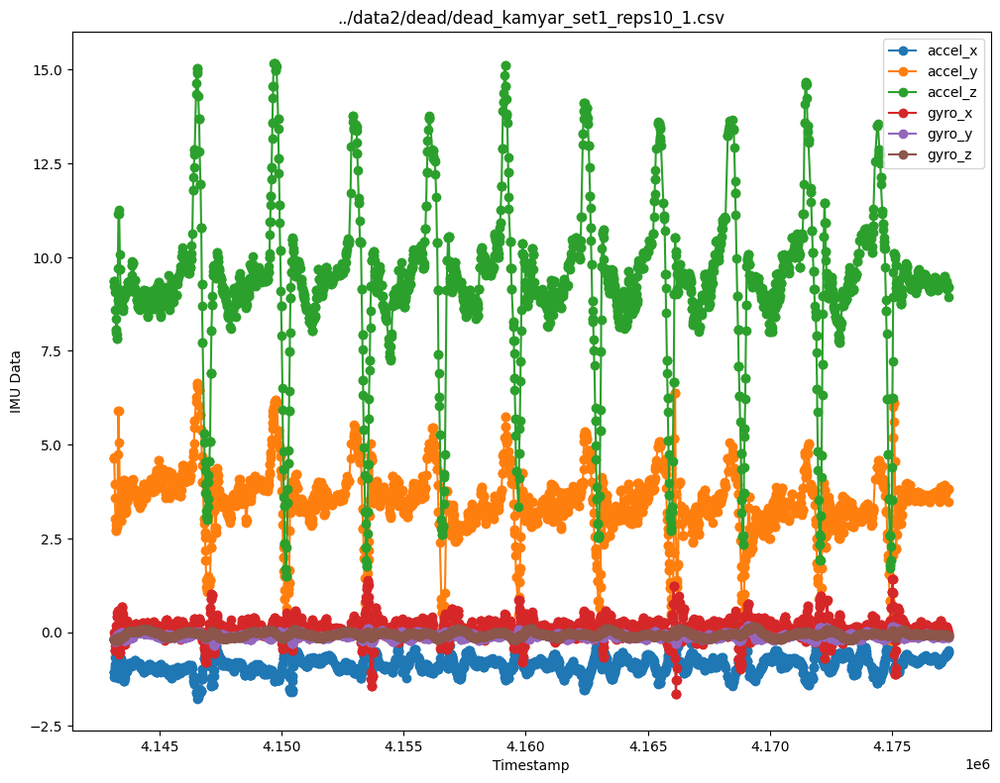

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  4.143126e+06 -1.178510  4.847252  9.269322  0.043490 -0.167860 -0.188727
1  4.143205e+06 -0.638400  2.871148  8.362693 -0.223852 -0.198248 -0.194659
2  4.143294e+06 -0.927645  4.875885  9.918875  0.368761 -0.096299 -0.147633
3  4.143413e+06 -0.743465  3.021255  8.997458  0.244619 -0.041905 -0.161173
4  4.143502e+06 -1.230458  4.043197  8.693675  0.334820 -0.080728 -0.113752


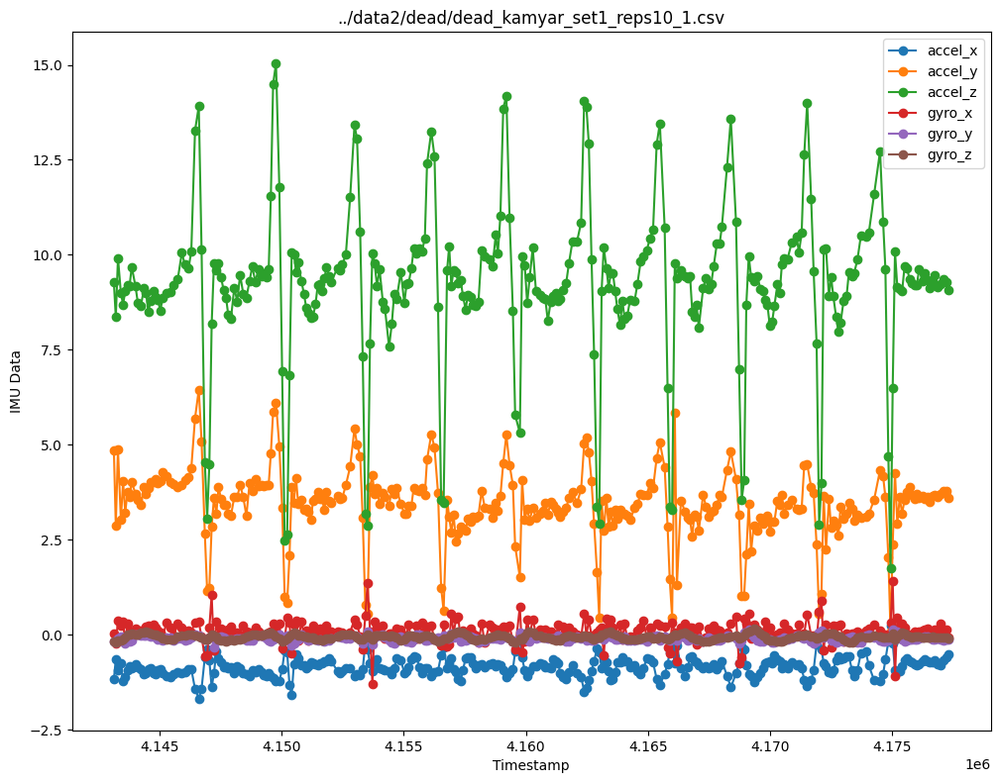

../data2/dead/dead_mike_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    2929604   -1.177    3.325    9.667  -0.326  -0.109  -0.182
1    2929608   -1.177    3.325    9.667  -0.326  -0.109  -0.182
2    2929612   -1.177    3.325    9.667  -0.326  -0.109  -0.182
3    2929615   -1.131    3.106    9.531  -0.329  -0.108  -0.182
4    2929635   -1.110    2.734    9.184  -0.231  -0.093  -0.175


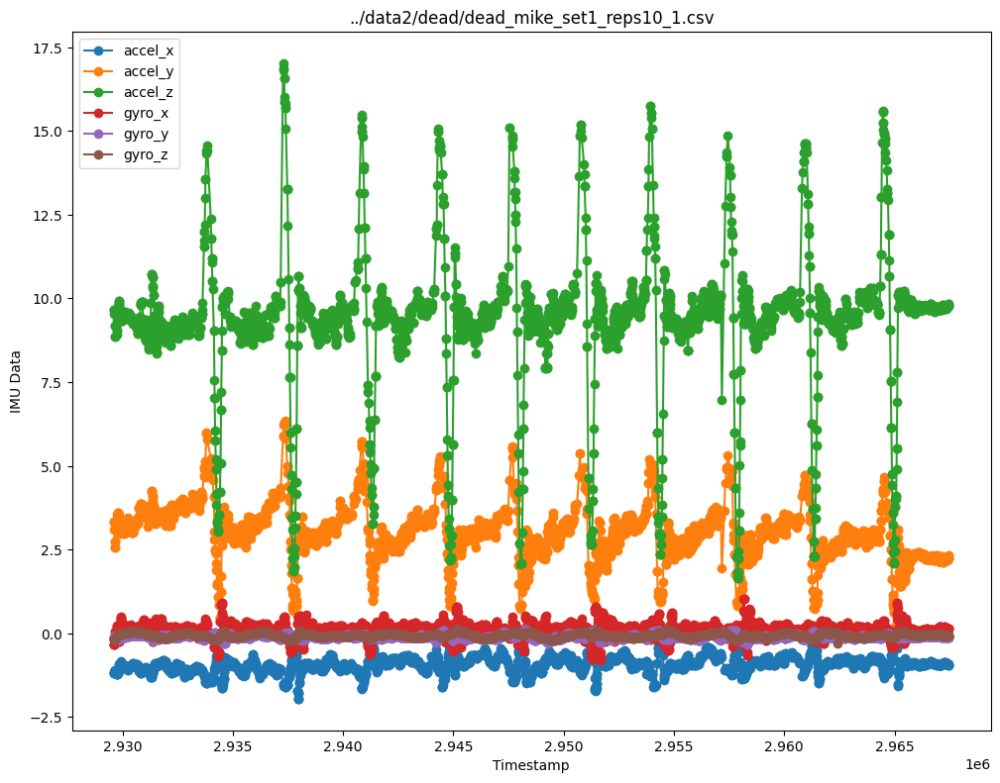

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  2.929601e+06 -1.192755  3.537790  9.836678 -0.379063 -0.120531 -0.182923
1  2.929725e+06 -1.196799  3.136864  8.982508  0.198933 -0.072814 -0.093641
2  2.929821e+06 -1.064373  3.430837  9.891677 -0.227047 -0.169183 -0.054107
3  2.929913e+06 -0.862829  3.112838  9.435196  0.439619 -0.047189 -0.009017
4  2.930045e+06 -0.963426  3.030208  9.510946 -0.079540 -0.115476  0.003624


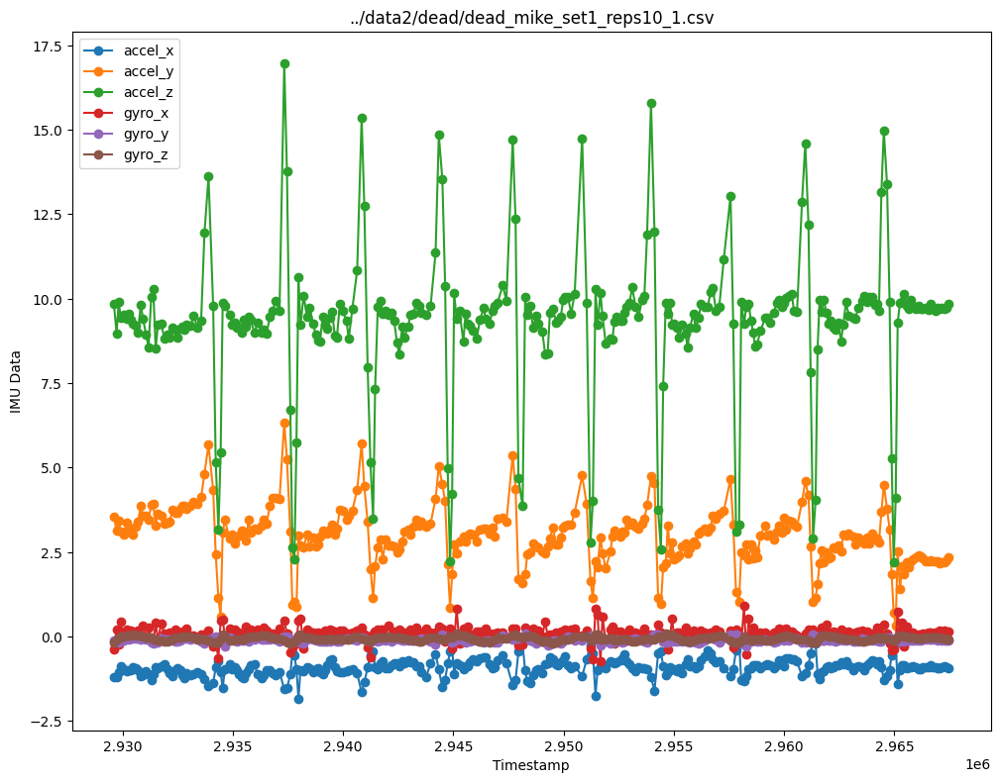

../data2/squat/squat_adam_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     567233    1.414   -7.923   -5.295  -0.018  -0.119  -0.083
1     567264    1.440   -7.927   -5.379  -0.022  -0.116  -0.083
2     567268    1.440   -7.927   -5.379  -0.022  -0.116  -0.083
3     567271    1.479   -7.909   -5.385  -0.011  -0.114  -0.083
4     567293    1.529   -7.906   -5.452   0.031  -0.109  -0.081


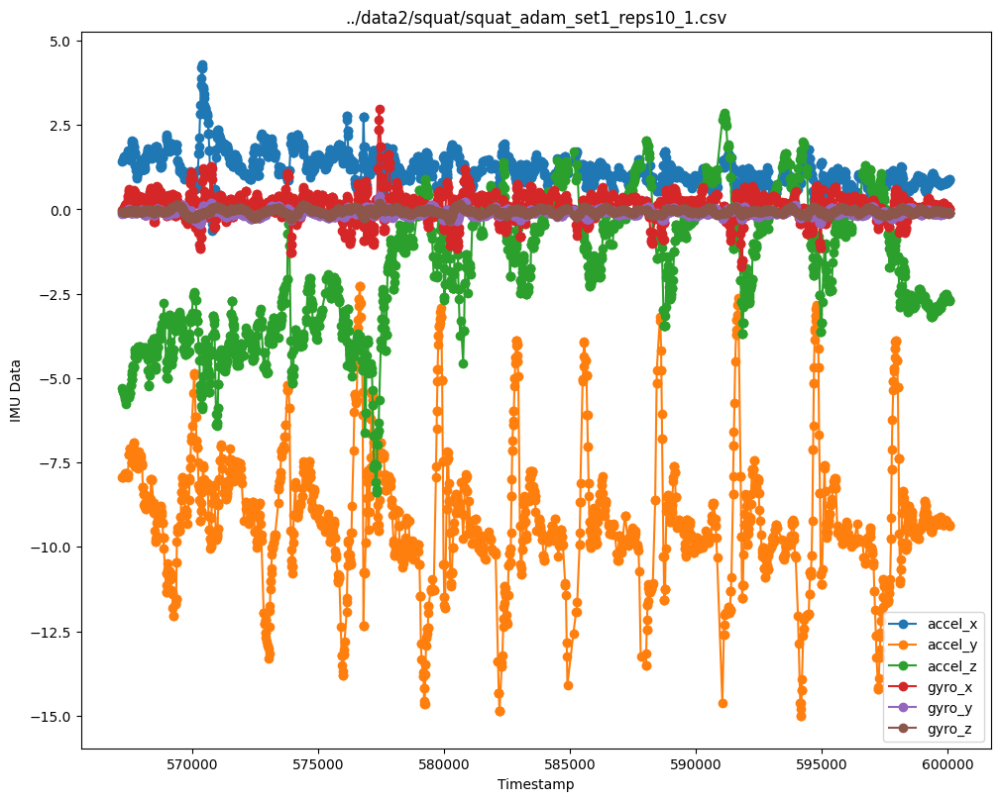

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  567241.811189  1.401441 -7.921238 -5.320804 -0.032923 -0.119301 -0.083462
1  567317.188421  1.565452 -7.877471 -5.507995  0.075956 -0.097429 -0.080575
2  567400.074335  1.650059 -7.906604 -5.647516  0.209684 -0.061499 -0.078952
3  567526.870080  1.463491 -7.141467 -5.505356  0.408330 -0.030352 -0.047291
4  567594.512345  1.791097 -7.374798 -5.050816  0.033357 -0.109586 -0.050338


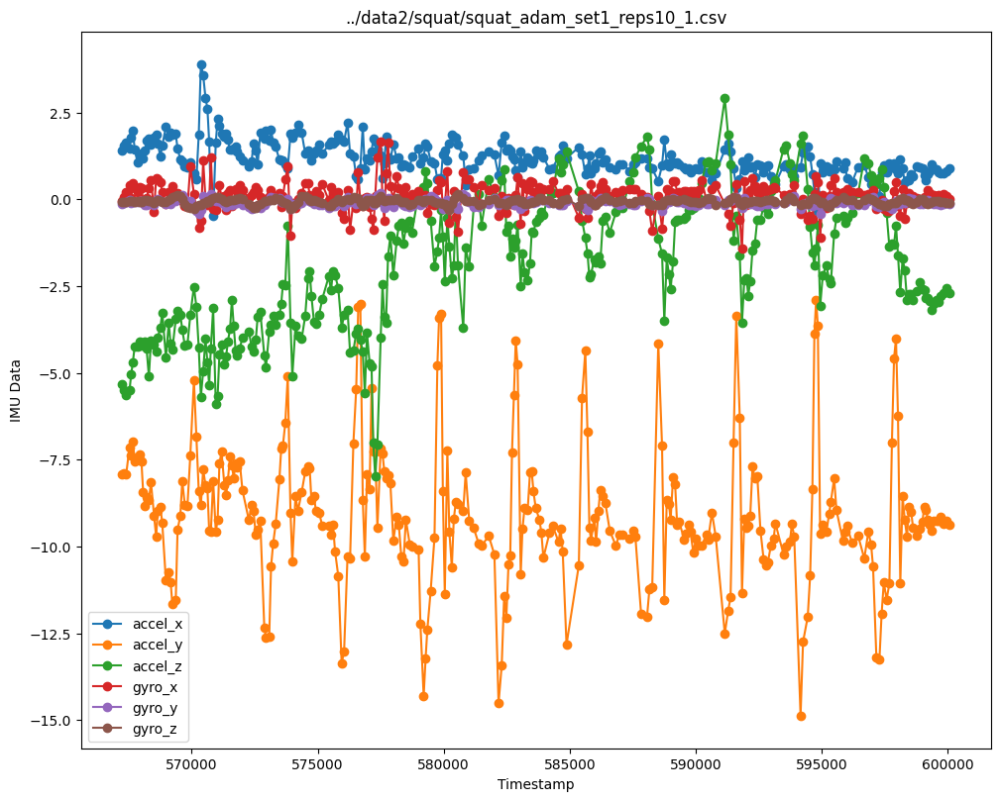

../data2/squat/squat_andrew_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    1028371    0.296   -3.974   -5.916  -0.089   0.012  -0.011
1    1028375    0.296   -3.974   -5.916  -0.089   0.012  -0.011
2    1028378    0.148   -4.178   -6.041  -0.232   0.021  -0.007
3    1028690   -0.056   -2.124   -9.011  -0.249  -0.082  -0.062
4    1028938    0.150   -1.869   -9.649   0.765  -0.108  -0.089


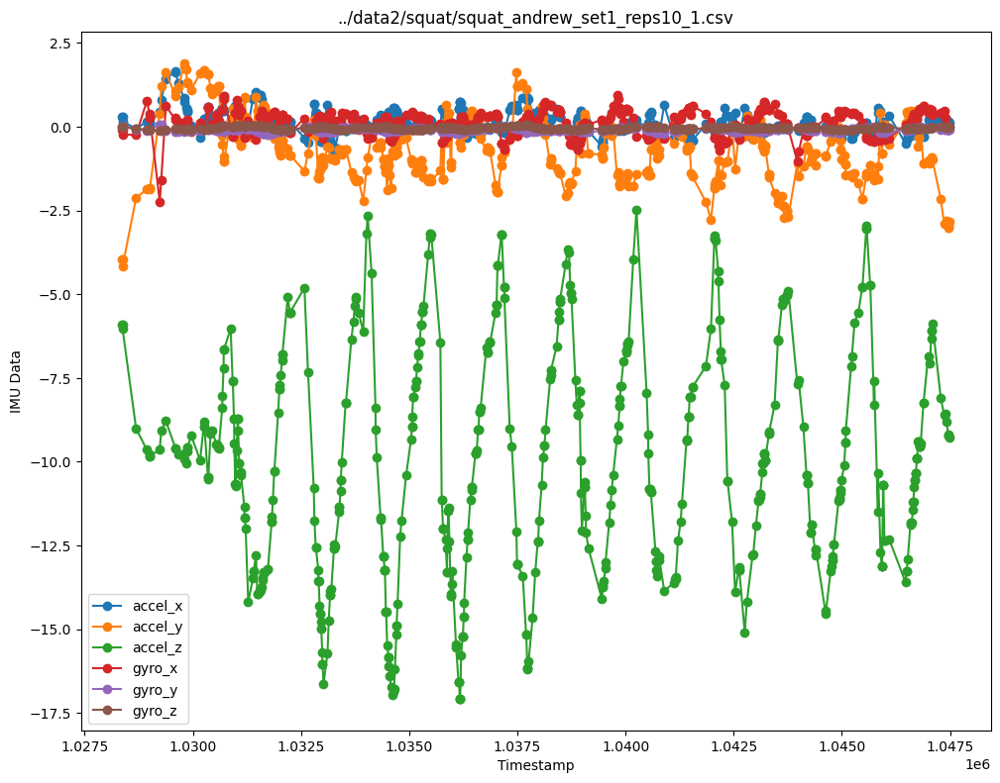

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  1.028281e+06  0.433923 -4.056000 -5.099147 -0.065070  0.020266  0.012413
1  1.028538e+06  0.095348 -3.475205 -7.372554  0.029632 -0.027733 -0.038932
2  1.028770e+06 -0.018832 -2.670795 -8.910356  0.019291 -0.056407 -0.076093
3  1.028980e+06  0.075063 -1.549411 -9.730191 -0.160213 -0.058081 -0.102867
4  1.029168e+06  0.466487 -0.354969 -9.698090 -0.428687 -0.042526 -0.111356


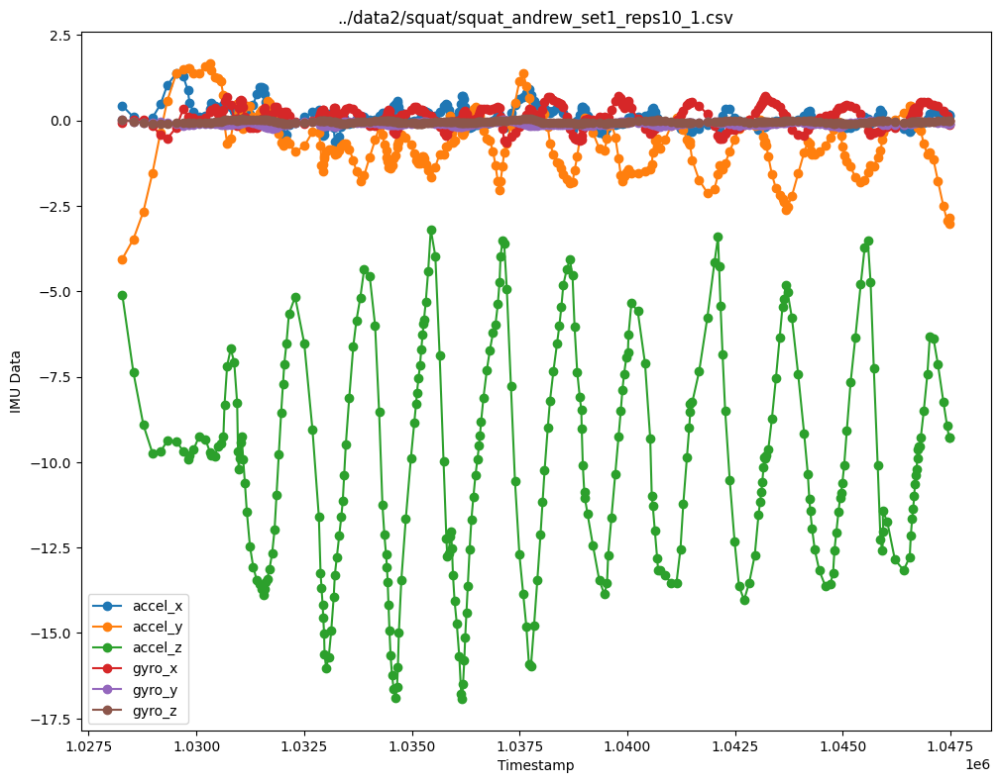

../data2/squat/squat_anuj_set1_rep10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     611708   -0.507    5.587   -8.064   0.035  -0.045  -0.046
1     611711   -0.507    5.587   -8.064   0.035  -0.045  -0.046
2     611715   -0.507    5.587   -8.064   0.035  -0.045  -0.046
3     611718   -0.465    5.567   -7.969   0.057  -0.043  -0.046
4     611769   -0.473    5.610   -7.992   0.153  -0.039  -0.048


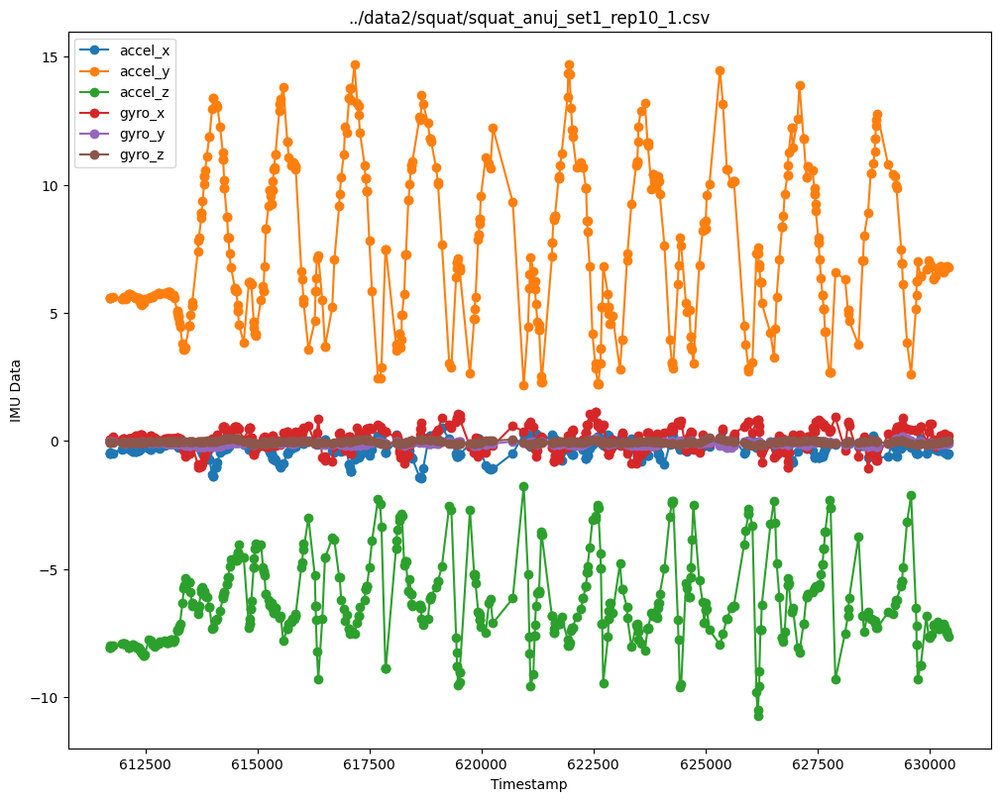

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  611652.468531 -0.543769  5.586965 -8.094301  0.023140 -0.039112 -0.042629
1  611747.179049 -0.477334  5.582931 -8.022077  0.056897 -0.046538 -0.047762
2  611835.941535 -0.414040  5.580121 -7.968453  0.076866 -0.054656 -0.053181
3  611925.320065 -0.344718  5.572069 -7.924767  0.080594 -0.065257 -0.059580
4  612021.260870 -0.278798  5.576548 -7.910970  0.071707 -0.077053 -0.066865


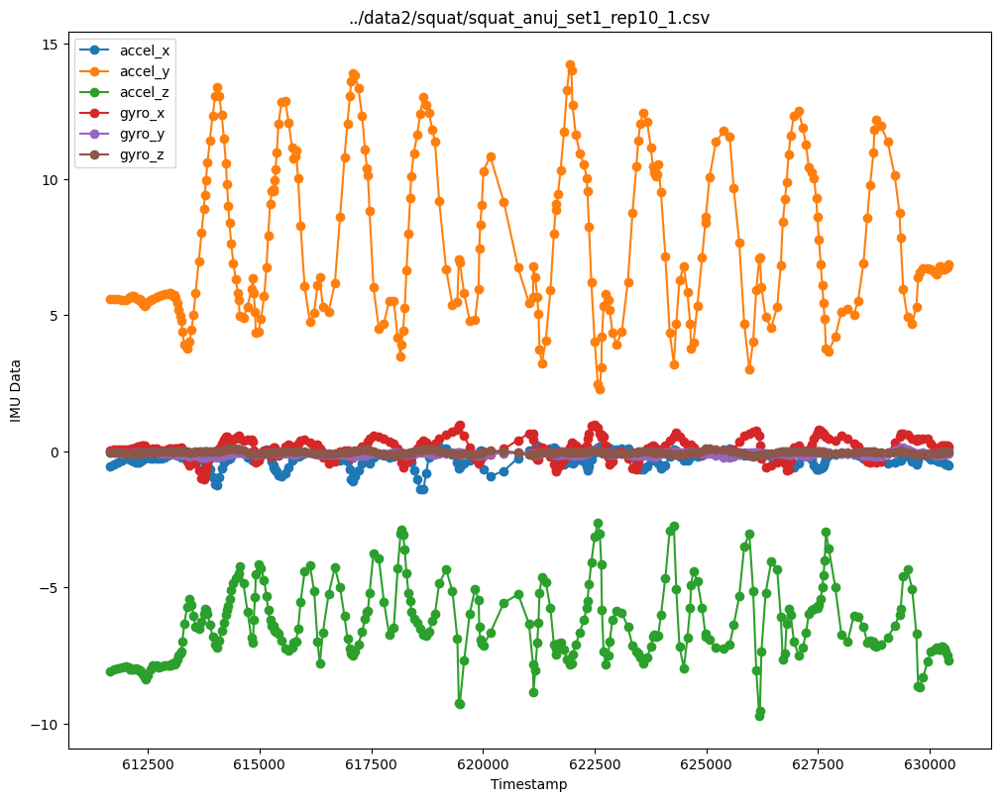

../data2/squat/squat_jake_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0      46288    0.422    0.925    9.931   0.127  -0.120  -0.054
1      46291    0.422    0.925    9.931   0.127  -0.120  -0.054
2      46294    0.479    0.951    9.953   0.111  -0.119  -0.055
3      46298    0.479    0.951    9.953   0.111  -0.119  -0.055
4      46349    0.485    0.910    9.936   0.065  -0.115  -0.056


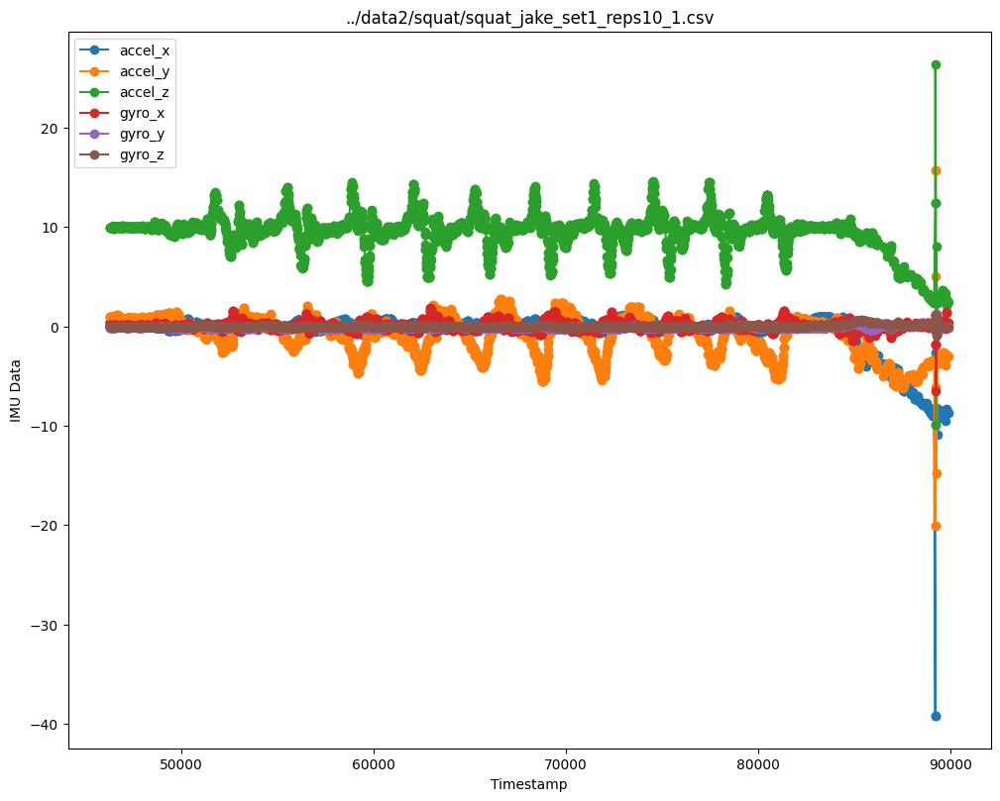

      timestamp   accel_x   accel_y    accel_z    gyro_x    gyro_y    gyro_z
0  46277.923077  0.428580  0.932552   9.944916  0.138853 -0.120070 -0.053301
1  46428.664686  0.457026  0.885073  10.007877  0.062817 -0.107075 -0.055428
2  46550.738998  0.494495  0.997437   9.907020  0.080687 -0.099392 -0.051845
3  46679.935714  0.456476  1.039552   9.988373  0.012280 -0.089255 -0.049814
4  46803.583187  0.470758  0.808825   9.915456 -0.076914 -0.084377 -0.042045


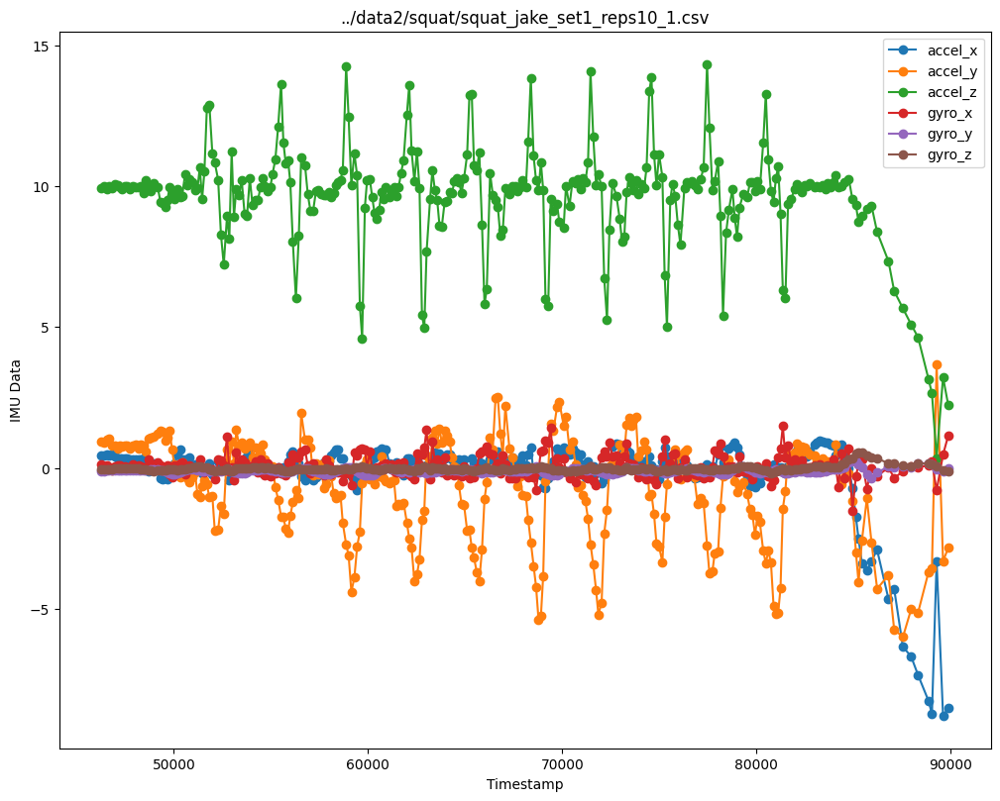

../data2/squat/squat_kamyar_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    3872427    1.318   -7.228   -5.704  -0.083  -0.172  -0.021
1    3872449    1.279   -7.363   -5.594   0.026  -0.164  -0.007
2    3872453    1.249   -7.384   -5.586   0.077  -0.164  -0.001
3    3872457    1.249   -7.384   -5.586   0.077  -0.164  -0.001
4    3872479    1.223   -7.415   -5.610   0.167  -0.158   0.011


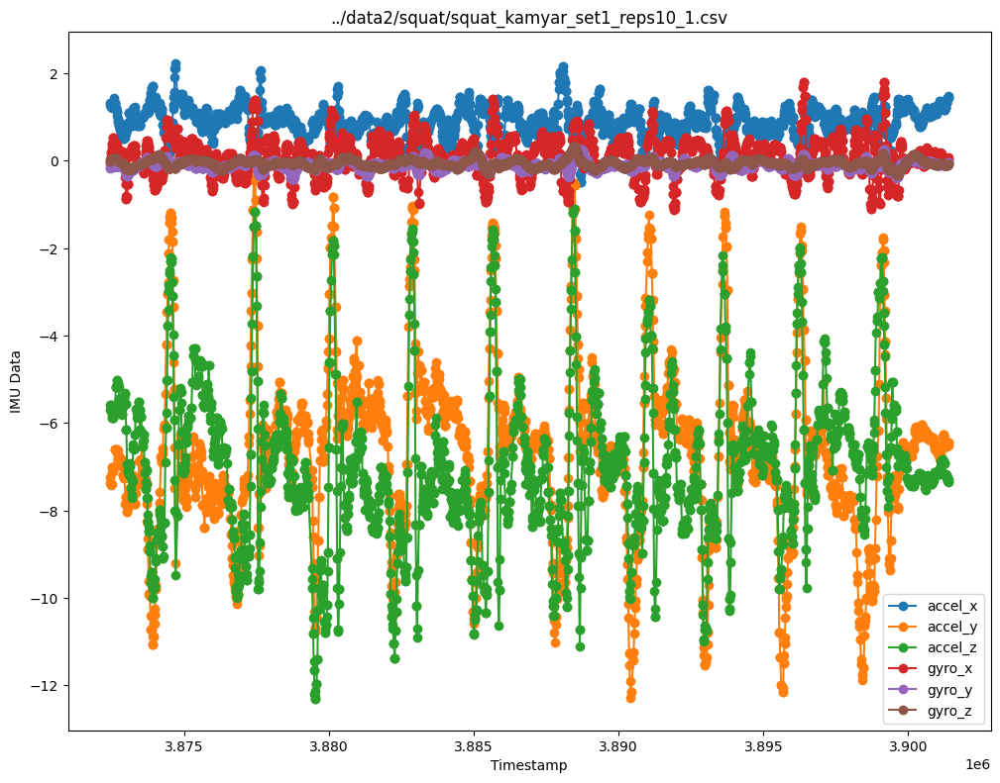

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  3.872432e+06  1.320028 -7.291273 -5.631007 -0.051147 -0.168993 -0.017881
1  3.872515e+06  1.241218 -7.136589 -5.854159  0.399210 -0.134141  0.040358
2  3.872620e+06  1.275737 -6.600899 -5.413103  0.363950 -0.136316  0.043199
3  3.872717e+06  0.883356 -6.696943 -5.160063  0.231594 -0.130182 -0.009733
4  3.872805e+06  0.674841 -6.920870 -5.709120  0.099434 -0.119104 -0.046917


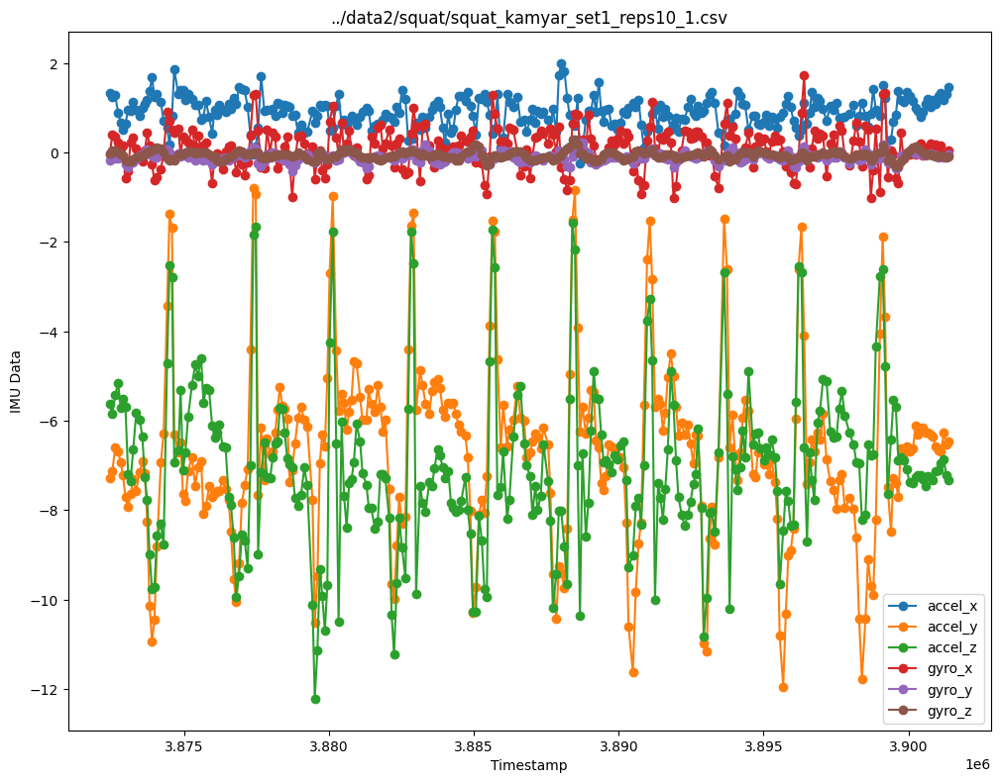

../data2/squat/squat_mike_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    2733508   -0.105    0.165   -9.738  -0.122  -0.237  -0.108
1    2733530   -0.135    0.200   -9.842  -0.103  -0.226  -0.106
2    2733534   -0.095    0.152   -9.905  -0.071  -0.217  -0.105
3    2733538   -0.095    0.152   -9.905  -0.071  -0.217  -0.105
4    2733561   -0.047   -0.019   -9.583  -0.001  -0.200  -0.103


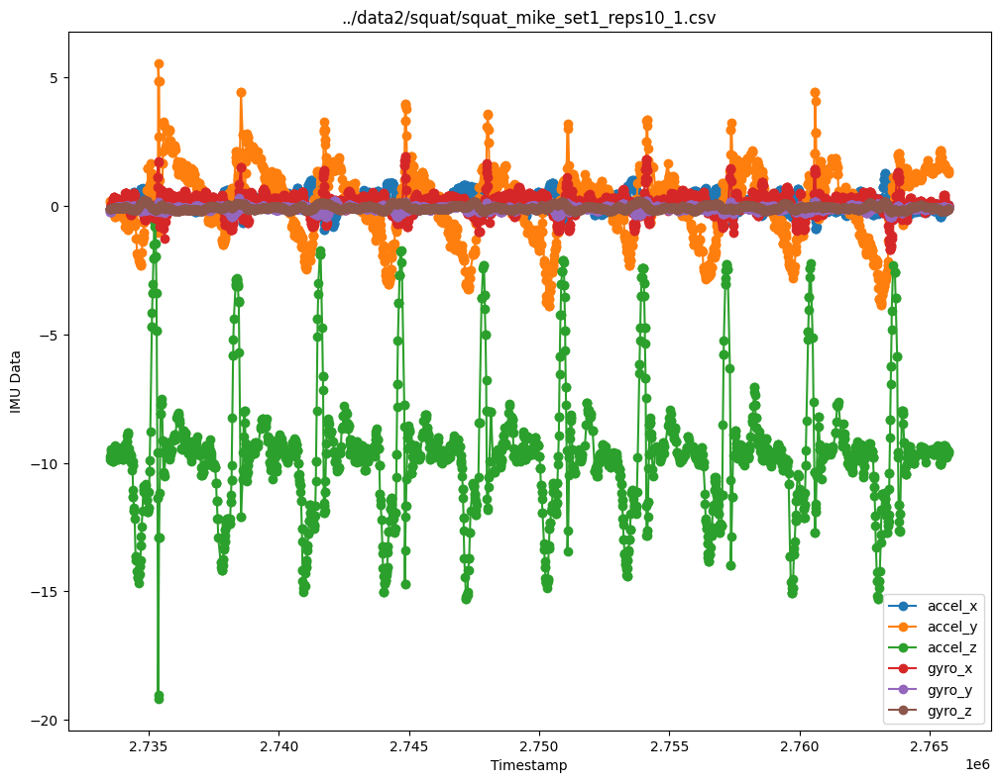

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  2.733512e+06 -0.150007  0.248545 -9.919000 -0.123175 -0.236308 -0.107979
1  2.733603e+06 -0.034843 -0.162339 -9.688023  0.182210 -0.135239 -0.089680
2  2.733715e+06  0.051931 -0.302683 -9.430074  0.202309 -0.071044 -0.082048
3  2.733812e+06 -0.122261  0.076712 -9.744084  0.280307 -0.023294 -0.082345
4  2.733898e+06  0.099247 -0.183284 -9.550775  0.140444 -0.056171 -0.087484


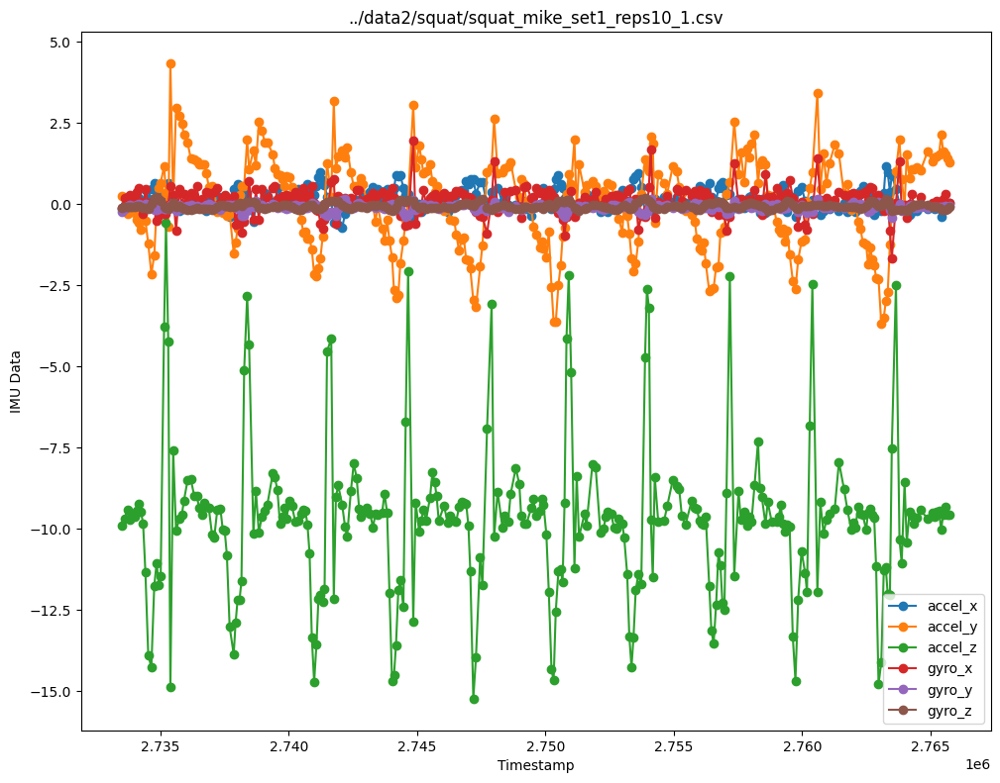

../data2/squat/squat_suzan_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    1206809    0.068   -8.813    4.999  -0.134  -0.117  -0.042
1    1206813    0.068   -8.813    4.999  -0.134  -0.117  -0.042
2    1206816    0.068   -8.813    4.999  -0.134  -0.117  -0.042
3    1206820    0.022   -8.771    4.887  -0.089  -0.127  -0.046
4    1206841    0.017   -8.722    4.914   0.006  -0.111  -0.033


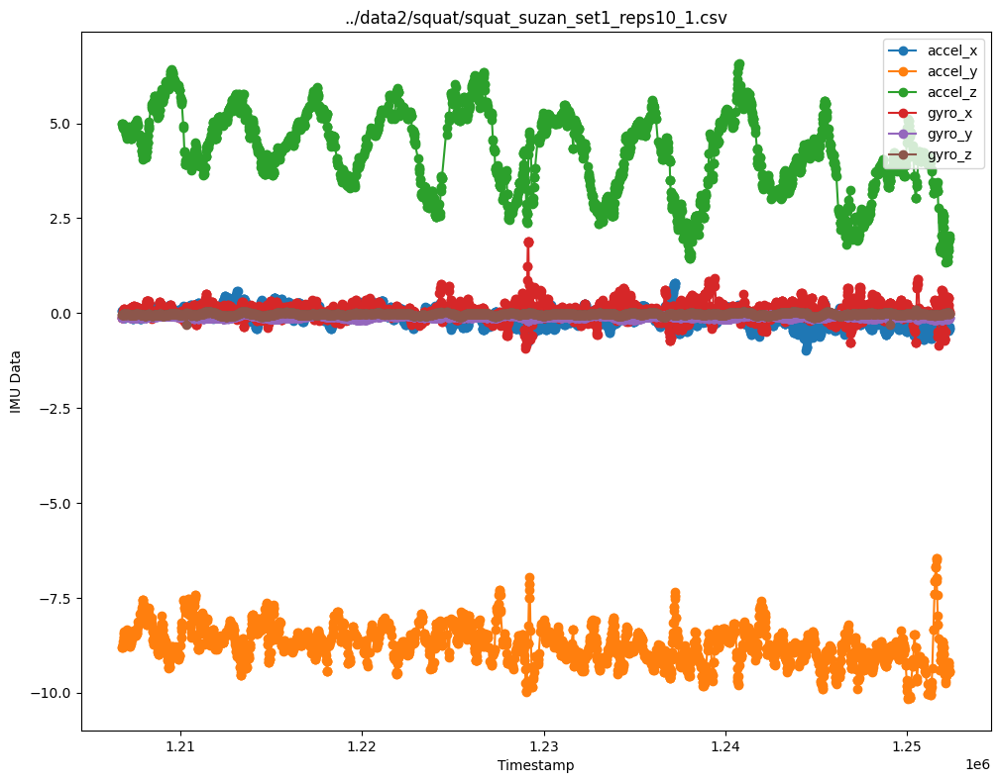

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  1.206806e+06  0.073014 -8.831189  5.006601 -0.176385 -0.118832 -0.044664
1  1.206887e+06 -0.061771 -8.479793  4.886699  0.095068 -0.109422 -0.029425
2  1.207036e+06 -0.047959 -8.436343  4.664919  0.025048 -0.107889 -0.032309
3  1.207258e+06 -0.024669 -8.746347  4.652439  0.019379 -0.111281 -0.039991
4  1.207395e+06 -0.136620 -8.456154  4.697064  0.125247 -0.120074 -0.037366


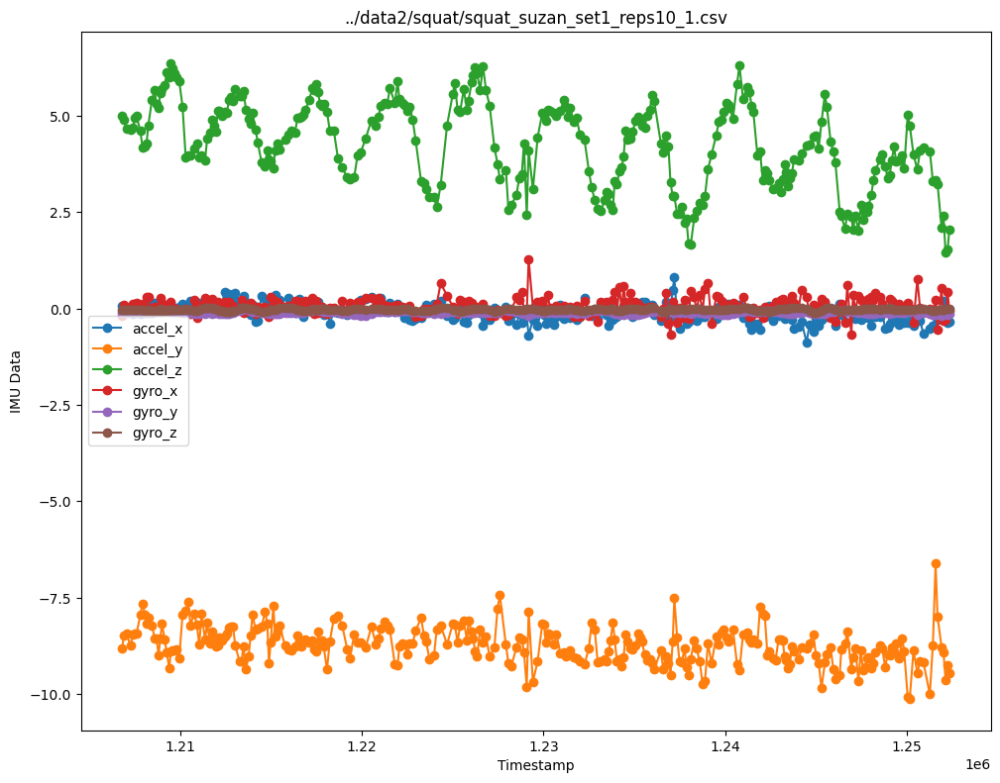

../data2/squat/squat_udai_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    1282049    0.203   -9.531    0.833   0.062  -0.183   0.001
1    1282052    0.203   -9.531    0.833  -0.031  -0.169   0.001
2    1282056    0.203   -9.531    0.833  -0.031  -0.169   0.001
3    1282060    0.233   -9.595    0.910  -0.097  -0.173  -0.002
4    1282081    0.156   -9.720    0.753  -0.159  -0.164   0.004


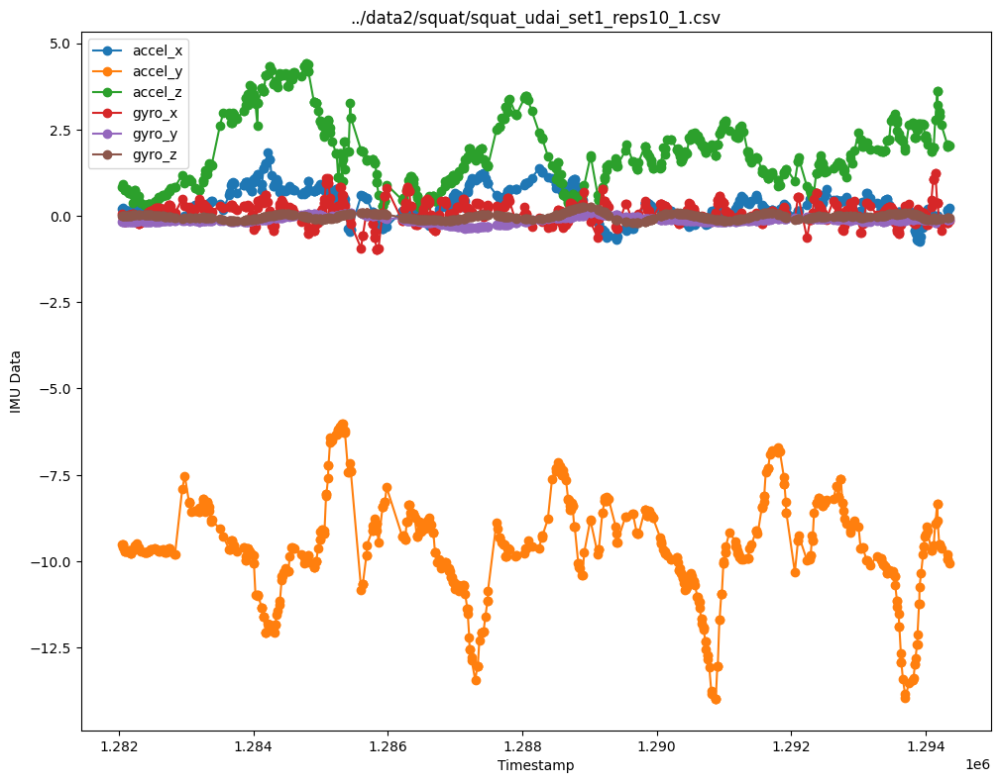

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  1.282047e+06  0.221776 -9.487343  0.846895  0.062476 -0.179510 -0.000063
1  1.282060e+06  0.189824 -9.602427  0.826036 -0.075200 -0.170036  0.001407
2  1.282078e+06  0.164473 -9.679973  0.796821 -0.141896 -0.164831  0.003605
3  1.282099e+06  0.137906 -9.725797  0.753385 -0.133035 -0.164732  0.007166
4  1.282123e+06  0.135905 -9.716431  0.714981 -0.055844 -0.167041  0.010242


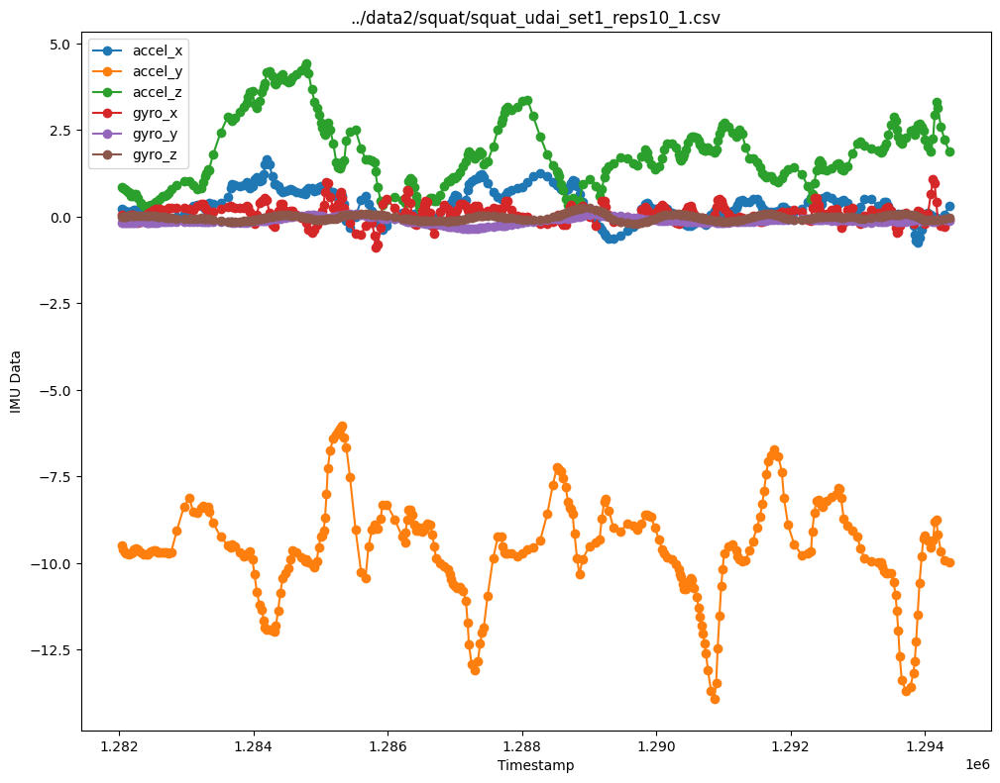

../data2/bicep_curl/bicep_udai_set3_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    1571808   -0.747   -9.086    2.648   0.184  -0.112  -0.090
1    1571812   -0.657   -8.867    2.601   0.137  -0.110  -0.094
2    1571816   -0.657   -8.867    2.601   0.137  -0.110  -0.094
3    1571819   -0.657   -8.867    2.601   0.137  -0.110  -0.094
4    1571901   -0.659   -9.229    2.477   0.068  -0.106  -0.092


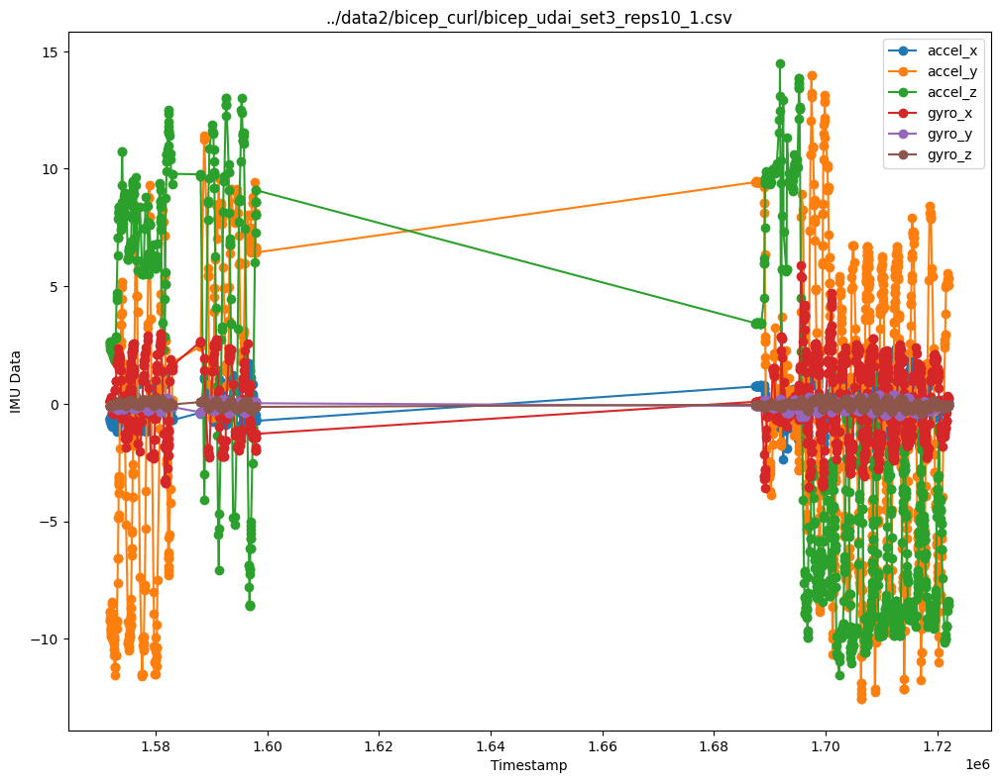

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  1.571791e+06 -0.716049 -8.884923  2.661091  0.184972 -0.114657 -0.094867
1  1.571882e+06 -0.639638 -9.180878  2.486913  0.073295 -0.102910 -0.088271
2  1.571943e+06 -0.634129 -9.572642  2.379375  0.015097 -0.094214 -0.078070
3  1.572012e+06 -0.592412 -9.692968  2.312119  0.029500 -0.098129 -0.072603
4  1.572073e+06 -0.710217 -9.321541  2.347600  0.130296 -0.100526 -0.065830


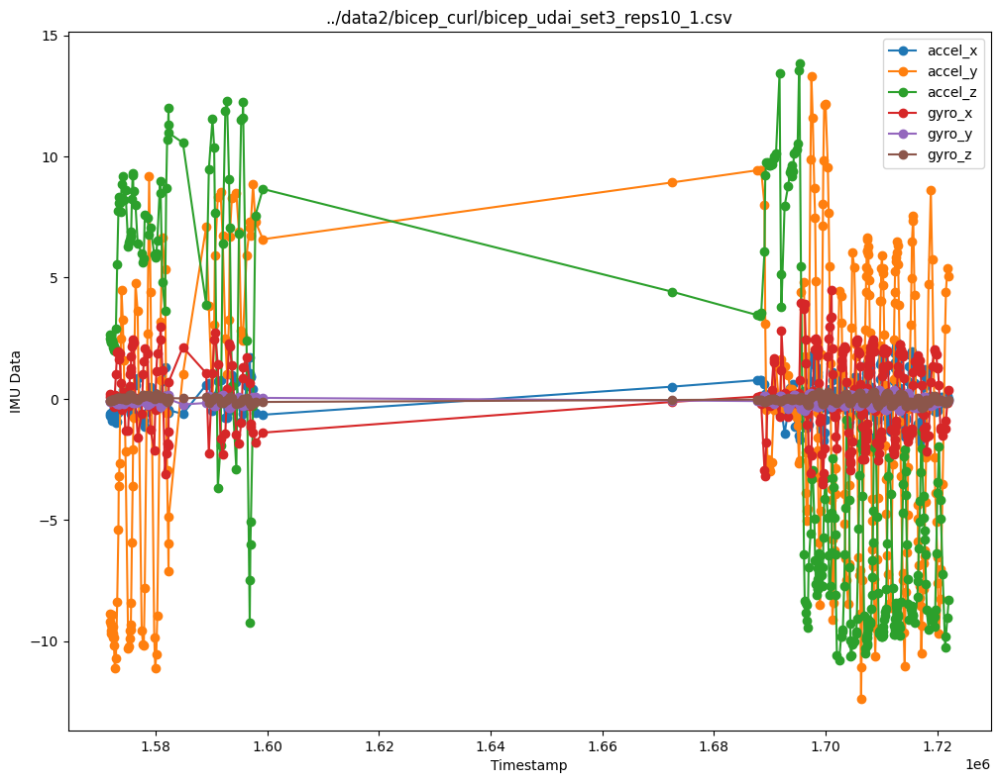

../data2/shoulder_press/shoulder_udai_set3_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     441553    0.321    7.853    6.781  -2.518  -0.027  -0.032
1     441557    0.321    7.853    6.781  -2.518  -0.027  -0.032
2     441561    0.316    7.585    7.013  -2.657  -0.020  -0.040
3     441667    0.272    4.301    8.564  -1.444  -0.099  -0.007
4     441737    0.229    4.409    8.954  -0.230  -0.162   0.026


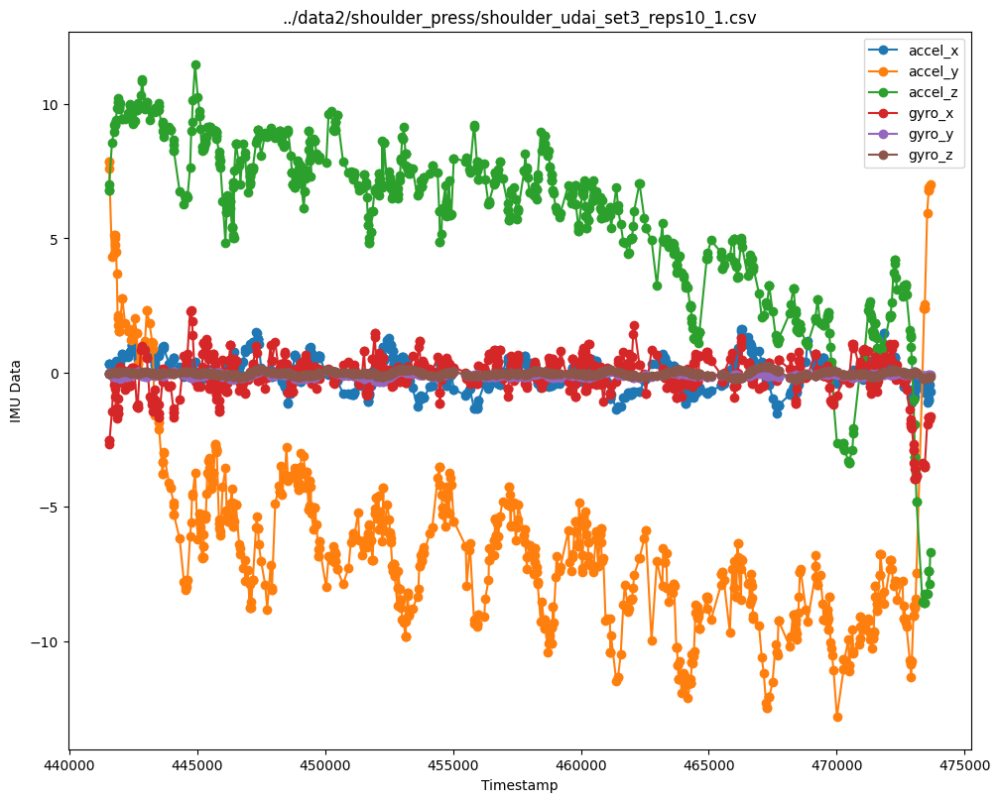

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  441522.244755  0.341105  8.050147  6.447070 -3.107126  0.005189 -0.047797
1  441653.625254  0.274933  6.057281  8.070969 -1.313216 -0.098854 -0.003172
2  441754.844517  0.272707  4.898532  9.130764 -0.568822 -0.150809  0.016023
3  441818.198221  0.334795  4.451812  9.476387 -1.033080 -0.142197  0.005292
4  441872.174934  0.343246  2.799051  9.880309 -1.536115 -0.130349 -0.009114


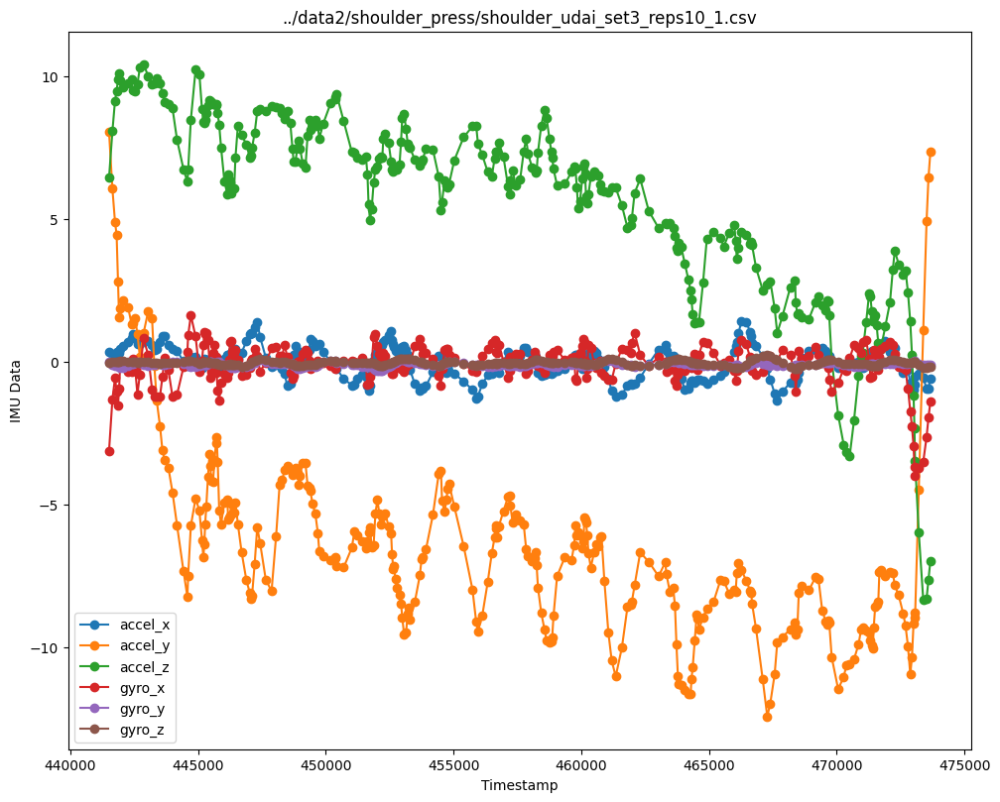

../data2/row/row_udai_set3_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     666760   -0.197    1.819    9.986   0.469  -0.114  -0.055
1     666763   -0.197    1.819    9.986   0.391  -0.116  -0.055
2     666767   -0.197    1.819    9.986   0.391  -0.116  -0.055
3     666771   -0.182    1.923    9.960   0.281  -0.112  -0.057
4     666793   -0.185    1.942    9.869   0.002  -0.097  -0.066


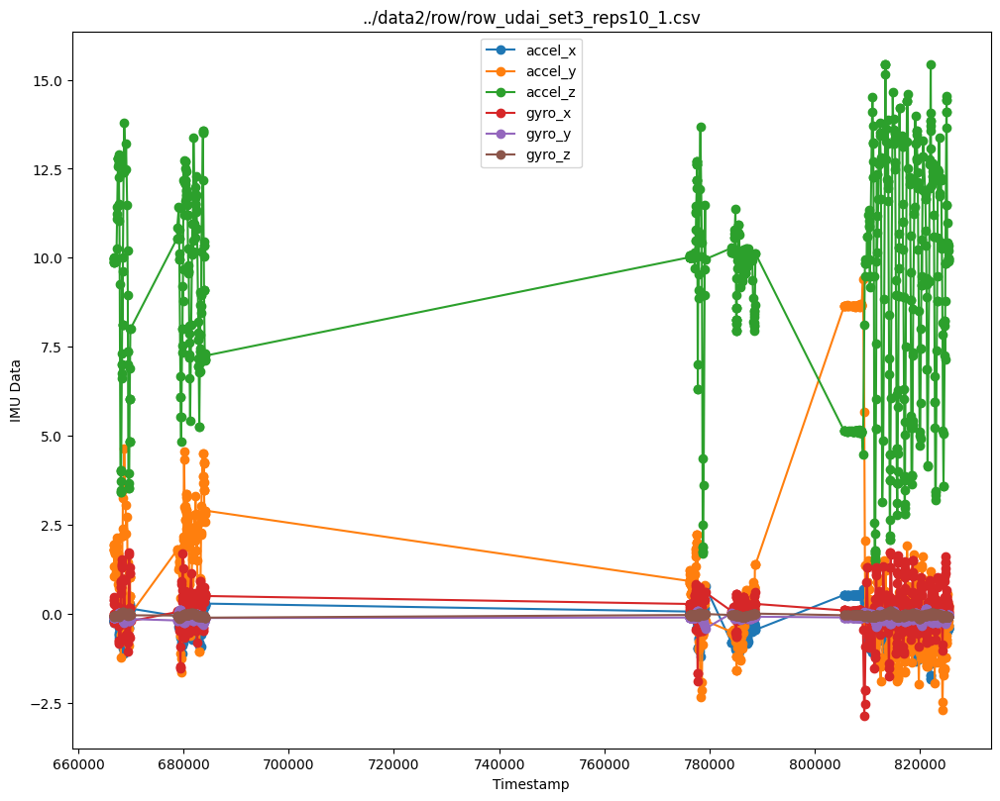

       timestamp   accel_x   accel_y    accel_z    gyro_x    gyro_y    gyro_z
0  666772.307692 -0.188280  1.898322  10.015175  0.557308 -0.121049 -0.051168
1  666761.074985 -0.196475  1.830720   9.938064  0.228491 -0.107103 -0.060052
2  666785.924884 -0.204377  1.742380   9.908882  0.009029 -0.097393 -0.064890
3  666829.121407 -0.220286  1.585641   9.899291 -0.118158 -0.090288 -0.066607
4  666977.025961 -0.221339  1.371697   9.968817 -0.027954 -0.094221 -0.060717


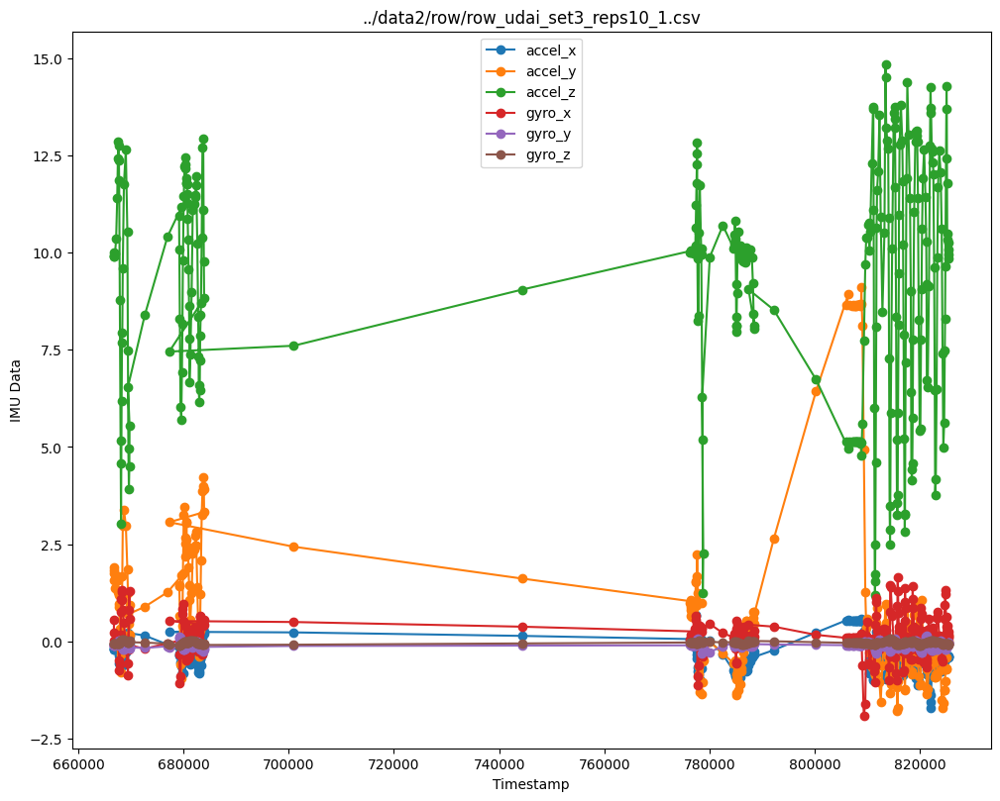

../data2/dead/dead_udai_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    2010159   -0.853  -10.052    0.816   0.269  -0.131  -0.013
1    2010163   -0.873  -10.092    0.816   0.310  -0.134  -0.006
2    2010166   -0.873  -10.092    0.816   0.310  -0.134  -0.006
3    2010169   -0.908  -10.130    0.814   0.325  -0.133  -0.007
4    2010250   -0.906   -9.712    0.767   0.028  -0.122  -0.020


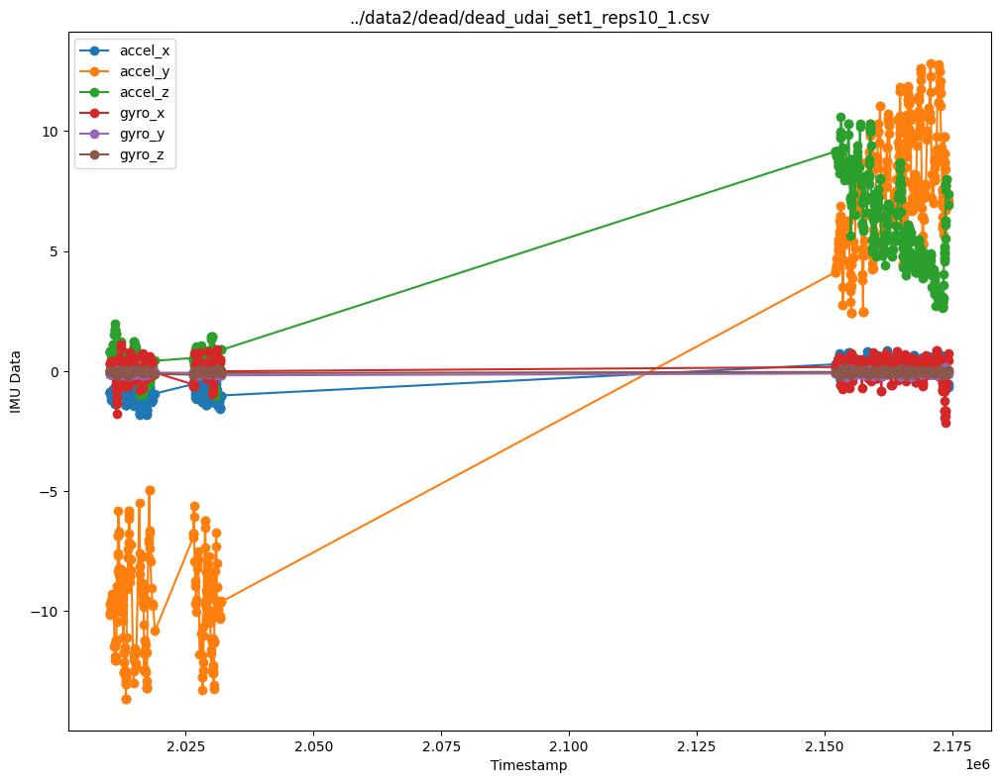

      timestamp   accel_x    accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  2.010142e+06 -0.803580 -10.121252  0.901860  0.291455 -0.131462 -0.011077
1  2.010186e+06 -0.922084  -9.989185  0.745015  0.253517 -0.132169 -0.008388
2  2.010280e+06 -0.989839  -9.852327  0.655712  0.215246 -0.130243 -0.012804
3  2.010442e+06 -1.030018  -9.649394  0.592063  0.158915 -0.124441 -0.026907
4  2.010612e+06 -0.959208  -9.606758  0.649589  0.169258 -0.121247 -0.038119


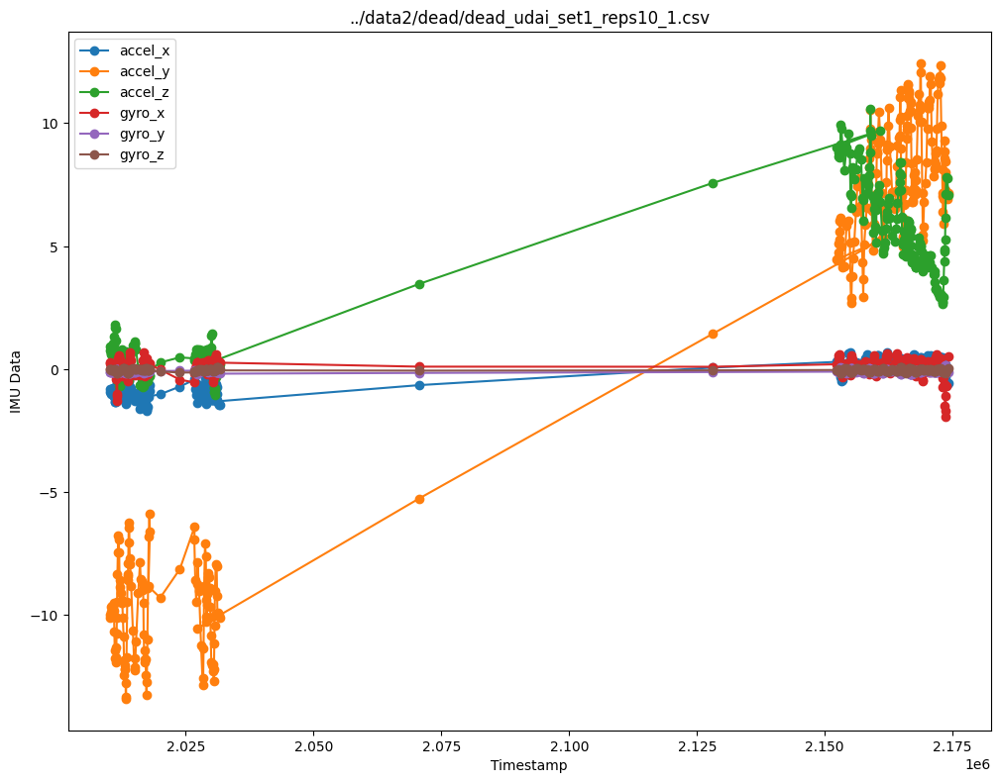

../data2/squat/squat_udai_set3_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    1087528    0.754    6.828   -5.371  -0.420  -0.075  -0.084
1    1087532    0.754    6.828   -5.371  -0.580  -0.075  -0.061
2    1087535    0.754    6.828   -5.371  -0.580  -0.075  -0.061
3    1087539    0.793    5.792   -5.593  -0.701  -0.076  -0.049
4    1087622    1.004    6.267   -5.375  -0.419  -0.083  -0.119


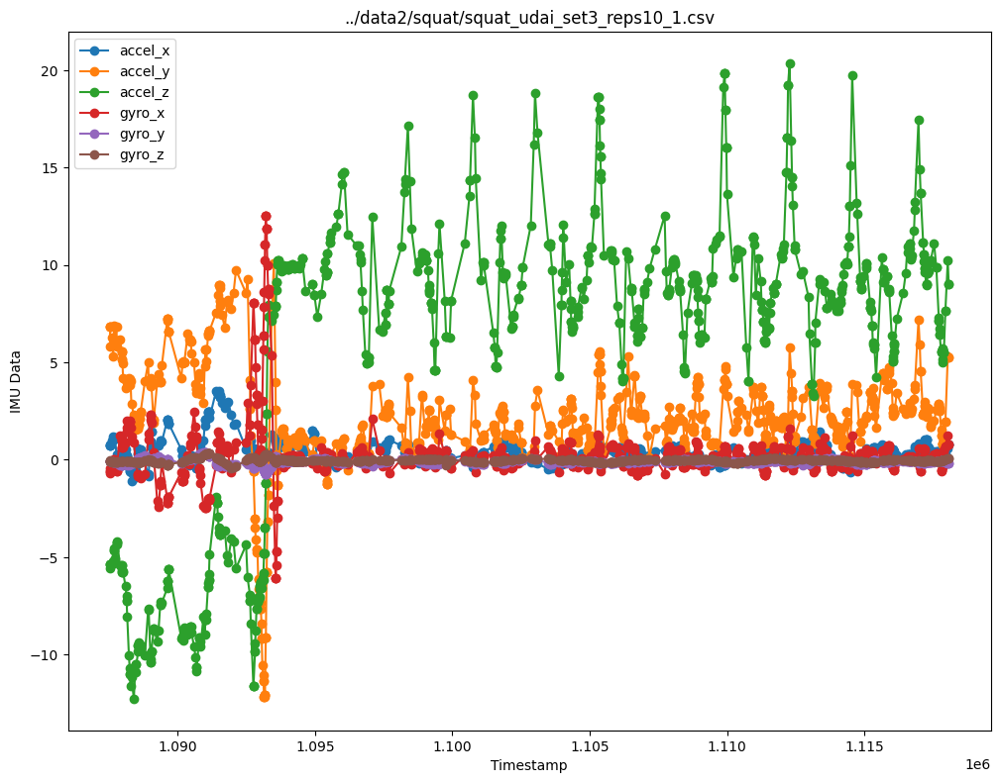

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  1.087509e+06  0.572832  6.868343 -5.481336 -0.692231 -0.068147 -0.064357
1  1.087572e+06  0.964962  6.387370 -5.312905 -0.363192 -0.085563 -0.078645
2  1.087638e+06  1.108842  6.258242 -5.069536 -0.186585 -0.108975 -0.095033
3  1.087711e+06  0.968767  6.574390 -4.664124 -0.173768 -0.137596 -0.117476
4  1.087754e+06  0.394927  6.356659 -4.434860 -0.430938 -0.152429 -0.116103


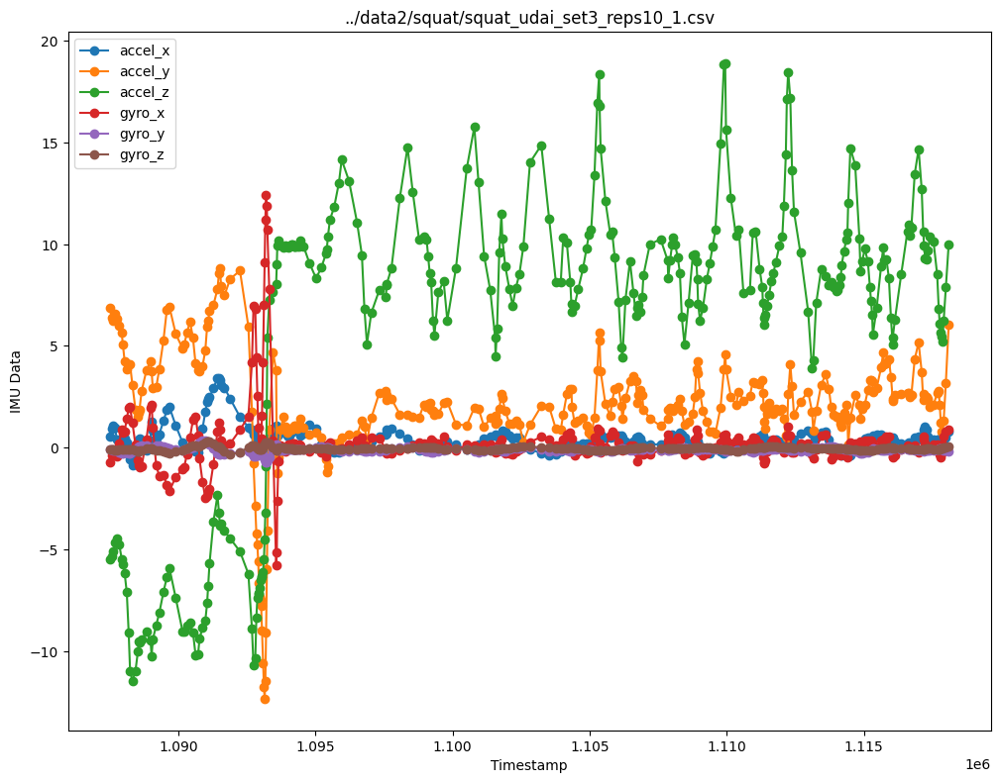

../data2/newDead/newdead_udai_set1_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0      24711    0.897    3.550    9.458   0.111  -0.103  -0.048
1      24715    0.897    3.550    9.458   0.111  -0.103  -0.048
2      24718    0.897    3.550    9.458   0.111  -0.103  -0.048
3      24722    0.900    3.610    9.434   0.112  -0.111  -0.050
4      24772    0.852    3.618    9.440   0.104  -0.101  -0.046


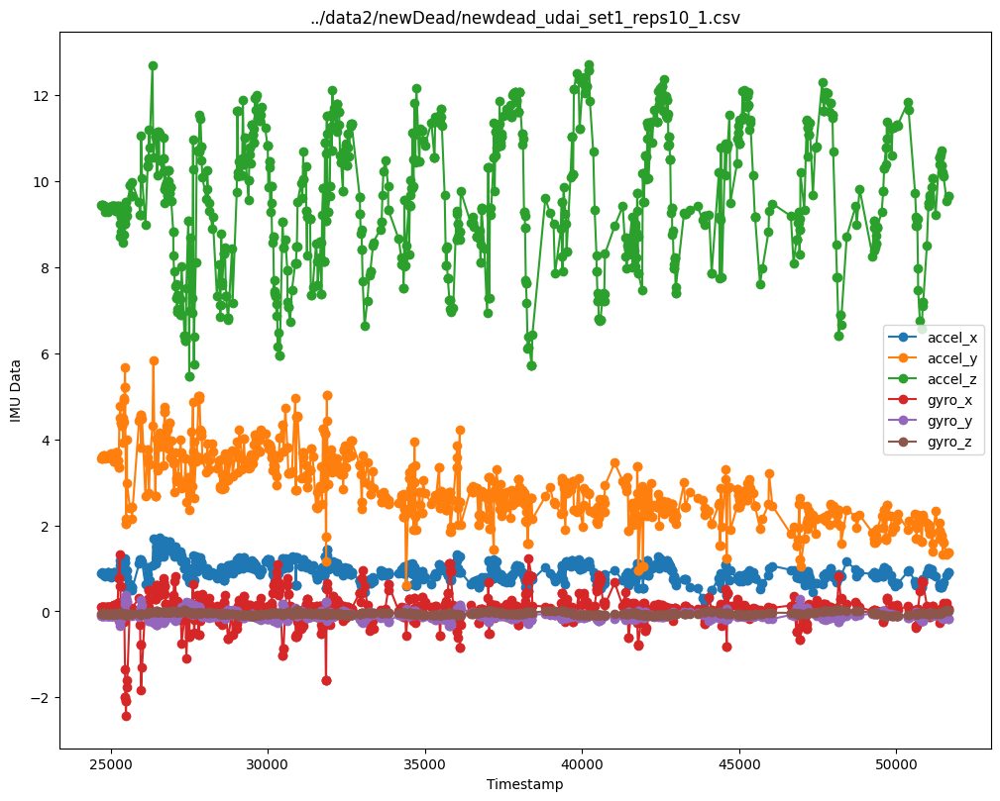

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  24700.237762  0.920629  3.540245  9.463909  0.111042 -0.104273 -0.048322
1  24745.589139  0.861444  3.593371  9.439122  0.108781 -0.102998 -0.047889
2  24817.842817  0.845697  3.606072  9.385032  0.107009 -0.101150 -0.047905
3  24893.923358  0.880264  3.596210  9.348321  0.103884 -0.097941 -0.048238
4  24937.579258  0.901344  3.606590  9.379829  0.090069 -0.096382 -0.049020


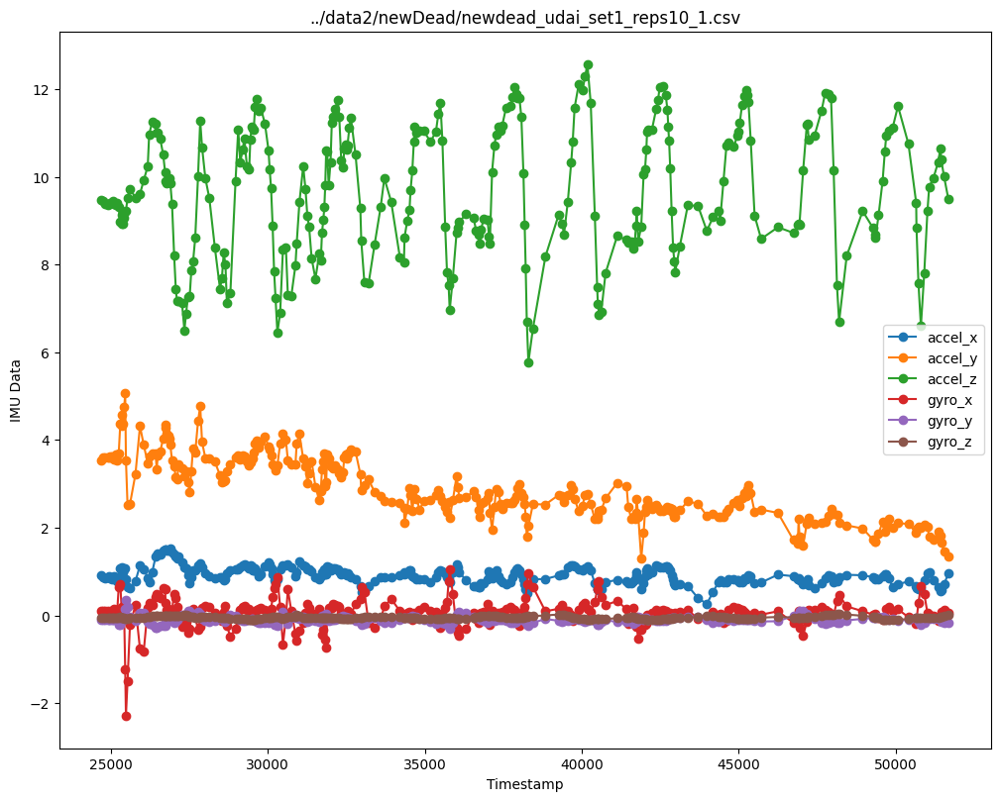

In [3]:
for file in training_files:
    df = create_df(file)
    plot_df(df, str(file))
    df = smooth_and_resample(df)
    plot_df(df, str(file))

../data2/bicep_curl/bicep_adam_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     483292   -0.487   -0.382   10.006   0.156  -0.081  -0.035
1     483296   -0.487   -0.382   10.006   0.156  -0.081  -0.035
2     483300   -0.487   -0.382   10.006   0.156  -0.081  -0.035
3     483303   -0.471   -0.383   10.004   0.154  -0.084  -0.035
4     483325   -0.434   -0.361   10.025   0.148  -0.088  -0.038


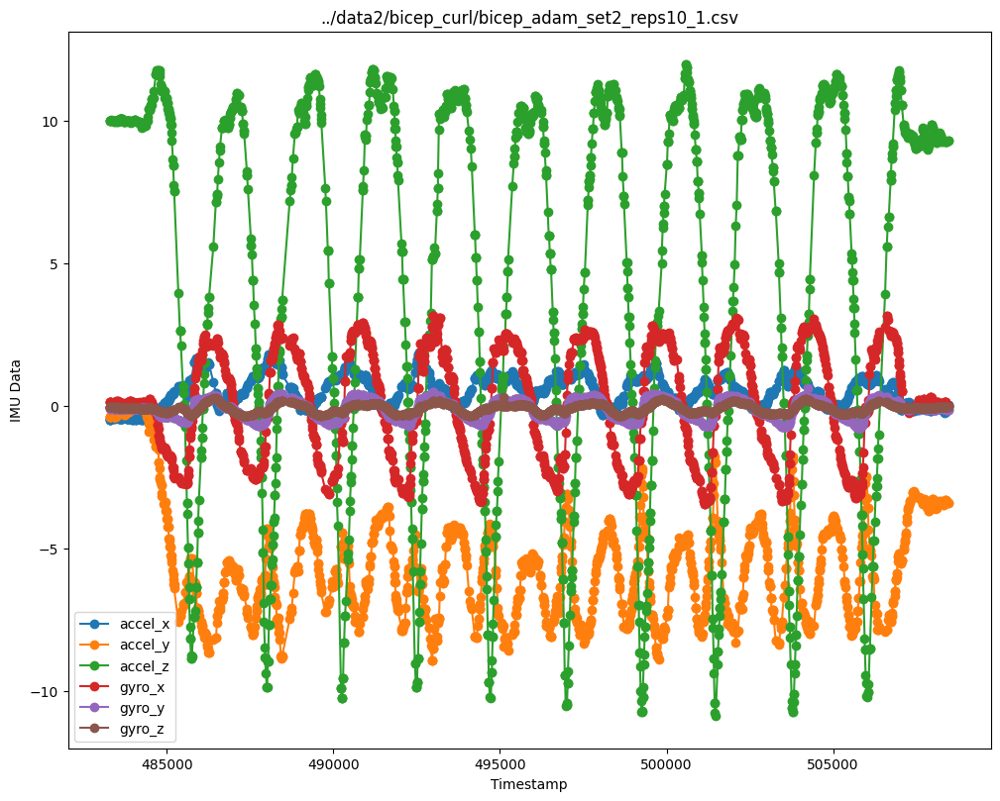

       timestamp   accel_x   accel_y    accel_z    gyro_x    gyro_y    gyro_z
0  483270.146853 -0.506510 -0.385126  10.005608  0.170308 -0.078063 -0.032678
1  483403.141154 -0.415084 -0.368522   9.995007  0.115605 -0.091993 -0.044272
2  483479.624350 -0.411291 -0.352340   9.995334  0.165158 -0.083762 -0.046120
3  483570.690678 -0.426893 -0.214926  10.024716  0.136970 -0.088547 -0.049015
4  483628.811080 -0.438200 -0.221593  10.072424  0.110895 -0.091645 -0.050404


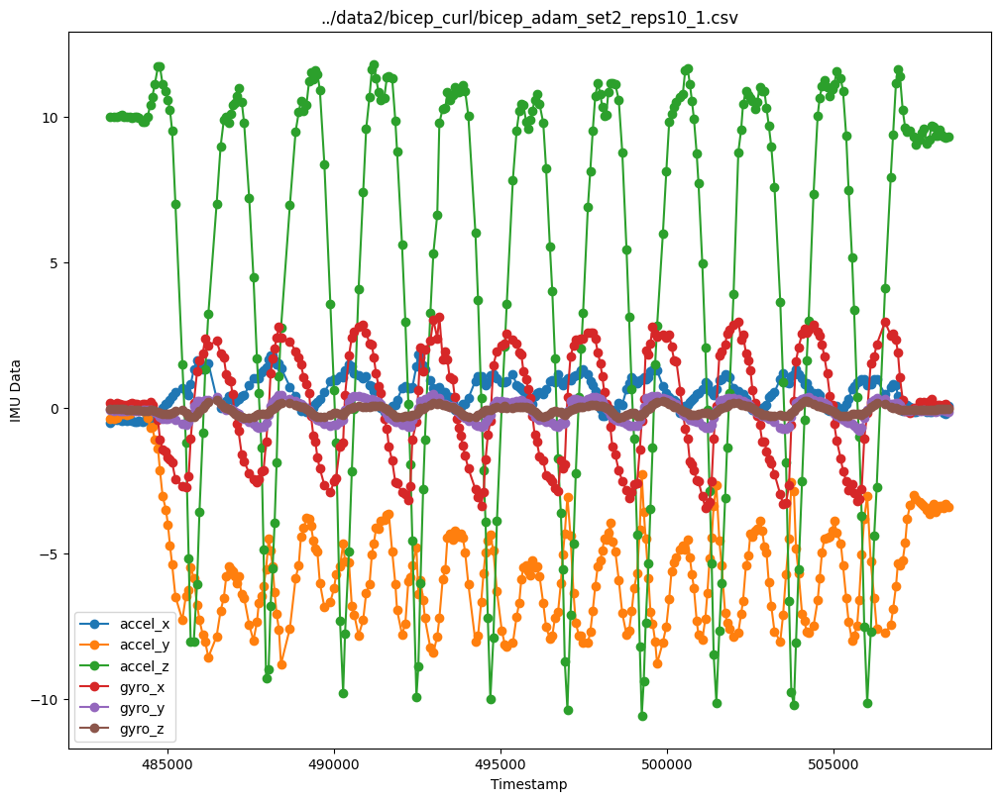

../data2/bicep_curl/bicep_andrew_set3_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    2823131   -0.607   -9.600   -2.028   0.089  -0.117  -0.039
1    2823134   -0.607   -9.600   -2.039   0.089  -0.117  -0.039
2    2823138   -0.577   -9.570   -2.039   0.109  -0.123  -0.043
3    2823245   -0.621   -9.514   -2.047   0.049  -0.108  -0.046
4    2823282   -0.650   -9.497   -2.061   0.092  -0.106  -0.046


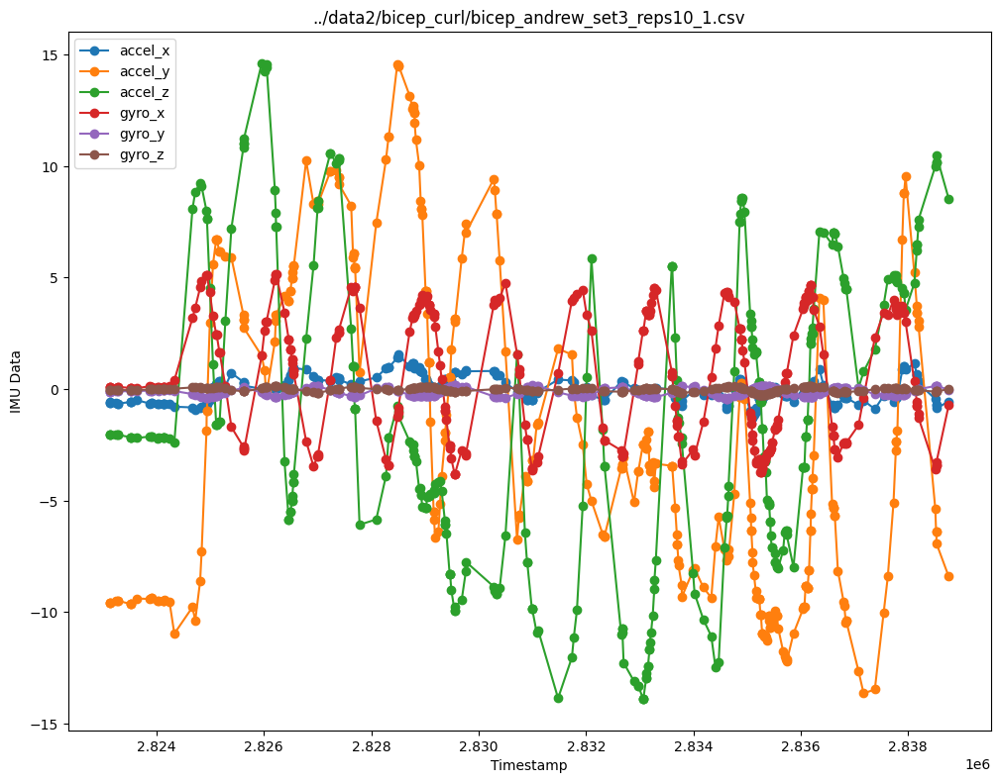

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  2.823118e+06 -0.608406 -9.560860 -2.008972  0.105049 -0.120399 -0.033783
1  2.823143e+06 -0.609987 -9.573118 -2.030265  0.091291 -0.117236 -0.040345
2  2.823179e+06 -0.610494 -9.579922 -2.050803  0.080123 -0.113815 -0.045354
3  2.823227e+06 -0.609927 -9.581270 -2.070587  0.071544 -0.110135 -0.048810
4  2.823285e+06 -0.608285 -9.577163 -2.089615  0.065554 -0.106197 -0.050713


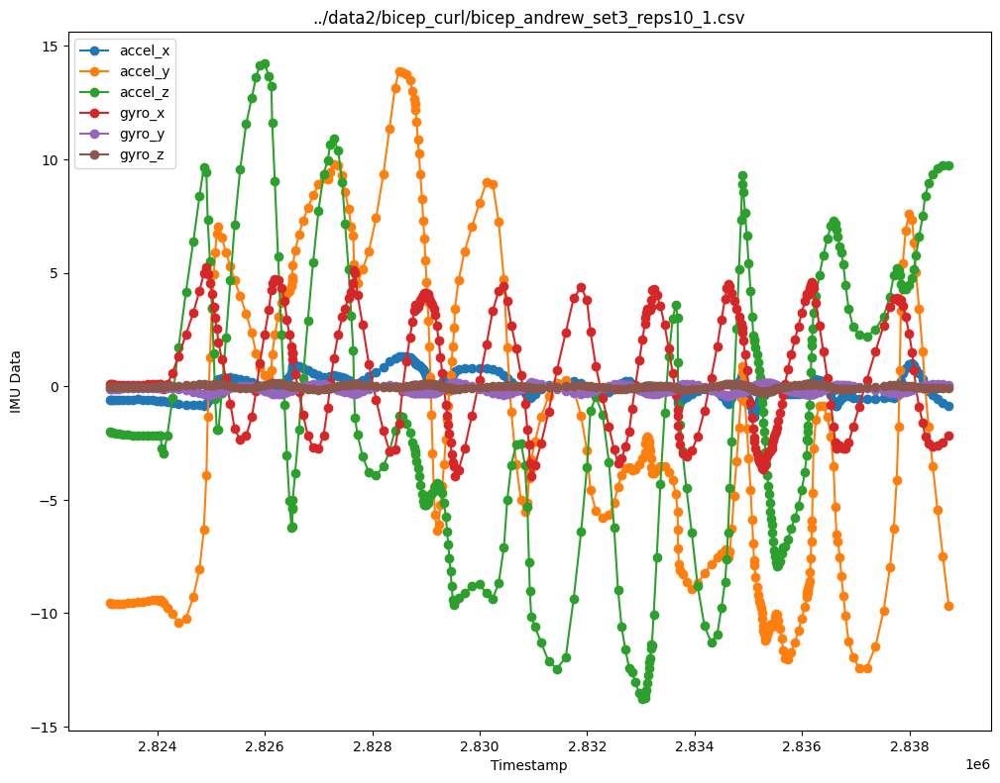

../data2/bicep_curl/bicep_anuj_set2_rep10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     498113   -0.099   -0.749   -9.643   0.032  -0.086  -0.046
1     498116   -0.099   -0.749   -9.643   0.032  -0.086  -0.046
2     498120   -0.099   -0.749   -9.643   0.032  -0.086  -0.046
3     498123   -0.049   -0.749   -9.727   0.046  -0.101  -0.050
4     498145   -0.056   -0.724   -9.723   0.060  -0.095  -0.048


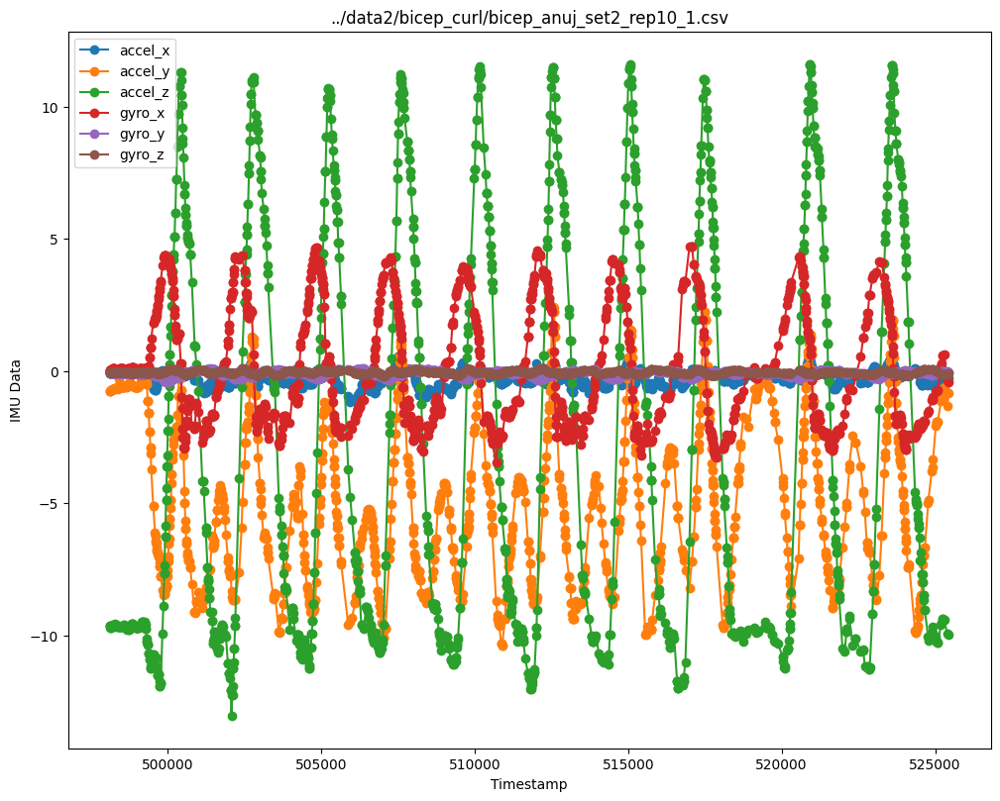

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  498108.069930 -0.107986 -0.756497 -9.627091  0.024713 -0.084378 -0.045895
1  498150.093249 -0.052876 -0.722925 -9.709195  0.062467 -0.097022 -0.048213
2  498203.836986 -0.043914 -0.690245 -9.630738  0.089545 -0.100145 -0.049074
3  498250.159639 -0.062825 -0.667829 -9.601825  0.088381 -0.098859 -0.049489
4  498304.676061 -0.066957 -0.642032 -9.628778  0.050417 -0.093886 -0.048996


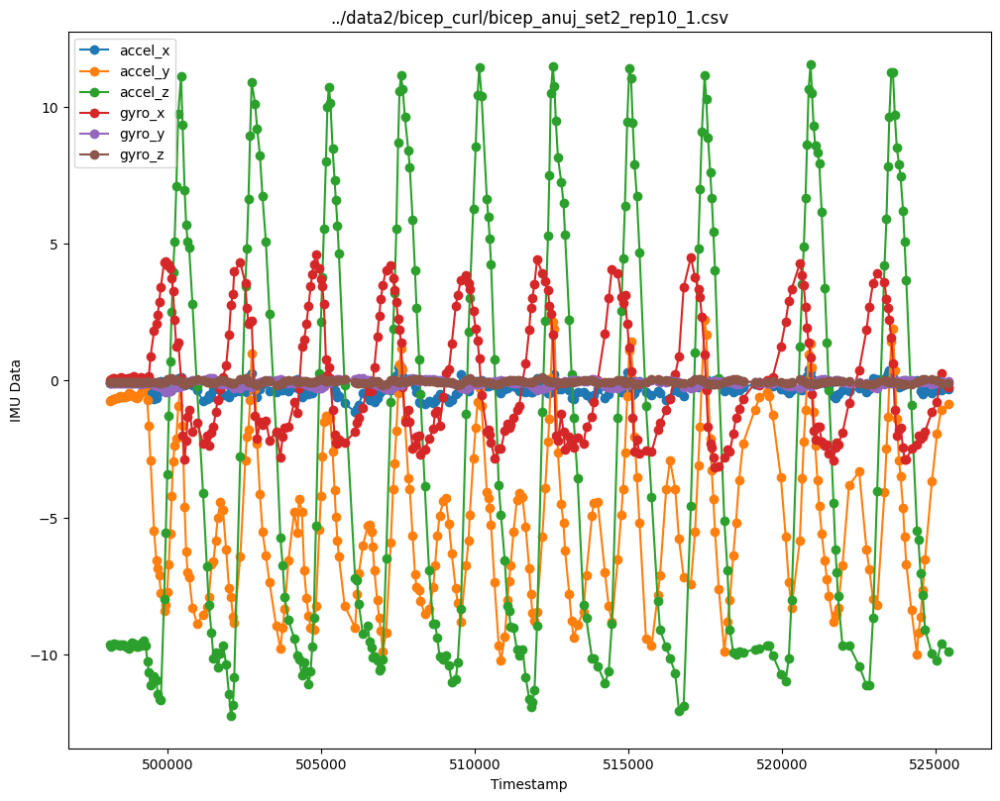

../data2/bicep_curl/bicep_jake_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     609935    1.385    9.206    3.515   0.057  -0.104  -0.029
1     609939    1.370    9.202    3.549   0.053  -0.105  -0.029
2     609942    1.370    9.202    3.549   0.053  -0.105  -0.029
3     609946    1.370    9.202    3.549   0.053  -0.105  -0.029
4     609966    1.370    9.249    3.565   0.048  -0.099  -0.029


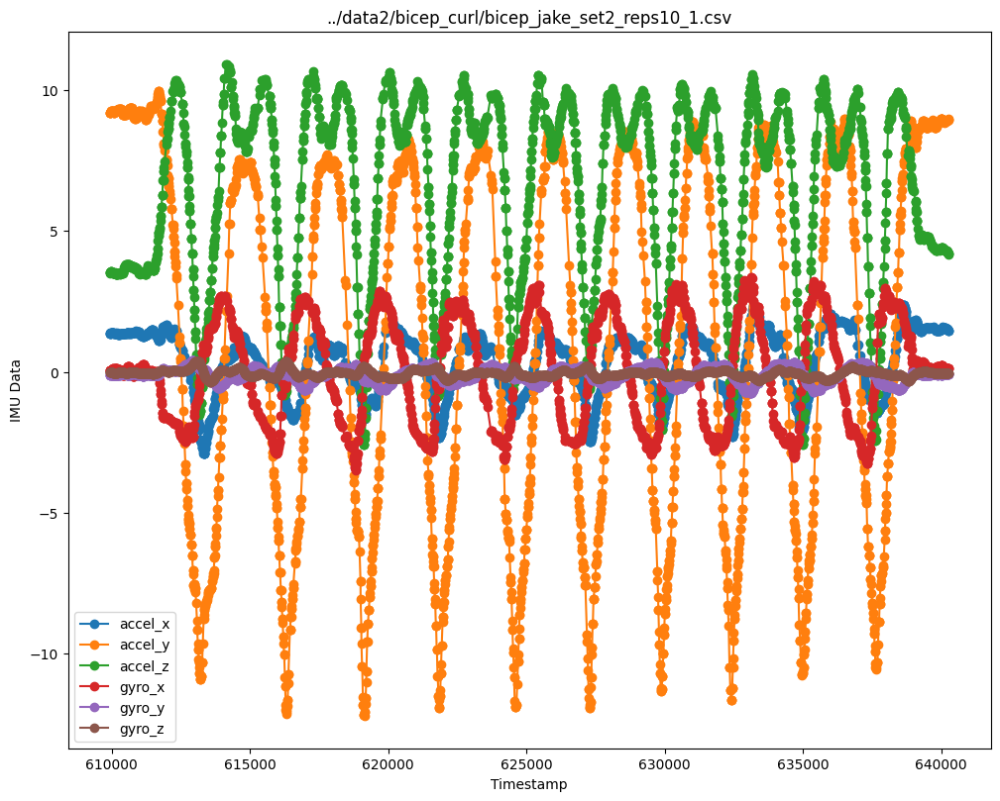

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  609932.685315  1.374077  9.197741  3.522469  0.058245 -0.106035 -0.028552
1  610002.633807  1.390911  9.232476  3.549791  0.073168 -0.106044 -0.030905
2  610085.120245  1.375156  9.227296  3.494134  0.108733 -0.111133 -0.038010
3  610168.570760  1.366666  9.266355  3.471346  0.106407 -0.110255 -0.037334
4  610268.112301  1.317865  9.320019  3.498958  0.084703 -0.108771 -0.032008


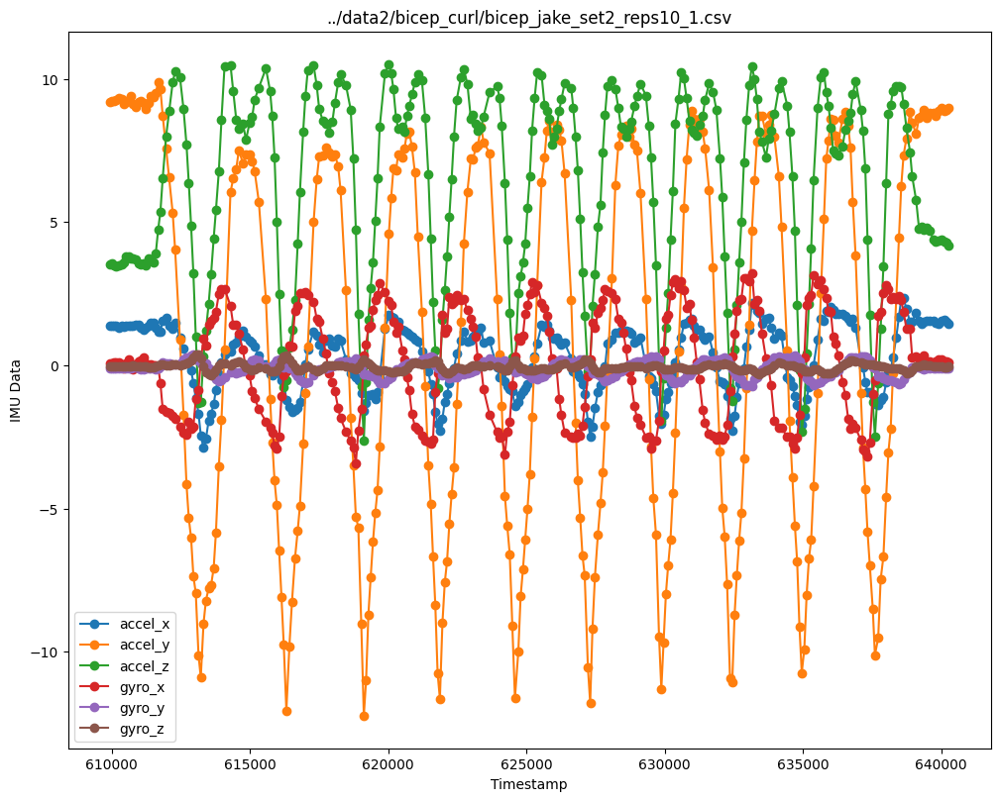

../data2/bicep_curl/bicep_kamyar_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    3764331    0.542   -2.755   -8.573  -1.324  -0.057  -0.153
1    3764334    0.505   -2.521   -8.501  -1.283  -0.045  -0.158
2    3764337    0.505   -2.521   -8.501  -1.283  -0.045  -0.158
3    3764361    0.497   -2.380   -8.303  -1.223  -0.021  -0.167
4    3764365    0.511   -2.296   -8.234  -1.201  -0.005  -0.171


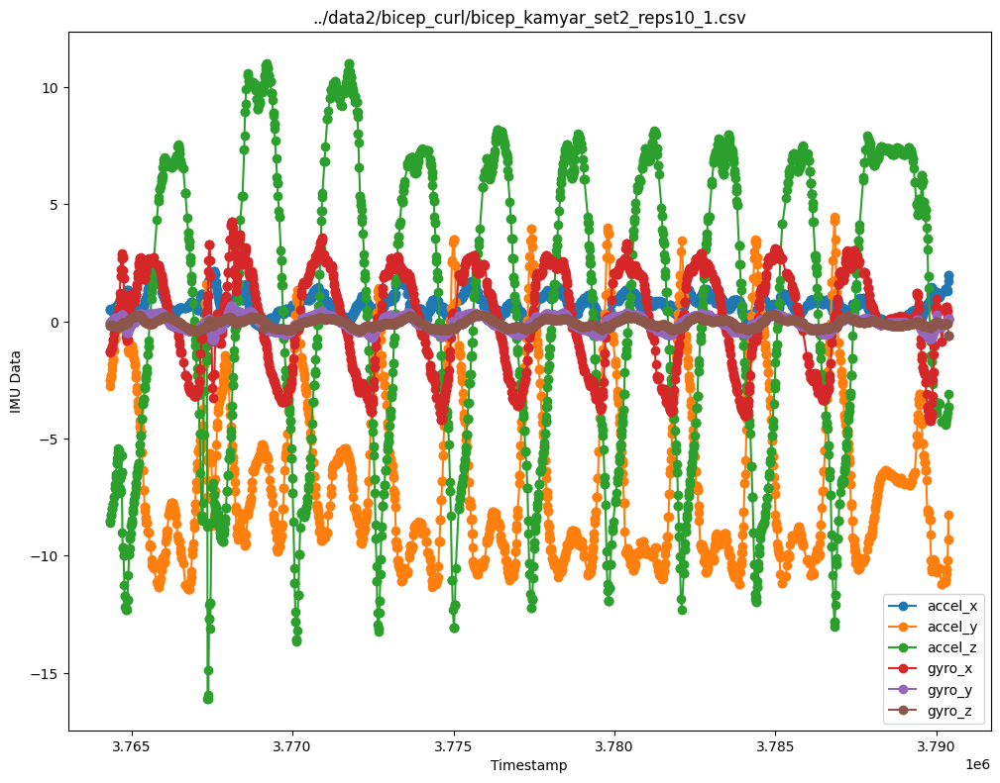

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  3.764327e+06  0.536280 -2.713182 -8.599483 -1.293441 -0.055294 -0.153615
1  3.764395e+06  0.470978 -1.933854 -7.993990 -1.076910  0.034642 -0.177566
2  3.764473e+06  0.505179 -0.935522 -7.220567 -0.377609  0.143413 -0.198373
3  3.764546e+06  0.646150 -0.212779 -5.959340  0.162045  0.176038 -0.225988
4  3.764616e+06  0.395712  0.391089 -6.265222  0.700519  0.153037 -0.214213


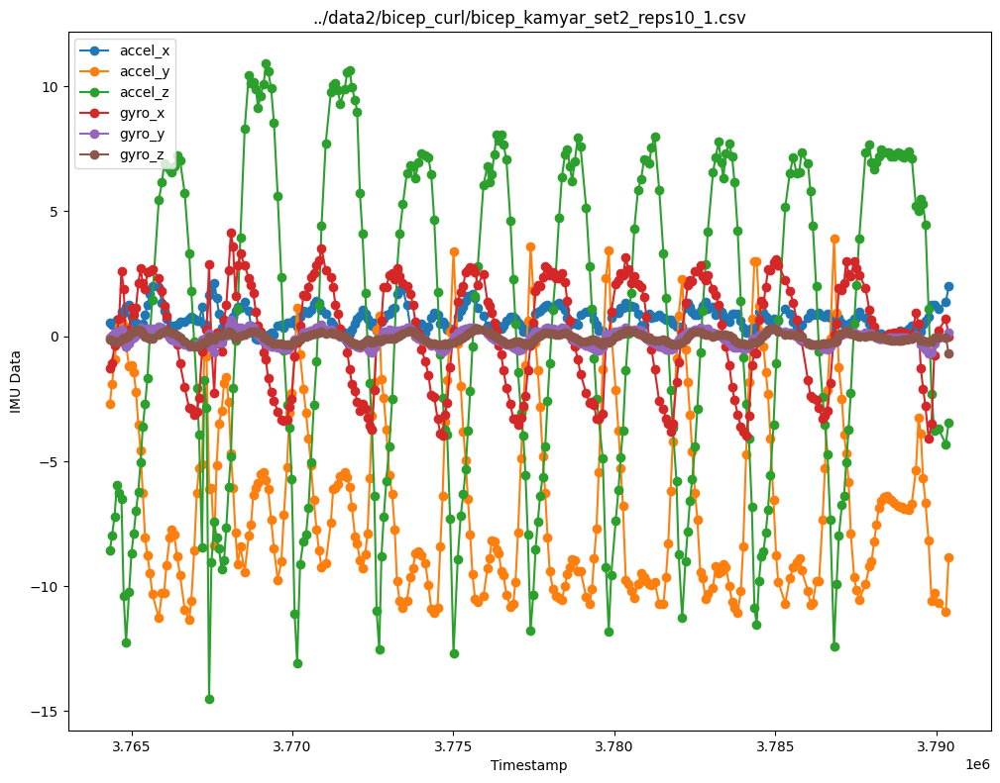

../data2/bicep_curl/bicep_mike_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    2661746   -0.810    0.079   10.097   0.149  -0.051  -0.095
1    2661749   -0.810    0.079   10.097   0.149  -0.051  -0.095
2    2661771   -0.827    0.126    9.971   0.165  -0.044  -0.092
3    2661775   -0.827    0.126    9.971   0.165  -0.044  -0.092
4    2661779   -0.827    0.126    9.971   0.165  -0.044  -0.092


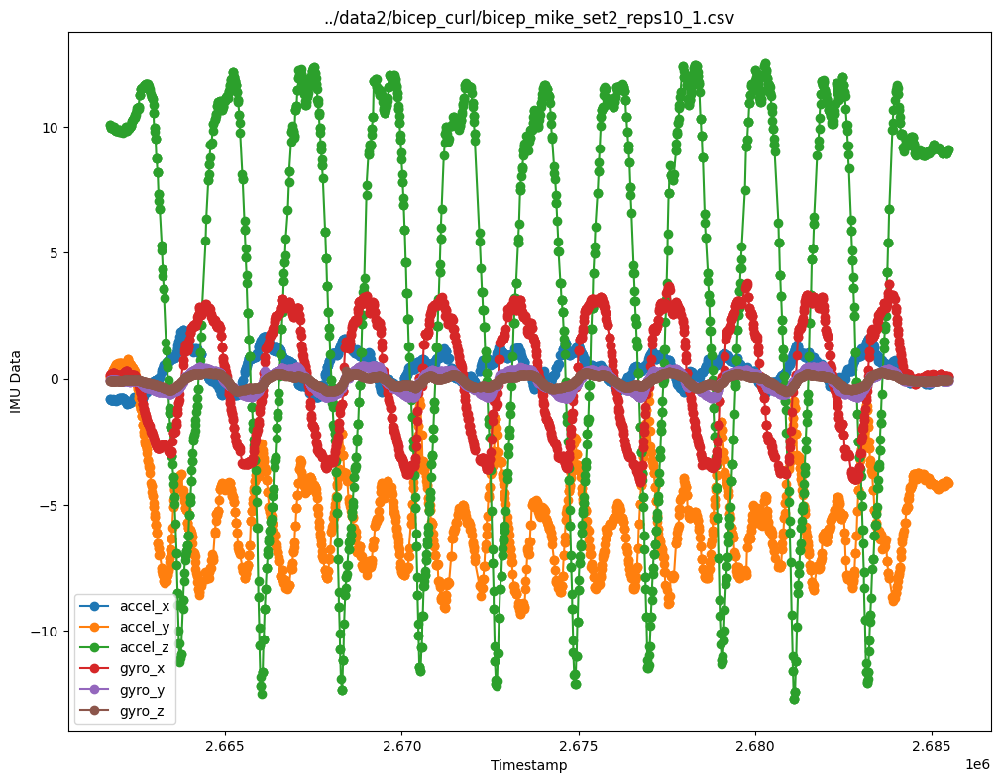

      timestamp   accel_x   accel_y    accel_z    gyro_x    gyro_y    gyro_z
0  2.661744e+06 -0.808049  0.084028  10.090510  0.146322 -0.050000 -0.095832
1  2.661812e+06 -0.832189  0.216817   9.970157  0.202521 -0.043500 -0.084613
2  2.661881e+06 -0.840640  0.434535   9.931575  0.211148 -0.043697 -0.080277
3  2.661960e+06 -0.831826  0.583372   9.865843  0.130471 -0.068472 -0.079322
4  2.662037e+06 -0.784559  0.594739   9.849136  0.131563 -0.084202 -0.075988


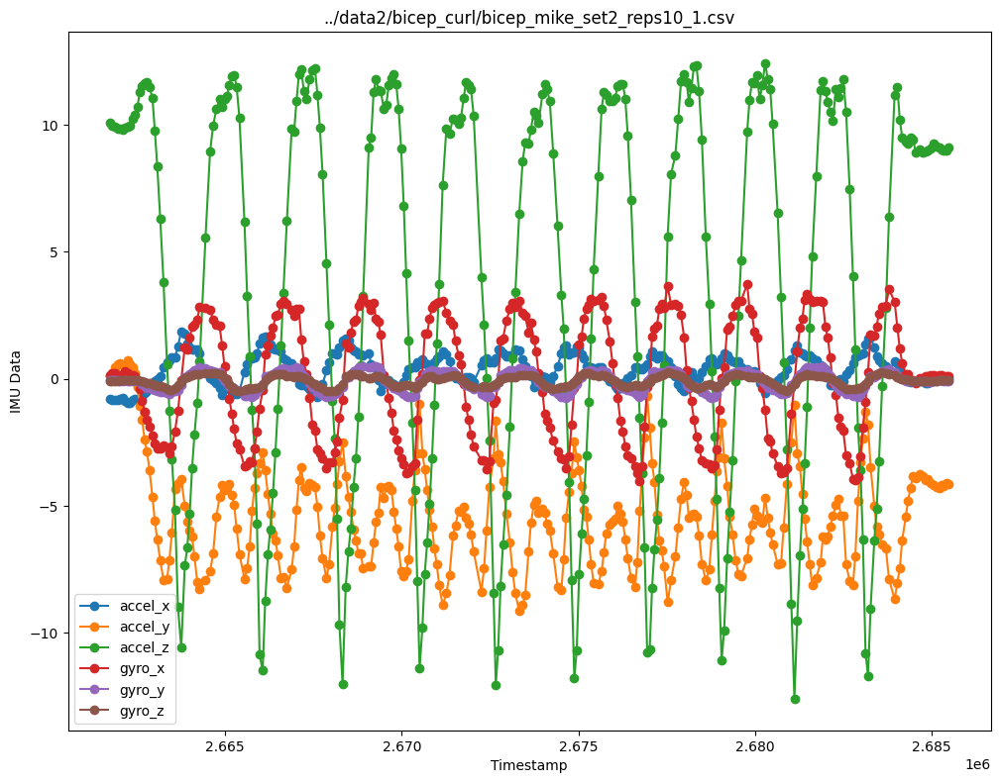

../data2/bicep_curl/bicep_suzan_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     413976   -1.720   -9.604    0.260   0.021  -0.101  -0.042
1     413980   -1.720   -9.604    0.260   0.021  -0.101  -0.042
2     413984   -1.685   -9.697    0.199   0.016  -0.100  -0.042
3     413987   -1.685   -9.697    0.199   0.016  -0.100  -0.042
4     414038   -1.813  -10.056   -0.126   0.154  -0.122  -0.033


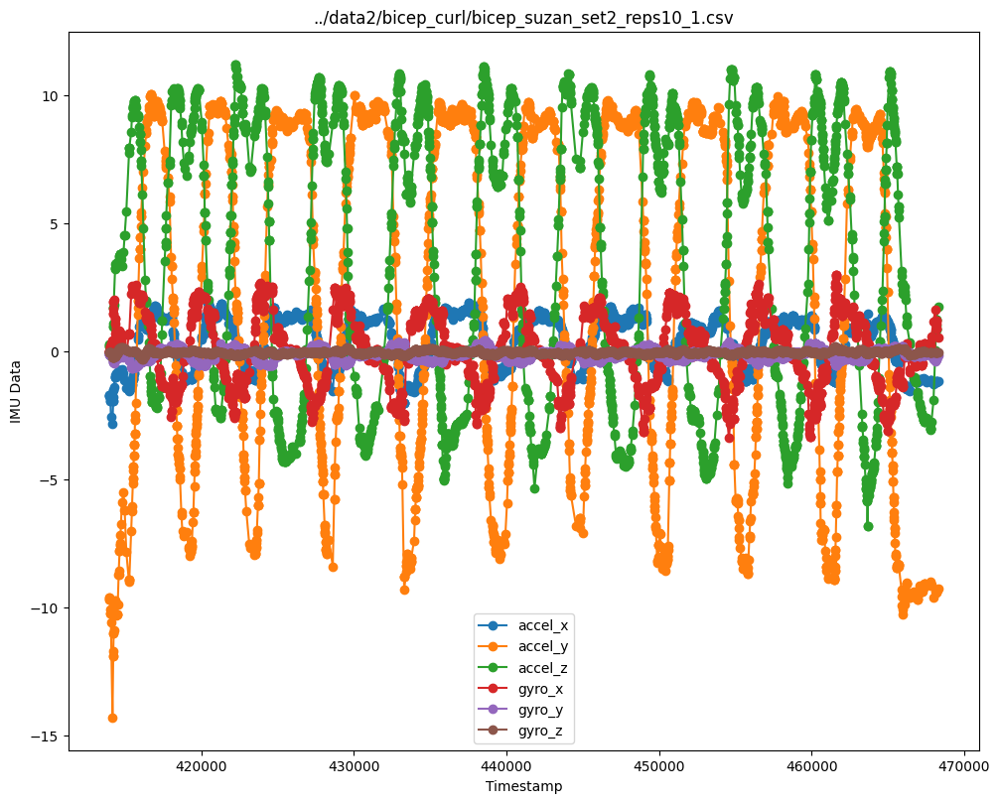

       timestamp   accel_x    accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  413978.013986 -1.536252  -9.426042  0.472147  0.126888 -0.117804 -0.060217
1  414135.689486 -2.267047 -11.757372  0.226349  0.689674 -0.209484 -0.130145
2  414309.678688 -1.107580 -10.084232  2.830545  1.476919 -0.376584 -0.206268
3  414538.366957 -0.842223  -9.624928  3.419063  0.325107 -0.146606  0.006394
4  414661.467736 -0.829907  -7.534305  3.781609  0.580958 -0.185993  0.137151


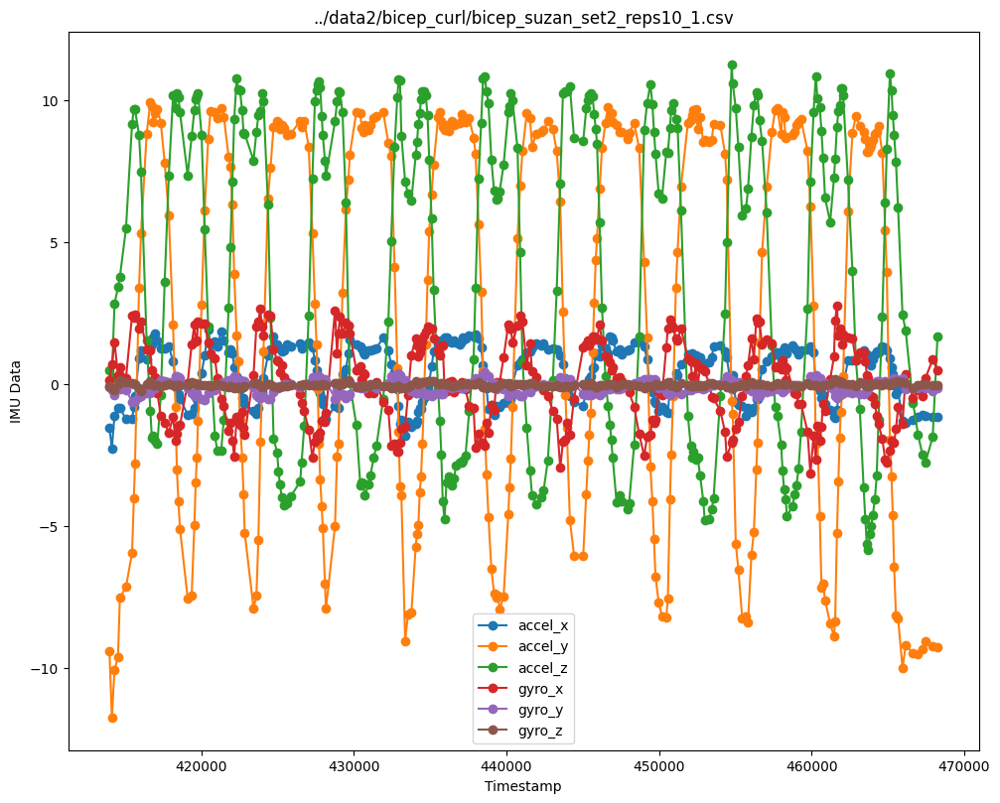

../data2/bicep_curl/bicep_udai_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     509766   -0.998   -3.898    9.041   0.055  -0.066  -0.054
1     509770   -0.998   -3.898    9.041   0.055  -0.066  -0.054
2     509773   -0.997   -3.916    9.064   0.089  -0.076  -0.054
3     509777   -0.997   -3.916    9.064   0.089  -0.076  -0.054
4     509797   -1.072   -3.862    9.023   0.170  -0.084  -0.050


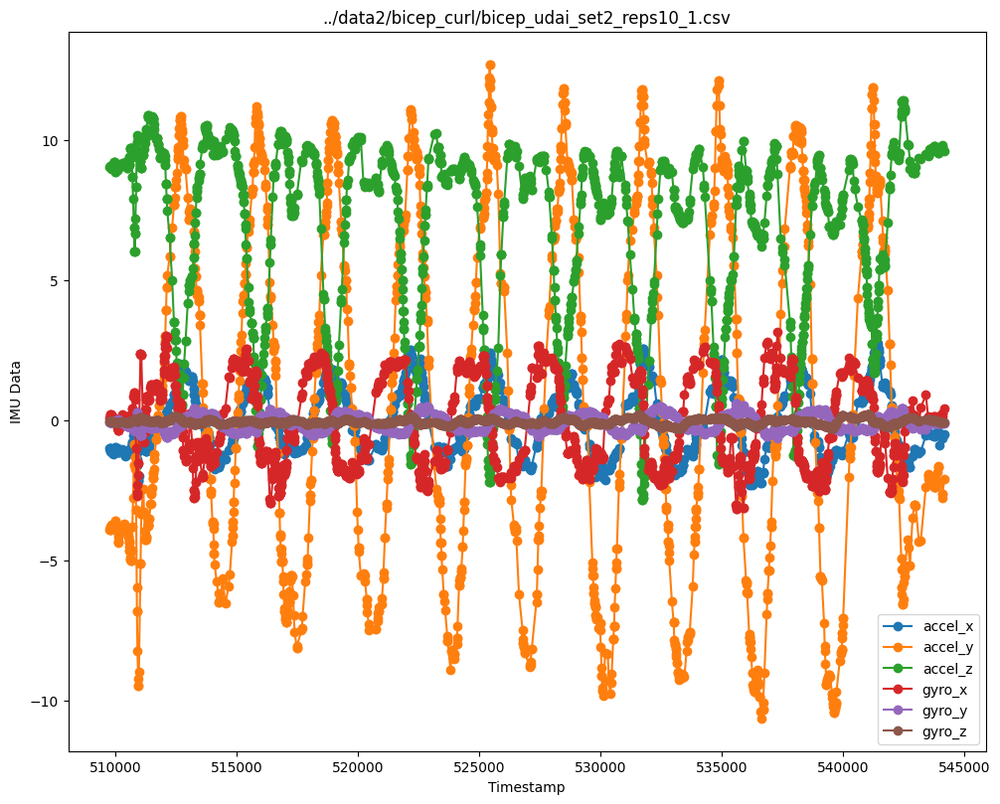

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  509774.615385 -0.972224 -3.935580  9.079685  0.005434 -0.059119 -0.059510
1  509808.898621 -1.103806 -3.802131  9.026164  0.174164 -0.084373 -0.047901
2  509951.350750 -1.142187 -3.786453  9.194246 -0.004410 -0.049888 -0.075858
3  510024.349526 -0.993844 -3.684020  8.919852 -0.022604 -0.044809 -0.078682
4  510093.482970 -1.096392 -4.166050  9.013851 -0.367653  0.024490 -0.078118


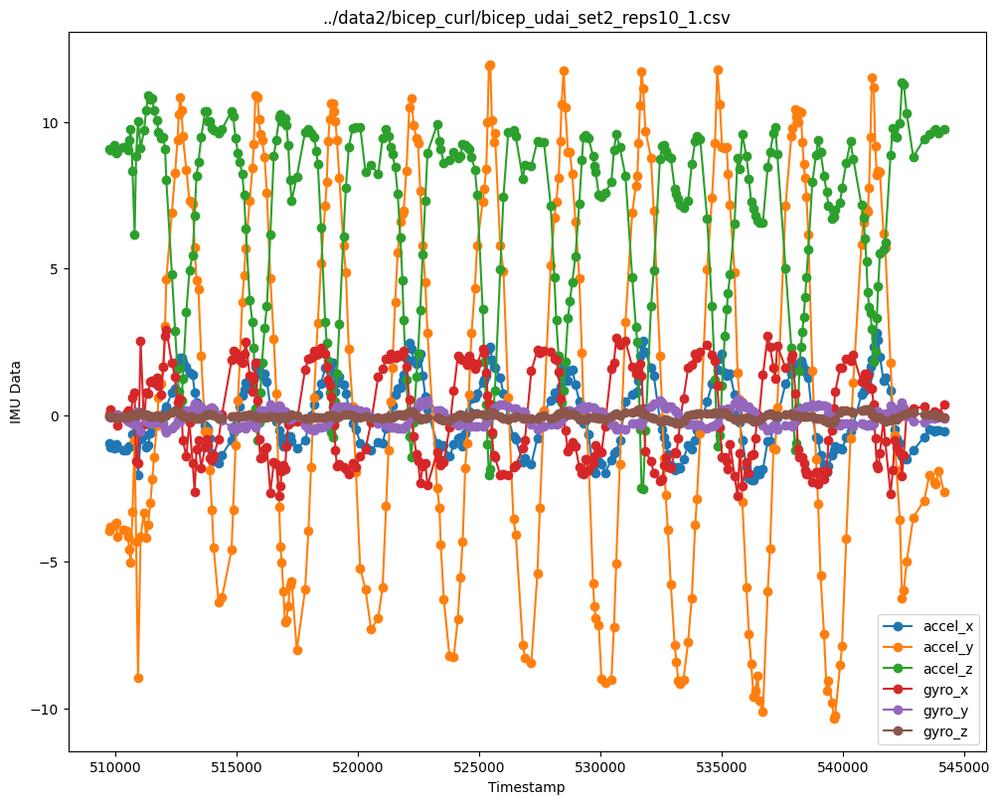

../data2/shoulder_press/shoulder_adam_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    1833267    1.167   -9.806    1.425   0.247  -0.053  -0.097
1    1833270    1.190   -9.869    1.494   0.257  -0.048  -0.097
2    1833292    1.181   -9.947    1.486   0.274  -0.048  -0.093
3    1833296    1.181   -9.947    1.486   0.274  -0.048  -0.093
4    1833299    1.208   -9.970    1.537   0.279  -0.048  -0.092


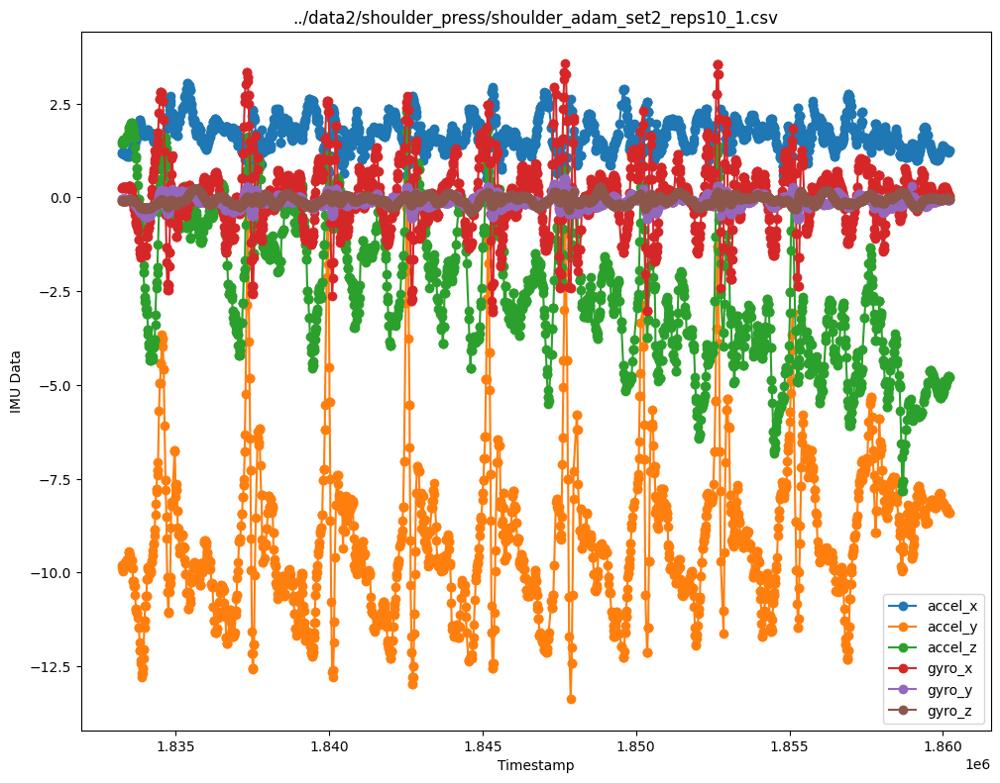

      timestamp   accel_x    accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  1.833265e+06  1.175881  -9.848448  1.462860  0.251853 -0.050783 -0.097916
1  1.833339e+06  1.172848  -9.798930  1.488598  0.264208 -0.050614 -0.087900
2  1.833426e+06  1.128248  -9.603274  1.668219  0.273647 -0.051671 -0.077175
3  1.833534e+06  1.182914  -9.642556  1.958313  0.257482 -0.057693 -0.068655
4  1.833637e+06  1.343387 -10.260548  1.721266 -0.211431 -0.134844 -0.081619


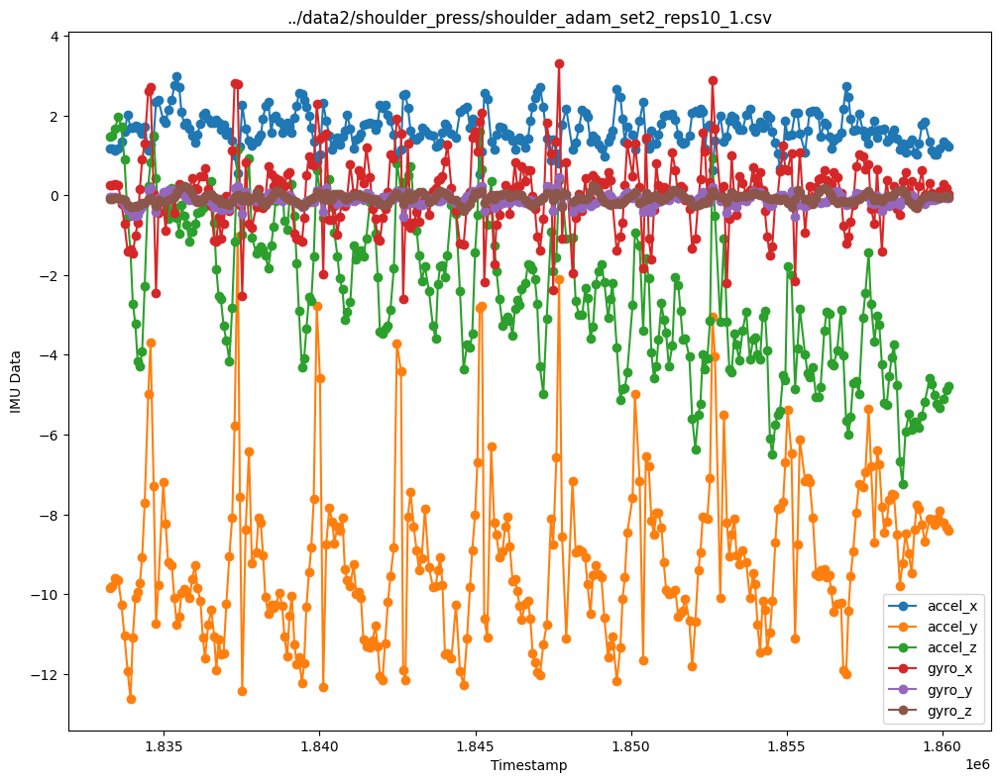

../data2/shoulder_press/shoulder_andrew_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     340250   -0.226   -3.605    9.307   0.106  -0.100  -0.035
1     340253   -0.220   -3.595    9.351   0.106  -0.095  -0.033
2     340256   -0.220   -3.595    9.351   0.110  -0.095  -0.033
3     340260   -0.220   -3.595    9.351   0.110  -0.095  -0.033
4     340310   -0.214   -3.617    9.327   0.139  -0.100  -0.032


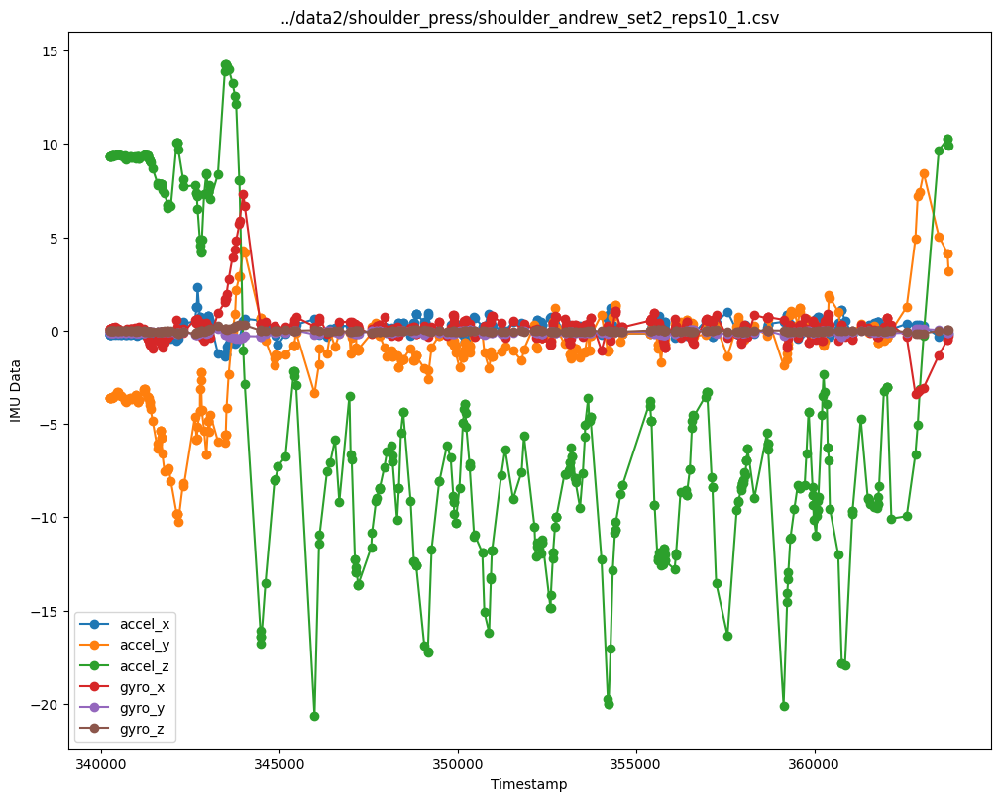

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  340243.860140 -0.230629 -3.586413  9.329084  0.099490 -0.096692 -0.034161
1  340257.992478 -0.220948 -3.600792  9.334573  0.110187 -0.097228 -0.033570
2  340273.560301 -0.212571 -3.607819  9.340303  0.120893 -0.097756 -0.033096
3  340290.566485 -0.205499 -3.607479  9.346274  0.131606 -0.098277 -0.032739
4  340308.182091 -0.200015 -3.604047  9.349929  0.145429 -0.099134 -0.032524


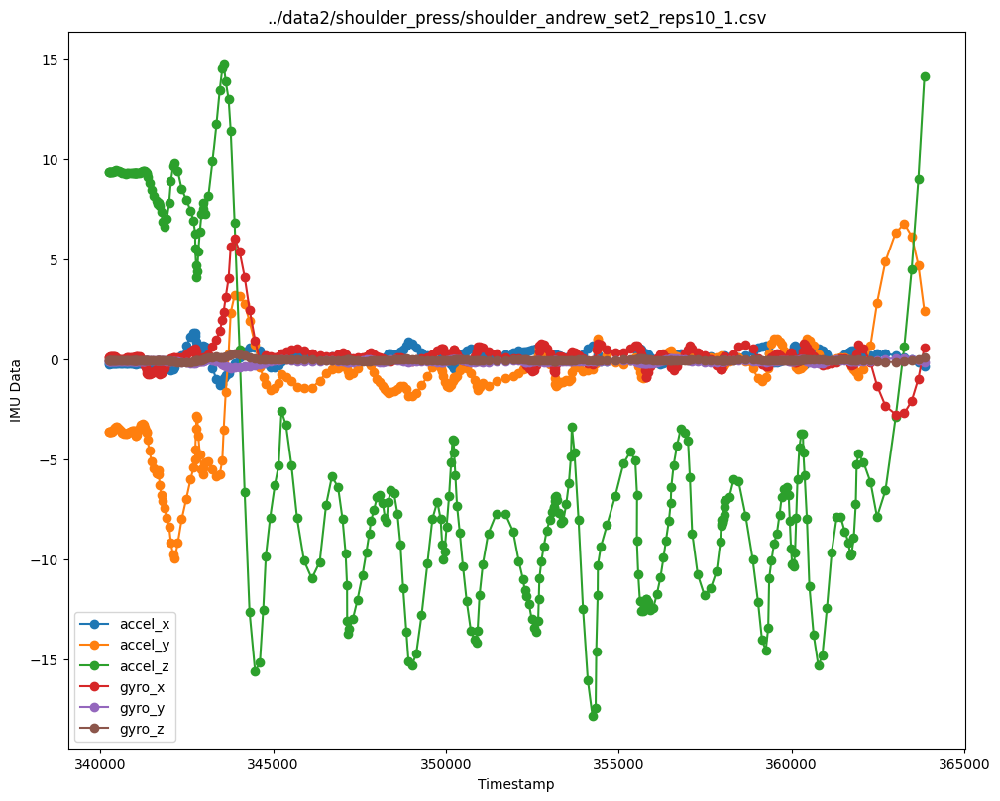

../data2/shoulder_press/shoulder_anuj_set2_rep10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     348886    0.127   -3.433   -8.930   0.110  -0.084   -0.02
1     348890    0.127   -3.433   -8.930   0.110  -0.084   -0.02
2     348894    0.127   -3.433   -8.930   0.110  -0.084   -0.02
3     348897    0.130   -3.466   -8.928   0.077  -0.083   -0.02
4     348918    0.142   -3.468   -8.920   0.043  -0.086   -0.02


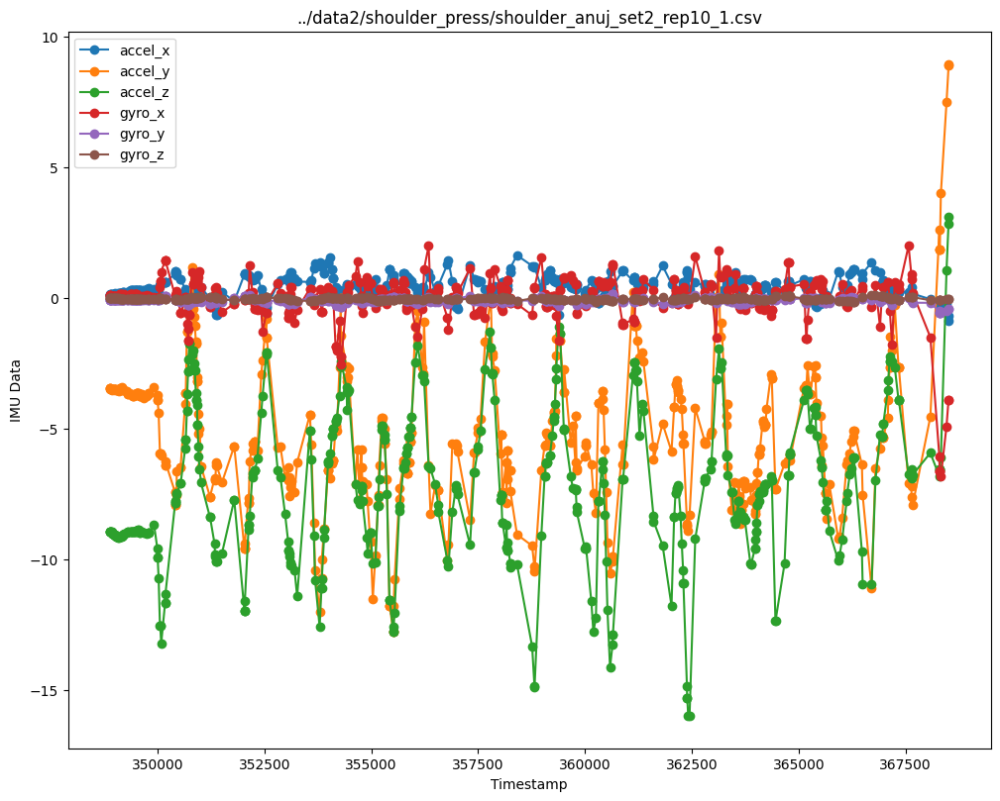

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  348883.664336  0.128531 -3.419972 -8.932776  0.127958 -0.082755 -0.019965
1  348893.376149  0.129517 -3.444917 -8.922986  0.090173 -0.084482 -0.020048
2  348906.672498  0.130214 -3.465608 -8.926191  0.063462 -0.085367 -0.019950
3  348923.618059  0.130475 -3.482415 -8.942769  0.047627 -0.085398 -0.019658
4  348946.708905  0.128315 -3.499844 -8.980476  0.041303 -0.084451 -0.018974


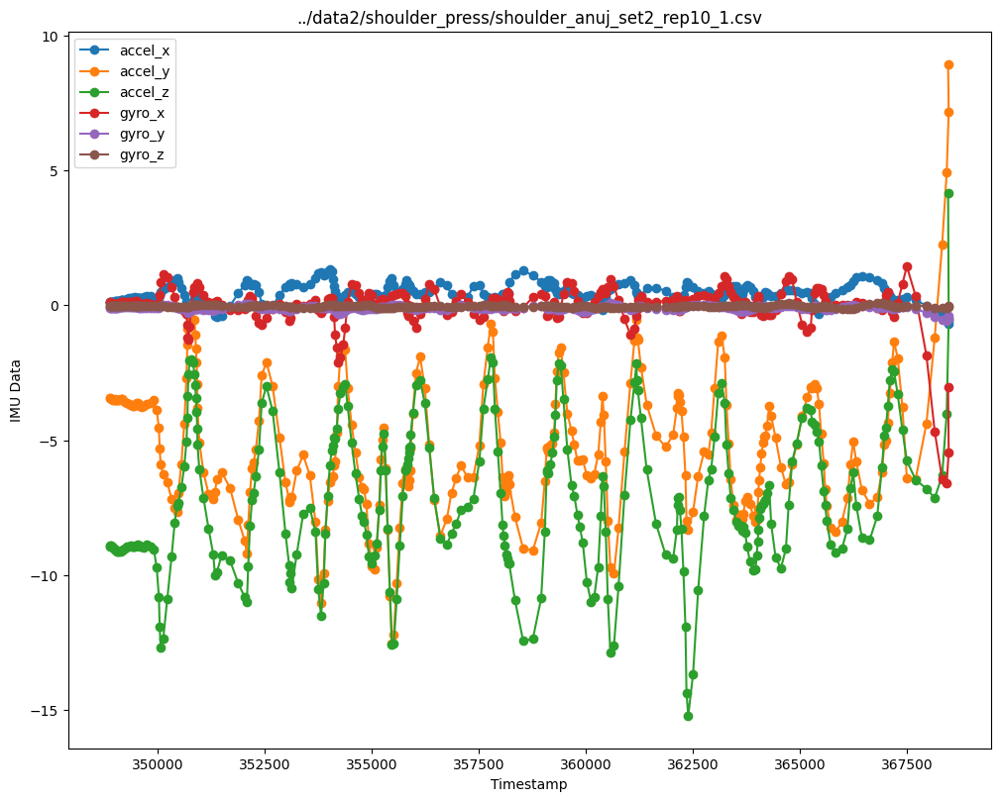

../data2/shoulder_press/shoulder_kamyar_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    4569370    1.458   -6.913   -6.893   0.285  -0.084  -0.065
1    4569392    1.429   -6.895   -6.833   0.210  -0.101  -0.067
2    4569396    1.413   -6.895   -6.833   0.170  -0.106  -0.070
3    4569422    1.448   -6.985   -6.798   0.045  -0.126  -0.077
4    4569426    1.448   -6.985   -6.798   0.045  -0.126  -0.077


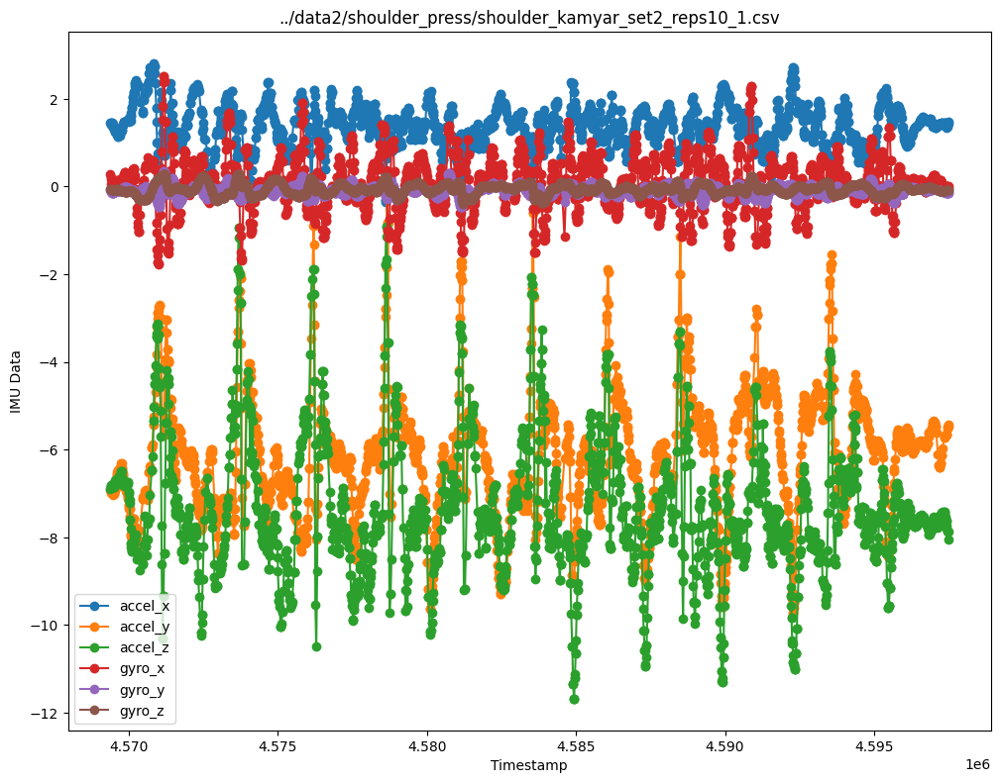

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  4.569374e+06  1.435510 -6.894399 -6.857755  0.282622 -0.086727 -0.064930
1  4.569464e+06  1.415563 -6.989183 -6.819454 -0.062898 -0.140648 -0.080384
2  4.569543e+06  1.277570 -6.930667 -6.766863  0.051316 -0.120431 -0.073993
3  4.569645e+06  1.168611 -6.452524 -6.690434  0.073752 -0.098354 -0.074387
4  4.569751e+06  1.268361 -6.375288 -6.530829  0.172571 -0.065356 -0.095518


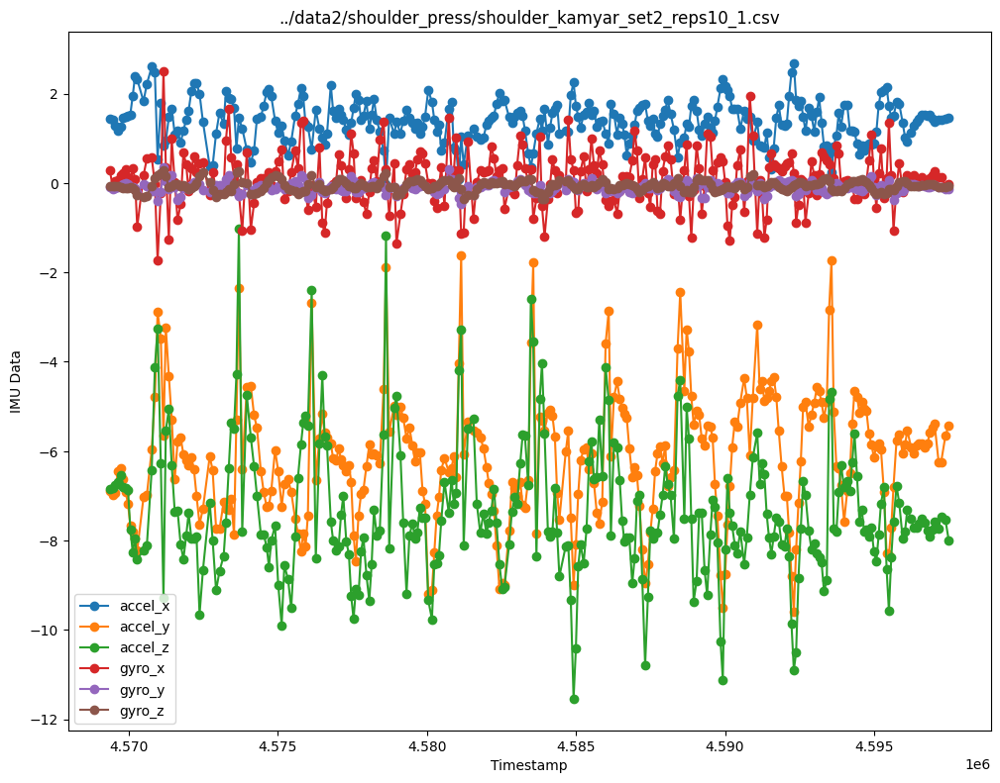

../data2/shoulder_press/shoulder_mike_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    3321157    0.500   -7.031    6.928  -0.153  -0.175   0.006
1    3321160    0.468   -6.986    6.930  -0.140  -0.178   0.010
2    3321164    0.468   -6.986    6.930  -0.140  -0.178   0.010
3    3321215    0.418   -6.779    6.870   0.009  -0.180   0.023
4    3321219    0.432   -6.730    6.842   0.029  -0.181   0.024


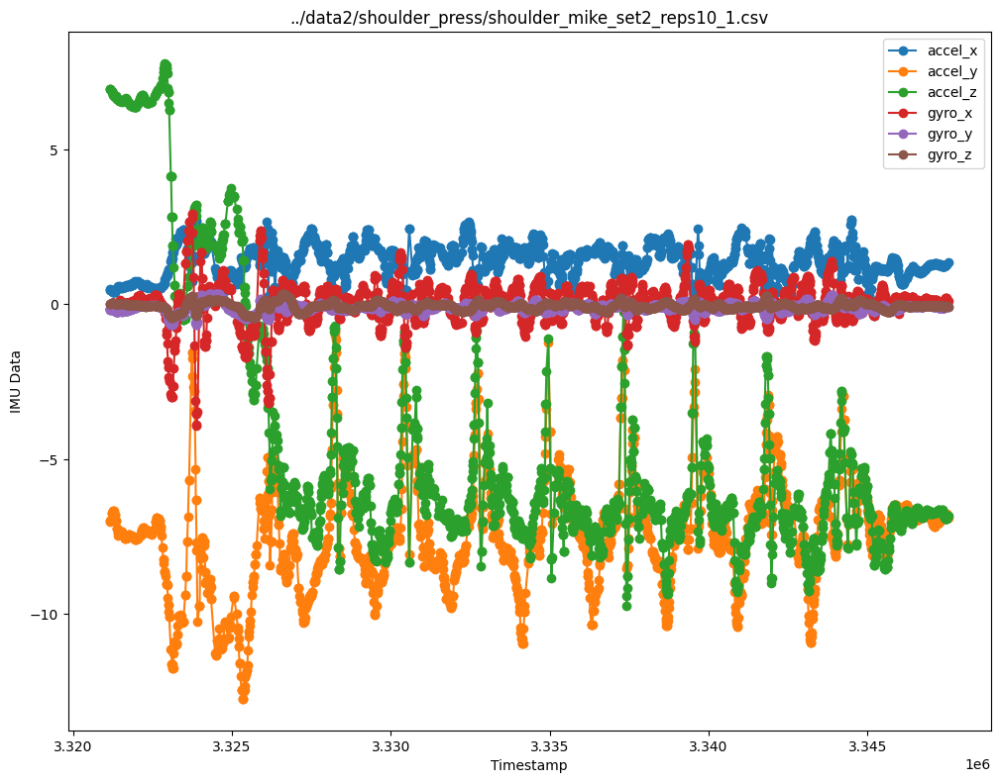

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  3.321152e+06  0.501049 -7.078420  6.945483 -0.197056 -0.178895  0.003853
1  3.321248e+06  0.389684 -6.671465  6.774668  0.051543 -0.189280  0.027128
2  3.321343e+06  0.466903 -7.024884  6.675739 -0.170744 -0.246097  0.008648
3  3.321420e+06  0.566645 -7.408130  6.595641 -0.039184 -0.240327  0.008332
4  3.321586e+06  0.549172 -7.445141  6.578646  0.048041 -0.229877 -0.002076


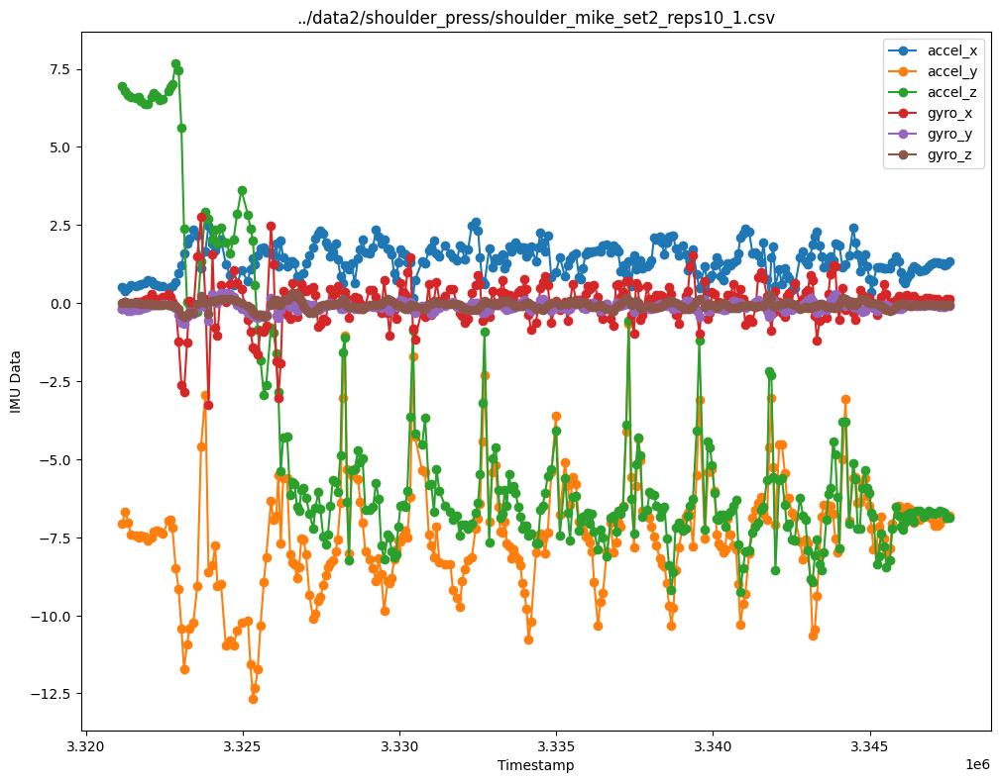

../data2/shoulder_press/shoulder_suzan_set2_reps8_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     444655    0.217   -9.665    2.145   0.043  -0.154  -0.012
1     444659    0.217   -9.665    2.145   0.043  -0.154  -0.012
2     444662    0.178   -9.598    2.152   0.065  -0.162  -0.017
3     444666    0.178   -9.598    2.152   0.065  -0.162  -0.017
4     444749    0.109   -9.610    2.127  -0.294  -0.138  -0.023


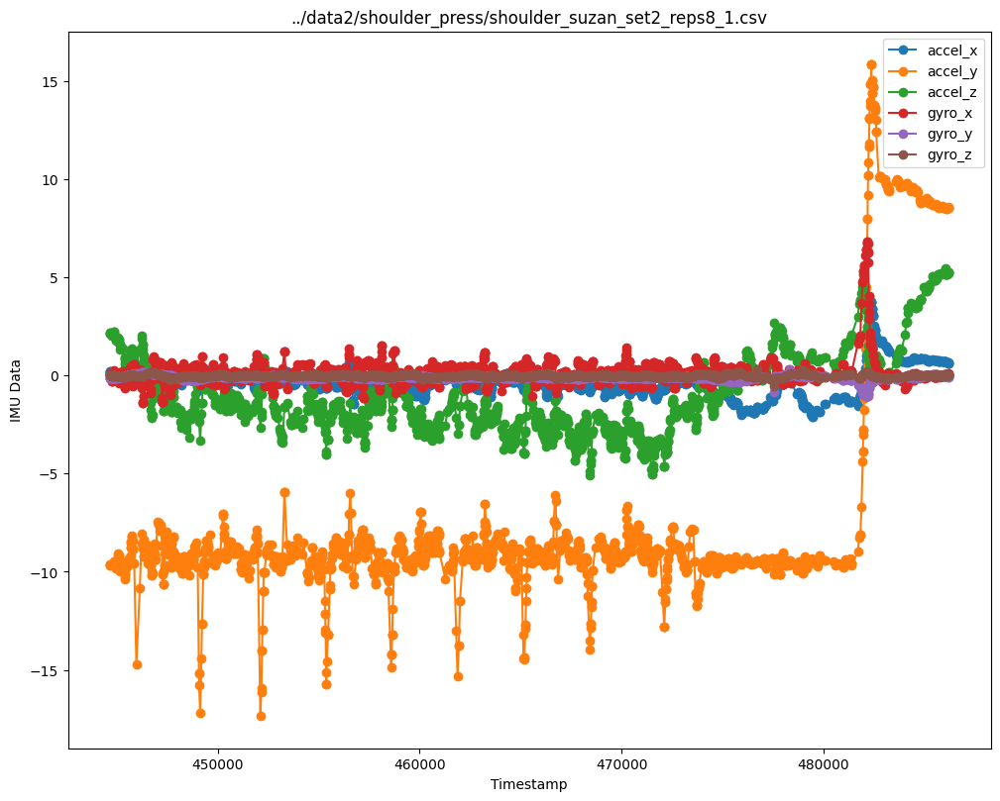

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  444637.818182  0.230140 -9.662846  2.167748  0.167818 -0.161483 -0.010028
1  444757.965175  0.092148 -9.609699  2.079733 -0.222246 -0.140542 -0.021247
2  444847.893943  0.023921 -9.662252  2.097041  0.068423 -0.143040 -0.014179
3  445056.045162  0.045840 -9.313635  1.815829 -0.185453 -0.106579 -0.036376
4  445169.062313 -0.010865 -9.659302  1.506834 -0.259564 -0.086231 -0.048010


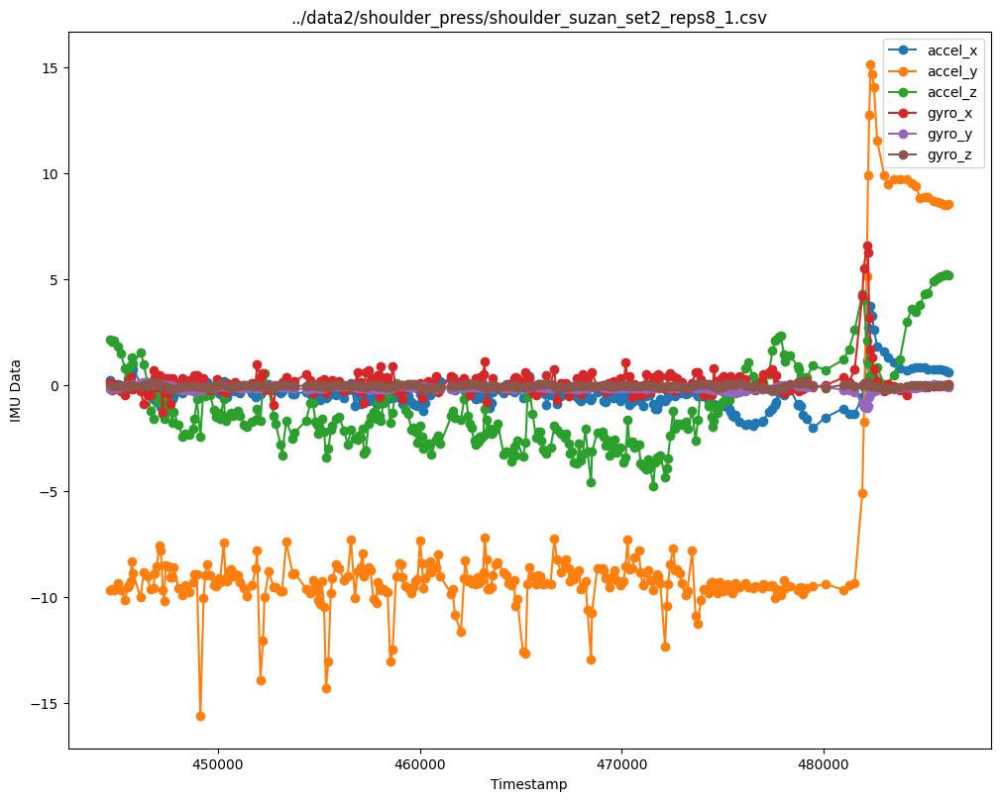

../data2/shoulder_press/shoulder_suzan_set4_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     484246   -0.489   -4.915    8.700  -0.053  -0.015  -0.093
1     484249   -0.489   -4.915    8.700  -0.053  -0.015  -0.093
2     484252   -0.489   -4.915    8.700  -0.053  -0.015  -0.093
3     484256   -0.569   -5.151    8.734  -0.105   0.004  -0.094
4     484278   -0.507   -4.981    8.577  -0.133   0.010  -0.094


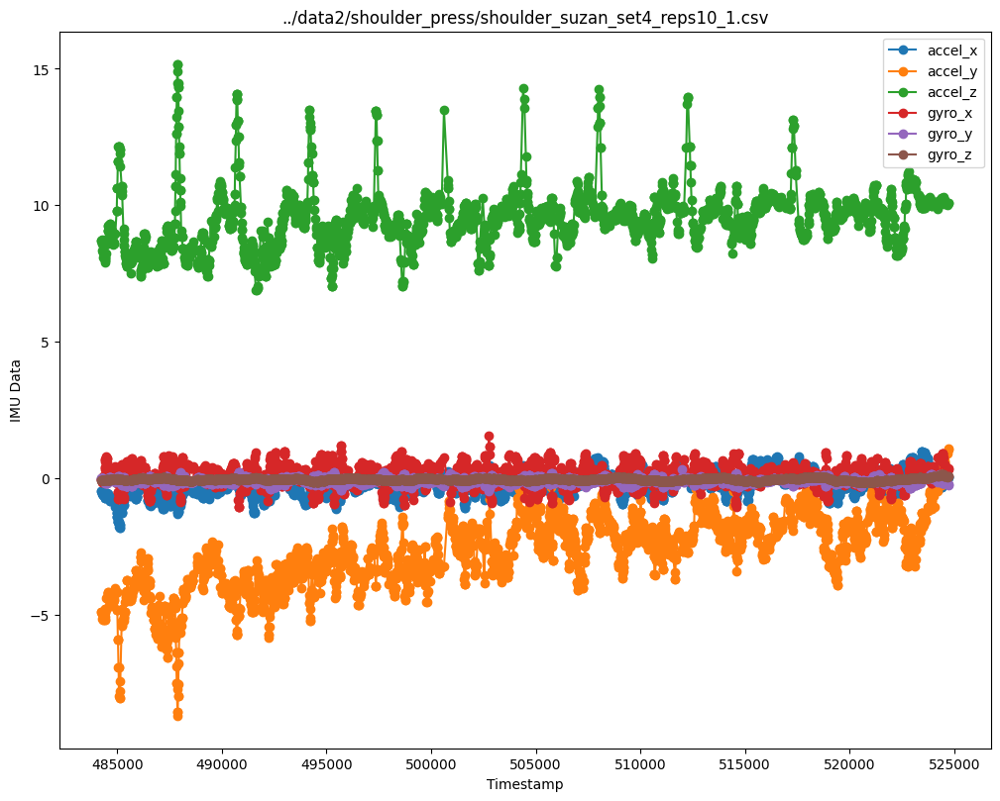

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  484251.048951 -0.495336 -4.898105  8.718734  0.005168 -0.029224 -0.091252
1  484347.960373 -0.667655 -5.132023  8.082221  0.124296 -0.043921 -0.083538
2  484489.174825 -0.576660 -4.449967  8.580023  0.679205 -0.172193 -0.057112
3  484623.536131 -0.735977 -4.395608  9.308198 -0.058869  0.013366 -0.061536
4  484732.041958 -0.751925 -4.579224  8.983347  0.147818 -0.044394 -0.049242


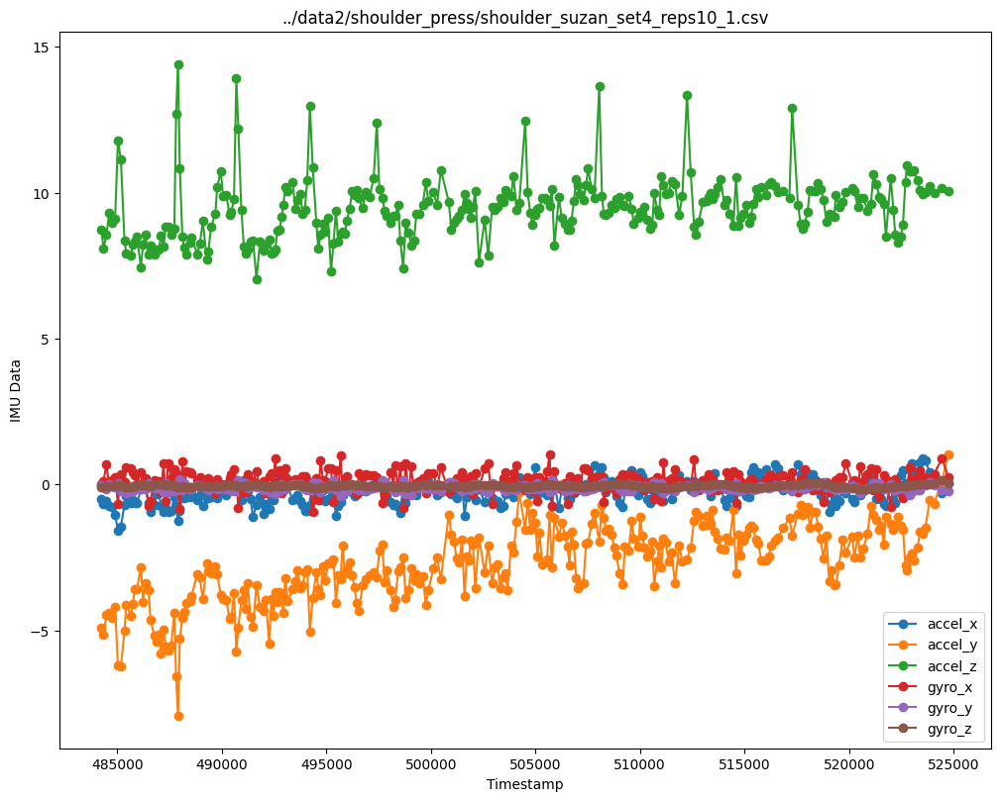

../data2/shoulder_press/shoulder_udai_set2_reps9_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     550337   -1.561   -8.978    2.978   2.165  -0.259   0.090
1     550341   -1.561   -8.978    2.978   2.165  -0.259   0.090
2     550344   -1.561   -8.978    2.978   2.165  -0.259   0.090
3     550348   -1.600   -8.635    2.882   2.147  -0.264   0.084
4     550400   -1.656   -8.283    4.124   2.511  -0.310   0.086


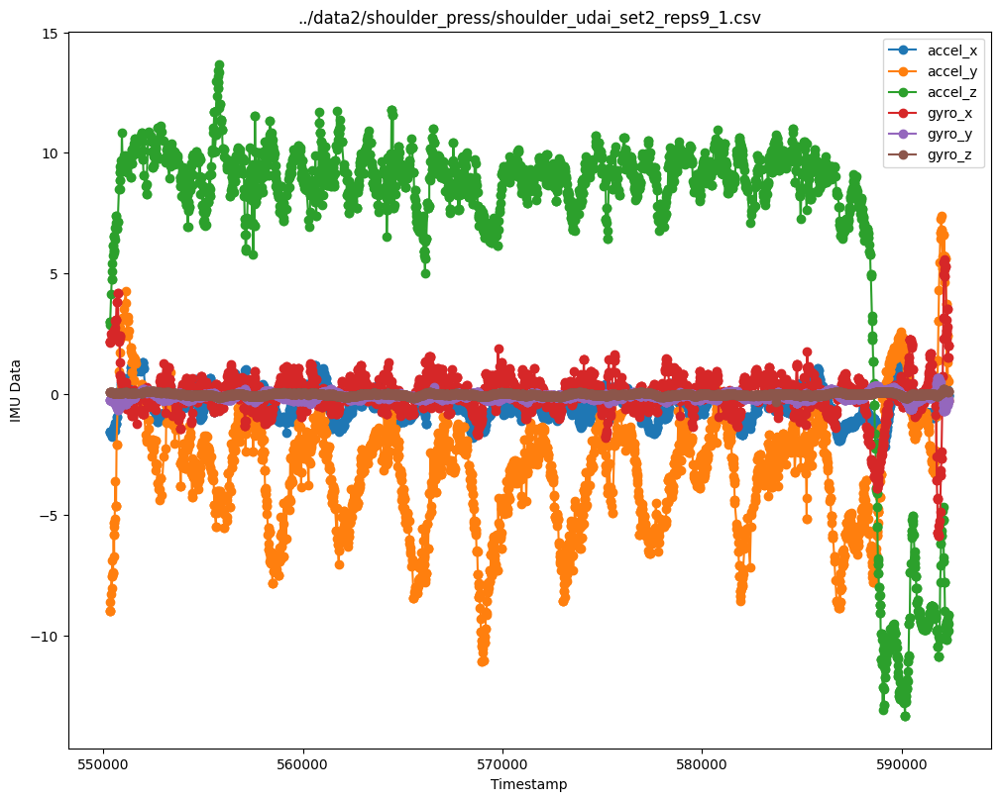

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  550324.881119 -1.497294 -9.255364  2.650531  2.082965 -0.248867  0.089923
1  550485.810300 -1.527751 -7.027327  5.790506  2.393473 -0.304549  0.056777
2  550610.545189 -1.313895 -4.846236  6.989570  2.914660 -0.416868  0.027913
3  550820.059101  0.014513  2.276100  8.768948  2.229912 -0.497462  0.046279
4  550972.197551  0.591264  3.237019  9.825786  0.281642 -0.379525  0.049858


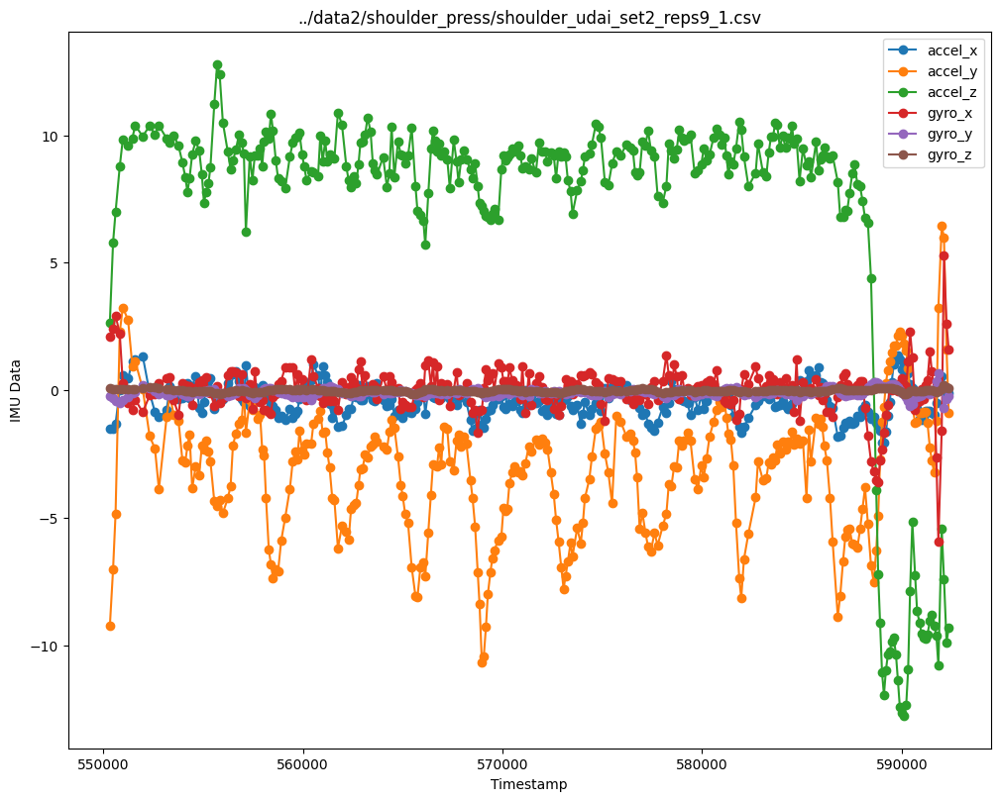

../data2/row/row_adam_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    1653896   -0.410    2.115    9.606  -0.001  -0.108  -0.078
1    1653918   -0.383    1.920    9.543  -0.016  -0.125  -0.079
2    1653922   -0.383    1.920    9.543  -0.004  -0.125  -0.079
3    1653926   -0.383    1.920    9.543  -0.004  -0.125  -0.079
4    1653950   -0.408    1.866    9.632   0.088  -0.128  -0.076


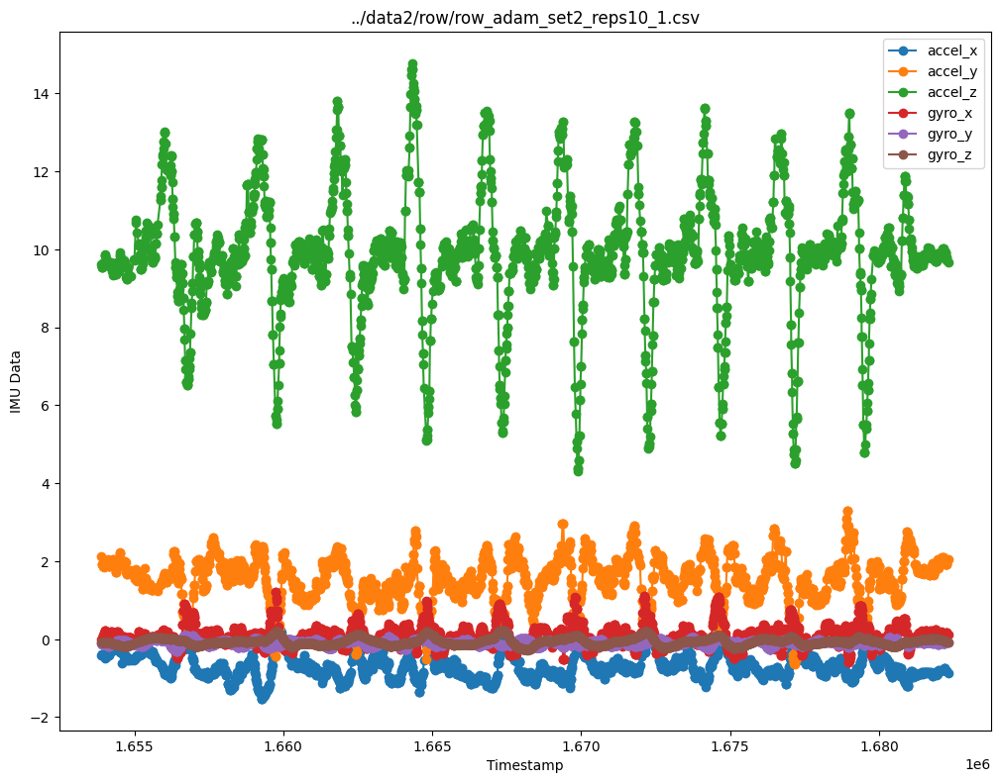

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  1.653900e+06 -0.397776  2.060972  9.573839 -0.027979 -0.115357 -0.079182
1  1.653995e+06 -0.457511  1.939072  9.778995  0.201122 -0.135281 -0.074553
2  1.654136e+06 -0.407604  1.939336  9.611739  0.053963 -0.183585 -0.092516
3  1.654220e+06 -0.299162  1.925123  9.572012  0.180475 -0.146631 -0.099729
4  1.654323e+06 -0.228044  1.947264  9.492678  0.024500 -0.118126 -0.129944


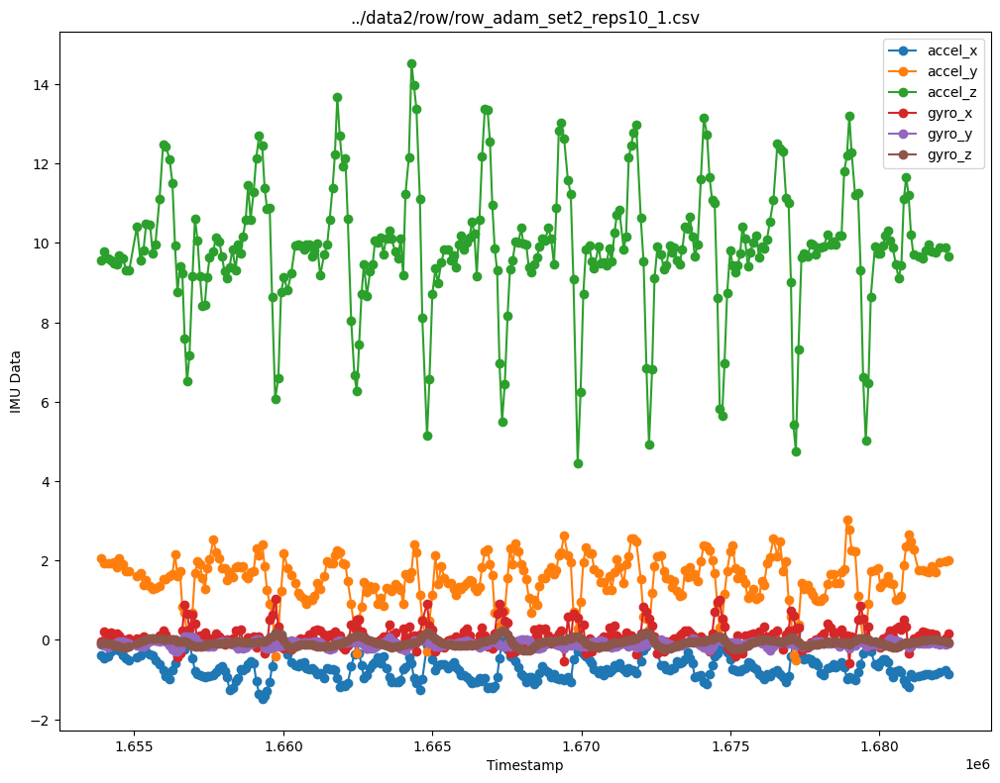

../data2/row/row_andrew_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     900185   -0.482    3.046   10.114   0.292  -0.148   0.023
1     900189   -0.482    3.046   10.114   0.292  -0.148   0.023
2     900192   -0.517    2.973   10.040   0.292  -0.148   0.023
3     900196   -0.517    2.973   10.040   0.301  -0.140   0.026
4     900276   -0.311    2.808    9.790   0.172  -0.140   0.020


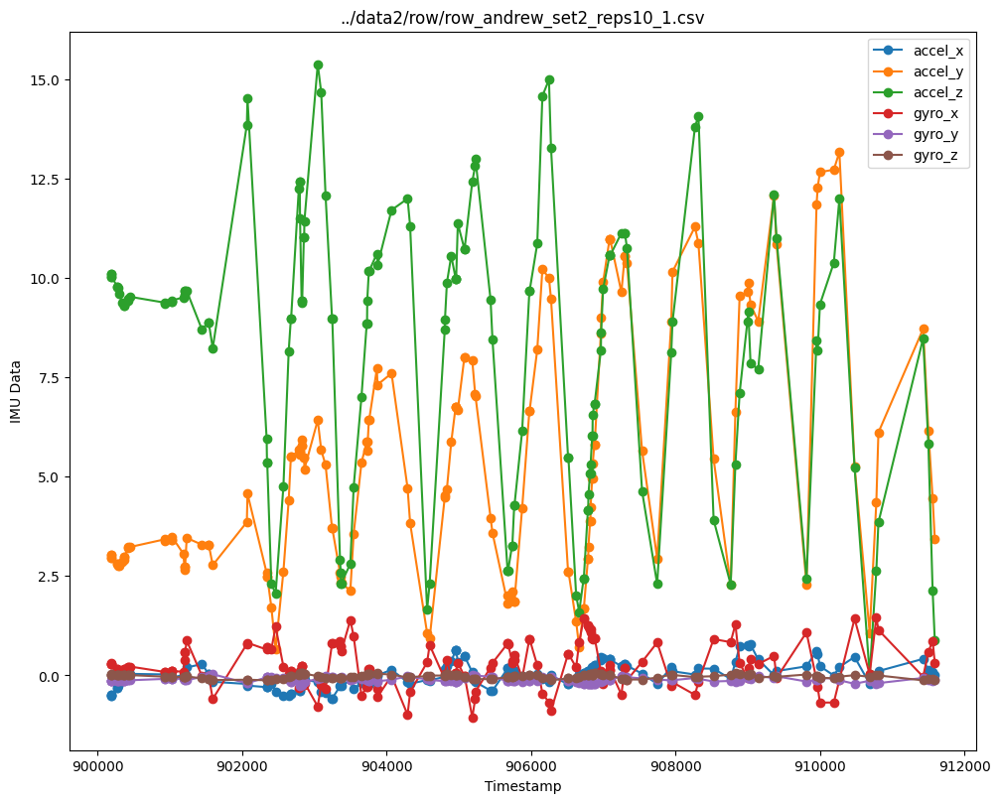

       timestamp   accel_x   accel_y    accel_z    gyro_x    gyro_y    gyro_z
0  900171.741259 -0.522881  3.111699  10.154000  0.334462 -0.149189  0.023308
1  900181.163674 -0.509170  3.061267  10.122616  0.312647 -0.148036  0.023422
2  900190.631267 -0.494984  3.011967  10.090783  0.291118 -0.146888  0.023512
3  900200.431748 -0.477294  2.971012  10.055644  0.271692 -0.145771  0.023420
4  900210.322586 -0.458653  2.932321  10.019608  0.252837 -0.144662  0.023278


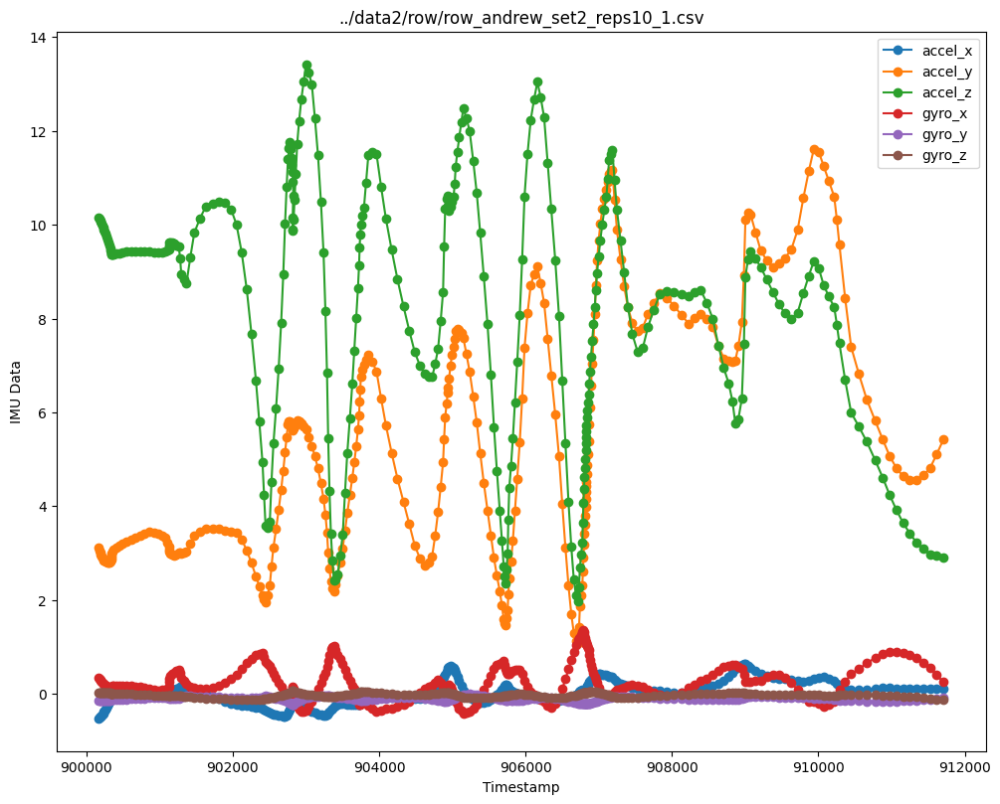

../data2/row/row_anuj_set2_rep10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     520451   -0.475    7.576    6.152   0.144  -0.103  -0.104
1     520455   -0.470    7.612    6.185   0.142  -0.089  -0.100
2     520458   -0.470    7.612    6.185   0.142  -0.089  -0.100
3     520461   -0.470    7.612    6.185   0.142  -0.089  -0.100
4     520719   -0.522    7.606    6.400   0.045  -0.106  -0.078


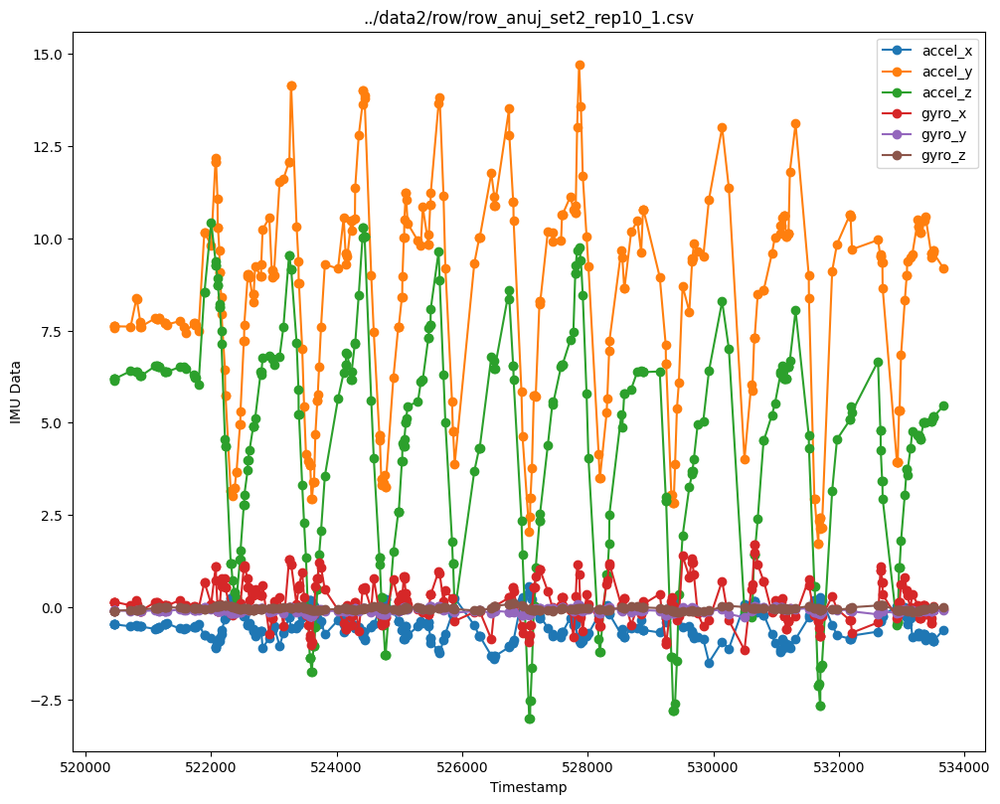

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  520395.664336 -0.473986  7.459965  6.150769  0.187951 -0.092203 -0.103692
1  520466.148763 -0.473594  7.621099  6.192198  0.149840 -0.094273 -0.100177
2  520536.959656 -0.476001  7.747581  6.229873  0.115512 -0.096076 -0.095889
3  520608.097013 -0.481210  7.839409  6.263793  0.084966 -0.097611 -0.090826
4  520679.560836 -0.489218  7.896584  6.293959  0.058202 -0.098879 -0.084989


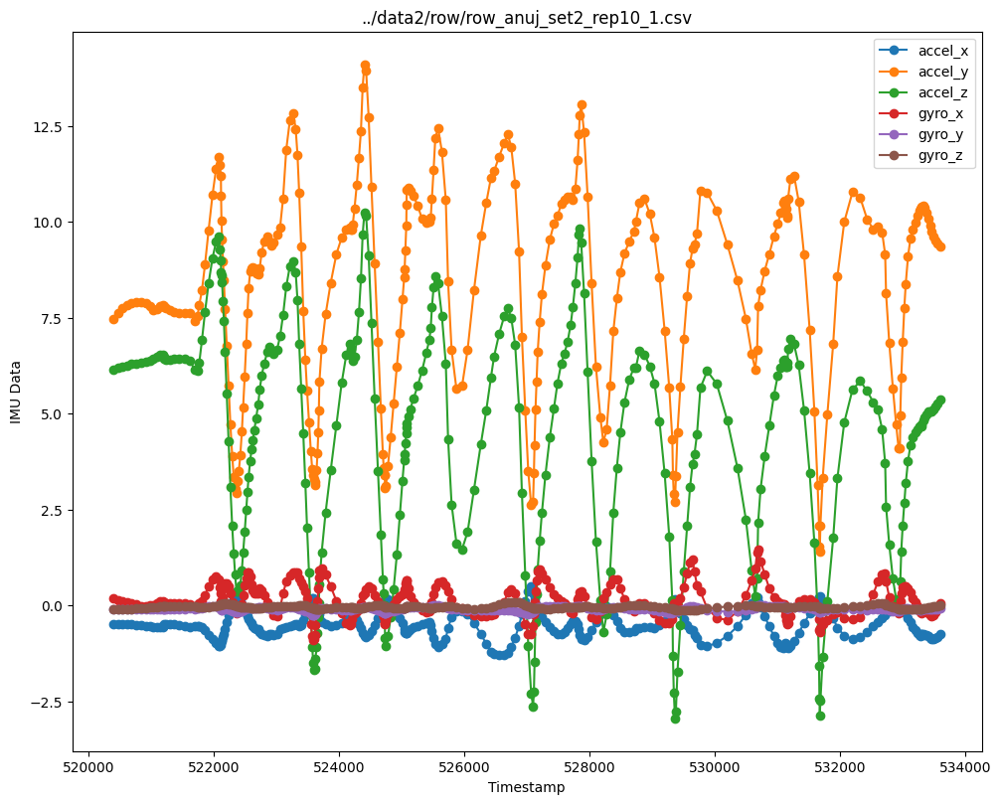

../data2/row/row_jake_set2_reps12_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    1119032   -0.124   -3.886    9.075  -0.021  -0.086  -0.028
1    1119035   -0.120   -3.863    9.179   0.024  -0.083  -0.023
2    1119039   -0.120   -3.863    9.179   0.024  -0.083  -0.023
3    1119042   -0.095   -3.790    9.133   0.024  -0.090  -0.026
4    1119123   -0.061   -3.869    9.208  -0.020  -0.094  -0.031


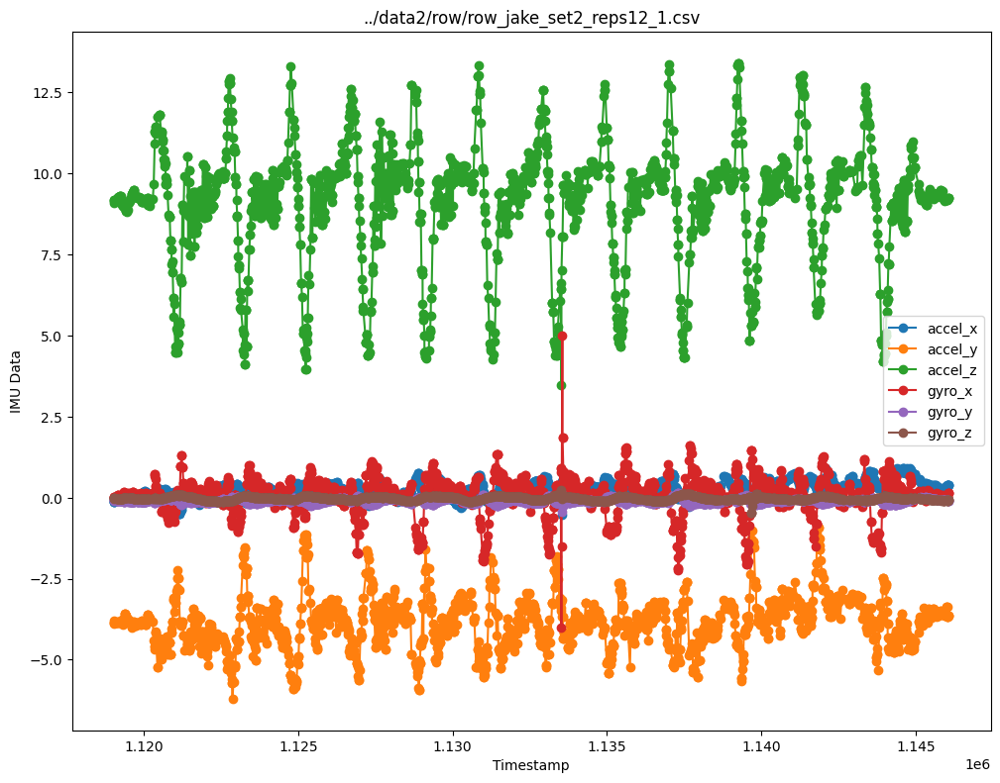

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  1.119019e+06 -0.136797 -3.874385  9.115105 -0.005769 -0.082392 -0.025084
1  1.119142e+06 -0.037807 -3.846121  9.220241  0.033362 -0.099695 -0.028903
2  1.119242e+06  0.000055 -3.835487  9.258447  0.001220 -0.105553 -0.030524
3  1.119312e+06  0.049068 -3.821483  9.031358 -0.010001 -0.106908 -0.027519
4  1.119377e+06  0.041519 -3.683696  8.978698  0.150694 -0.120838 -0.022944


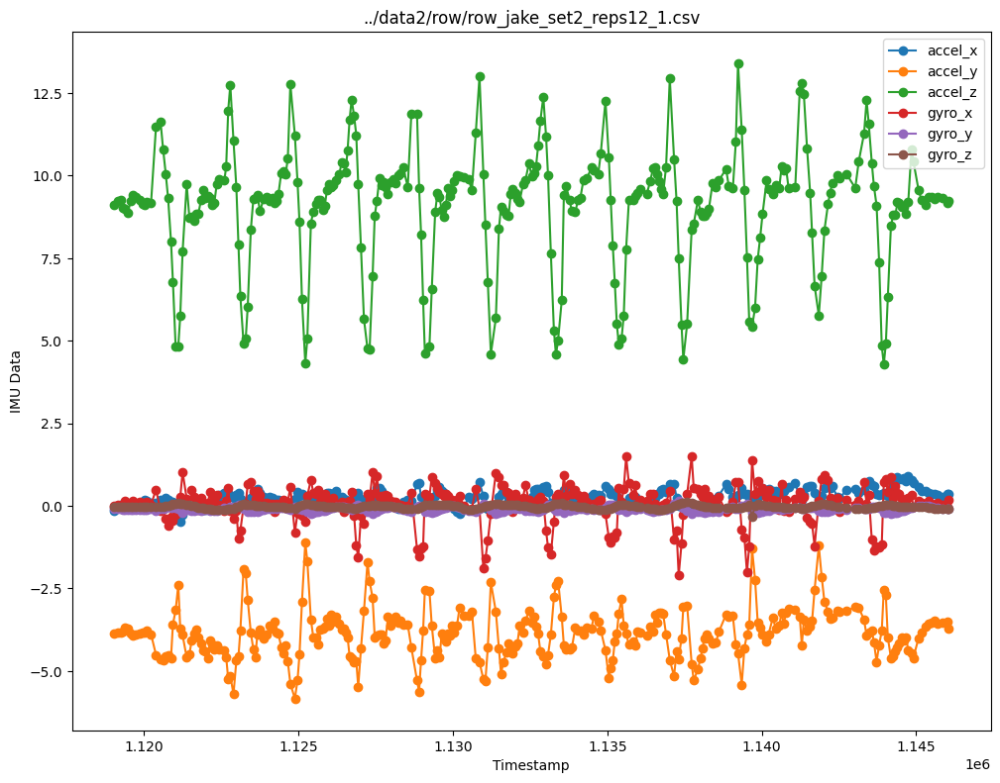

../data2/row/row_kamyar_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    4366685   -0.806    2.431   10.497   0.264  -0.104  -0.017
1    4366688   -0.806    2.431   10.497   0.264  -0.104  -0.017
2    4366692   -0.822    2.603   10.591   0.237  -0.103  -0.017
3    4366696   -0.822    2.603   10.591   0.237  -0.103  -0.017
4    4366718   -0.805    2.648   10.562   0.100  -0.119  -0.024


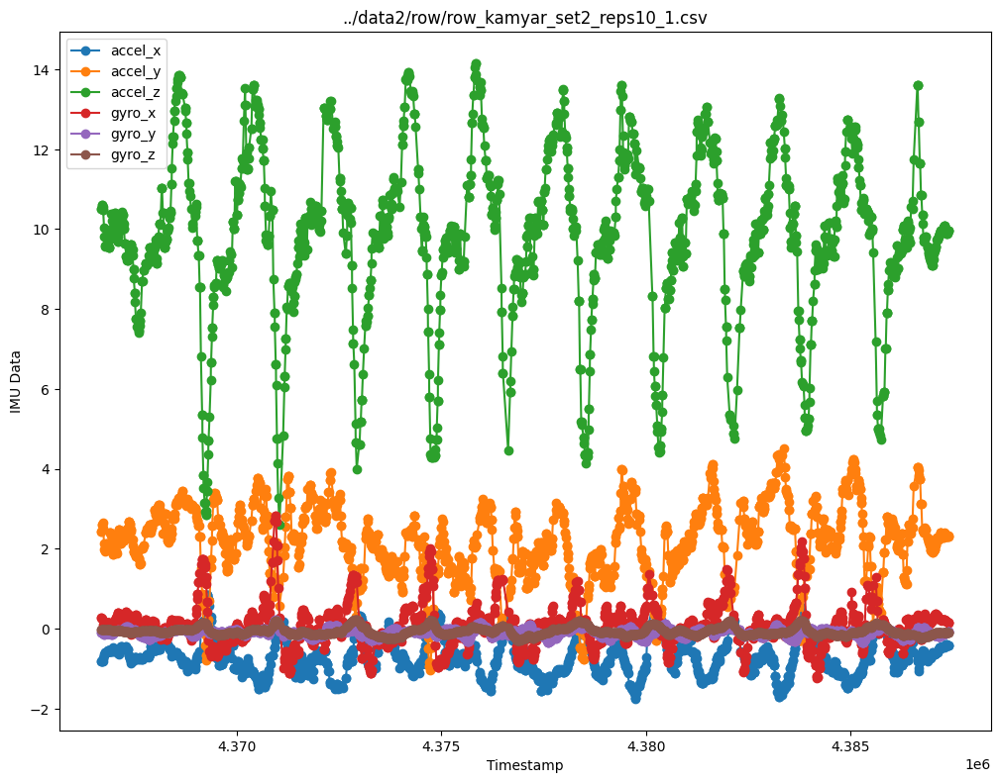

      timestamp   accel_x   accel_y    accel_z    gyro_x    gyro_y    gyro_z
0  4.366683e+06 -0.818706  2.456930  10.489615  0.335769 -0.094762 -0.013126
1  4.366727e+06 -0.733628  2.397356  10.317071  0.026597 -0.131170 -0.027379
2  4.366803e+06 -0.587435  2.028301   9.685854  0.125140 -0.124432 -0.023282
3  4.366862e+06 -0.538595  2.037685   9.599883  0.149199 -0.116787 -0.023236
4  4.366918e+06 -0.572106  2.322162  10.181399 -0.008565 -0.133777 -0.036757


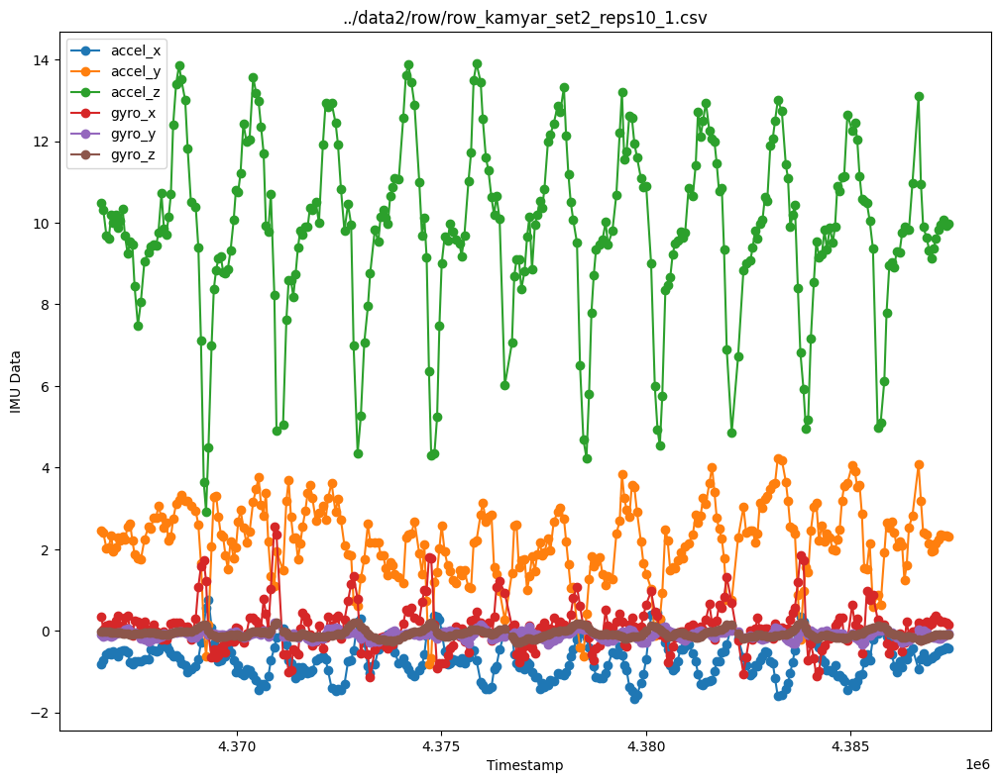

../data2/row/row_mike_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    3182767   -0.839    3.869    9.868   0.090  -0.119  -0.039
1    3182771   -0.843    3.857    9.927   0.104  -0.116  -0.039
2    3182774   -0.843    3.857    9.927   0.104  -0.116  -0.039
3    3182778   -0.843    3.857   10.002   0.104  -0.116  -0.039
4    3182799   -0.718    3.789    9.845   0.134  -0.106  -0.040


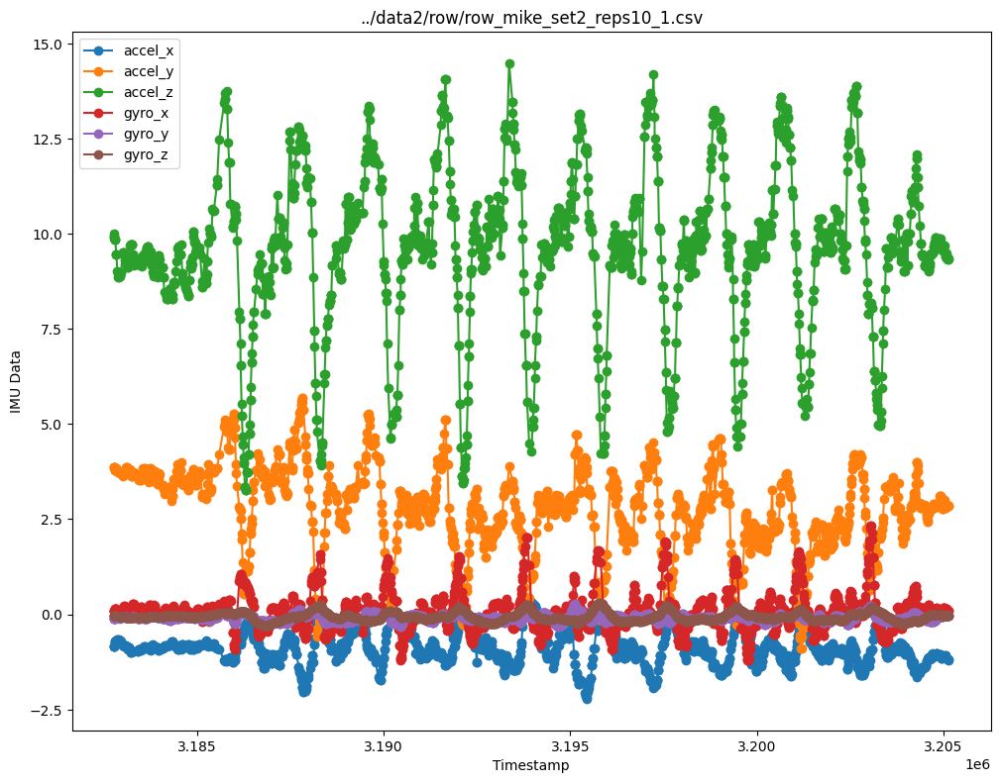

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  3.182765e+06 -0.870503  3.868524  9.871434  0.082266 -0.120385 -0.039427
1  3.182807e+06 -0.718358  3.817273  9.778318  0.139974 -0.104635 -0.040138
2  3.182880e+06 -0.667720  3.748816  8.955135  0.068979 -0.097662 -0.052766
3  3.182950e+06 -0.726966  3.700071  9.050187  0.010384 -0.095221 -0.068642
4  3.183041e+06 -0.824104  3.713524  9.512575  0.197845 -0.058487 -0.071096


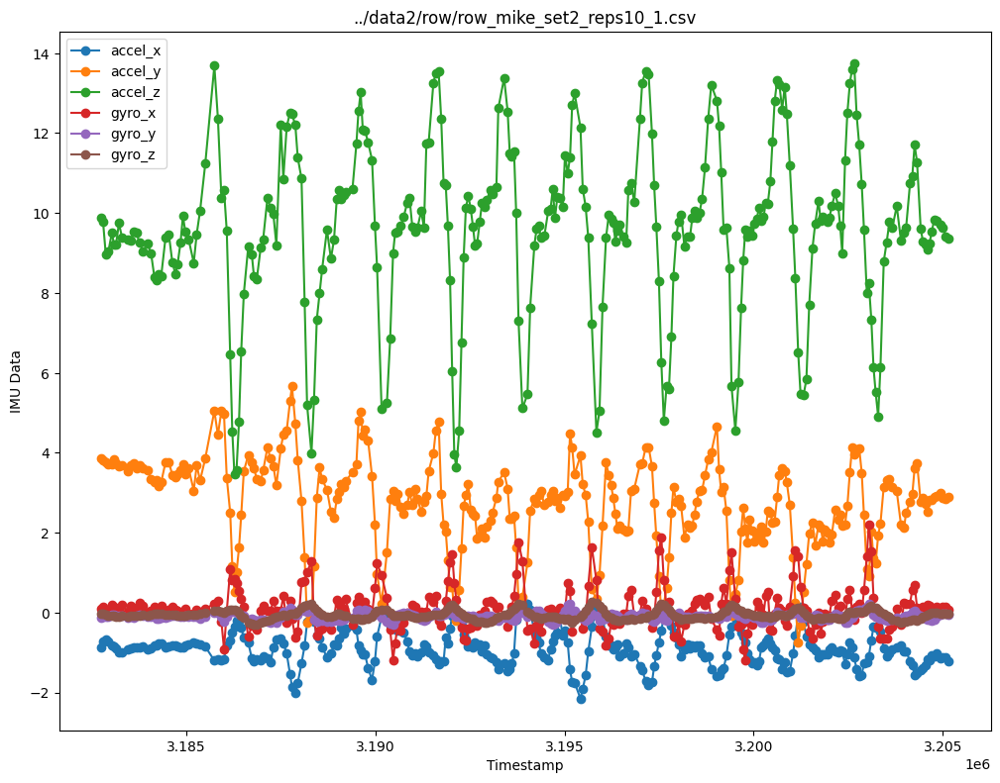

../data2/row/row_suzan_set2_reps12_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     995043    0.071    0.962   10.053   0.084  -0.136  -0.043
1     995047    0.071    0.974    9.986   0.084  -0.136  -0.043
2     995051    0.085    0.974    9.986   0.123  -0.137  -0.039
3     995054    0.085    0.974    9.986   0.123  -0.137  -0.039
4     995107    0.059    1.115    9.917   0.130  -0.139  -0.045


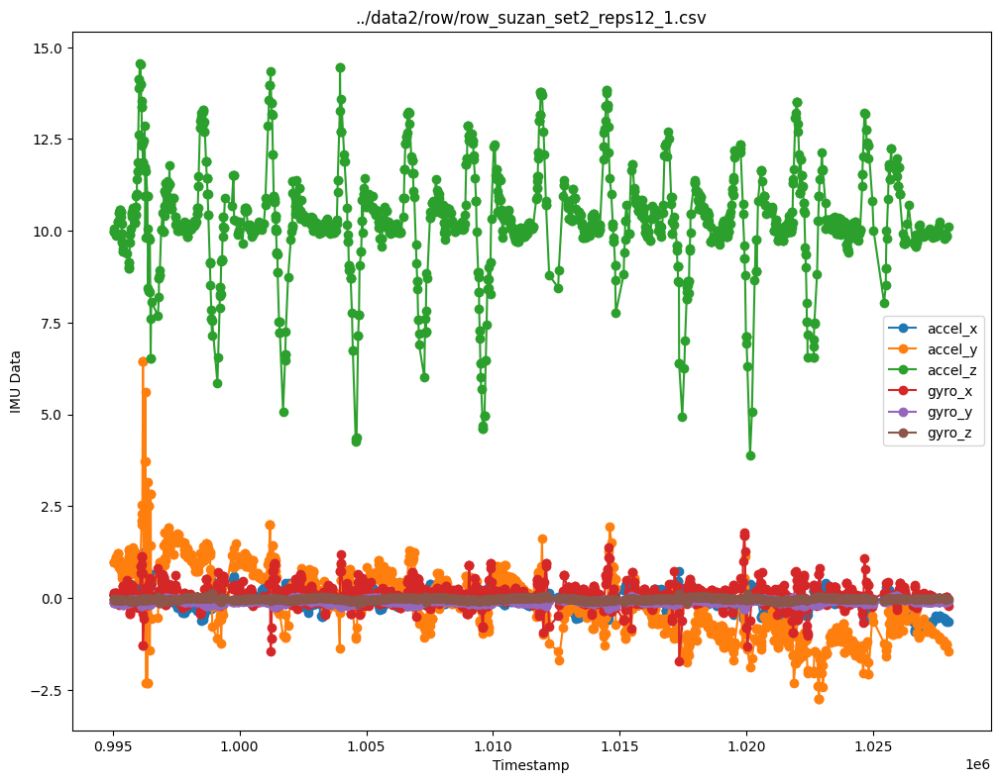

       timestamp   accel_x   accel_y    accel_z    gyro_x    gyro_y    gyro_z
0  995035.167832  0.076783  0.948699  10.072056  0.072685 -0.134839 -0.041434
1  995104.705760  0.061599  1.077301   9.930302  0.124341 -0.137929 -0.044138
2  995209.082926 -0.005550  1.074163  10.268881 -0.065577 -0.125279 -0.051631
3  995278.715828 -0.017046  0.880813  10.562871 -0.019507 -0.137759 -0.052350
4  995324.994005  0.076174  0.857811  10.365380 -0.131645 -0.134479 -0.055857


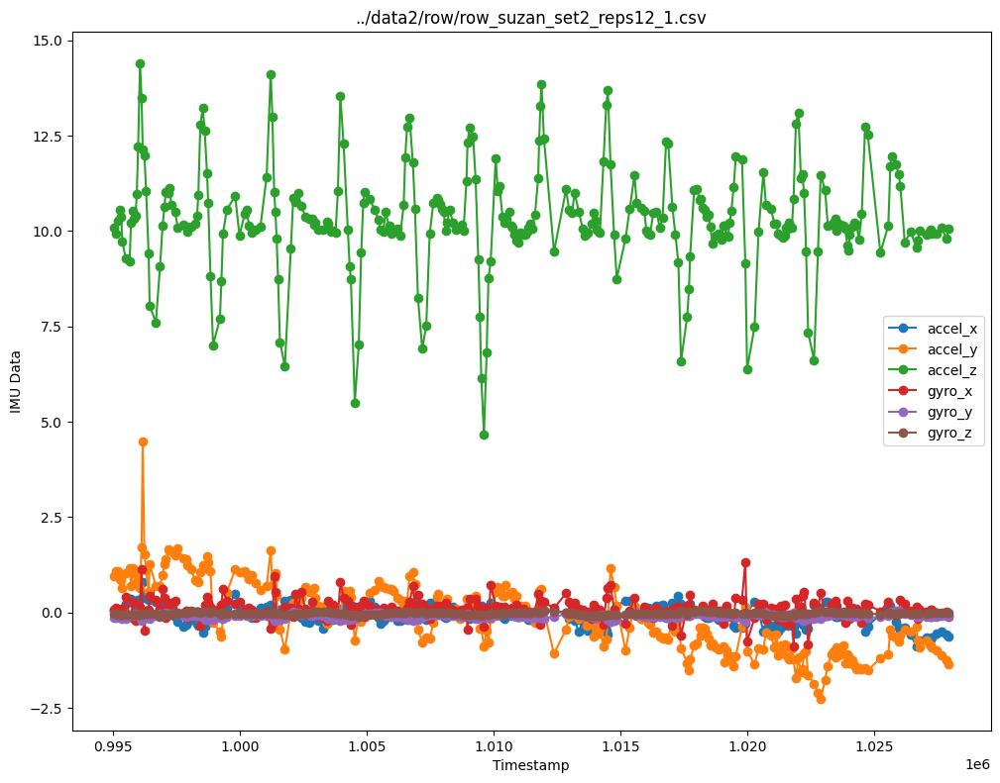

../data2/row/row_udai_set2_reps12_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    1057621    0.938    4.700    8.499  -0.222  -0.067  -0.017
1    1057625    0.938    4.819    8.485  -0.252  -0.066  -0.022
2    1057628    0.938    4.819    8.485  -0.252  -0.066  -0.022
3    1057631    1.038    5.373    8.264  -0.252  -0.061  -0.026
4    1057653    1.095    4.958    8.392  -0.265  -0.057  -0.027


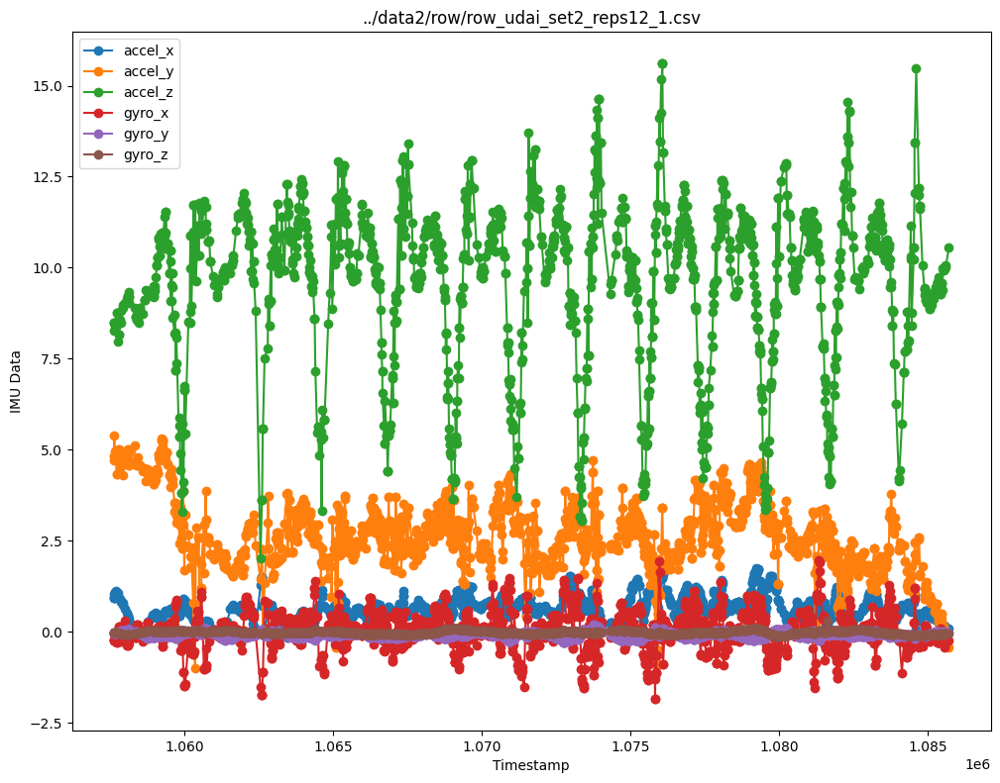

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  1.057617e+06  0.891049  4.908538  8.414105 -0.183161 -0.072762 -0.017769
1  1.057702e+06  1.079724  4.759461  8.415878 -0.229704 -0.036887 -0.034838
2  1.057838e+06  0.875476  4.795502  8.452908 -0.049647  0.009060 -0.056847
3  1.058039e+06  0.546991  4.806592  9.124973 -0.204575  0.049734 -0.077691
4  1.058210e+06  0.200435  4.718572  9.020548 -0.155423  0.022622 -0.070774


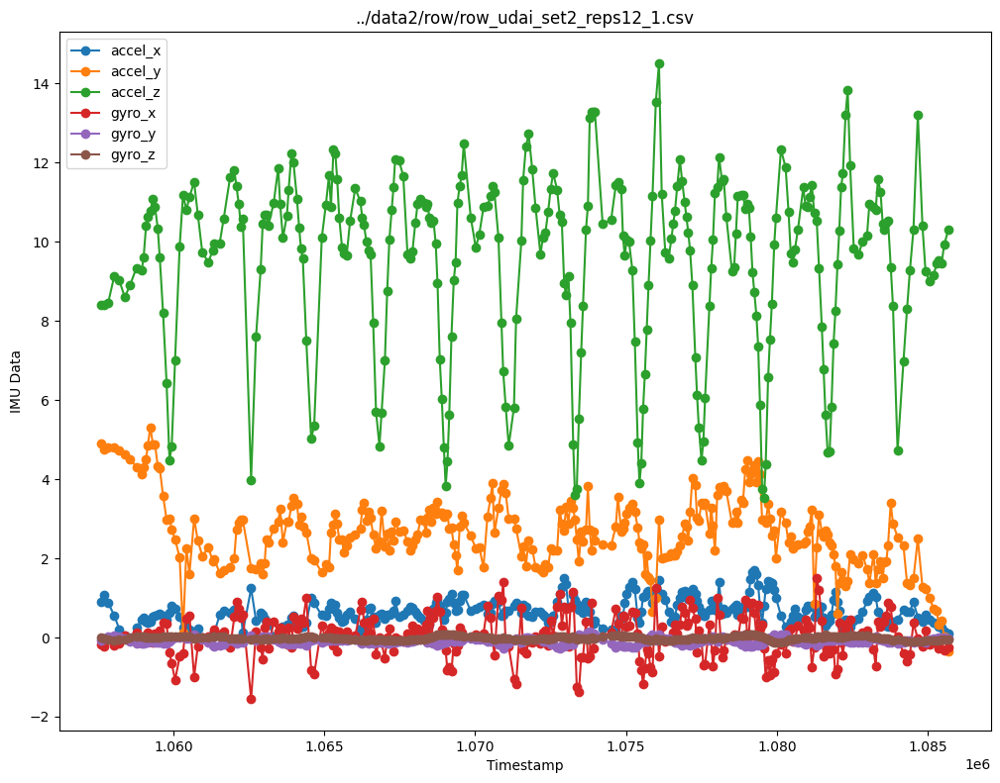

../data2/dead/dead_adam_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    1147052   -1.802    5.422    8.894   0.164  -0.087  -0.044
1    1147056   -1.802    5.422    8.894   0.151  -0.098  -0.044
2    1147060   -1.802    5.422    8.894   0.151  -0.098  -0.044
3    1147063   -1.764    5.308    8.871   0.162  -0.114  -0.035
4    1147145   -1.458    5.545    8.986   0.578  -0.149   0.053


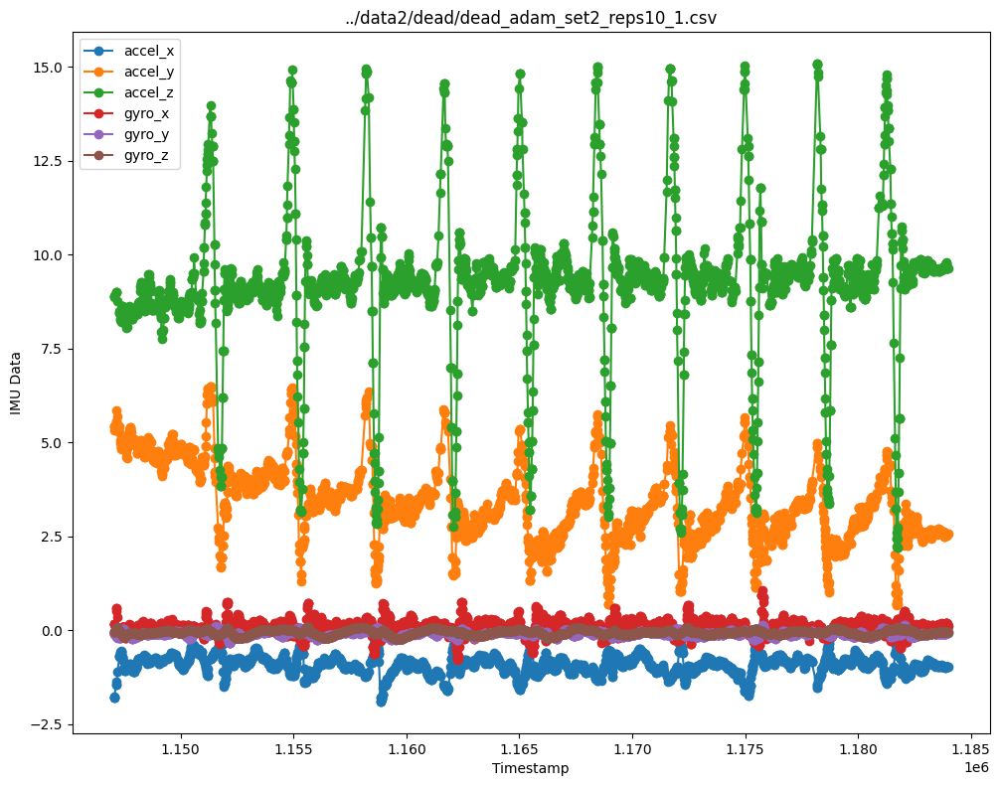

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  1.147036e+06 -1.867329  5.302517  8.845469  0.026937 -0.075448 -0.076182
1  1.147271e+06 -0.817410  5.433643  8.546374  0.006657 -0.206061  0.016870
2  1.147410e+06 -0.651302  5.024415  8.594989  0.063426 -0.005648 -0.131063
3  1.147518e+06 -1.081539  5.098759  8.412223 -0.028606 -0.004214 -0.165652
4  1.147640e+06 -0.927655  4.774904  8.252917  0.007654 -0.099138 -0.115569


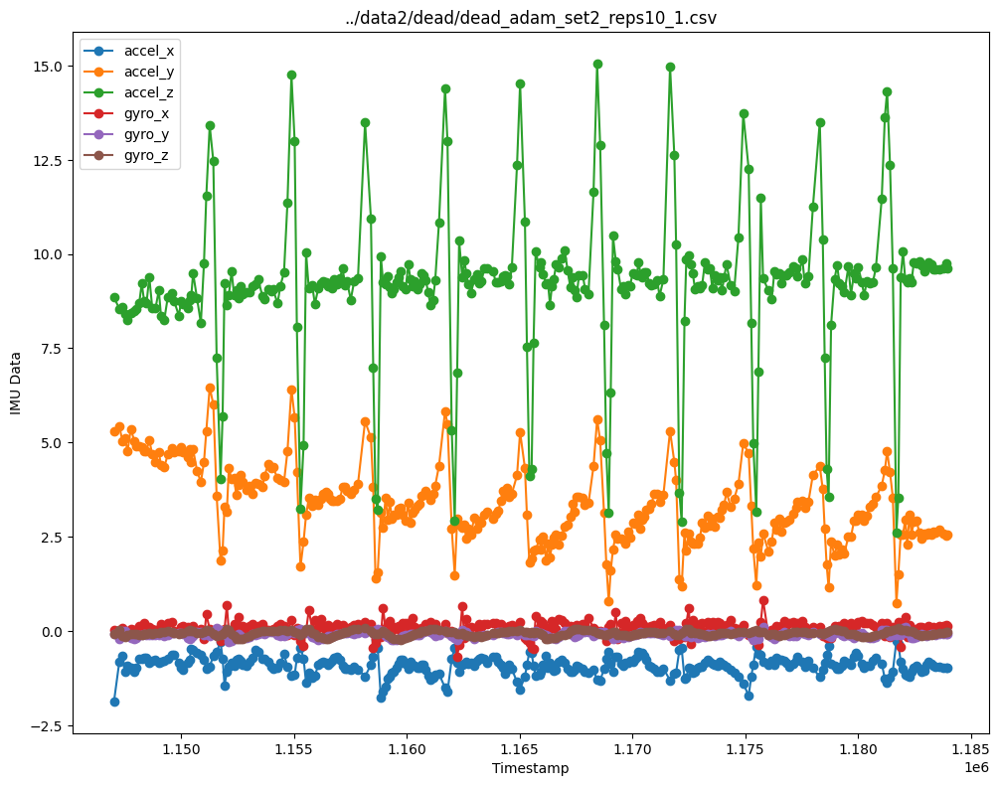

../data2/dead/dead_andrew_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    2478770    3.528   -1.362   -8.205   0.298  -0.451   0.016
1    2478774    3.528   -1.362   -8.205   0.298  -0.451   0.016
2    2478778    3.526   -1.492   -8.116   0.298  -0.451   0.016
3    2478781    3.526   -1.492   -8.116   0.345  -0.456   0.017
4    2478803    3.460   -1.957   -7.796   0.483  -0.472   0.022


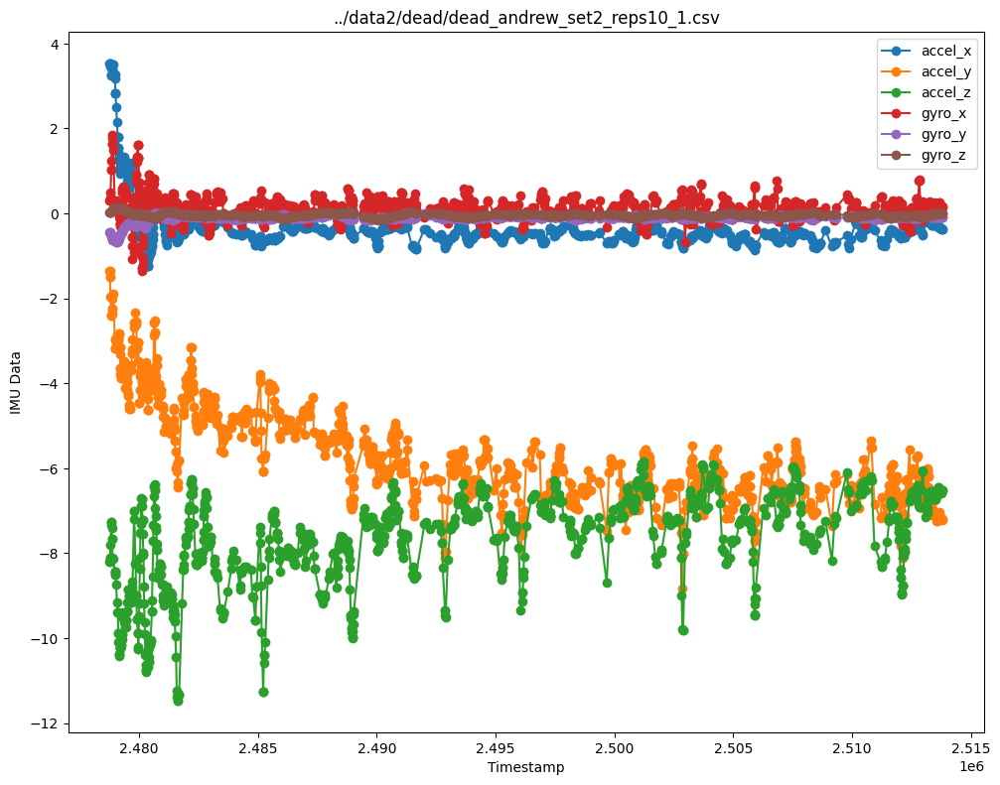

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  2.478761e+06  3.604105 -1.130993 -8.437902  0.176734 -0.439993  0.012923
1  2.478808e+06  3.378306 -2.018907 -7.642132  0.667565 -0.487659  0.027428
2  2.478853e+06  3.318333 -2.301617 -7.402194  1.649991 -0.578682  0.060565
3  2.478935e+06  3.360417 -2.418753 -8.216792  1.083192 -0.628378  0.104175
4  2.479023e+06  2.803634 -3.147526 -8.547570  0.058317 -0.650969  0.124371


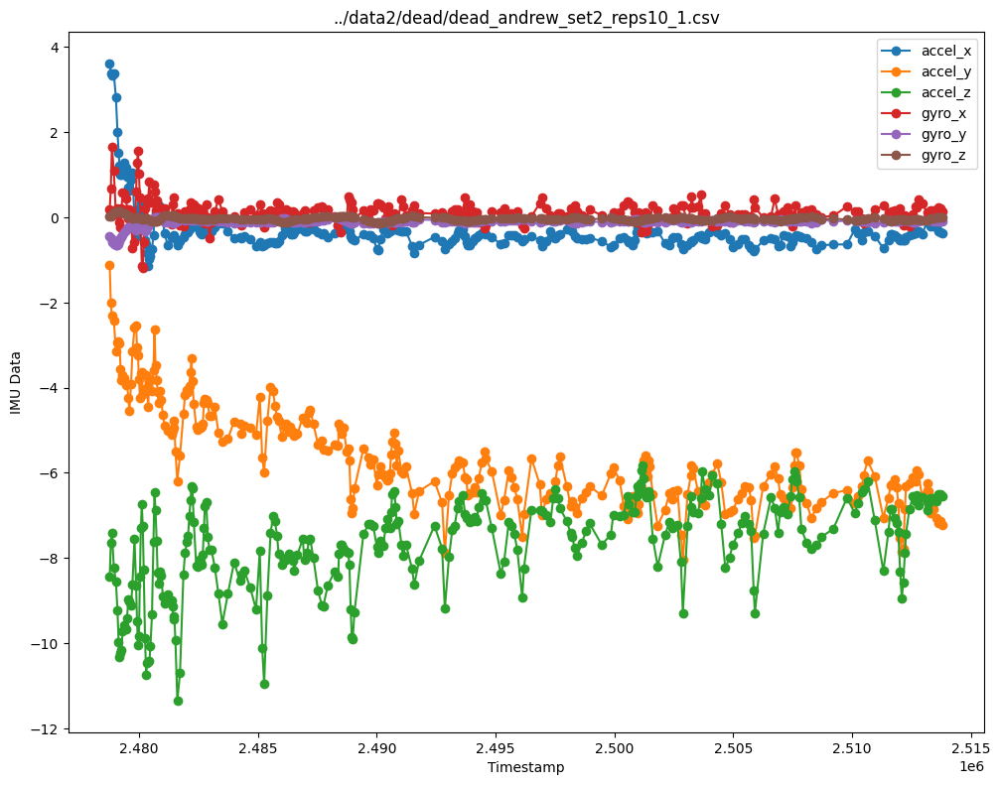

../data2/dead/dead_anuj_set2_rep10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    1199782   -0.331    8.078    5.058  -0.370  -0.109  -0.038
1    1199785   -0.331    8.078    5.058  -0.370  -0.109  -0.038
2    1199789   -0.331    8.078    5.058  -0.370  -0.109  -0.038
3    1199895   -0.738    7.768    5.163  -0.380  -0.110  -0.026
4    1199934   -0.921    7.461    5.328  -0.294  -0.106  -0.015


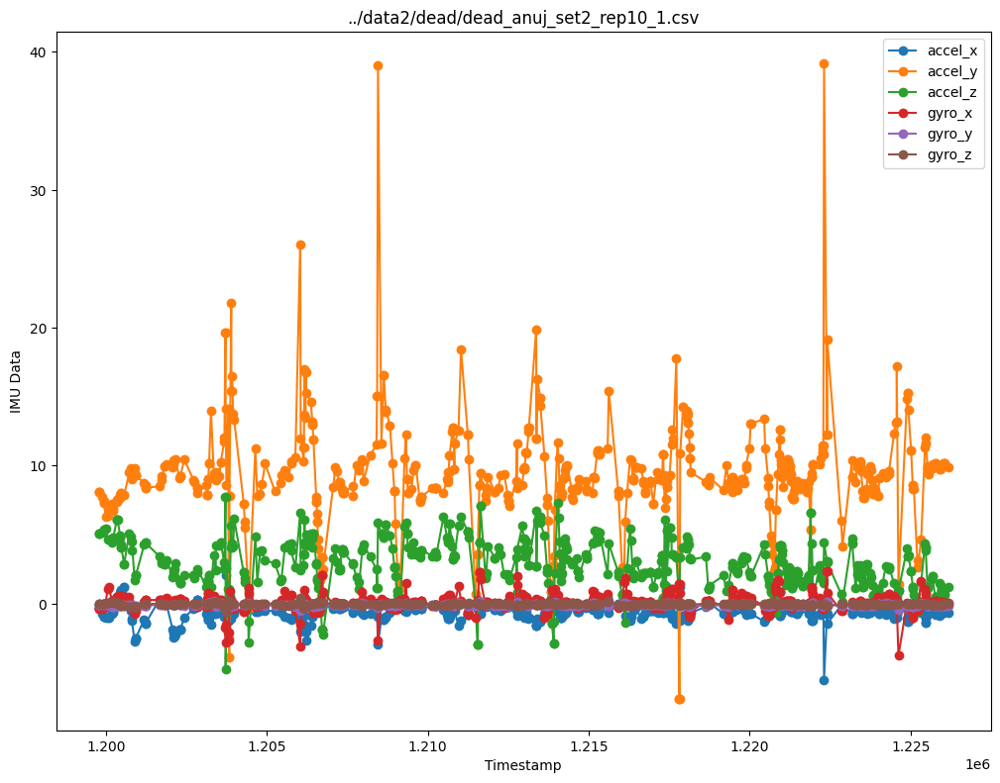

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  1.199776e+06 -0.171720  8.396930  4.901322 -0.442559 -0.122182 -0.037657
1  1.199827e+06 -0.573250  7.797603  5.226540 -0.377822 -0.103954 -0.036092
2  1.199891e+06 -0.843555  7.341395  5.342233 -0.213354 -0.095873 -0.019510
3  1.199970e+06 -1.022579  6.939191  5.232119  0.150038 -0.090668  0.015960
4  1.200056e+06 -0.986115  6.802927  4.949982  0.480643 -0.107750  0.063525


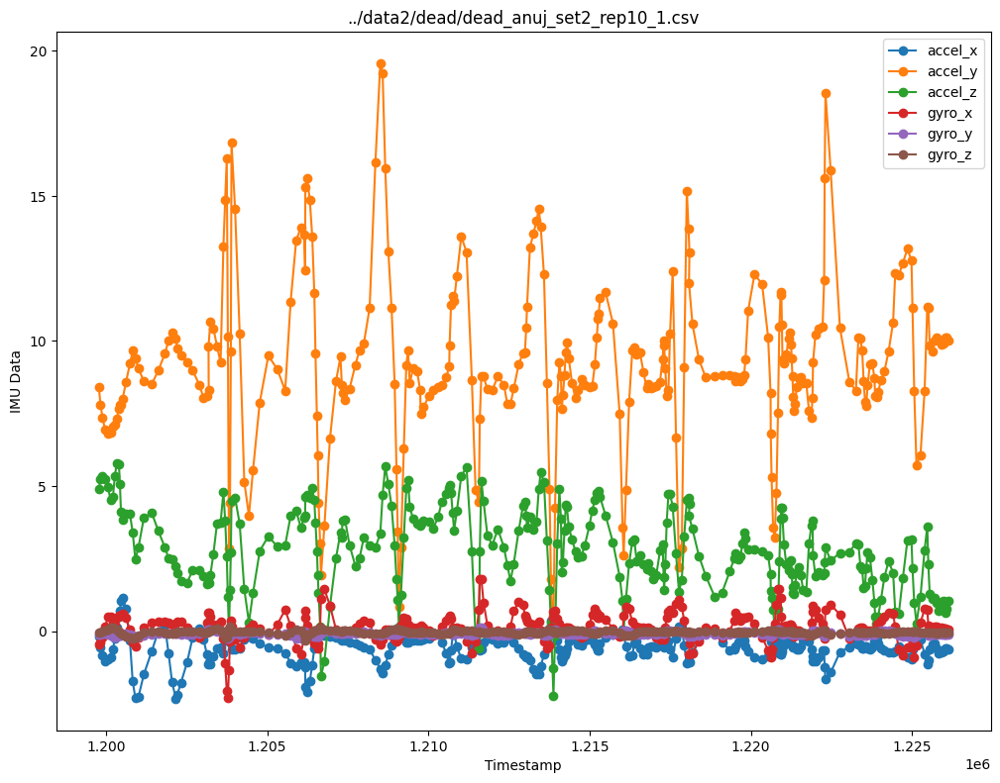

../data2/dead/dead_kamyar_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    4223830   -0.603    2.286     8.30   0.204  -0.105  -0.116
1    4223833   -0.553    2.227     8.30   0.184  -0.101  -0.119
2    4223837   -0.553    2.227     8.30   0.184  -0.101  -0.119
3    4223860   -0.516    2.524     8.54   0.160  -0.095  -0.126
4    4223864   -0.516    2.524     8.54   0.134  -0.095  -0.126


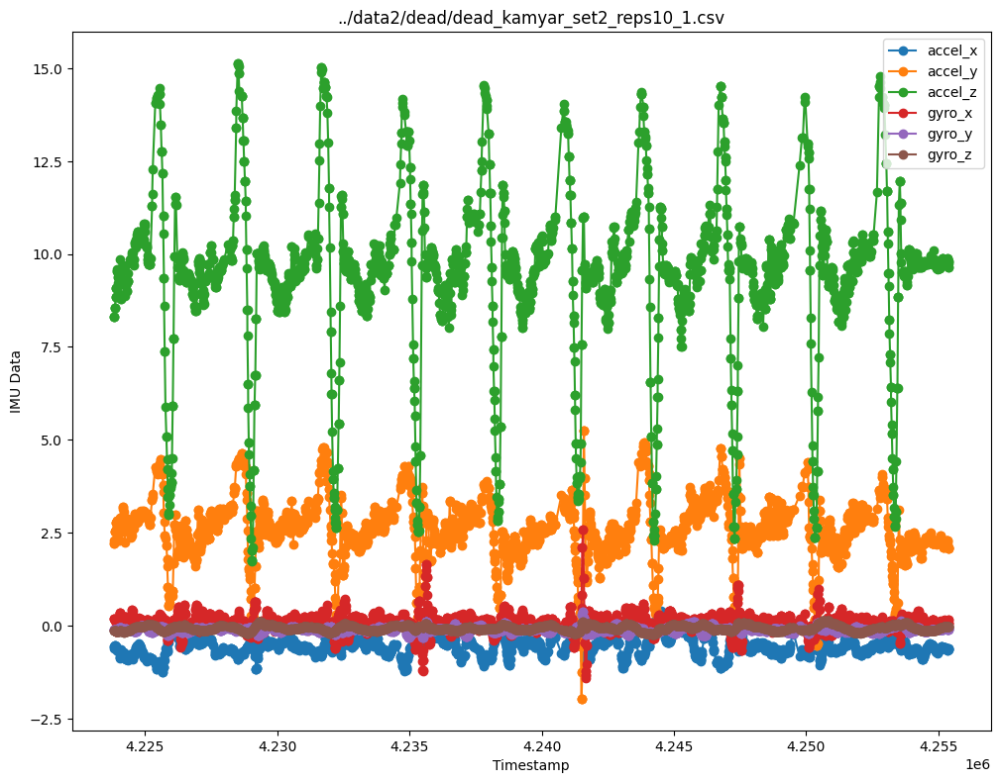

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  4.223827e+06 -0.592846  2.147203  8.254266  0.217329 -0.102371 -0.115524
1  4.223904e+06 -0.568410  2.682796  8.909412 -0.099904 -0.118804 -0.143589
2  4.223985e+06 -0.646277  2.515006  9.219987 -0.033867 -0.098621 -0.154871
3  4.224068e+06 -0.775799  2.770008  9.465346  0.344143 -0.045973 -0.137797
4  4.224145e+06 -0.800786  3.107295  9.519830  0.066720 -0.080254 -0.158719


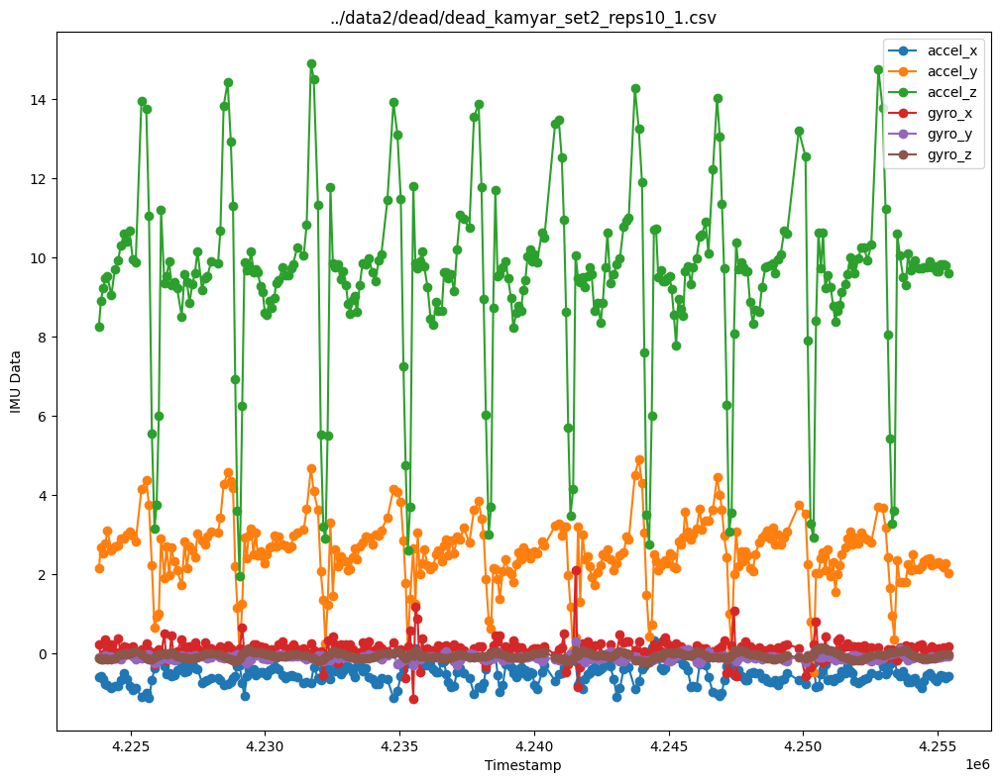

../data2/dead/dead_mike_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    3029950   -0.859    4.615    8.893   0.034  -0.099  -0.066
1    3029954   -0.859    4.615    8.893   0.034  -0.099  -0.066
2    3029957   -0.841    4.592    8.856   0.020  -0.101  -0.066
3    3029960   -0.841    4.592    8.856   0.020  -0.101  -0.066
4    3029984   -0.876    4.570    8.820  -0.005  -0.103  -0.064


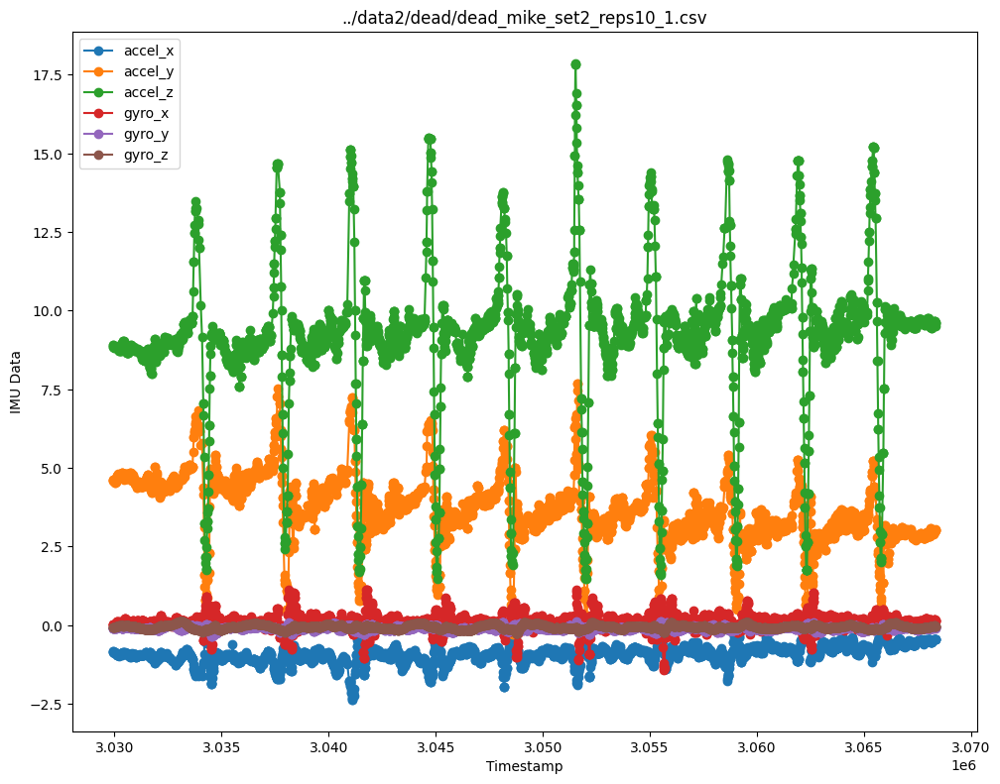

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  3.029935e+06 -0.856490  4.650273  8.903797  0.051070 -0.098853 -0.066811
1  3.030095e+06 -0.918314  4.641154  8.818227  0.063187 -0.085818 -0.045330
2  3.030226e+06 -0.953282  4.722003  8.741063  0.102799 -0.083072 -0.021610
3  3.030355e+06 -0.938784  4.787882  8.864891  0.030165 -0.092265 -0.018971
4  3.030504e+06 -0.884095  4.749830  8.873094  0.171374 -0.056331 -0.018880


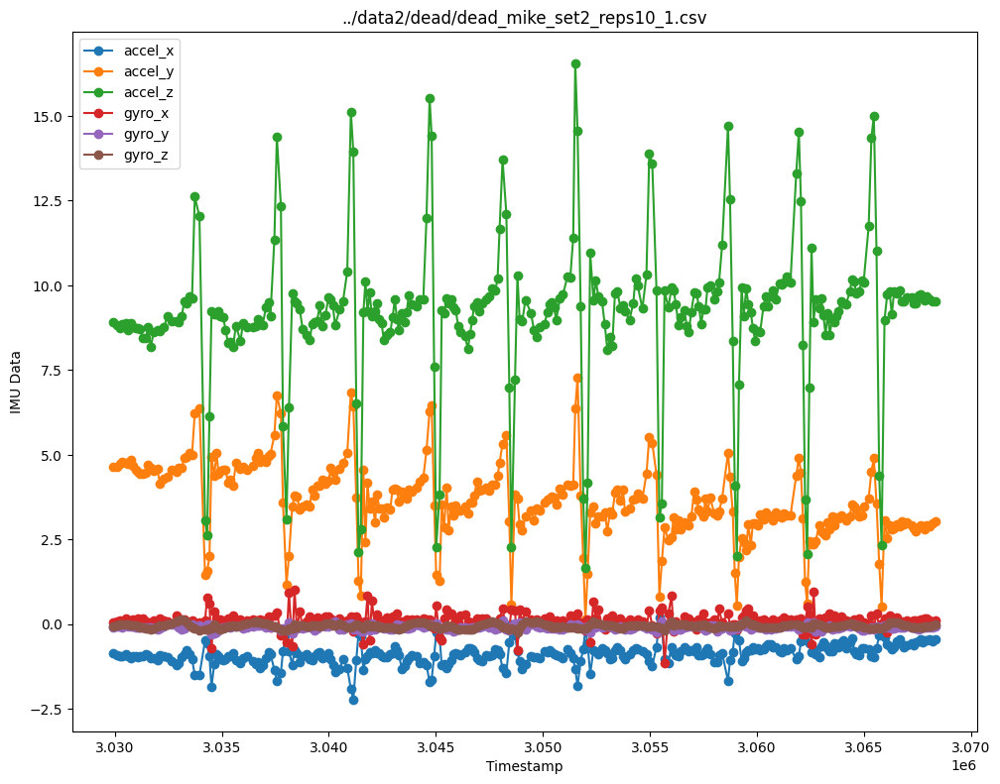

../data2/squat/squat_adam_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     910129    0.998   -9.411   -2.237   0.180  -0.094  -0.068
1     910152    0.993   -9.450   -2.216   0.178  -0.092  -0.075
2     910156    0.993   -9.450   -2.216   0.178  -0.092  -0.075
3     910159    1.019   -9.460   -2.203   0.162  -0.088  -0.077
4     910181    1.006   -9.435   -2.199   0.133  -0.093  -0.081


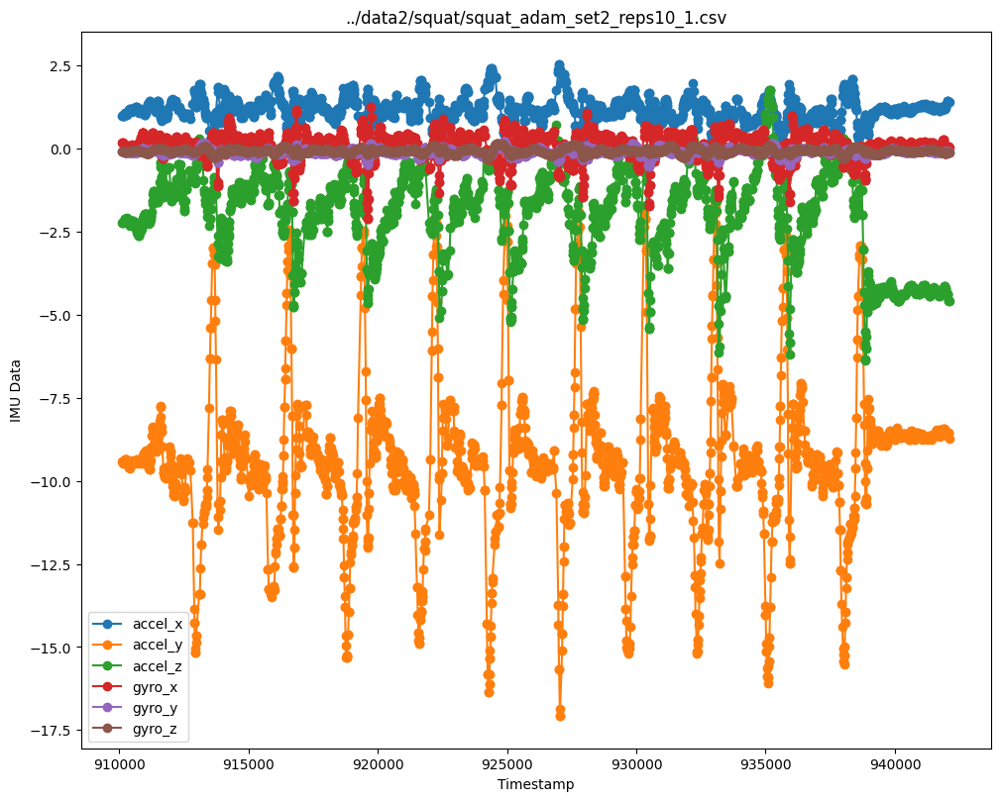

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  910132.174825  0.987573 -9.428937 -2.230601  0.190755 -0.092378 -0.069497
1  910223.409539  1.051948 -9.393163 -2.145210  0.091724 -0.096555 -0.089521
2  910313.716023  1.075513 -9.411739 -2.115572  0.100378 -0.099120 -0.089227
3  910449.044422  1.168505 -9.520918 -2.239925  0.083505 -0.098004 -0.075131
4  910552.564313  1.155465 -9.437272 -2.167185  0.058381 -0.111359 -0.058192


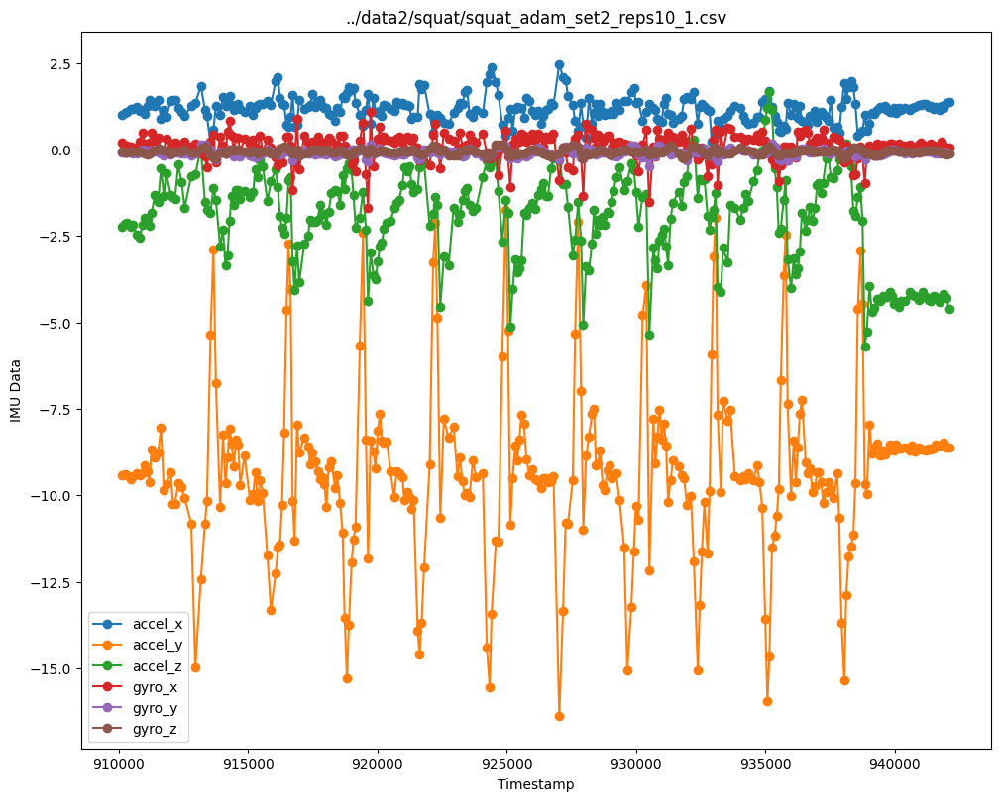

../data2/squat/squat_andrew_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    1184695   -0.092   -6.986   -6.656   0.048  -0.099  -0.026
1    1184699   -0.045   -6.974   -6.672   0.031  -0.108  -0.029
2    1184703   -0.045   -6.974   -6.672   0.031  -0.108  -0.029
3    1185117   -0.184   -6.840   -7.049  -0.064  -0.110  -0.045
4    1185208   -0.238   -6.711   -6.976   0.119  -0.117  -0.048


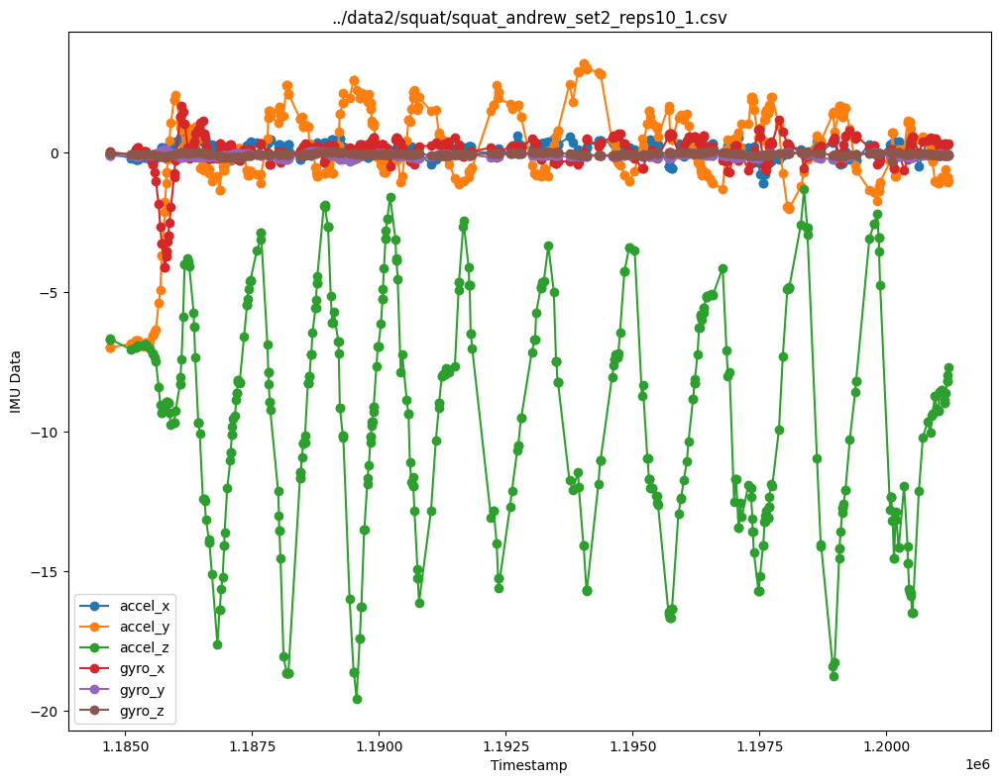

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  1.184620e+06 -0.028112 -7.060385 -6.619210 -0.008483 -0.099399 -0.025000
1  1.184846e+06 -0.115280 -6.900744 -6.778559  0.041184 -0.107730 -0.033699
2  1.185029e+06 -0.179540 -6.791127 -6.892525  0.081360 -0.113816 -0.040530
3  1.185166e+06 -0.220236 -6.732967 -6.959806  0.111774 -0.117593 -0.045440
4  1.185258e+06 -0.249772 -6.726706 -6.970777  0.155668 -0.119005 -0.047744


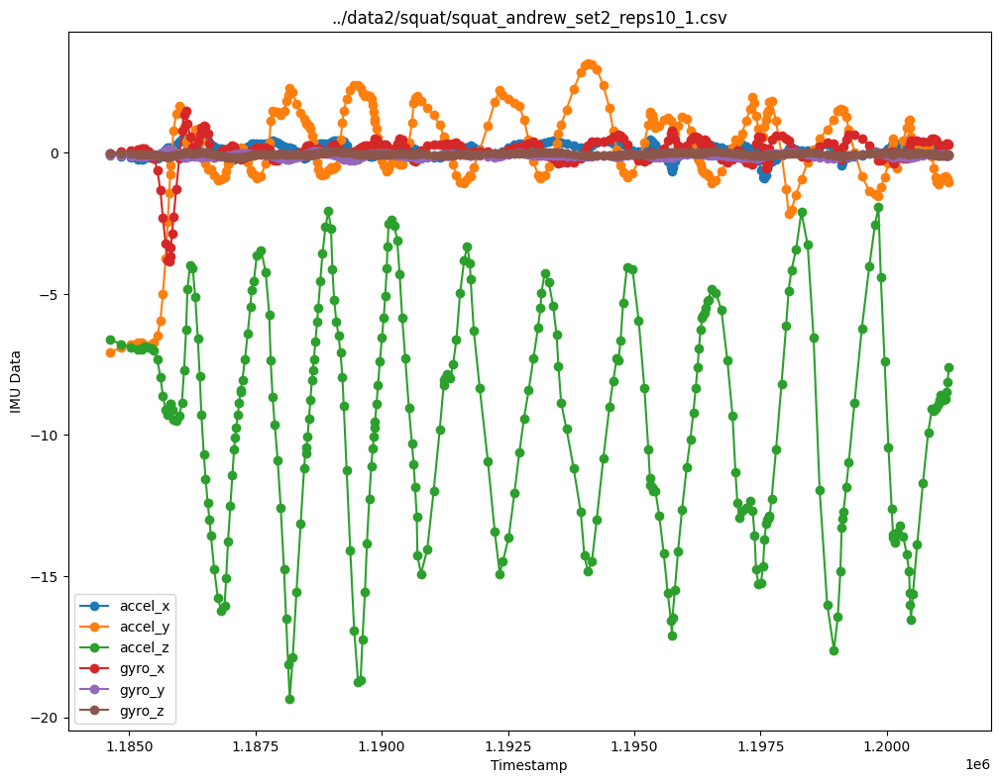

../data2/squat/squat_anuj_set2_rep10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     700685   -0.890    9.940    0.473   0.236  -0.090  -0.044
1     700688   -0.890    9.940    0.473   0.236  -0.090  -0.044
2     700692   -0.890    9.940    0.473   0.236  -0.090  -0.044
3     700695   -0.871    9.919    0.440   0.247  -0.093  -0.044
4     700746   -0.918    9.813    0.305   0.264  -0.092  -0.049


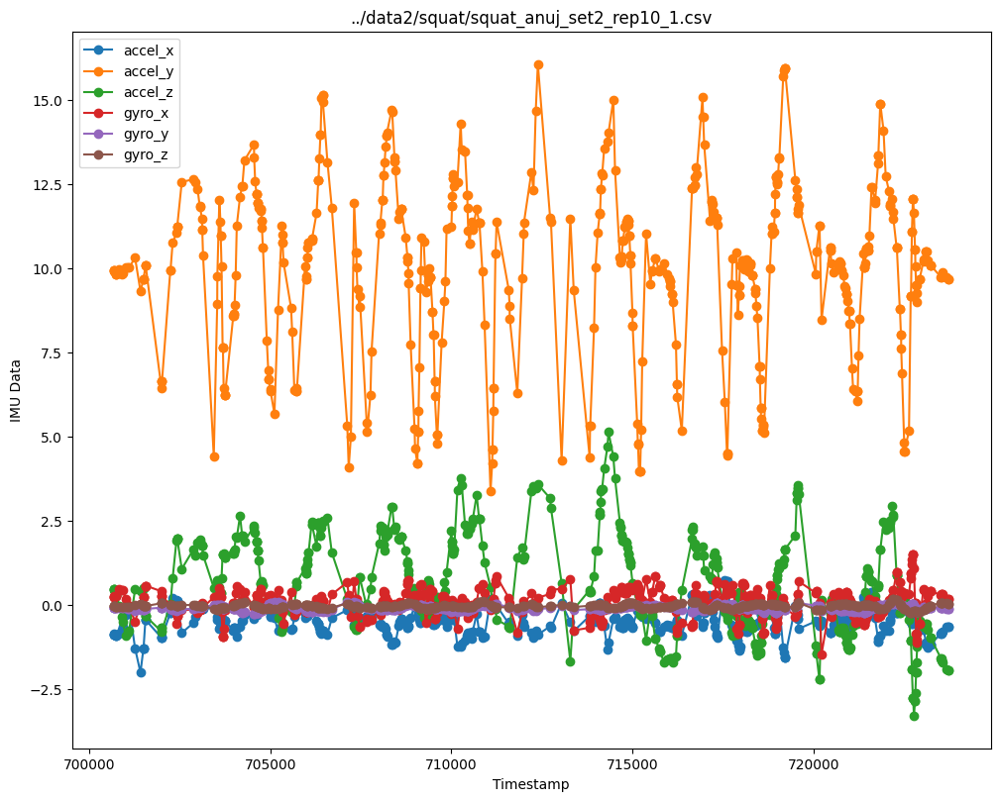

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  700690.055944 -0.817573  9.980042  0.426832  0.190280 -0.092846 -0.044909
1  700689.170564 -0.930599  9.899070  0.495241  0.252985 -0.090109 -0.044006
2  700716.629923 -0.956712  9.854421  0.417078  0.299233 -0.088327 -0.045244
3  700772.168136 -0.915538  9.840670  0.176535  0.352705 -0.085711 -0.048706
4  700856.087378 -0.700224  9.858104 -0.275098  0.388153 -0.082893 -0.056736


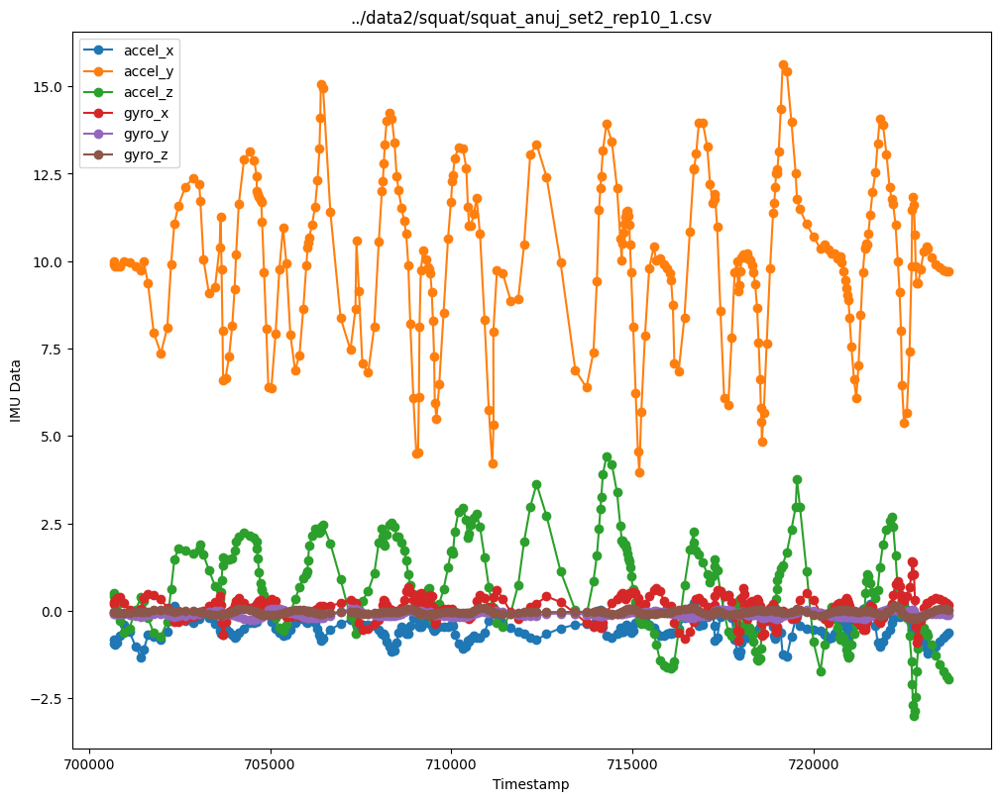

../data2/squat/squat_jake_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     352283   -0.106    2.952    9.422   0.750  -0.357   0.044
1     352286   -0.056    3.083    9.403   0.779  -0.357   0.048
2     352290   -0.056    3.083    9.403   0.779  -0.357   0.048
3     352292   -0.056    3.083    9.403   0.779  -0.357   0.048
4     352316   -0.032    3.351    9.377   0.724  -0.364   0.042


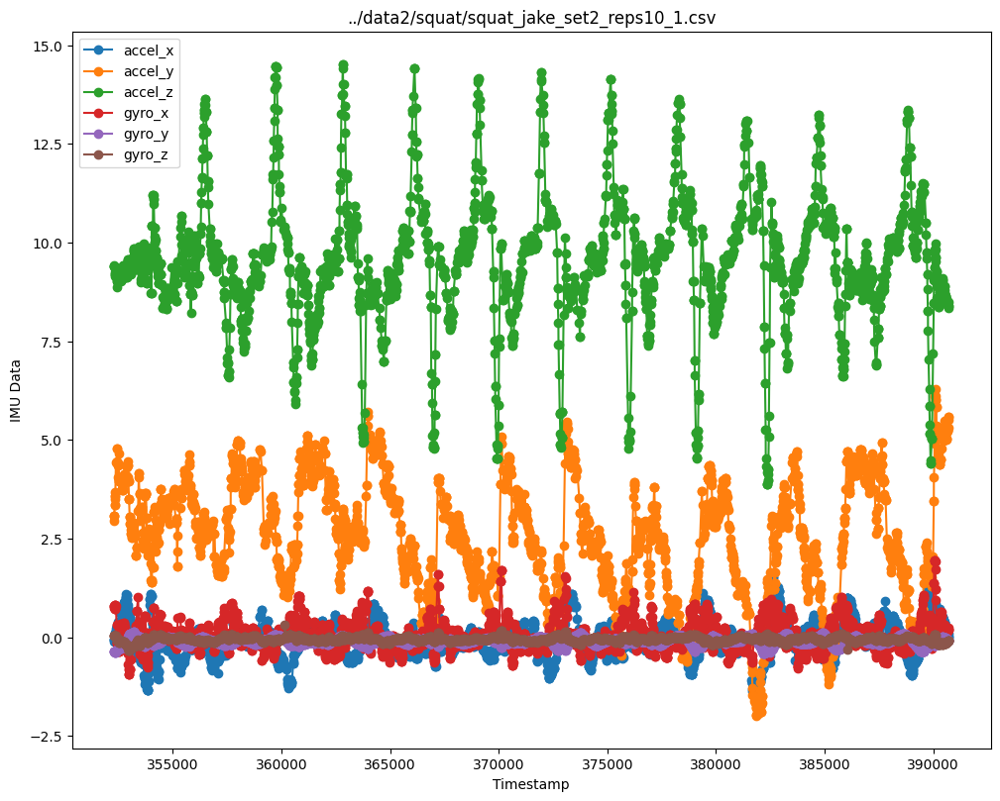

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  352280.076923 -0.078741  3.027552  9.447105  0.770175 -0.354196  0.047510
1  352367.041802  0.154510  3.967526  9.168977  0.700471 -0.370685  0.035310
2  352473.241956  0.331990  4.408233  9.042206 -0.110730 -0.301084 -0.074541
3  352599.461811  0.630388  3.914728  9.062452  0.217145 -0.271471 -0.093279
4  352724.785945  0.766002  3.980656  9.401311  0.287360 -0.202511 -0.121378


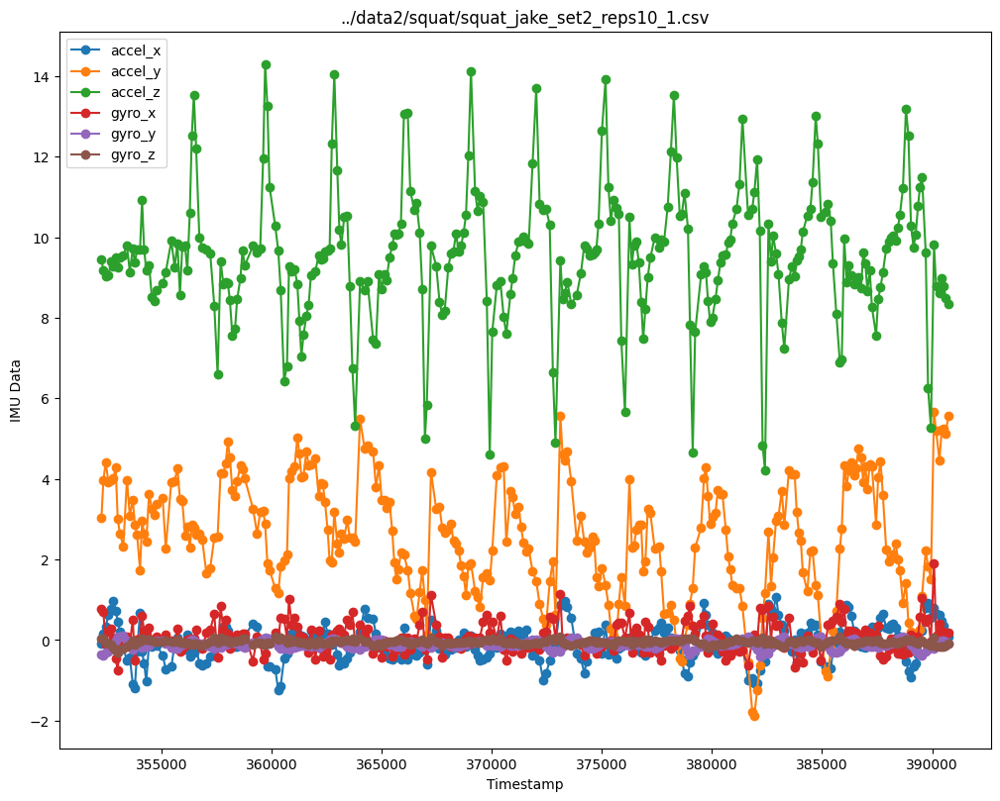

../data2/squat/squat_kamyar_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    4038343    0.821   -6.437   -7.279   0.116  -0.131  -0.062
1    4038347    0.816   -6.432   -7.286   0.110  -0.133  -0.065
2    4038351    0.816   -6.432   -7.286   0.110  -0.133  -0.065
3    4038373    0.863   -6.349   -7.339   0.097  -0.138  -0.068
4    4038376    0.829   -6.287   -7.328   0.081  -0.143  -0.070


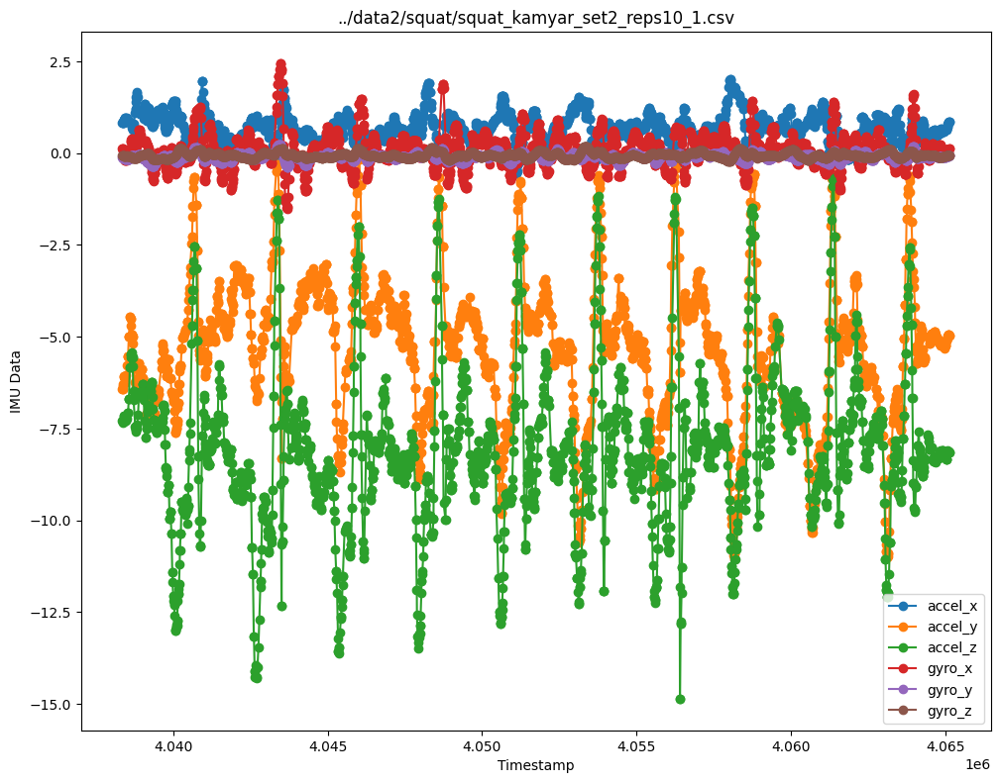

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  4.038340e+06  0.816273 -6.495909 -7.299580  0.113231 -0.130951 -0.061748
1  4.038410e+06  0.904554 -6.127211 -7.212015 -0.059897 -0.156933 -0.081997
2  4.038521e+06  0.908335 -5.559453 -7.108279 -0.187546 -0.179275 -0.081619
3  4.038607e+06  0.824533 -4.579118 -5.642921  0.260894 -0.101563 -0.091359
4  4.038681e+06  0.637269 -5.230956 -5.838644  0.283896 -0.064783 -0.136532


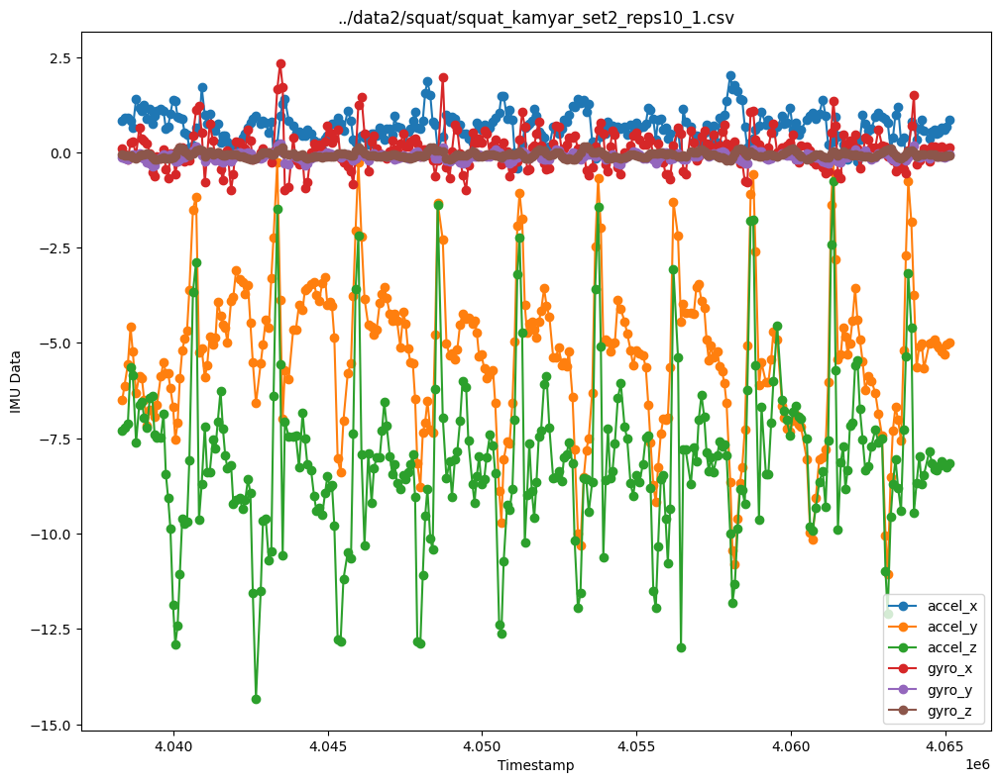

../data2/squat/squat_mike_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0    2829203    1.247   -7.991   -0.632  -0.573  -0.244  -0.109
1    2829207    1.247   -7.991   -0.632  -0.573  -0.244  -0.109
2    2829229    1.358   -8.288   -0.957  -0.848  -0.281  -0.126
3    2829233    1.393   -8.577   -1.133  -0.946  -0.293  -0.131
4    2829237    1.393   -8.577   -1.133  -0.946  -0.293  -0.131


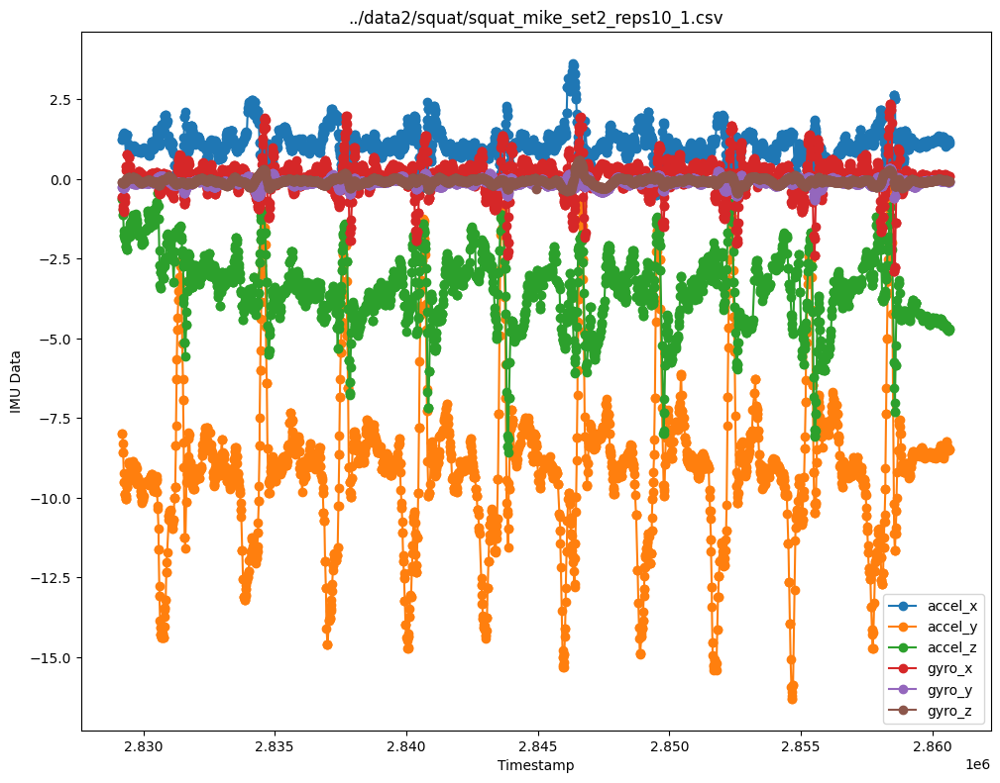

      timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  2.829201e+06  1.232007 -7.802762 -0.492594 -0.520776 -0.238161 -0.106448
1  2.829293e+06  1.306908 -9.877716 -1.885392 -0.612443 -0.225017 -0.100776
2  2.829393e+06  1.315299 -9.509967 -2.027188  0.743459 -0.019030  0.029998
3  2.829506e+06  0.899926 -9.226032 -1.507495  0.236454 -0.096436  0.037770
4  2.829608e+06  0.925732 -8.967978 -1.182737  0.167739 -0.122747  0.052008


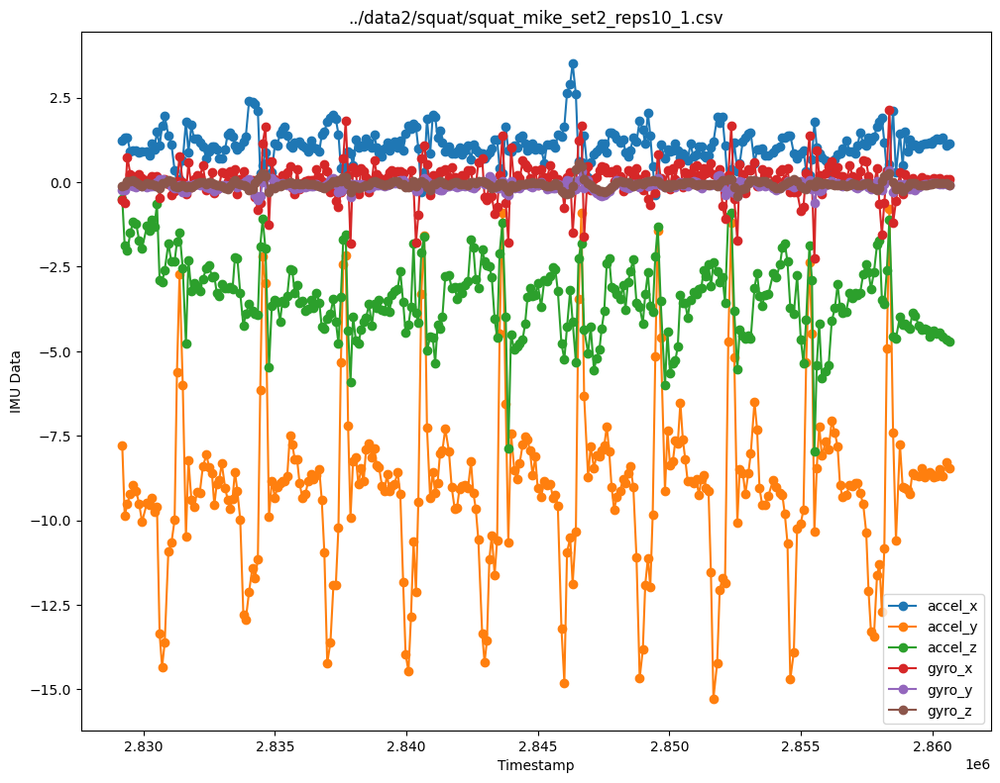

../data2/squat/squat_suzan_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     186925    0.279    1.155    9.888   0.076  -0.064  -0.017
1     186929    0.215    1.158    9.949   0.101  -0.061  -0.015
2     186932    0.215    1.158    9.949   0.101  -0.061  -0.015
3     186936    0.215    1.158    9.949   0.101  -0.061  -0.015
4     186989    0.118    1.341   10.040   0.127  -0.064  -0.017


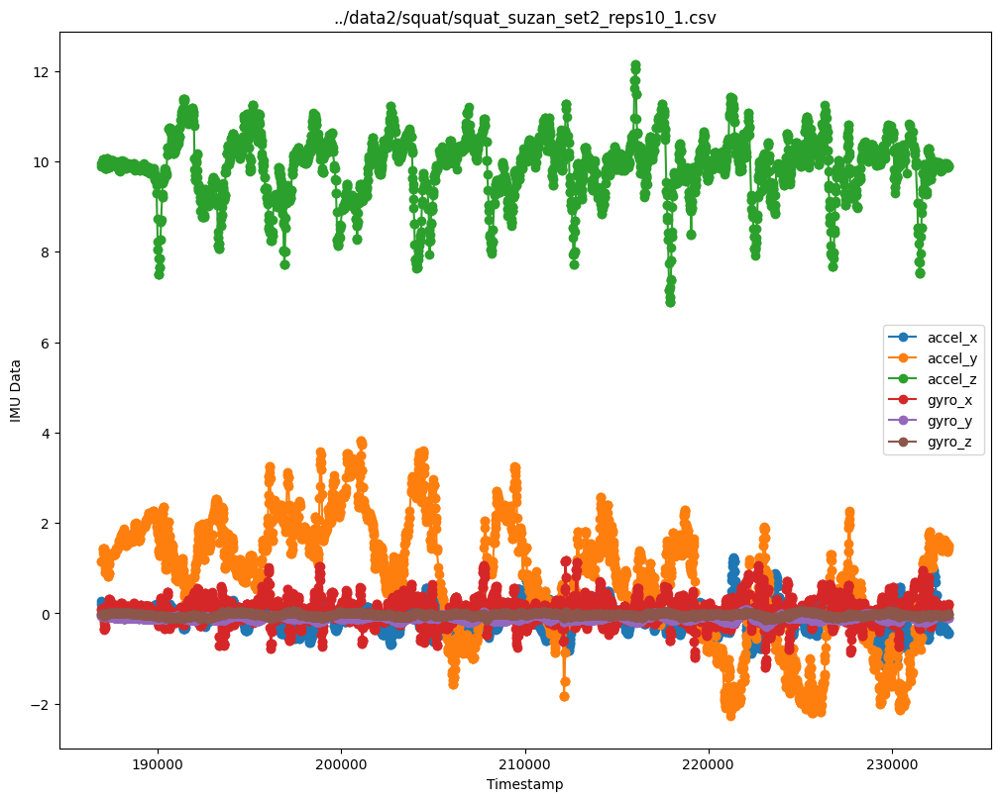

       timestamp   accel_x   accel_y    accel_z    gyro_x    gyro_y    gyro_z
0  186908.531469  0.283420  1.089825   9.891462  0.084783 -0.062622 -0.016000
1  187086.216643  0.032406  1.227346   9.961342 -0.340316 -0.076457 -0.045269
2  187240.981157  0.064257  1.031826  10.052777  0.011301 -0.061999 -0.013826
3  187360.534072 -0.015131  1.179484   9.976812  0.319633 -0.067820  0.003391
4  187604.105277  0.046622  1.300871   9.936573  0.122097 -0.090371  0.004442


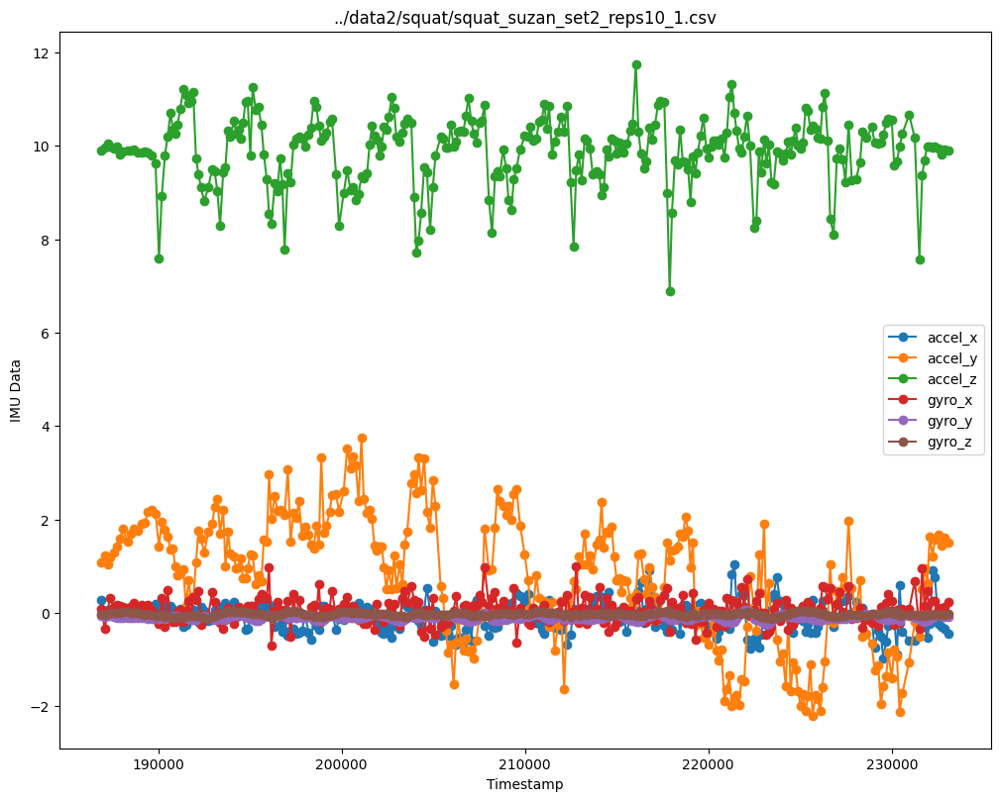

../data2/squat/squat_udai_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     279625    0.517    4.211    9.215  -0.035  -0.143  -0.034
1     279628    0.485    4.125    9.176  -0.077  -0.142  -0.034
2     279632    0.485    4.125    9.176  -0.077  -0.142  -0.034
3     279636    0.485    4.125    9.176  -0.077  -0.142  -0.034
4     279687    0.512    4.031    9.121   0.202  -0.140  -0.022


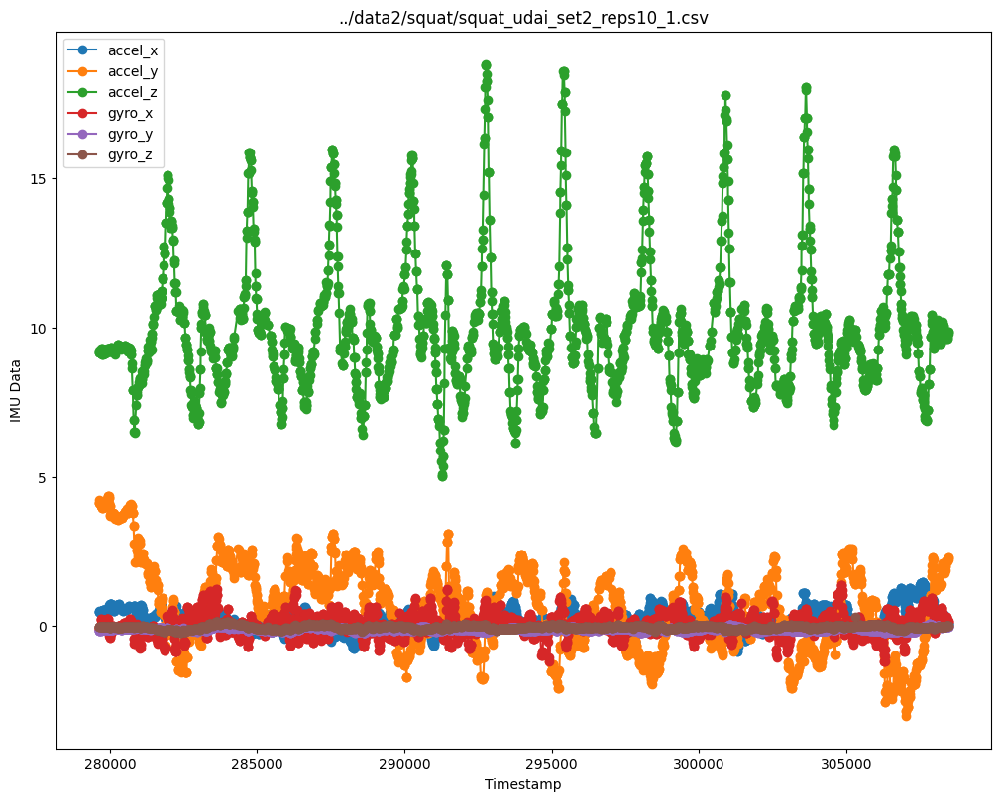

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  279614.965035  0.497916  4.185811  9.180769 -0.140531 -0.144245 -0.037986
1  279725.885664  0.488565  4.014701  9.201532  0.159146 -0.128676 -0.018876
2  279810.611237  0.535669  4.048071  9.154043  0.205940 -0.129924 -0.019482
3  279918.502428  0.509795  4.307418  9.290661  0.241799 -0.113404 -0.010511
4  280001.093817  0.722364  3.895887  9.207735 -0.340310 -0.113391 -0.041577


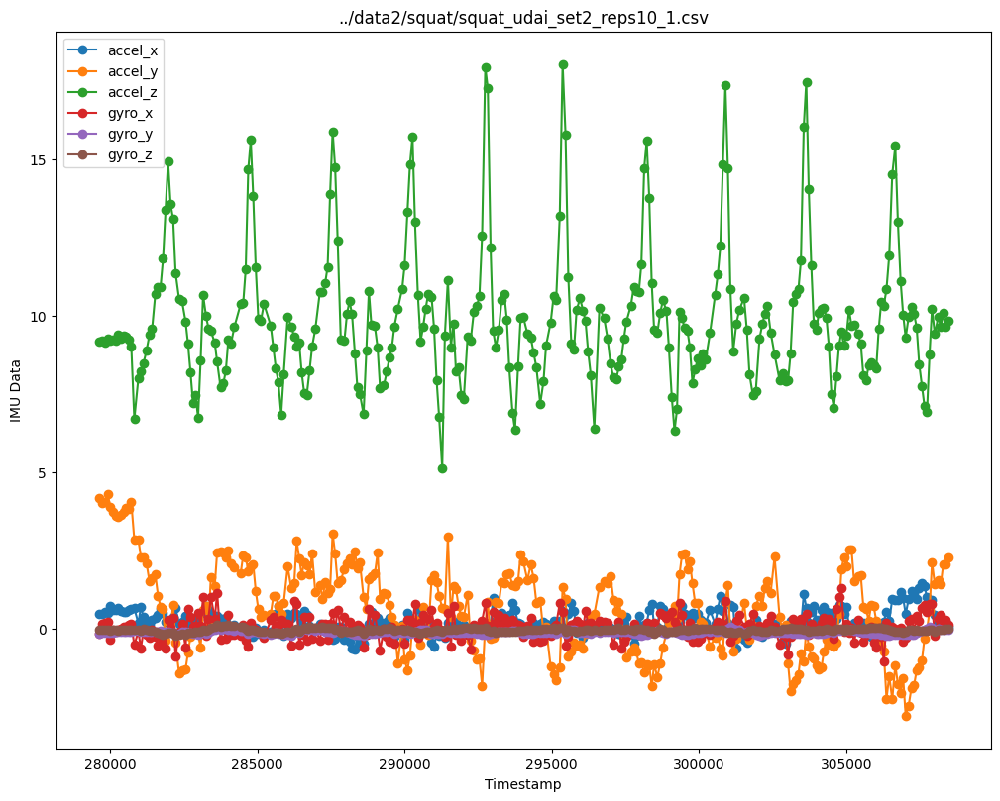

../data2/newDead/newdead_udai_set2_reps10_1.csv
   timestamp  accel_x  accel_y  accel_z  gyro_x  gyro_y  gyro_z
0     176896    1.177    4.515    9.025   0.037  -0.122  -0.104
1     176899    1.195    4.550    9.184   0.050  -0.125  -0.104
2     176903    1.195    4.550    9.184   0.050  -0.125  -0.104
3     176907    1.272    4.725    9.239   0.050  -0.127  -0.105
4     176927    1.210    4.600    9.075   0.046  -0.119  -0.105


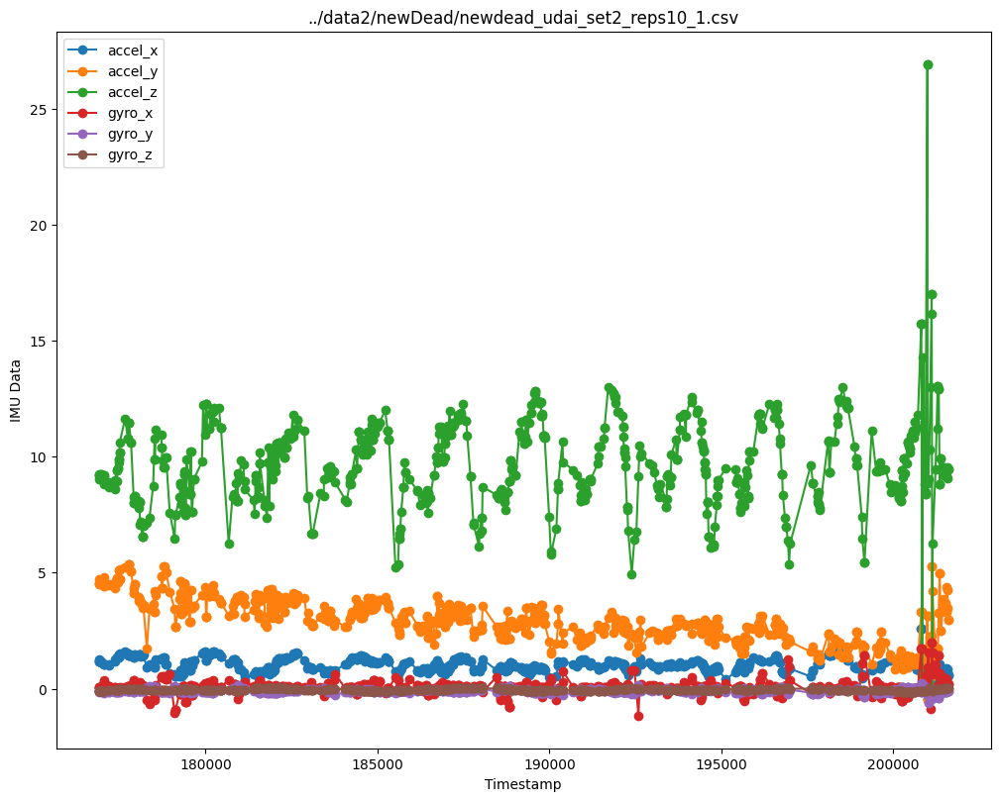

       timestamp   accel_x   accel_y   accel_z    gyro_x    gyro_y    gyro_z
0  176895.083916  1.188692  4.532685  9.085462  0.070245 -0.131021 -0.102769
1  176909.291266  1.204915  4.582590  9.166597  0.024376 -0.117536 -0.105387
2  176939.904912  1.183746  4.583978  9.209516  0.040557 -0.117941 -0.104677
3  176982.856717  1.106206  4.530675  9.207702  0.144063 -0.135774 -0.101305
4  177048.580256  1.042502  4.539267  9.037300  0.223516 -0.155535 -0.092573


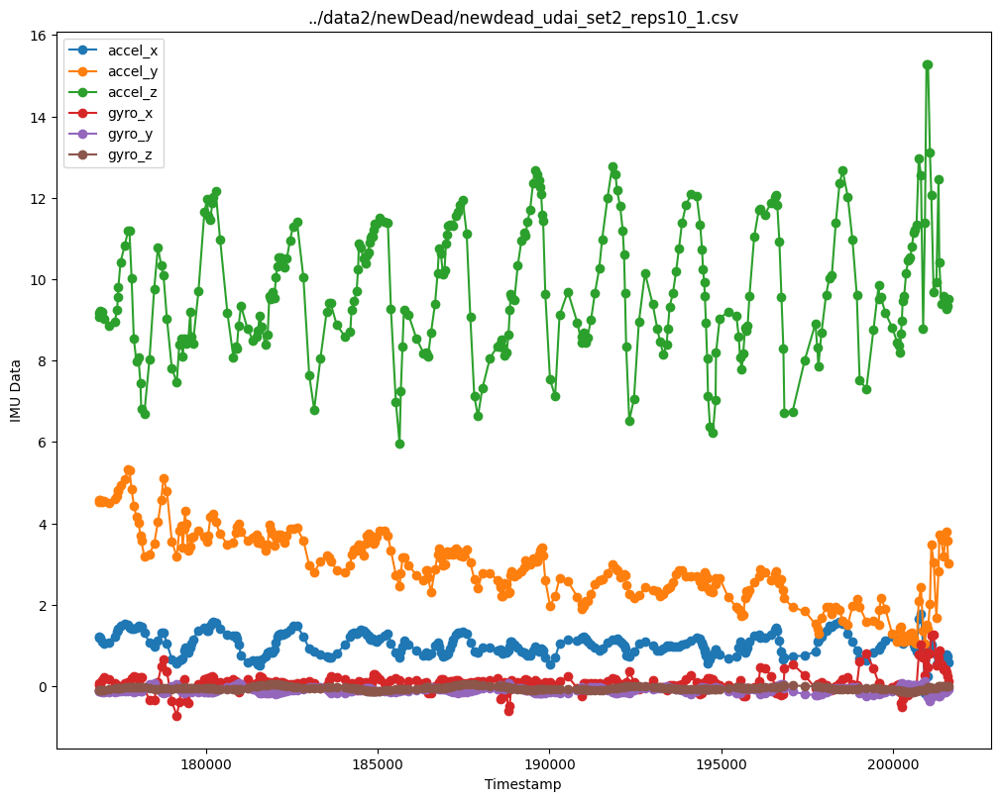

In [4]:
for file in test_files:
    df = create_df(file)
    plot_df(df, str(file))
    df = smooth_and_resample(df)
    plot_df(df, str(file))